<a href="https://colab.research.google.com/github/antiparticle25/parkinson_project/blob/main/parkinson_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
# Standard Libraries
import json
import math
import re
import sys
from itertools import combinations

# Data Manipulation
import numpy as np
import pandas as pd
import scipy
from scipy import stats
from scipy.stats import chi2_contingency, f_oneway, kruskal, mannwhitneyu, shapiro, spearmanr, wilcoxon
from scipy.stats import kstest
from scipy.interpolate import interp1d
from scipy.cluster.hierarchy import dendrogram, fcluster, linkage

# Machine Learning and Statistical Modeling
import statsmodels.api as sm
import statsmodels.formula.api as smf
from lifelines import CoxPHFitter, KaplanMeierFitter
import scikit_posthocs as sp
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression
from sklearn.metrics import accuracy_score, classification_report, make_scorer
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder, PowerTransformer, RobustScaler, StandardScaler
import xgboost as xgb  # XGBoost

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Bioinformatics
from Bio.SeqUtils.ProtParam import ProteinAnalysis

# UMAP for Dimensionality Reduction
import umap

# Joblib for Model Persistence
import joblib

# Openpyxl for Excel Interaction
import openpyxl

# Requests for HTTP requests
import requests

# Statsmodels for Multiple Test Correction
from statsmodels.stats.multitest import multipletests

import warnings
warnings.filterwarnings('ignore')

# Load Train and Sample Test Data

## Patient data & UPDRS scores

In [ ]:
test = pd.read_csv("test.csv")

In [ ]:
supplemental = pd.read_csv("supplemental_clinical_data.csv")

In [ ]:
clinical = pd.read_csv("train_clinical_data.csv")
clinical

,visit_id,patient_id,visit_month,updrs_1,updrs_2,updrs_3,updrs_4,upd23b_clinical_state_on_medication
0,55_0,55,0,10.0,6.0,15.0,NaN,NaN
1,55_3,55,3,10.0,7.0,25.0,NaN,NaN
2,55_6,55,6,8.0,10.0,34.0,NaN,NaN
3,55_9,55,9,8.0,9.0,30.0,0.0,On
4,55_12,55,12,10.0,10.0,41.0,0.0,On
...,...,...,...,...,...,...,...,...
2610,65043_48,65043,48,7.0,6.0,13.0,0.0,Off
2611,65043_54,65043,54,4.0,8.0,11.0,1.0,Off
2612,65043_60,65043,60,6.0,6.0,16.0,1.0,Off
2613,65043_72,65043,72,3.0,9.0,14.0,1.0,Off


In [ ]:
clinical.isna().sum()

visit_id                                  0
patient_id                                0
visit_month                               0
updrs_1                                   1
updrs_2                                   2
updrs_3                                  25
updrs_4                                1038
upd23b_clinical_state_on_medication    1327
dtype: int64

In [ ]:
clinical.patient_id.nunique()

248

In [ ]:
patient_count_clinical = clinical.groupby('visit_month')['patient_id'].nunique()

for visit_month, count in patient_count_clinical.items():
    print(f"The number of patients visiting during month {visit_month} is {count}.")

The number of patients visiting during month 0 is 248.
The number of patients visiting during month 3 is 115.
The number of patients visiting during month 6 is 192.
The number of patients visiting during month 9 is 99.
The number of patients visiting during month 12 is 243.
The number of patients visiting during month 18 is 187.
The number of patients visiting during month 24 is 243.
The number of patients visiting during month 30 is 173.
The number of patients visiting during month 36 is 226.
The number of patients visiting during month 42 is 154.
The number of patients visiting during month 48 is 196.
The number of patients visiting during month 54 is 110.
The number of patients visiting during month 60 is 166.
The number of patients visiting during month 72 is 93.
The number of patients visiting during month 84 is 100.
The number of patients visiting during month 96 is 58.
The number of patients visiting during month 108 is 12.


### Clinical + supplemental

In [ ]:
# Let's put clinical + supplemental clinical together, it will be invaluable for some subsequent analysis

clinical_supplemental = pd.concat([clinical, supplemental], ignore_index=True)

In [ ]:
# Find patients from "clinical" dataframe in "supplemental"
patients_in_supplemental = set(supplemental['patient_id'].unique())
patients_in_clinical = set(clinical['patient_id'].unique())
common_patients = patients_in_clinical.intersection(patients_in_supplemental)

# Find patients from "supplemental" dataframe in "clinical"
patients_in_clinical_supplemental = set(clinical_supplemental['patient_id'].unique())
common_patients_supplemental = patients_in_supplemental.intersection(patients_in_clinical_supplemental)

# Count the number of patients in each group
num_patients_clinical_in_supplemental = len(common_patients)
num_patients_supplemental_in_clinical = len(common_patients_supplemental)

print(f"Number of patients from 'clinical' in 'supplemental': {num_patients_clinical_in_supplemental}")
print(f"Number of patients from 'supplemental' in 'clinical': {num_patients_supplemental_in_clinical}")


Number of patients from 'clinical' in 'supplemental': 0
Number of patients from 'supplemental' in 'clinical': 771


In [ ]:
clinical_supplemental.isna().sum()

visit_id                                  0
patient_id                                0
visit_month                               0
updrs_1                                 214
updrs_2                                 216
updrs_3                                  30
updrs_4                                1966
upd23b_clinical_state_on_medication    2428
dtype: int64

In [ ]:
clinical_supplemental.patient_id.nunique()

1019

In [ ]:
patient_count_clinical_supplemental = clinical_supplemental.groupby('visit_month')['patient_id'].nunique()

for visit_month, count in patient_count_clinical_supplemental.items():
    print(f"The number of patients visiting during month {visit_month} is {count}.")


The number of patients visiting during month 0 is 1019.
The number of patients visiting during month 3 is 115.
The number of patients visiting during month 5 is 118.
The number of patients visiting during month 6 is 440.
The number of patients visiting during month 9 is 99.
The number of patients visiting during month 12 is 478.
The number of patients visiting during month 18 is 363.
The number of patients visiting during month 24 is 437.
The number of patients visiting during month 30 is 396.
The number of patients visiting during month 36 is 484.
The number of patients visiting during month 42 is 154.
The number of patients visiting during month 48 is 196.
The number of patients visiting during month 54 is 110.
The number of patients visiting during month 60 is 166.
The number of patients visiting during month 72 is 93.
The number of patients visiting during month 84 is 100.
The number of patients visiting during month 96 is 58.
The number of patients visiting during month 108 is 12.

In [ ]:
# There are a lot of missing values, mainly for updrs_4.

## Protein data

In [ ]:
proteins = pd.read_csv("train_proteins.csv")

In [ ]:
test_proteins = pd.read_csv("test_proteins.csv")

### Basic statistics & information

In [ ]:
# NPX BETWEEN DIFFERENT PROTEINS IS NOT COMPARABLE - Olink

In [ ]:
proteins

,visit_id,visit_month,patient_id,UniProt,NPX
0,55_0,0,55,O00391,11254.3
1,55_0,0,55,O00533,732430.0
2,55_0,0,55,O00584,39585.8
3,55_0,0,55,O14498,41526.9
4,55_0,0,55,O14773,31238.0
...,...,...,...,...,...
232736,58648_108,108,58648,Q9UBX5,27387.8
232737,58648_108,108,58648,Q9UHG2,369437.0
232738,58648_108,108,58648,Q9UKV8,105830.0
232739,58648_108,108,58648,Q9Y646,21257.6


In [ ]:
proteins.describe().T.loc[['NPX']]

,count,mean,std,min,25%,50%,75%,max
NPX,232741.0,2.712077e+06,2.224155e+07,84.6082,29464.4,113556.0,563894.0,613851000.0


In [ ]:
proteins.isna().sum()

visit_id       0
visit_month    0
patient_id     0
UniProt        0
NPX            0
dtype: int64

In [ ]:
proteins.UniProt.nunique()

227

## Peptide data

In [ ]:
peptides = pd.read_csv("train_peptides.csv")

In [ ]:
test_peptides = pd.read_csv("test_peptides.csv")

### Basic statistics & information

In [ ]:
peptides.describe().T.loc[['PeptideAbundance']]

,count,mean,std,min,25%,50%,75%,max
PeptideAbundance,981834.0,642890.245933,3.377989e+06,10.9985,28174.25,74308.3,221338.75,178752000.0


In [ ]:
peptides.isna().sum()

visit_id            0
visit_month         0
patient_id          0
UniProt             0
Peptide             0
PeptideAbundance    0
dtype: int64

# Relationship between target variables - UPDRS scores

In [ ]:
clinical_supplemental

,visit_id,patient_id,visit_month,updrs_1,updrs_2,updrs_3,updrs_4,upd23b_clinical_state_on_medication
0,55_0,55,0,10.0,6.0,15.0,NaN,NaN
1,55_3,55,3,10.0,7.0,25.0,NaN,NaN
2,55_6,55,6,8.0,10.0,34.0,NaN,NaN
3,55_9,55,9,8.0,9.0,30.0,0.0,On
4,55_12,55,12,10.0,10.0,41.0,0.0,On
...,...,...,...,...,...,...,...,...
4833,65382_0,65382,0,NaN,NaN,0.0,NaN,NaN
4834,65405_0,65405,0,5.0,16.0,31.0,0.0,NaN
4835,65405_5,65405,5,NaN,NaN,57.0,NaN,NaN
4836,65530_0,65530,0,10.0,6.0,24.0,0.0,NaN


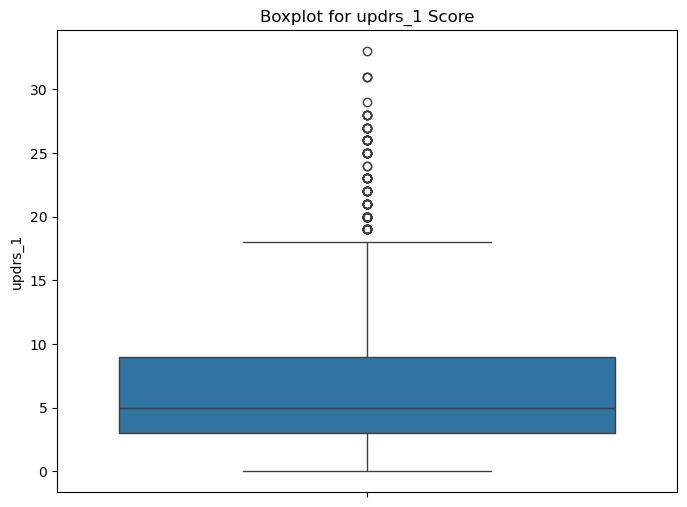

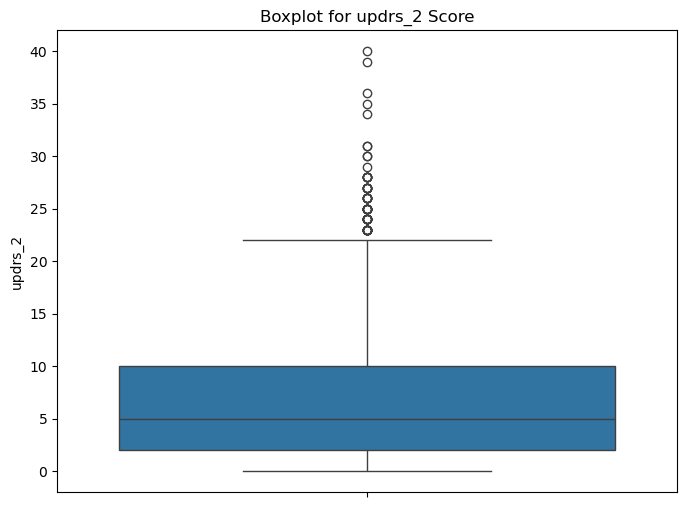

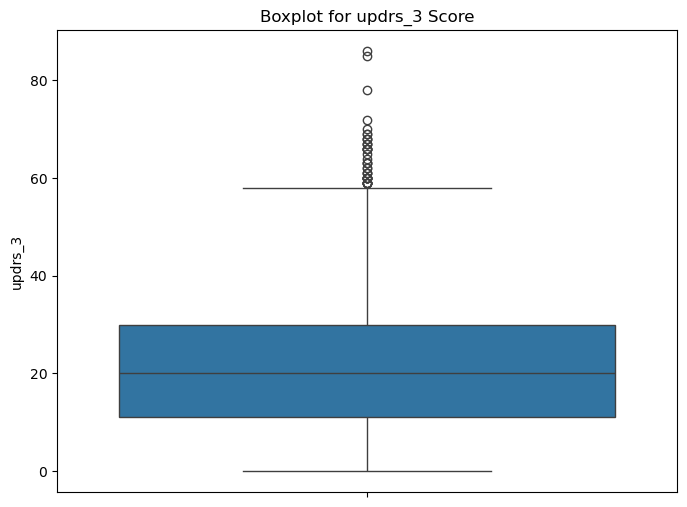

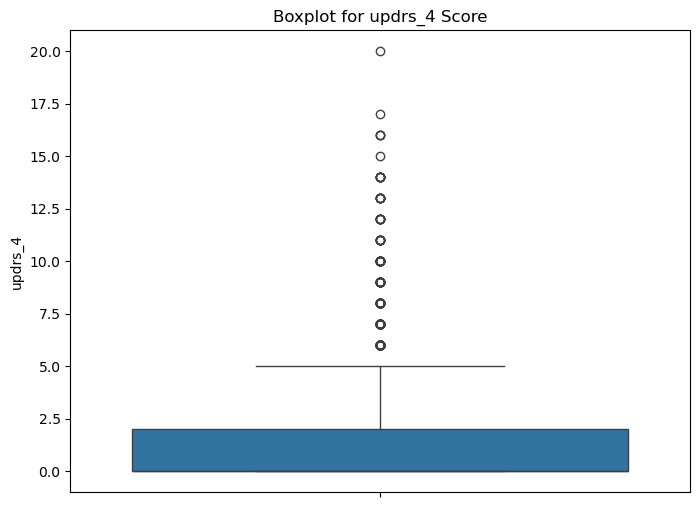

In [ ]:
updrs_scores = ['updrs_1', 'updrs_2', 'updrs_3', 'updrs_4']

for score in updrs_scores:
    plt.figure(figsize=(8, 6))
    sns.boxplot(data=clinical_supplemental, y=score)
    plt.title(f'Boxplot for {score} Score')
    plt.show()

## All months combined

### Scatterplot

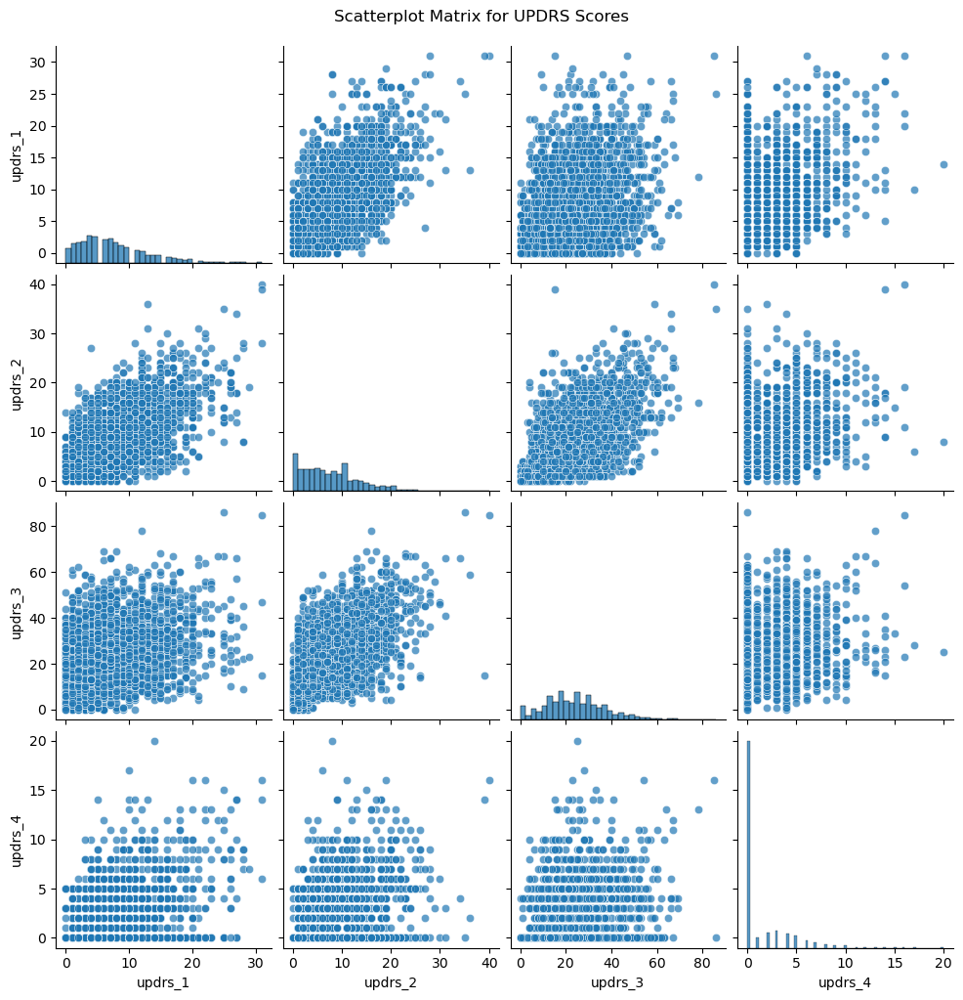

In [ ]:
def plot_updrs_scatter_matrix(data):
    sns.pairplot(data, diag_kind="hist", plot_kws={'alpha': 0.7})
    plt.suptitle("Scatterplot Matrix for UPDRS Scores", y=1.02)
    plt.show()

updrs_scores = ["updrs_1", "updrs_2", "updrs_3", "updrs_4"]

data_no_nan = clinical_supplemental.dropna(subset=updrs_scores)

data_updrs_scores = data_no_nan[updrs_scores]

plot_updrs_scatter_matrix(data_updrs_scores)


### Assessing distribution & normality for updrs scores

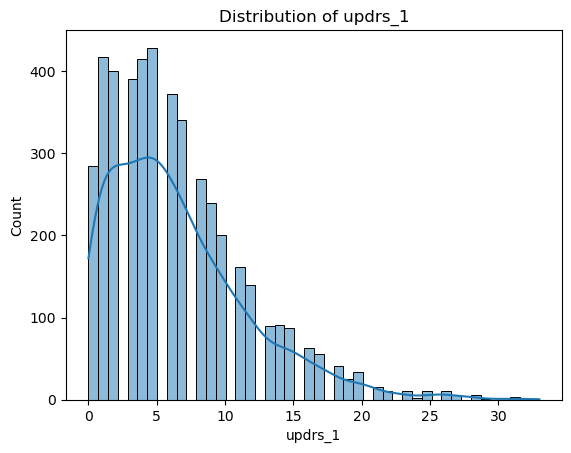

Shapiro-Wilk test for updrs_1:
Test statistic: 0.9101671576499939, p-value: 0.0



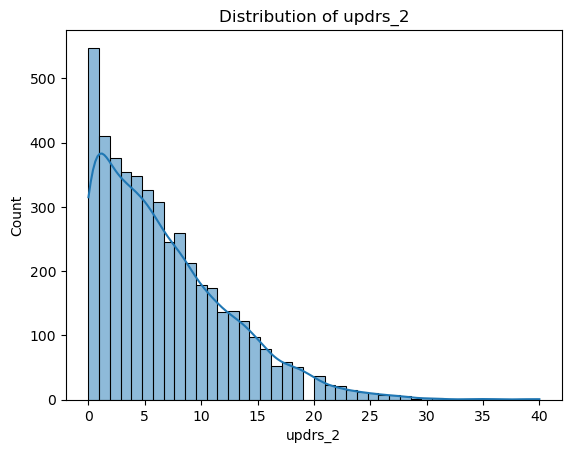

Shapiro-Wilk test for updrs_2:
Test statistic: 0.9059963226318359, p-value: 0.0



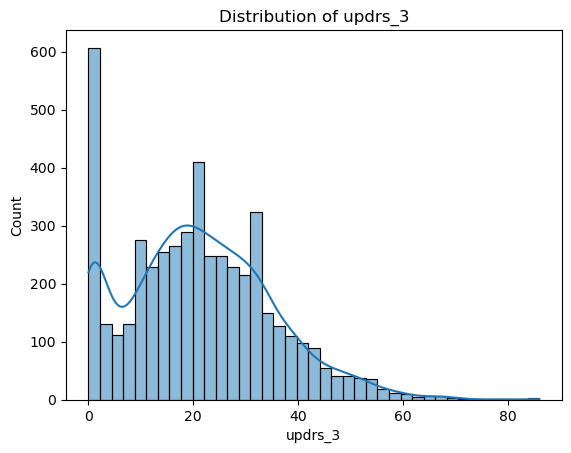

Shapiro-Wilk test for updrs_3:
Test statistic: 0.9700151681900024, p-value: 1.4330192081721845e-30



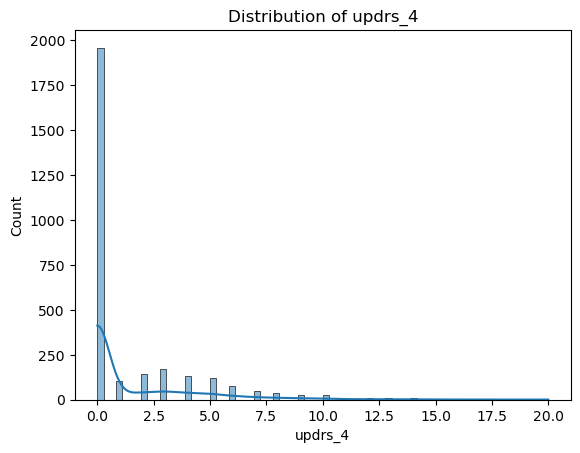

Shapiro-Wilk test for updrs_4:
Test statistic: 0.6119396090507507, p-value: 0.0



In [ ]:
for score in updrs_scores:
    data = clinical_supplemental[score].dropna()

    sns.histplot(data, kde=True)
    plt.title(f"Distribution of {score}")
    plt.show()

    # Shapiro-Wilk test
    stat, p = stats.shapiro(data)
    print(f"Shapiro-Wilk test for {score}:")
    print(f"Test statistic: {stat}, p-value: {p}\n")



### Correlation matrix & heatmap

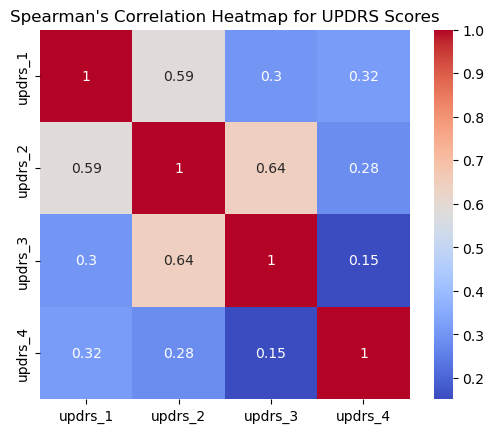

In [ ]:
correlation_matrix = clinical_supplemental[updrs_scores].corr(method='spearman')

sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', square=True)
plt.title("Spearman's Correlation Heatmap for UPDRS Scores")
plt.show()

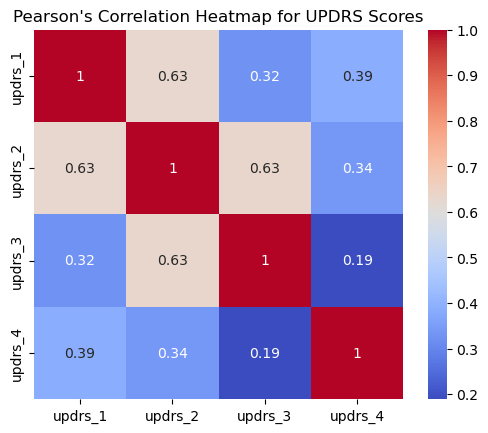

In [ ]:
correlation_matrix_pearson = clinical_supplemental[updrs_scores].corr(method='pearson')

sns.heatmap(correlation_matrix_pearson, annot=True, cmap='coolwarm', square=True)
plt.title("Pearson's Correlation Heatmap for UPDRS Scores")
plt.show()

## Per visit_month

### Correlation matrix & heatmap

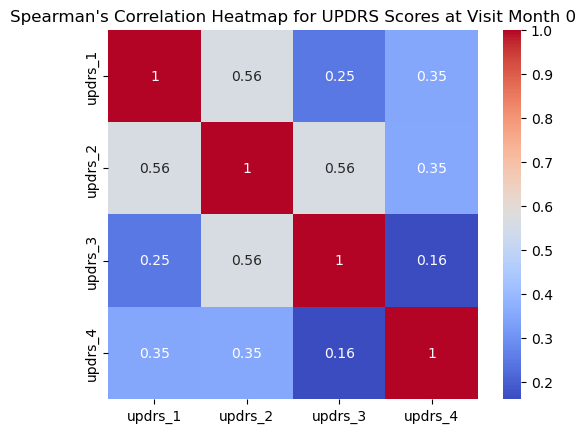

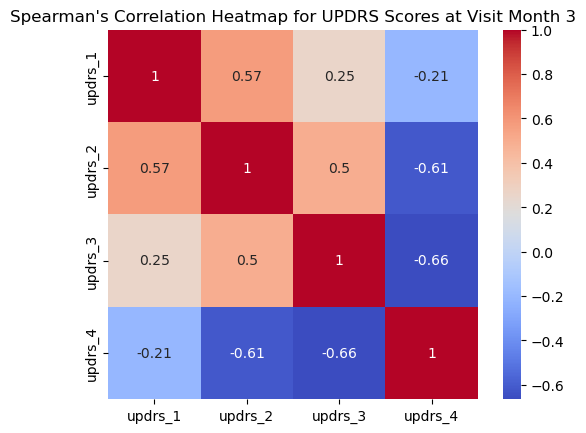

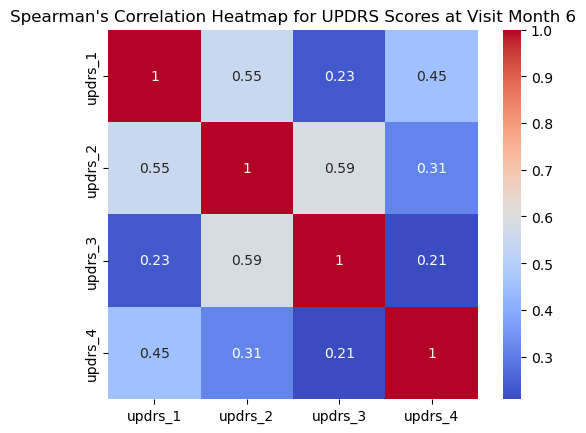

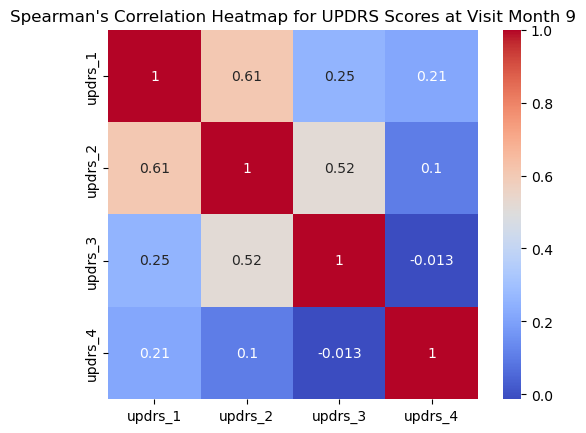

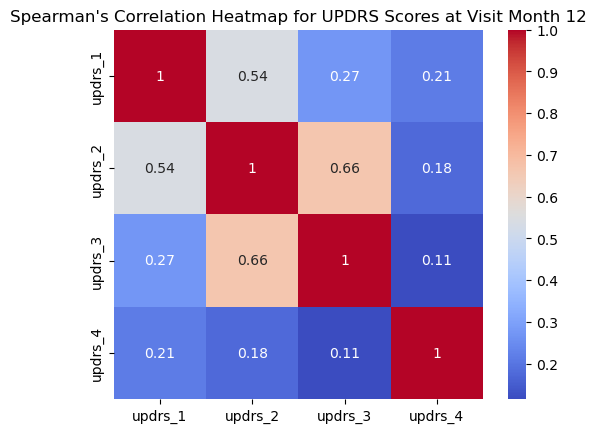

...

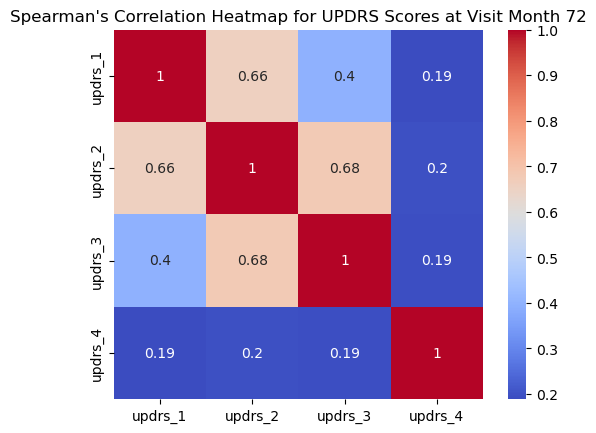

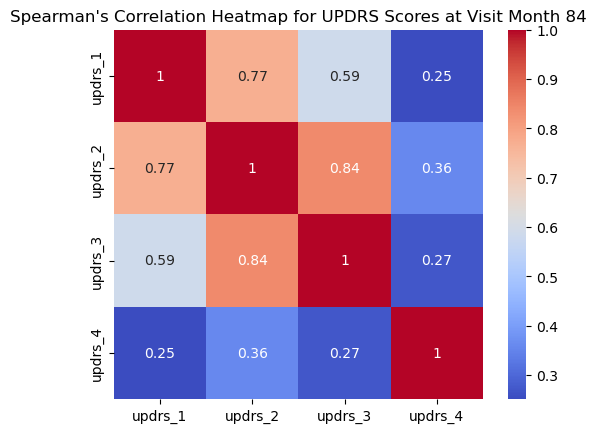

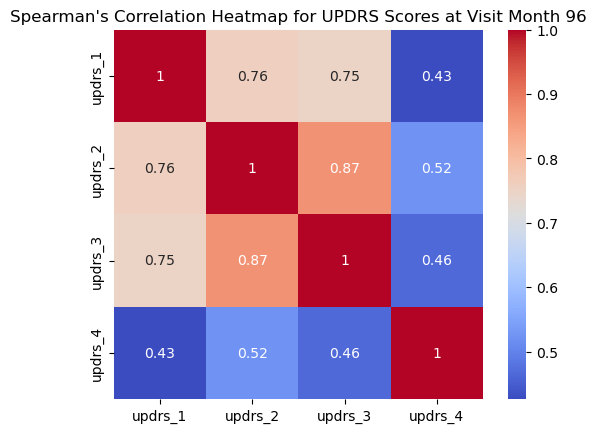

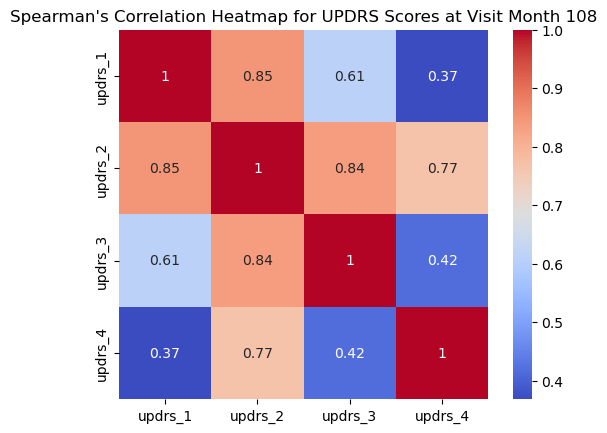

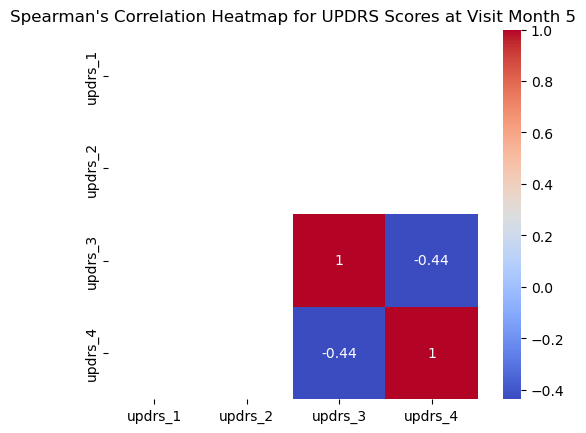

In [ ]:
visit_months_spearman = clinical_supplemental['visit_month'].unique()

for visit_month in visit_months_spearman:
    data_visit_month = clinical_supplemental[clinical_supplemental['visit_month'] == visit_month]
    correlation_matrix = data_visit_month[updrs_scores].corr(method='spearman')

    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', square=True)
    plt.title(f"Spearman's Correlation Heatmap for UPDRS Scores at Visit Month {visit_month}")
    plt.show()

### Distribution of UPDRS scores per visit_month

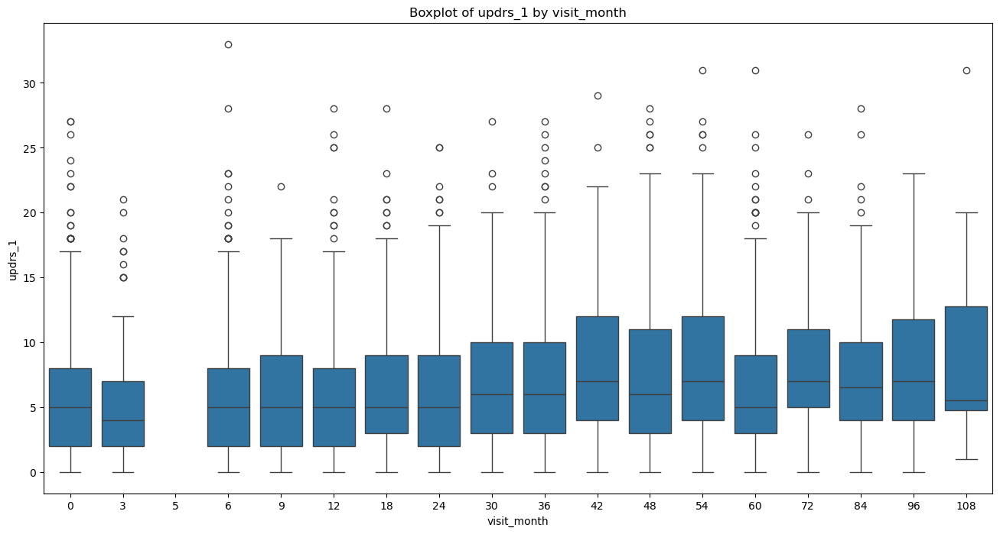

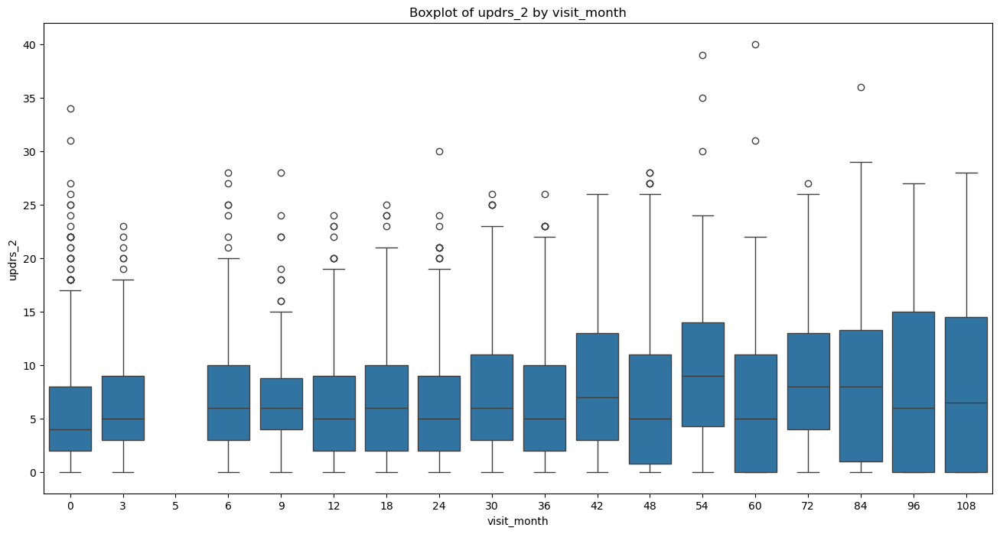

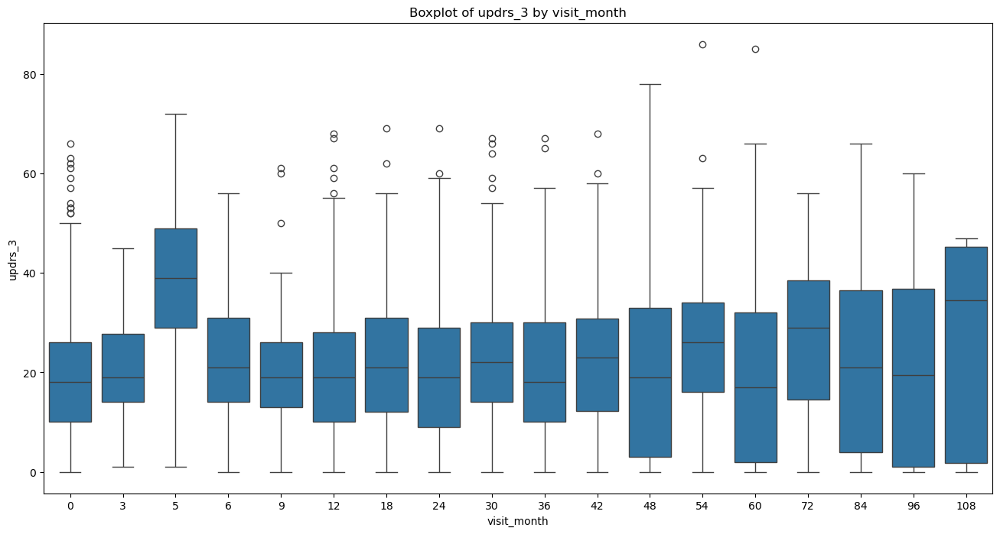

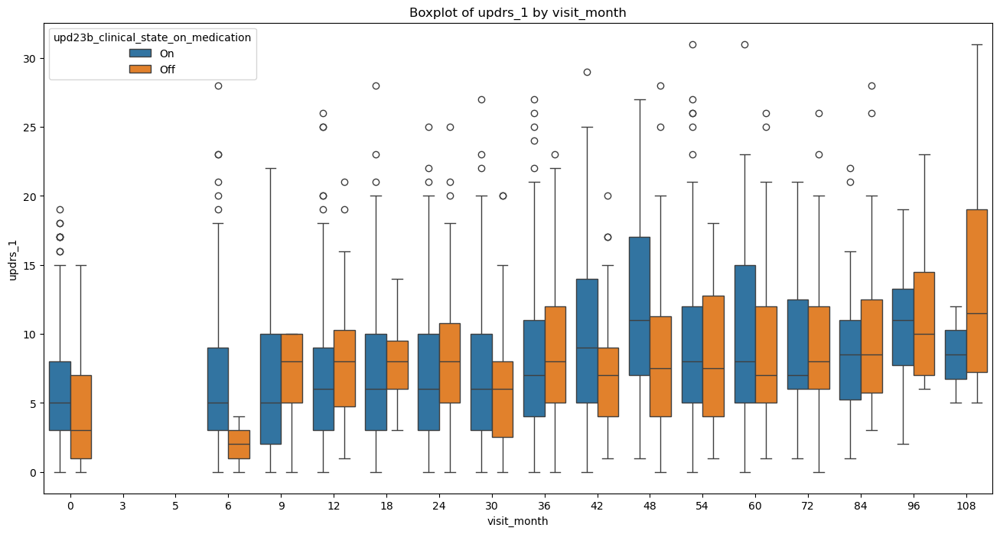

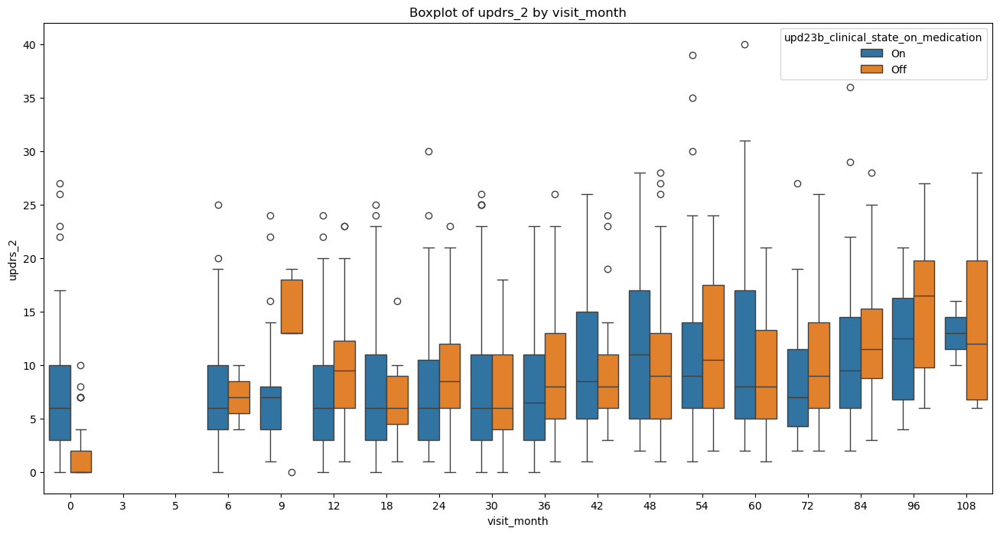

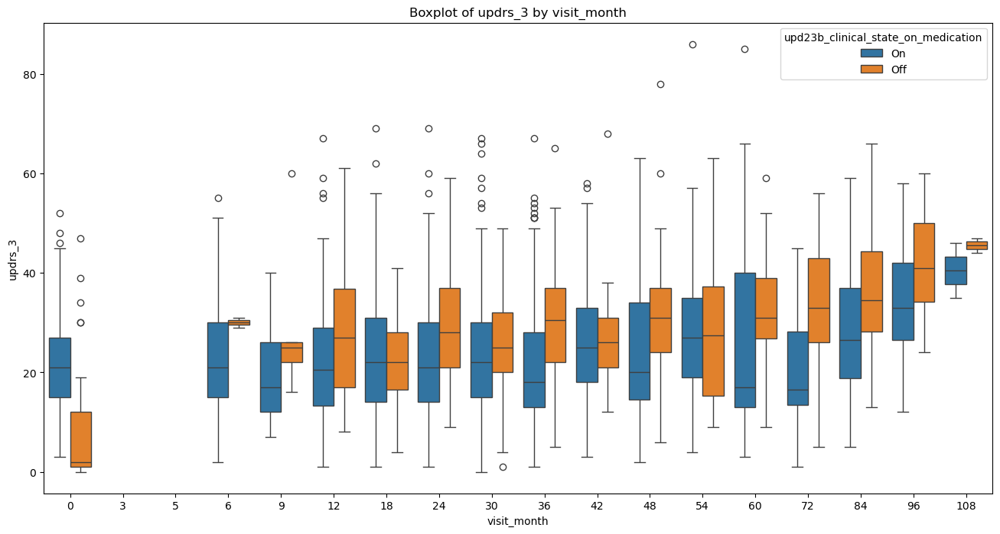

In [ ]:
def plot_boxplots_by_visit_month(data, updrs_col, medication_status_col=None):
    plt.figure(figsize=(16, 8))
    if medication_status_col:
        sns.boxplot(x="visit_month", y=updrs_col, hue=medication_status_col, data=data)
    else:
        sns.boxplot(x="visit_month", y=updrs_col, data=data)
    plt.title(f'Boxplot of {updrs_col} by visit_month')
    plt.show()

# Boxplots for each UPDRS score and visit_month without medication status
for updrs_col in ["updrs_1", "updrs_2", "updrs_3"]:
    plot_boxplots_by_visit_month(clinical_supplemental, updrs_col)

# Boxplots for each UPDRS score and visit_month with medication status
for updrs_col in ["updrs_1", "updrs_2", "updrs_3"]:
    plot_boxplots_by_visit_month(clinical_supplemental, updrs_col, medication_status_col="upd23b_clinical_state_on_medication")


In [ ]:
spearman_no_nan = clinical_supplemental.dropna(subset=['visit_month', 'updrs_1', 'updrs_2', 'updrs_3'])

for updrs_col in ["updrs_1", "updrs_2", "updrs_3"]:
    correlation, p_value = scipy.stats.spearmanr(spearman_no_nan['visit_month'], spearman_no_nan[updrs_col])
    print(f"Spearman's correlation between visit_month and {updrs_col} is: {correlation:.3f} with p-value: {p_value:.3f}")


Spearman's correlation between visit_month and updrs_1 is: 0.132 with p-value: 0.000
Spearman's correlation between visit_month and updrs_2 is: 0.073 with p-value: 0.000
Spearman's correlation between visit_month and updrs_3 is: 0.030 with p-value: 0.041


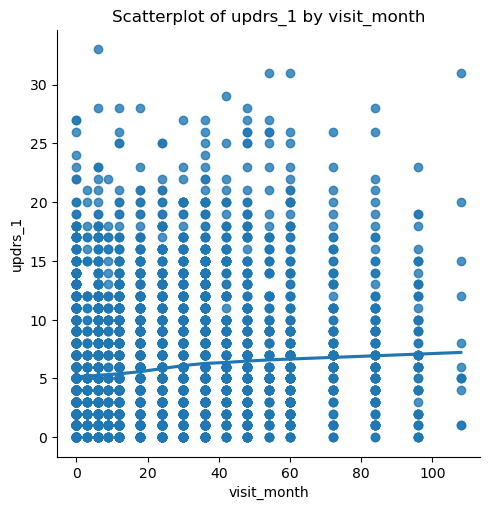

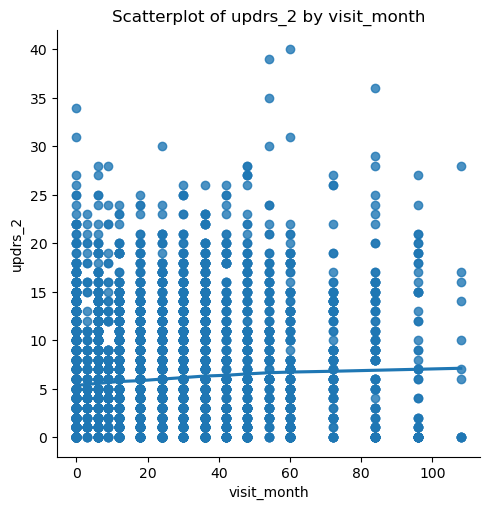

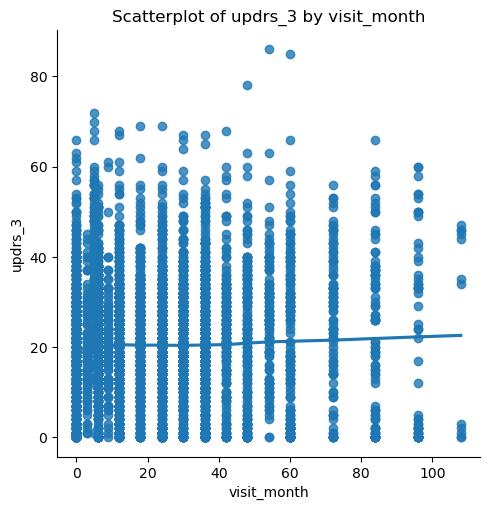

In [ ]:
# Scatter plots
for updrs_col in ["updrs_1", "updrs_2", "updrs_3"]:
    sns.lmplot(x="visit_month", y=updrs_col, data=clinical_supplemental, lowess=True)
    plt.title(f'Scatterplot of {updrs_col} by visit_month')
    plt.show()


# Effect of medication status

## All months combined

### Basic statistics & information

In [ ]:
# Assigning 'Unknown' if medication status is NaN

clinical_supplemental['upd23b_clinical_state_on_medication'] = clinical_supplemental['upd23b_clinical_state_on_medication'].fillna('Unknown')

In [ ]:
clinical_supplemental_stats = clinical_supplemental.groupby("upd23b_clinical_state_on_medication")[updrs_scores].agg(["count", "mean", "median", "std", "min", "max"])

clinical_supplemental_stats

updrs_1                                  \
                                      count      mean median       std  min   
upd23b_clinical_state_on_medication                                           
Off                                     542  8.470480    7.5  5.515066  0.0   
On                                     1868  7.398287    6.0  5.496733  0.0   
Unknown                                2214  5.239837    4.0  4.273926  0.0   

                                          updrs_2                             \
                                      max   count      mean median       std   
upd23b_clinical_state_on_medication                                            
Off                                  31.0     542  9.518450    8.0  6.139373   
On                                   31.0    1867  7.913765    7.0  5.723305   
Unknown                              33.0    2213  4.862630    3.0  5.122206   

                                     ... updrs_3                        \
                                     ...  median        std  min   max   
upd23b_clinical_state_on_medication  ...                                 
Off                                  ...    30.0  13.499654  0.0  78.0   
On                                   ...    21.0  11.950132  0.0  86.0   
Unknown                              ...    17.0  14.351474  0.0  72.0   

                                    updrs_4                                  \
                                      count      mean median       std  min   
upd23b_clinical_state_on_medication                                           
Off                                     506  1.986166    0.0  2.690248  0.0   
On                                     1579  1.512350    0.0  2.822877  0.0   
Unknown                                 787  0.801779    0.0  1.923829  0.0   

                                           
                                      max  
upd23b_clinical_state_on_medication        
Off                                  13.0  
On                                   20.0  
Unknown                              12.0  

[3 rows x 24 columns]

In [ ]:
nan_counts_clinical_supplemental = clinical_supplemental[updrs_scores].isna().sum()
total_samples = len(clinical_supplemental)
for score, count in nan_counts_clinical_supplemental.items():
    percentage = (count / total_samples) * 100
    print(f"The number of NaN values for {score} is {count} ({percentage:.2f}% of total)")


The number of NaN values for updrs_1 is 214 (4.42% of total)
The number of NaN values for updrs_2 is 216 (4.46% of total)
The number of NaN values for updrs_3 is 30 (0.62% of total)
The number of NaN values for updrs_4 is 1966 (40.64% of total)


### Distribution of UPDRS scores

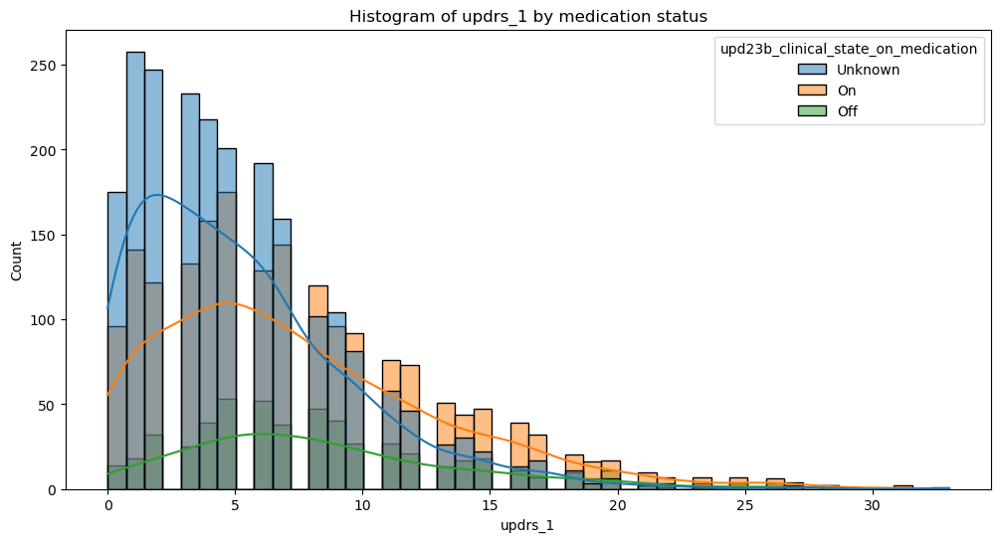

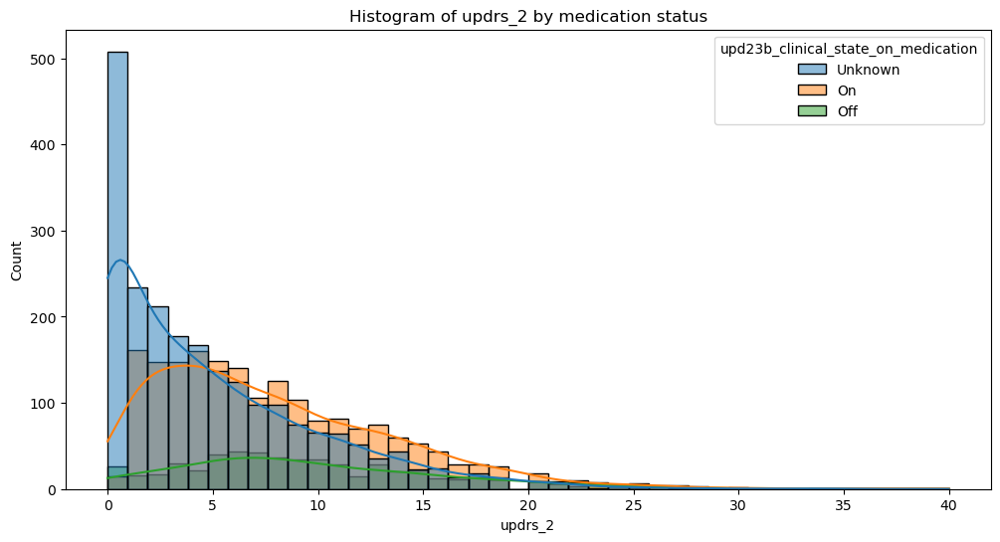

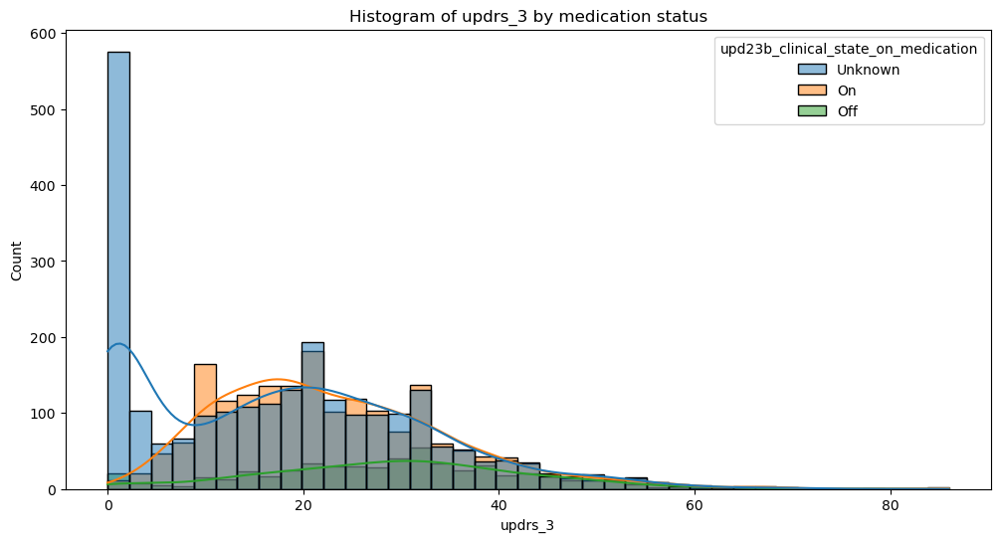

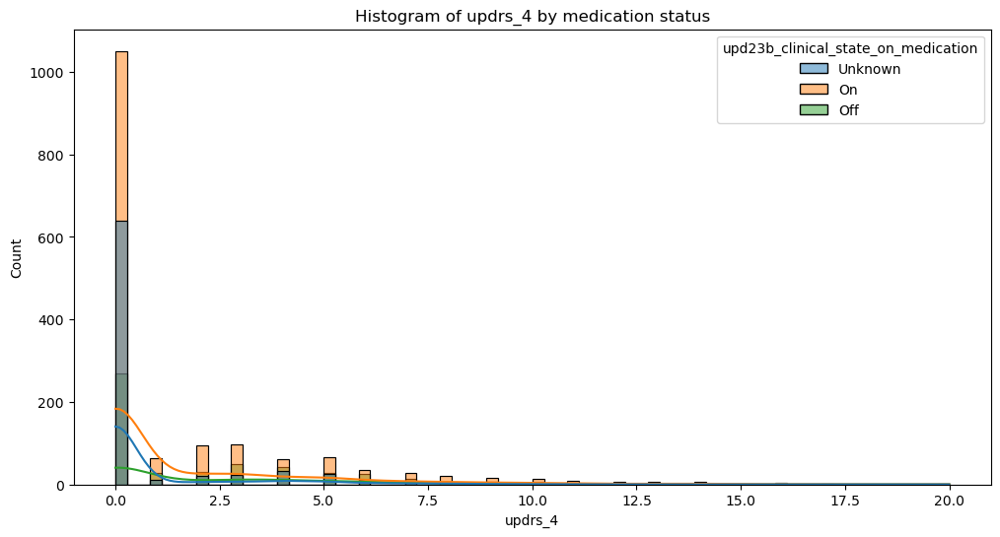

In [ ]:
def plot_histograms(data, updrs_col):
    plt.figure(figsize=(12, 6))
    sns.histplot(data, x=updrs_col, hue="upd23b_clinical_state_on_medication", kde=True, common_norm=False)
    plt.title(f'Histogram of {updrs_col} by medication status')
    plt.show()

for updrs_col in ["updrs_1", "updrs_2", "updrs_3", "updrs_4"]:
    plot_histograms(clinical_supplemental, updrs_col)


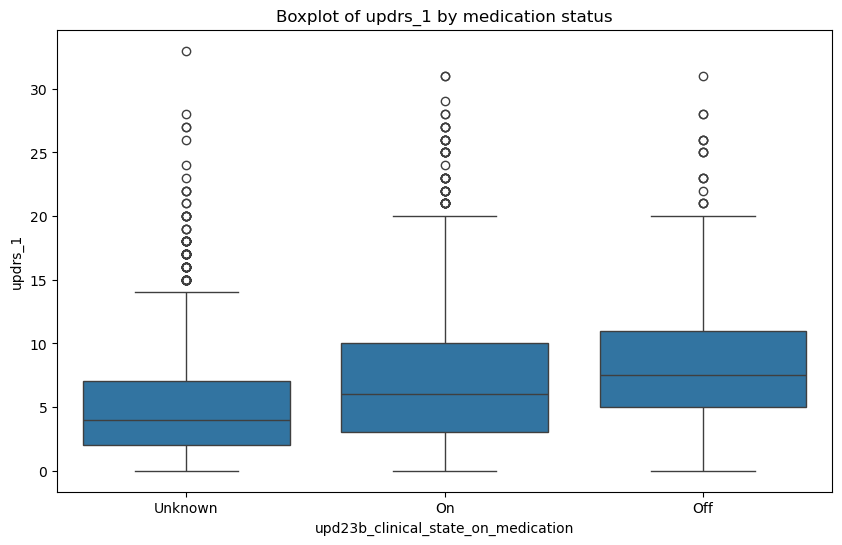

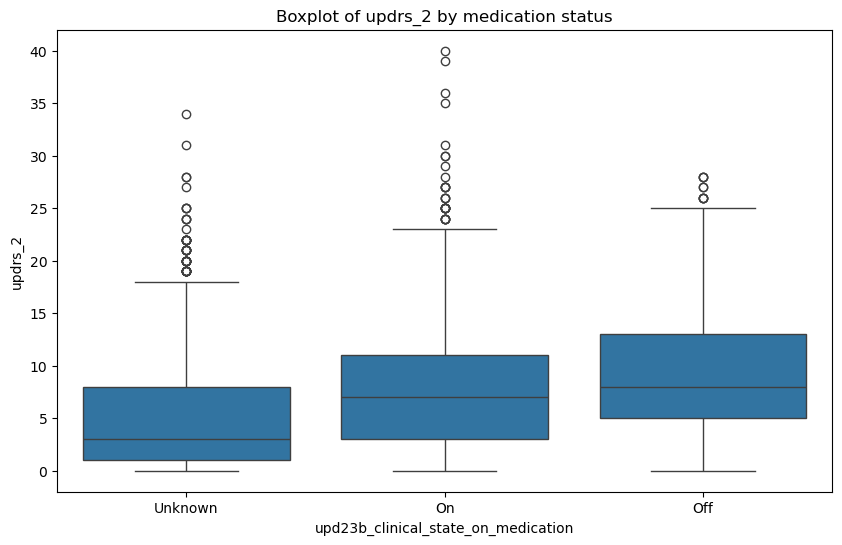

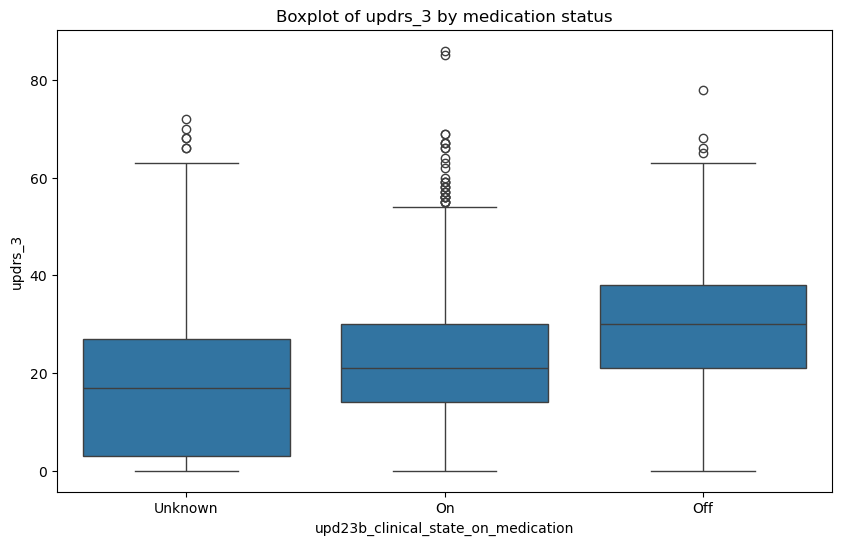

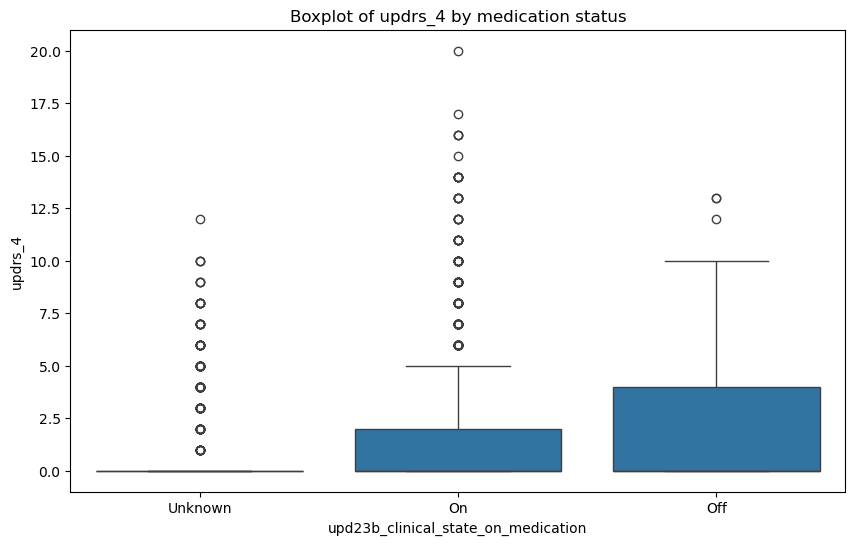

In [ ]:
def plot_boxplots(data, updrs_col):
    plt.figure(figsize=(10, 6))
    sns.boxplot(x="upd23b_clinical_state_on_medication", y=updrs_col, data=data)
    plt.title(f'Boxplot of {updrs_col} by medication status')
    plt.show()

for updrs_col in ["updrs_1", "updrs_2", "updrs_3", "updrs_4"]:
    plot_boxplots(clinical_supplemental, updrs_col)

In [ ]:
off_patients = clinical_supplemental[clinical_supplemental['upd23b_clinical_state_on_medication'] == 'Off']['patient_id'].unique()

on_off_patients = clinical_supplemental[(clinical_supplemental['patient_id'].isin(off_patients)) & (clinical_supplemental['upd23b_clinical_state_on_medication'] == 'On')]['patient_id'].unique()

num_on_off_patients = len(on_off_patients)

print(f"Number of patients who have both 'On' and 'Off' medication statuses: {num_on_off_patients}")


Number of patients who have both 'On' and 'Off' medication statuses: 114


In [ ]:
clinical_supplemental.patient_id.nunique()

1019

In [ ]:
# Interesting. Medication status Unknown has lower updrs scores than On and Off. I assume a large part of Unknown patients are at an early stage of the disease, or simply free from it.

### Normality test & assessment if differences between UPDRS scores are statistically significant

In [ ]:
clinical_supplemental

,visit_id,patient_id,visit_month,updrs_1,updrs_2,updrs_3,updrs_4,upd23b_clinical_state_on_medication
0,55_0,55,0,10.0,6.0,15.0,NaN,Unknown
1,55_3,55,3,10.0,7.0,25.0,NaN,Unknown
2,55_6,55,6,8.0,10.0,34.0,NaN,Unknown
3,55_9,55,9,8.0,9.0,30.0,0.0,On
4,55_12,55,12,10.0,10.0,41.0,0.0,On
...,...,...,...,...,...,...,...,...
4833,65382_0,65382,0,NaN,NaN,0.0,NaN,Unknown
4834,65405_0,65405,0,5.0,16.0,31.0,0.0,Unknown
4835,65405_5,65405,5,NaN,NaN,57.0,NaN,Unknown
4836,65530_0,65530,0,10.0,6.0,24.0,0.0,Unknown


In [ ]:
# Function to perform the Shapiro-Wilk test for each UPDRS score by medication status
def perform_shapiro_test(data, updrs_col, med_status):
    print(f'Shapiro-Wilk test for {updrs_col}:')
    for status in med_status:
        data_med_status = data[data["upd23b_clinical_state_on_medication"] == status][updrs_col].dropna()  # Drop missing values
        stat, p = shapiro(data_med_status)
        print(f'  {status}: W={stat:.3f}, p={p:.3f}')

# Perform Shapiro-Wilk test
med_status = ['On', 'Off', 'Unknown']
for updrs_col in ["updrs_1", "updrs_2", "updrs_3", "updrs_4"]:
    perform_shapiro_test(clinical_supplemental, updrs_col, med_status)
    print()



Shapiro-Wilk test for updrs_1:
  On: W=0.928, p=0.000
  Off: W=0.936, p=0.000
  Unknown: W=0.899, p=0.000

Shapiro-Wilk test for updrs_2:
  On: W=0.917, p=0.000
  Off: W=0.958, p=0.000
  Unknown: W=0.854, p=0.000

Shapiro-Wilk test for updrs_3:
  On: W=0.957, p=0.000
  Off: W=0.994, p=0.020
  Unknown: W=0.934, p=0.000

Shapiro-Wilk test for updrs_4:
  On: W=0.612, p=0.000
  Off: W=0.763, p=0.000
  Unknown: W=0.484, p=0.000



In [ ]:
# Function to perform the Kruskal-Wallis test
def perform_kruskal_test(data, updrs_col, med_status):
    groups = [data[data["upd23b_clinical_state_on_medication"] == status][updrs_col].dropna() for status in med_status]  # Drop missing values
    stat, p = kruskal(*groups)
    print(f'Kruskal-Wallis test for {updrs_col}: H={stat:.3f}, p={p:.3f}')

# Kruskal-Wallis test
for updrs_col in ["updrs_1", "updrs_2", "updrs_3", "updrs_4"]:
    perform_kruskal_test(clinical_supplemental, updrs_col, med_status)

Kruskal-Wallis test for updrs_1: H=269.134, p=0.000
Kruskal-Wallis test for updrs_2: H=543.617, p=0.000
Kruskal-Wallis test for updrs_3: H=393.521, p=0.000
Kruskal-Wallis test for updrs_4: H=109.740, p=0.000


In [ ]:
# Perform post-hoc Dunn's test
def perform_dunn_test(data, updrs_col):
    print(f"Dunn's test for {updrs_col}:")
    data_notna = data[~data[updrs_col].isna()]
    posthoc = sp.posthoc_dunn(data_notna, val_col=updrs_col, group_col='upd23b_clinical_state_on_medication', p_adjust='bonferroni')
    print(posthoc)

# Perform Dunn's test for each UPDRS score
for updrs_col in ["updrs_1", "updrs_2", "updrs_3", "updrs_4"]:
    perform_dunn_test(clinical_supplemental, updrs_col)
    print()


Dunn's test for updrs_1:
                  Off            On       Unknown
Off      1.000000e+00  7.407828e-06  2.713304e-40
On       7.407828e-06  1.000000e+00  1.291486e-38
Unknown  2.713304e-40  1.291486e-38  1.000000e+00

Dunn's test for updrs_2:
                  Off            On       Unknown
Off      1.000000e+00  2.520782e-06  4.407741e-71
On       2.520782e-06  1.000000e+00  2.433286e-85
Unknown  4.407741e-71  2.433286e-85  1.000000e+00

Dunn's test for updrs_3:
                  Off            On       Unknown
Off      1.000000e+00  1.184545e-19  9.914206e-72
On       1.184545e-19  1.000000e+00  5.585123e-39
Unknown  9.914206e-72  5.585123e-39  1.000000e+00

Dunn's test for updrs_4:
                  Off            On       Unknown
Off      1.000000e+00  9.432978e-08  2.406621e-24
On       9.432978e-08  1.000000e+00  1.046549e-11
Unknown  2.406621e-24  1.046549e-11  1.000000e+00



### Survival analysis

In [ ]:
# The idea is to assess relation between medication status, visit_month, and updrs_2 and 3, since these will be the ones mostly responding to medication (levodopa).

In [ ]:
# Create a copy of the original data
clinical_supplemental_cox = clinical_supplemental.copy()

clinical_supplemental_cox = clinical_supplemental_cox.drop(columns=['updrs_4'])

# Impute missing values for updrs scores using interpolation
clinical_supplemental_cox[['updrs_1', 'updrs_2', 'updrs_3']] = clinical_supplemental_cox.groupby('patient_id')[['updrs_1', 'updrs_2', 'updrs_3']].transform(lambda group: group.interpolate())

# Drop any remaining NaNs
clinical_supplemental_cox = clinical_supplemental_cox.dropna(subset=['updrs_1', 'updrs_2', 'updrs_3'])

# Create a new column 'medication_started' where 'On' in 'upd23b_clinical_state_on_medication' is 1, and everything else is 0
clinical_supplemental_cox['medication_started'] = np.where(clinical_supplemental_cox['upd23b_clinical_state_on_medication']=='On', 1, 0)

# For each patient, find the first 'On' in 'medication_started'
clinical_supplemental_cox['first_medication_start'] = clinical_supplemental_cox.groupby('patient_id')['medication_started'].transform('cumsum')

# Keep only the rows up to and including the first 'On'
clinical_supplemental_cox = clinical_supplemental_cox[clinical_supplemental_cox['first_medication_start'] <= 1]

# Drop unnecessary columns
clinical_supplemental_cox = clinical_supplemental_cox.drop(columns=['first_medication_start', 'upd23b_clinical_state_on_medication'])


In [ ]:
# Instantiate the Cox model, fit
cph = CoxPHFitter()

cph.fit(clinical_supplemental_cox, duration_col='visit_month', event_col='medication_started')

cph.print_summary()


<lifelines.CoxPHFitter: fitted with 3152 total observations, 2561 right-censored observations>
             duration col = 'visit_month'
                event col = 'medication_started'
      baseline estimation = breslow
   number of observations = 3152
number of events observed = 591
   partial log-likelihood = -4023.87
         time fit was run = 2024-02-05 08:15:12 UTC

---
             coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                          
visit_id    -0.00       1.00       0.00            -0.00            -0.00                 1.00                 1.00
patient_id   0.00       1.00       0.00             0.00             0.00                 1.00                 1.00
updrs_1     -0.01       0.99       0.01            -0.04             0.01                 0.97                 1.01
updrs_2      0.05       1.05       0.01             0.03             0.07                 1.03                 1.07
updrs_3      0.01       1.01       0.00             0.00             0.02                 1.00                 1.02

             cmp to      z      p   -log2(p)
covariate                                   
visit_id       0.00 -15.46 <0.005     176.65
patient_id     0.00  14.09 <0.005     147.42
updrs_1        0.00  -1.17   0.24       2.04
updrs_2        0.00   4.53 <0.005      17.39
updrs_3        0.00   2.92 <0.005       8.17
---
Concordance = 0.76
Partial AIC = 8057.73
log-likelihood ratio test = 375.64 on 5 df
-log2(p) of ll-ratio test = 260.04

Text(0.5, 1.0, 'Partial effects of UPDRS-3 on survival function')

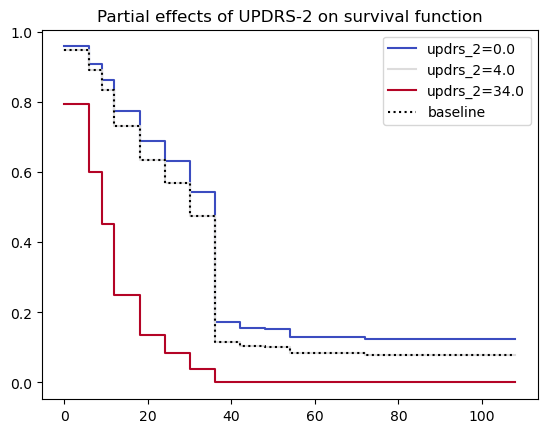

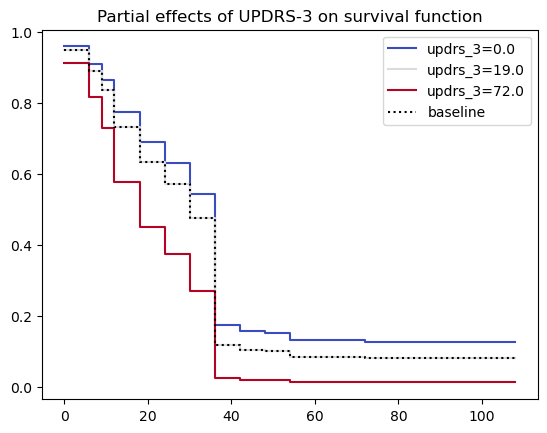

In [ ]:
# Schoenfeld Residuals for UPDRS-2
cph.plot_partial_effects_on_outcome('updrs_2', values=[clinical_supplemental_cox['updrs_2'].min(), clinical_supplemental_cox['updrs_2'].median(), clinical_supplemental_cox['updrs_2'].max()], cmap='coolwarm')
plt.title('Partial effects of UPDRS-2 on survival function')

# Schoenfeld Residuals for UPDRS-3
cph.plot_partial_effects_on_outcome('updrs_3', values=[clinical_supplemental_cox['updrs_3'].min(), clinical_supplemental_cox['updrs_3'].median(), clinical_supplemental_cox['updrs_3'].max()], cmap='coolwarm')
plt.title('Partial effects of UPDRS-3 on survival function')

In [ ]:
print("Minimum UPDRS scores:")
print(clinical_supplemental_cox[['updrs_1', 'updrs_2', 'updrs_3']].min())

print("\nMedian UPDRS scores:")
print(clinical_supplemental_cox[['updrs_1', 'updrs_2', 'updrs_3']].median())

print("\nMaximum UPDRS scores:")
print(clinical_supplemental_cox[['updrs_1', 'updrs_2', 'updrs_3']].max())


Minimum UPDRS scores:
updrs_1    0.0
updrs_2    0.0
updrs_3    0.0
dtype: float64

Median UPDRS scores:
updrs_1     5.0
updrs_2     4.0
updrs_3    19.0
dtype: float64

Maximum UPDRS scores:
updrs_1    33.0
updrs_2    34.0
updrs_3    72.0
dtype: float64


In [ ]:
clinical_supplemental_cox

,visit_id,patient_id,visit_month,updrs_1,updrs_2,updrs_3,medication_started
0,55_0,55,0,10.0,6.0,15.0,0
1,55_3,55,3,10.0,7.0,25.0,0
2,55_6,55,6,8.0,10.0,34.0,0
3,55_9,55,9,8.0,9.0,30.0,1
13,942_0,942,0,3.0,2.0,20.0,0
...,...,...,...,...,...,...,...
4832,65303_36,65303,36,4.0,1.0,26.0,0
4834,65405_0,65405,0,5.0,16.0,31.0,0
4835,65405_5,65405,5,5.0,16.0,57.0,0
4836,65530_0,65530,0,10.0,6.0,24.0,0


In [ ]:
medians = {
    'updrs_1': 5.0,
    'updrs_2': 4.0,
    'updrs_3': 19.0
}

for score in ['updrs_1', 'updrs_2', 'updrs_3']:
    clinical_supplemental_cox[f'{score}_category'] = np.where(clinical_supplemental_cox[score] <= medians[score], 'below_median', 'above_median')

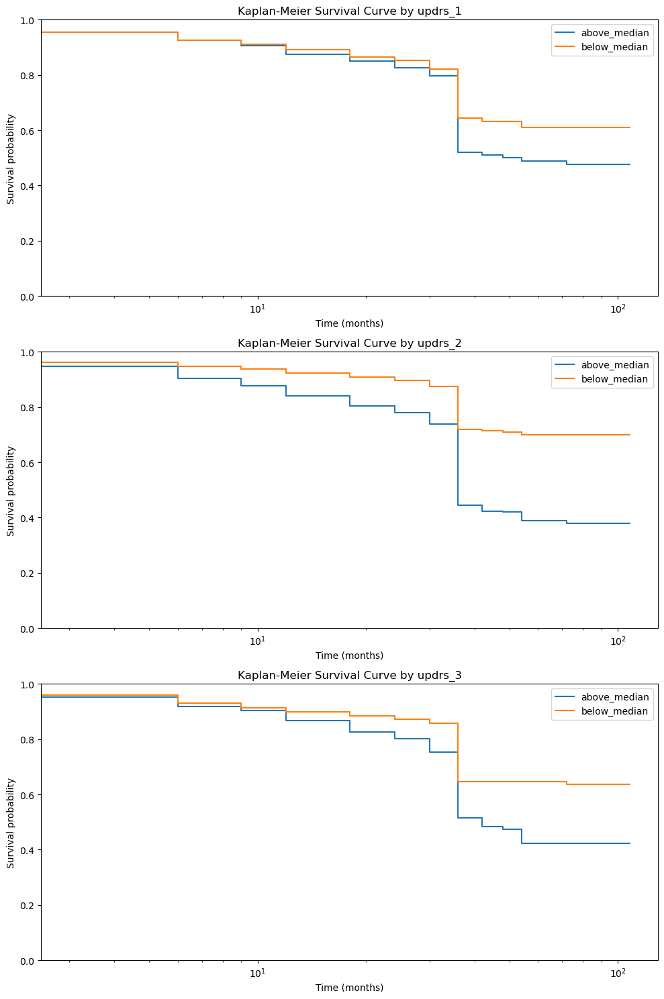

In [ ]:
fig, axes = plt.subplots(nrows=3, figsize=(10, 15))
axes = axes.flatten()

for i, score in enumerate(['updrs_1', 'updrs_2', 'updrs_3']):
    kmf = KaplanMeierFitter()

    for category, grouped_df in clinical_supplemental_cox.groupby(f"{score}_category"):
        kmf.fit(grouped_df["visit_month"], grouped_df["medication_started"], label=str(category))
        kmf.plot(ax=axes[i], ci_show=False)

    axes[i].set_title(f"Kaplan-Meier Survival Curve by {score}")
    axes[i].set_xlabel('Time (months)')
    axes[i].set_ylabel('Survival probability')
    axes[i].set_ylim(0, 1)  # Set y limits to explicitly show 0-1 range
    axes[i].set_xscale('log')  # Using logarithmic scale for the x-axis

plt.tight_layout()
plt.show()


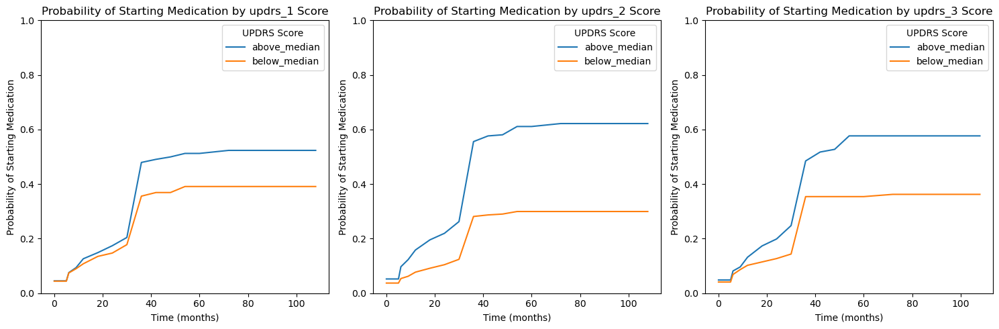

In [ ]:
fig, axes = plt.subplots(1, 3, figsize=(15,5))
axes = axes.flatten()

for i, score in enumerate(['updrs_1', 'updrs_2', 'updrs_3']):
    kmf = KaplanMeierFitter()

    for category, grouped_df in clinical_supplemental_cox.groupby(f"{score}_category"):
        kmf.fit(grouped_df["visit_month"], grouped_df["medication_started"])
        survival_function = kmf.survival_function_

        complementary_probability = 1 - survival_function

        axes[i].plot(complementary_probability, label=str(category))
        axes[i].set_title(f'Probability of Starting Medication by {score} Score')
        axes[i].set_xlabel('Time (months)')
        axes[i].set_ylabel('Probability of Starting Medication')
        axes[i].legend(title='UPDRS Score')
        axes[i].set_ylim([0, 1])

plt.tight_layout()
plt.show()


# Exploring protein information

## Setting up Uniprot API

In [ ]:
# Documentation: https://www.uniprot.org/help/api
WEBSITE_API = "https://rest.uniprot.org/"

# Documentation: https://www.ebi.ac.uk/proteins/api/doc/
PROTEINS_API = "https://www.ebi.ac.uk/proteins/api"

# Helper function
def get_url(url, **kwargs):
  response = requests.get(url, **kwargs);

  if not response.ok:
    print(response.text)
    response.raise_for_status()
    sys.exit()

  return response

### Fetching basic information

In [ ]:
def fetch_uniprot_data(uniprot_id):
    base_url = "https://www.uniprot.org/uniprot/"
    response = requests.get(f"{base_url}{uniprot_id}.txt")
    data = response.text.split('\n')  # split the response into lines
    function_text = ''
    protein_name = ''
    gene_name = ''
    record = False
    for line in data:
        if line.startswith('DE   RecName: Full='):
            protein_name = line.split('=')[1].split('{')[0].strip()
        if line.startswith('GN   Name='):
            gene_name = line.split('=')[1].split(';')[0].split('{')[0].strip()
        if line.startswith('CC   -!- FUNCTION: '):
            record = True
            function_text += line[19:] + ' '
        elif line.startswith('CC   -!- '):
            record = False
        elif record:
            function_text += line[5:] + ' '

    # Remove extra spaces
    function_text = ' '.join(function_text.split())

    return protein_name, gene_name, function_text.strip()


In [ ]:
uniprot_id = "P02647"
protein_name, gene_name, function = fetch_uniprot_data(uniprot_id)
print(f"Protein Name: {protein_name}")
print(f"Gene Name: {gene_name}")
print(f"Function: {function}")


Protein Name: Apolipoprotein A-I
Gene Name: APOA1
Function: Participates in the reverse transport of cholesterol from tissues to the liver for excretion by promoting cholesterol efflux from tissues and by acting as a cofactor for the lecithin cholesterol acyltransferase (LCAT). As part of the SPAP complex, activates spermatozoa motility. {ECO:0000269|PubMed:1909888}.


### Protein information

In [ ]:
# List of proteins on my dataset that I have queried on UniProt. This was done in another notebook.
proteins_uniprot = pd.read_excel('prot_uniprot.xlsx')

In [ ]:
proteins_uniprot

,From,Entry,Reviewed,Entry Name,Protein names,Gene Names,Length,Mass,Mass spectrometry,Natural variant,...,Compositional bias,Domain [CC],Domain [FT],Motif,Zinc finger,Repeat,Region,Protein families,AlphaFoldDB,Gene Ontology (biological process)
0,O00391,O00391,reviewed,QSOX1_HUMAN,Sulfhydryl oxidase 1 (hQSOX) (EC 1.8.3.2) (Qui...,QSOX1 QSCN6 UNQ2520/PRO6013,747,82578,NaN,"VARIANT 114; /note=""N -> S (in dbSNP:rs3894211...",...,NaN,NaN,"DOMAIN 36..156; /note=""Thioredoxin""; /evidence...",NaN,NaN,NaN,"REGION 573..633; /note=""Disordered""; /evidence...",Quiescin-sulfhydryl oxidase (QSOX) family,O00391;,extracellular matrix assembly [GO:0085029]; ne...
1,O00533,O00533,reviewed,NCHL1_HUMAN,Neural cell adhesion molecule L1-like protein ...,CHL1 CALL,1208,135071,NaN,"VARIANT 17; /note=""L -> F (in dbSNP:rs2272522)...",...,"COMPBIAS 1131..1148; /note=""Basic and acidic r...",DOMAIN: The FIG[AQ]Y motif seems to be an anky...,"DOMAIN 35..124; /note=""Ig-like C2-type 1""; DOM...","MOTIF 555..558; /note=""DGEA""; MOTIF 1181..1185...",NaN,NaN,"REGION 693..716; /note=""Disordered""; /evidence...","Immunoglobulin superfamily, L1/neurofascin/NgC...",O00533;,adult locomotory behavior [GO:0008344]; axon g...
2,O00584,O00584,reviewed,RNT2_HUMAN,Ribonuclease T2 (EC 4.6.1.19) (Ribonuclease 6),RNASET2 RNASE6PL,256,29481,NaN,"VARIANT 184; /note=""C -> R (in LCWM; the loss ...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,RNase T2 family,O00584;,innate immune response [GO:0045087]; RNA catab...
3,O14498,O14498,reviewed,ISLR_HUMAN,Immunoglobulin superfamily containing leucine-...,ISLR UNQ189/PRO215,428,45997,NaN,"VARIANT 183; /note=""D -> N (in a colorectal ca...",...,NaN,NaN,"DOMAIN 19..50; /note=""LRRNT""; DOMAIN 180..231;...",NaN,NaN,"REPEAT 51..72; /note=""LRR 1""; REPEAT 75..96; /...",NaN,NaN,O14498;,cell adhesion [GO:0007155]
4,O14773,O14773,reviewed,TPP1_HUMAN,Tripeptidyl-peptidase 1 (TPP-1) (EC 3.4.14.9) ...,TPP1 CLN2 GIG1 UNQ267/PRO304,563,61248,NaN,"VARIANT 62; /note=""S -> L (in dbSNP:rs2734715)...",...,NaN,NaN,"DOMAIN 199..563; /note=""Peptidase S53""",NaN,NaN,NaN,NaN,NaN,O14773;,bone resorption [GO:0045453]; central nervous ...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
222,P60174,P60174,reviewed,TPIS_HUMAN,Triosephosphate isomerase (TIM) (EC 5.3.1.1) (...,TPI1 TPI,249,26669,NaN,"VARIANT 42; /note=""C -> Y (in TPID; dbSNP:rs12...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Triosephosphate isomerase family,P60174;,canonical glycolysis [GO:0061621]; gluconeogen...
223,Q13449,Q13449,reviewed,LSAMP_HUMAN,Limbic system-associated membrane protein (LSA...,LSAMP IGLON3 LAMP,338,37393,NaN,"VARIANT 225; /note=""K -> E""; /evidence=""ECO:00...",...,NaN,NaN,"DOMAIN 29..122; /note=""Ig-like C2-type 1""; DOM...",NaN,NaN,NaN,NaN,"Immunoglobulin superfamily, IgLON family",Q13449;,cell adhesion [GO:0007155]; nervous system dev...
224,Q99683,Q99683,reviewed,M3K5_HUMAN,Mitogen-activated protein kinase kinase kinase...,MAP3K5 ASK1 MAPKKK5 MEKK5,1374,154537,NaN,"VARIANT 1006; /note=""G -> R (in dbSNP:rs456265...",...,NaN,NaN,"DOMAIN 680..938; /note=""Protein kinase""; /evid...",NaN,NaN,NaN,"REGION 68..87; /note=""Disordered""; /evidence=""...","Protein kinase superfamily, STE Ser/Thr protei...",Q99683;,apoptotic signaling pathway [GO:0097190]; cell...
225,Q99829,Q99829,reviewed,CPNE1_HUMAN,Copine-1 (Chromobindin 17) (Copine I),CPNE1 CPN1,537,59059,NaN,"VARIANT 211; /note=""Q -> R (in dbSNP:rs6579255...",...,NaN,DOMAIN: C2 domains are necessary for calcium-d...,"DOMAIN 1..114; /note=""C2 1""; /evidence=""ECO:00...",NaN,NaN,NaN,NaN,Copine family,Q99829;,cellular response to calcium ion [GO:0071277];...


In [ ]:
proteins_uniprot.columns

Index(['From', 'Entry', 'Reviewed', 'Entry Name', 'Protein names',
       'Gene Names', 'Length', 'Mass', 'Mass spectrometry', 'Natural variant',
       'Non-adjacent residues', 'RNA Editing', 'Sequence',
       'Alternative products (isoforms)', 'Alternative sequence',
       'Non-standard residue', 'Non-terminal residue', 'Polymorphism',
       'Fragment', 'Erroneous gene model prediction', 'Absorption',
       'Active site', 'Binding site', 'Catalytic activity', 'Cofactor',
       'DNA binding', 'EC number', 'Activity regulation',
       'Temperature dependence', 'Site', 'Rhea ID', 'Redox potential',
       'pH dependence', 'Pathway', 'Kinetics', 'Function [CC]',
       'Involvement in disease', 'Intramembrane', 'Subcellular location [CC]',
       'Topological domain', 'Transmembrane', 'Chain', 'Cross-link',
       'Disulfide bond', 'Glycosylation', 'Initiator methionine', 'Lipidation',
       'Signal peptide', 'Transit peptide', 'Post-translational modification',
       'Propeptide

## Protein scale & normality

### Scale - are the proteins in a log2 scale already?

In [ ]:
# Calculate the difference and division between the max and min values of 'NPX' for each protein
protein_diff = proteins.groupby('UniProt')['NPX'].apply(lambda x: x.max() - x.min())
protein_division = proteins.groupby('UniProt')['NPX'].apply(lambda x: x.max() / x.min())

# Sort the differences
sorted_diff = protein_diff.sort_values(ascending=False)
sorted_division = protein_division.sort_values(ascending=False)

# Get the top 10 proteins with the highest difference
top_10_diff = sorted_diff.index[:10]

# Get the top 10 proteins with the highest division
top_10_division = sorted_division.index[:10]

# Top 10 proteins with the highest difference
print("Top 10 proteins with the highest difference:")
for protein in top_10_diff:
    difference = protein_diff[protein]
    print(f"Protein: {protein}, Difference: {difference}")

# Top 10 proteins with the highest division
print("\nTop 10 proteins with the highest division:")
for protein in top_10_division:
    division = protein_division[protein]
    print(f"Protein: {protein}, Division: {division}")


Top 10 proteins with the highest difference:
Protein: P02768, Difference: 597118200.0
Protein: P02766, Difference: 132498833.0
Protein: P41222, Difference: 127924183.0
Protein: P02787, Difference: 73160895.0
Protein: P01034, Difference: 63492334.0
Protein: P01876, Difference: 35260576.7
Protein: P02649, Difference: 32010038.0
Protein: P01009, Difference: 27814933.0
Protein: P02647, Difference: 27104021.24
Protein: P00738, Difference: 22554290.4

Top 10 proteins with the highest division:
Protein: P01833, Division: 4128.86581315102
Protein: P16152, Division: 3303.168907280526
Protein: P02647, Division: 2986.4320678154286
Protein: P02751, Division: 1054.2659820028884
Protein: P00738, Division: 1044.7162372278988
Protein: P07998, Division: 1014.1359613734456
Protein: P01876, Division: 1007.7748241884688
Protein: P01861, Division: 678.6522571935454
Protein: P01860, Division: 508.9043767990637
Protein: P01024, Division: 477.84856065221055


In [ ]:
# They are not in log scale.

### Normality of proteins

In [ ]:
unique_proteins = proteins['UniProt'].unique()

normal_proteins = []

# Testing normality for each protein
for protein in unique_proteins:
    protein_data = proteins.loc[proteins['UniProt'] == protein, 'NPX']

    # Shapiro-Wilk test
    shapiro_test = stats.shapiro(protein_data)

    # If p-value > 0.05, the distribution is normal
    if shapiro_test.pvalue > 0.05:
        normal_proteins.append(protein)

# Proteins that have a normal distribution
print(normal_proteins)

['P04196', 'P08697', 'P23142', 'Q13283', 'Q14515']


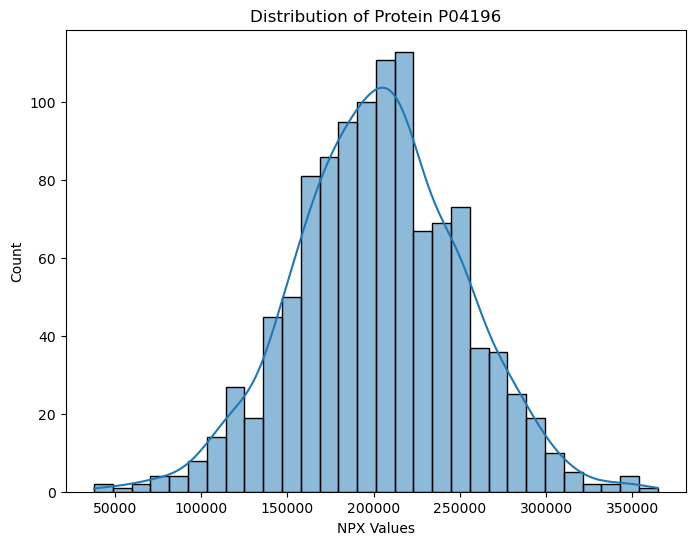

In [ ]:
# Plotting distribution for a protein - P04196
protein_id = 'P04196'
protein_data = proteins[proteins['UniProt'] == protein_id]

plt.figure(figsize=(8, 6))
sns.histplot(data=protein_data, x='NPX', kde=True, bins=30)
plt.xlabel('NPX Values')
plt.ylabel('Count')
plt.title(f'Distribution of Protein {protein_id}')
plt.show()

## Quality control

In [ ]:
proteins_clinical = pd.merge(proteins, clinical, on=['visit_id', 'patient_id', 'visit_month'])

In [ ]:
# Transform 'NPX' into log2 scale
proteins_clinical['NPX_log2'] = np.log2(proteins_clinical['NPX'])

In [ ]:
# Grouping by visit_id & summing
grouped_abundance = proteins_clinical.groupby('visit_id')['NPX_log2'].sum().reset_index()


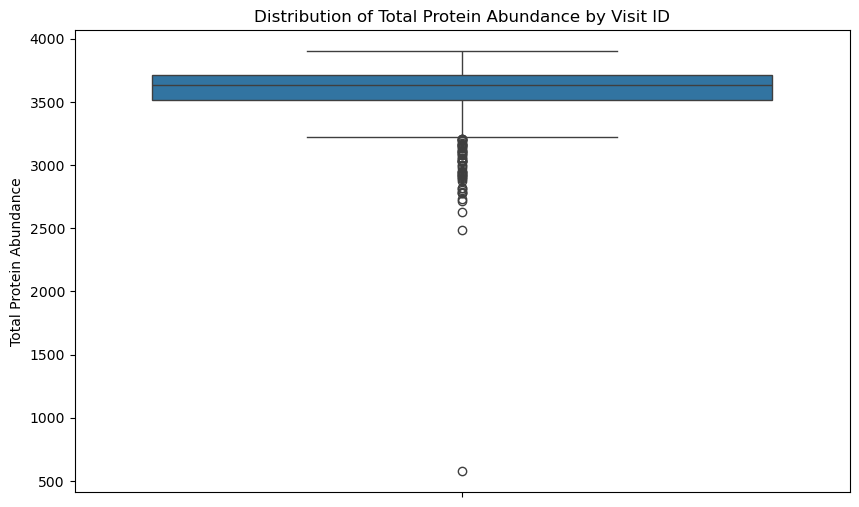

In [ ]:
plt.figure(figsize=(10,6))
sns.boxplot(y=grouped_abundance['NPX_log2'])
plt.title('Distribution of Total Protein Abundance by Visit ID')
plt.ylabel('Total Protein Abundance')
plt.show()


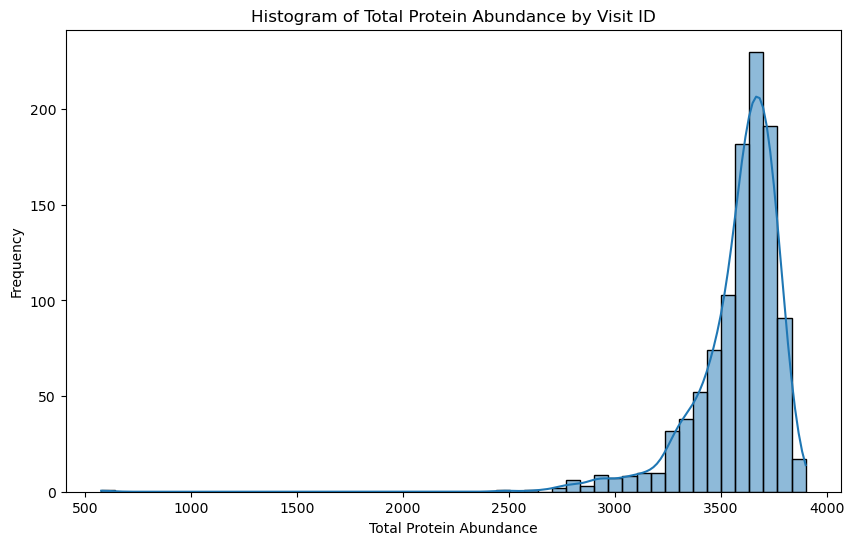

In [ ]:
plt.figure(figsize=(10,6))
sns.histplot(grouped_abundance['NPX_log2'], bins=50, kde=True)
plt.title('Histogram of Total Protein Abundance by Visit ID')
plt.xlabel('Total Protein Abundance')
plt.ylabel('Frequency')
plt.show()


In [ ]:
print(grouped_abundance['NPX_log2'].describe())


count    1068.000000
mean     3582.583378
std       214.603198
min       576.749690
25%      3514.516125
50%      3633.500596
75%      3713.127512
max      3901.322498
Name: NPX_log2, dtype: float64


In [ ]:
N = 10
print(grouped_abundance.nlargest(N, 'NPX_log2'))
print(grouped_abundance.nsmallest(N, 'NPX_log2'))


     visit_id     NPX_log2
701   49672_0  3901.322498
816     55_36  3890.940659
446   30951_0  3886.317790
447  30951_24  3871.234064
815     55_12  3870.487530
936  60326_24  3869.087671
664  46837_24  3867.071609
390  27715_48  3855.015949
151  16574_12  3853.846251
683   48780_0  3850.570534
      visit_id     NPX_log2
318   25562_36   576.749690
34     11928_0  2482.995342
200   18560_48  2631.444864
909   58648_84  2716.955993
883   57478_24  2727.047069
205   19088_48  2778.345583
905   58648_12  2780.469953
544   39719_36  2785.599208
203   19088_12  2804.631467
1005  63889_48  2818.363928


In [ ]:
proteins_clinical[proteins_clinical['visit_id'] == '25562_36']

,visit_id,visit_month,patient_id,UniProt,NPX,updrs_1,updrs_2,updrs_3,updrs_4,upd23b_clinical_state_on_medication,NPX_log2
145922,25562_36,36,25562,O15240,10717.40,4.0,1.0,11.0,0.0,On,13.387667
145923,25562_36,36,25562,P00738,21609.60,4.0,1.0,11.0,0.0,On,14.399385
145924,25562_36,36,25562,P01009,310367.00,4.0,1.0,11.0,0.0,On,18.243616
145925,25562_36,36,25562,P01011,58444.60,4.0,1.0,11.0,0.0,On,15.834782
145926,25562_36,36,25562,P01023,13811.60,4.0,1.0,11.0,0.0,On,13.753593
145927,25562_36,36,25562,P01024,15430.60,4.0,1.0,11.0,0.0,On,13.913507
145928,25562_36,36,25562,P01034,855366.00,4.0,1.0,11.0,0.0,On,19.706182
145929,25562_36,36,25562,P01042,6251.97,4.0,1.0,11.0,0.0,On,12.610095
145930,25562_36,36,25562,P01833,280268.00,4.0,1.0,11.0,0.0,On,18.096448
145931,25562_36,36,25562,P01834,26535.00,4.0,1.0,11.0,0.0,On,14.695609


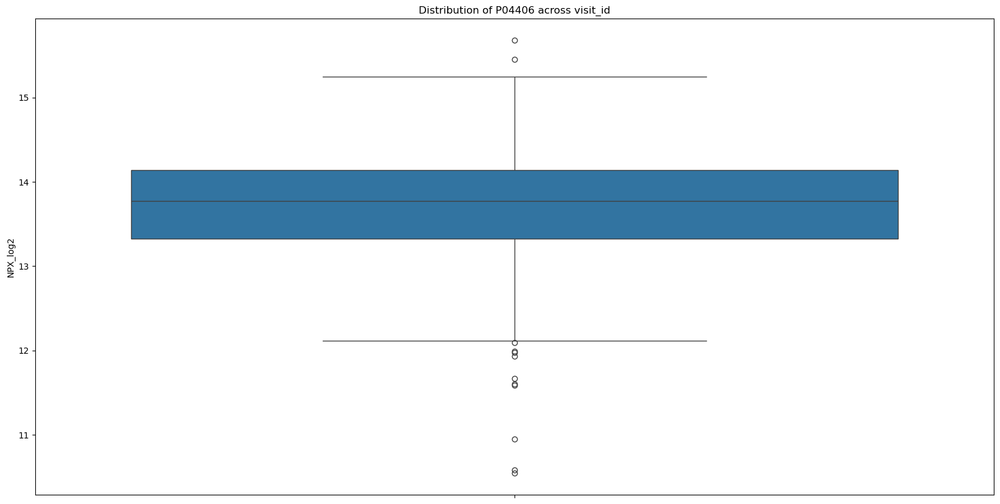

In [ ]:
# Filter for only the protein 'P04406'
protein_gapdh = proteins_clinical[proteins_clinical['UniProt'] == 'P04406']

plt.figure(figsize=(20,10))
sns.boxplot(y='NPX_log2', data=protein_gapdh)
plt.xticks(rotation=90)
plt.title('Distribution of P04406 across visit_id')
plt.show()

## List of blood markers from Karayel et al. - contaminants

In [ ]:
# Blood markers taken from Karayel et al, Cell Reports Medicine
blood_markers = pd.read_excel('blood_markers.xlsx')

In [ ]:
blood_markers.head(30)

,Type,Gene names,Protein IDs,Majority protein IDs,Protein names
0,Coagulation_Down,FGB,P02675;D6REL8,P02675;D6REL8,Fibrinogen beta chain;Fibrinopeptide B;Fibrino...
1,Coagulation_Down,CLU,P10909;P10909-4;P10909-5;P10909-2;P10909-3;H0Y...,P10909;P10909-4;P10909-5;P10909-2;P10909-3;H0Y...,Clusterin;Clusterin beta chain;Clusterin alpha...
2,Coagulation_Down,SERPINA5,P05154;G3V5Q9;G3V2M1;G3V264;G3V482;G3V265;G3V5...,P05154;G3V5Q9;G3V2M1,Plasma serine protease inhibitor
3,Coagulation_Down,F11,P03951;P03951-2;X6R3B1;D6RB32;H0Y596,P03951;P03951-2,Coagulation factor XI;Coagulation factor XIa h...
4,Coagulation_Down,APOC3,P02656;B0YIW2,P02656;B0YIW2,Apolipoprotein C-III
5,Coagulation_Down,ATRN,O75882;O75882-3;O75882-2;Q5VV63,O75882;O75882-3;O75882-2,Attractin
6,Coagulation_Down,GP5,P40197,P40197,Platelet glycoprotein V
7,Coagulation_Down,C1RL,Q9NZP8;H0YFL7;F5GWF3;F5H7C8;F5H6S5;F5H2Z5,Q9NZP8,Complement C1r subcomponent-like protein
8,Coagulation_Down,MAN1A1,P33908;P33908-2,P33908;P33908-2,"Mannosyl-oligosaccharide 1,2-alpha-mannosidase IA"
9,Coagulation_Down,FGG,P02679;C9JC84,P02679;C9JC84,Fibrinogen gamma chain


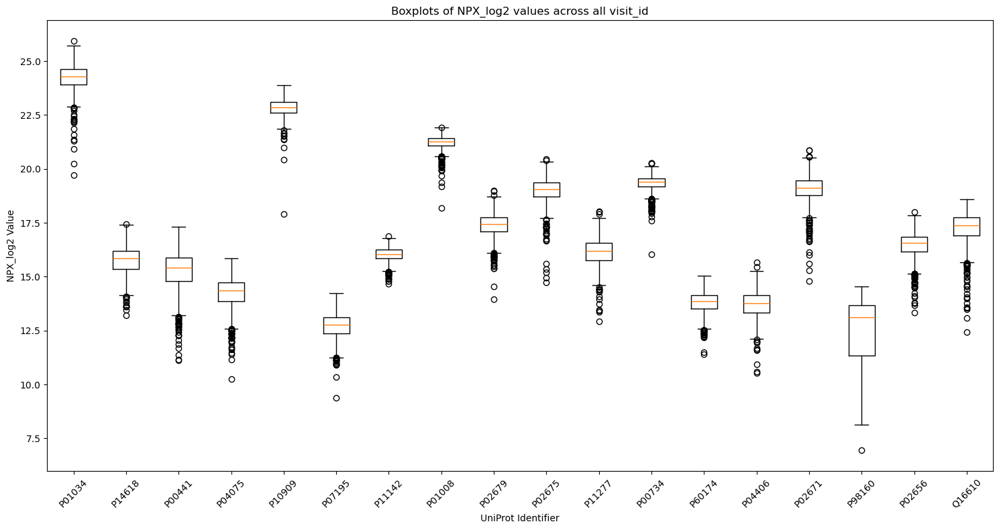

In [ ]:
# Plotting proteins from the dataframe above that appear in my dataset

identifiers = set()
pattern = re.compile(r'\b[a-zA-Z0-9]{6}\b')  # Regex for UniProt ID pattern

for ids in blood_markers['Majority protein IDs']:
    for id_ in ids.split(';'):
        if pattern.match(id_):
            identifiers.add(id_)


data_to_plot = []
labels = []

for identifier in identifiers:
    filtered_df = proteins_clinical[proteins_clinical['UniProt'] == identifier]
    if not filtered_df.empty:
        data_to_plot.append(filtered_df['NPX_log2'].values)
        labels.append(identifier)

# Plot the data
plt.figure(figsize=(15, 8))
plt.boxplot(data_to_plot, labels=labels)
plt.ylabel('NPX_log2 Value')
plt.xlabel('UniProt Identifier')
plt.title('Boxplots of NPX_log2 values across all visit_id')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


## Filtering

### Exploring distribution of number of proteins per patient

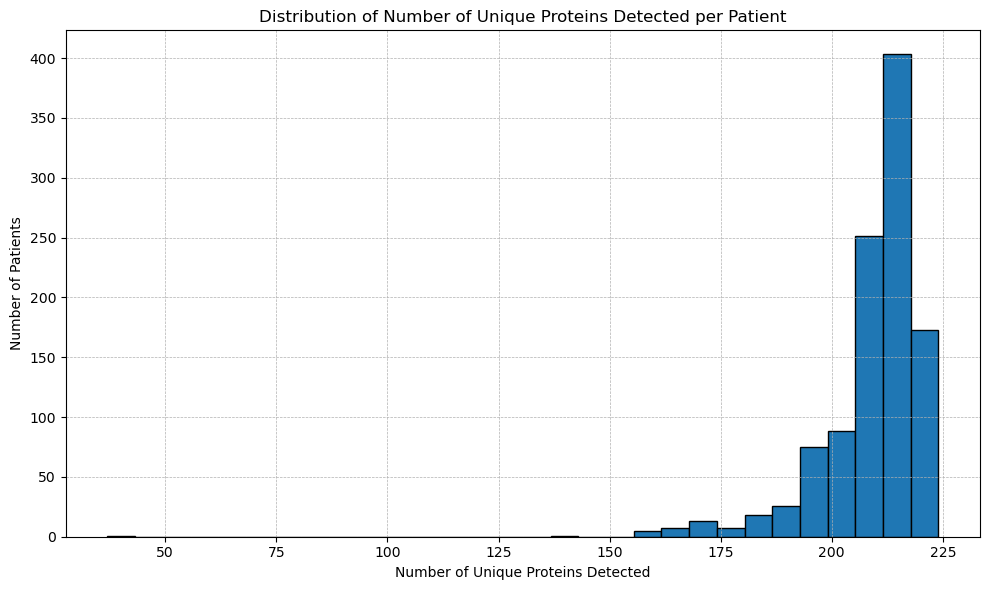

In [ ]:
# Group by patient_id and count the unique proteins
proteins_counts_per_patient = proteins_clinical.groupby('visit_id')['UniProt'].nunique()

# Plot
plt.figure(figsize=(10, 6))
plt.hist(proteins_counts_per_patient, bins=30, edgecolor='black')
plt.title('Distribution of Number of Unique Proteins Detected per Patient')
plt.xlabel('Number of Unique Proteins Detected')
plt.ylabel('Number of Patients')
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()

In [ ]:
print(proteins_counts_per_patient[proteins_counts_per_patient < 160])


visit_id
11928_0     138
18560_48    157
25562_36     37
58648_84    157
Name: UniProt, dtype: int64


In [ ]:
labels

['P01034',
 'P14618',
 'P00441',
 'P04075',
 'P10909',
 'P07195',
 'P11142',
 'P01008',
 'P02679',
 'P02675',
 'P11277',
 'P00734',
 'P60174',
 'P04406',
 'P02671',
 'P98160',
 'P02656',
 'Q16610']

### Protein Abundance x Number of Unique Proteins

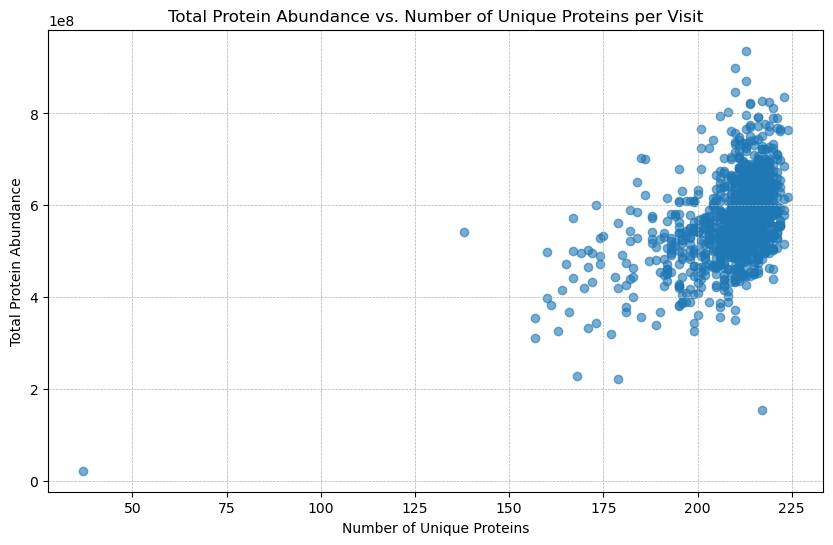

In [ ]:
# Group by visit_id and calculate total NPX_log2 and unique protein count
abundance_count = proteins_clinical.groupby('visit_id').agg({'NPX': 'sum', 'UniProt': 'nunique'}).reset_index()

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(abundance_count['UniProt'], abundance_count['NPX'], alpha=0.6)
plt.title('Total Protein Abundance vs. Number of Unique Proteins per Visit')
plt.ylabel('Total Protein Abundance')
plt.xlabel('Number of Unique Proteins')
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.show()

In [ ]:
# Identify visit_ids where the total protein abundance is below 2800
total_abundance = proteins_clinical.groupby('visit_id')['NPX'].sum()
low_abundance_visits = total_abundance[total_abundance < 2800].index

# Identify visit_ids where the number of unique proteins detected is less than 160
unique_proteins = proteins_clinical.groupby('visit_id')['UniProt'].nunique()
low_protein_visits = unique_proteins[unique_proteins < 50].index

visits_to_remove = set(low_abundance_visits) | set(low_protein_visits)

# Remove records related to the identified visit_ids
df_proteins_clinical = proteins_clinical[~proteins_clinical['visit_id'].isin(visits_to_remove)]

# Remove records where the protein is in the labels list
proteins_clinical = proteins_clinical[~proteins_clinical['UniProt'].isin(labels)]


### Peptide Abundance x Number of Unique Peptides

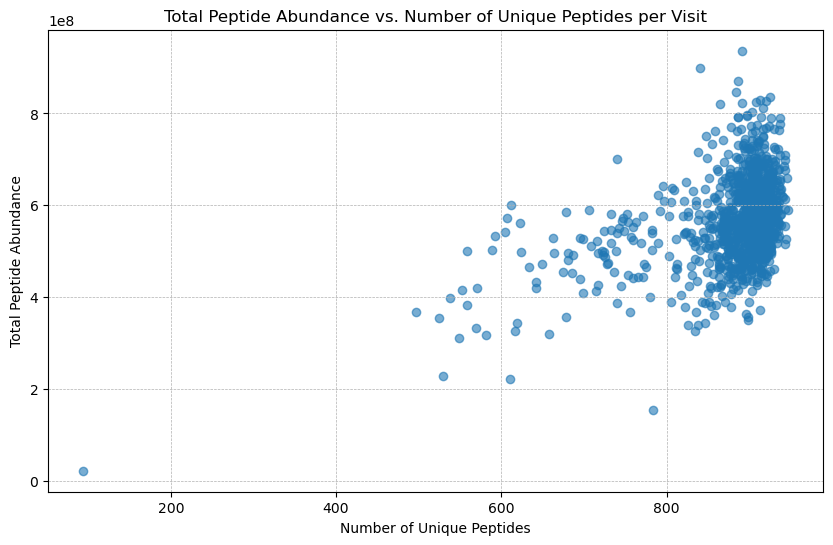

In [ ]:
abundance_count_peptides = peptides.groupby('visit_id').agg({'PeptideAbundance': 'sum', 'Peptide': 'nunique'}).reset_index()


plt.figure(figsize=(10, 6))
plt.scatter(abundance_count_peptides['Peptide'], abundance_count_peptides['PeptideAbundance'], alpha=0.6)
plt.title('Total Peptide Abundance vs. Number of Unique Peptides per Visit')
plt.ylabel('Total Peptide Abundance')
plt.xlabel('Number of Unique Peptides')
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.show()

## Correlation between protein levels and updrs scores

### All months combined

In [ ]:
# Dictionary to store top 20 most correlated proteins and their correlation coefficients for each UPDRS score
protein_updrs_corr = {}

# Calculate correlations for each UPDRS score
for updrs in updrs_scores:
    # Drop rows with missing values for the current UPDRS score and 'NPX_log2'
    data = proteins_clinical.dropna(subset=[updrs, 'NPX_log2'])

    # Group by 'UniProt' and calculate correlation with 'NPX_log2'
    correlations = data.groupby('UniProt').apply(lambda group: spearmanr(group[updrs], group['NPX_log2'])[0])

    # Sort correlations by absolute value
    sorted_correlations = correlations.abs().sort_values(ascending=False)

    # Select top 20 most correlated proteins
    top_20_proteins = sorted_correlations.index[:20]
    top_20_correlations = sorted_correlations[:20]

    # Store the top 20 proteins and their correlation coefficients in the dictionary
    protein_updrs_corr[updrs] = list(zip(top_20_proteins, top_20_correlations))

for updrs, proteins in protein_updrs_corr.items():
    print(f"Top 20 most correlated proteins with {updrs}:")
    for protein, correlation in proteins:
        print(f"Protein: {protein}, Correlation: {correlation}")


Top 20 most correlated proteins with updrs_1:
Protein: P04180, Correlation: 0.19309026961372702
Protein: P17174, Correlation: 0.1896362848086264
Protein: Q06481, Correlation: 0.1858013305487621
Protein: P05060, Correlation: 0.17823589264745784
Protein: P13521, Correlation: 0.16087803821592078
Protein: P13591, Correlation: 0.1588465016220571
Protein: O00533, Correlation: 0.15380410608438846
Protein: P23142, Correlation: 0.15295038136529066
Protein: P14314, Correlation: 0.15279817412608052
Protein: O15240, Correlation: 0.15090051347389521
Protein: P10645, Correlation: 0.1504726975187289
Protein: P61916, Correlation: 0.14946433785009802
Protein: P02649, Correlation: 0.14824678683130077
Protein: P43121, Correlation: 0.14816962862273067
Protein: P02787, Correlation: 0.1465770494013307
Protein: Q92823, Correlation: 0.14465813720251053
Protein: Q15904, Correlation: 0.13844535332647134
Protein: Q13332, Correlation: 0.13801910850718271
Protein: P05452, Correlation: 0.13755444414329887
Protein: 

In [ ]:
protein_updrs_corr

{'updrs_1': [('P04180', 0.19309026961372702),
  ('P17174', 0.1896362848086264),
  ('Q06481', 0.1858013305487621),
  ('P05060', 0.17823589264745784),
  ('P13521', 0.16087803821592078),
  ('P13591', 0.1588465016220571),
  ('O00533', 0.15380410608438846),
  ('P23142', 0.15295038136529066),
  ('P14314', 0.15279817412608052),
  ('O15240', 0.15090051347389521),
  ('P10645', 0.1504726975187289),
  ('P61916', 0.14946433785009802),
  ('P02649', 0.14824678683130077),
  ('P43121', 0.14816962862273067),
  ('P02787', 0.1465770494013307),
  ('Q92823', 0.14465813720251053),
  ('Q15904', 0.13844535332647134),
  ('Q13332', 0.13801910850718271),
  ('P05452', 0.13755444414329887),
  ('Q6UXB8', 0.13743557913057236)],
 'updrs_2': [('P04180', 0.2313046530957817),
  ('Q06481', 0.2283814139190884),
  ('O15240', 0.2131158287060762),
  ('P05060', 0.21237086467156607),
  ('P13521', 0.20421351323438702),
  ('P43121', 0.1955104976861393),
  ('P17174', 0.19512885922729845),
  ('O00533', 0.1942706238885604),
  ('P10

In [ ]:
# Checking if there is overlap between correlated proteins to each UPDRS score

updrs1_proteins = set(protein[0] for protein in protein_updrs_corr['updrs_1'])
updrs2_proteins = set(protein[0] for protein in protein_updrs_corr['updrs_2'])
updrs3_proteins = set(protein[0] for protein in protein_updrs_corr['updrs_3'])

common_updrs1_2 = updrs1_proteins & updrs2_proteins
common_updrs1_3 = updrs1_proteins & updrs3_proteins
common_updrs2_3 = updrs2_proteins & updrs3_proteins


print("Common proteins between UPDRS 1 and 2:", common_updrs1_2)
print("Common proteins between UPDRS 1 and 3:", common_updrs1_3)
print("Common proteins between UPDRS 2 and 3:", common_updrs2_3)

# Top 5 proteins
top_proteins = set()

for updrs_category in ['updrs_1', 'updrs_2', 'updrs_3']:
    top_proteins.update(protein[0] for protein in protein_updrs_corr[updrs_category][:5])

print("Top 5 proteins from each UPDRS category (no duplicates):", top_proteins)


Common proteins between UPDRS 1 and 2: {'P10645', 'P13521', 'Q06481', 'O00533', 'P43121', 'Q92823', 'Q13332', 'P02787', 'P17174', 'O15240', 'P02649', 'P04180', 'Q15904', 'P05060'}
Common proteins between UPDRS 1 and 3: {'P10645', 'P13521', 'O00533', 'Q06481', 'Q13332', 'Q92823', 'P43121', 'P02787', 'P17174', 'O15240', 'P05060'}
Common proteins between UPDRS 2 and 3: {'P10645', 'P13521', 'O00533', 'Q06481', 'Q13332', 'Q92823', 'P43121', 'P02787', 'Q9BY67', 'P17174', 'Q9NYU2', 'O15240', 'P05060', 'Q9NQ79'}
Top 5 proteins from each UPDRS category (no duplicates): {'P10645', 'P13521', 'Q06481', 'O00533', 'Q92823', 'P17174', 'O15240', 'P04180', 'P05060'}


In [ ]:
top_proteins

{'O00533',
 'O15240',
 'P04180',
 'P05060',
 'P10645',
 'P13521',
 'P17174',
 'Q06481',
 'Q92823'}

#### List of most correlated proteins

In [ ]:
uniprot_ids = {'O00533', 'O15240', 'P04180', 'P05060', 'P10645', 'P13521', 'P14618', 'P17174', 'Q06481', 'Q92823'}
for uniprot_id in uniprot_ids:
    protein_name, gene_name, function = fetch_uniprot_data(uniprot_id)
    print(f"UniProt ID: {uniprot_id}")
    print(f"Protein Name: {protein_name}")
    print(f"Gene Name: {gene_name}")
    print(f"Function: {function}\n")

UniProt ID: P10645
Protein Name: Chromogranin-A;
Gene Name: CHGA
Function: [Pancreastatin]: Strongly inhibits glucose induced insulin release from the pancreas. [Catestatin]: Inhibits catecholamine release from chromaffin cells and noradrenergic neurons by acting as a non-competitive nicotinic cholinergic antagonist (PubMed:15326220). Displays antibacterial activity against Gram-positive bacteria S.aureus and M.luteus, and Gram-negative bacteria E.coli and P.aeruginosa (PubMed:15723172, PubMed:24723458). Can induce mast cell migration, degranulation and production of cytokines and chemokines (PubMed:21214543). Acts as a potent scavenger of free radicals in vitro (PubMed:24723458). May play a role in the regulation of cardiac function and blood pressure (PubMed:18541522). {ECO:0000269|PubMed:15326220, ECO:0000269|PubMed:15723172, ECO:0000269|PubMed:21214543, ECO:0000269|PubMed:24723458, ECO:0000303|PubMed:18541522}. [Serpinin]: Regulates granule biogenesis in endocrine cells by up-regul

### Per visit_month

In [ ]:
protein_updrs_corr_month = {}

updrs_scores = ['updrs_1', 'updrs_2', 'updrs_3', 'updrs_4']

for month in proteins_clinical['visit_month'].unique():
    data_month = proteins_clinical[proteins_clinical['visit_month'] == month]

    for updrs in updrs_scores:
        grouped_data = data_month.groupby('UniProt').filter(lambda group: len(group) >= 10)

        data = grouped_data.dropna(subset=[updrs, 'NPX_log2'])

        correlations = data.groupby('UniProt').apply(lambda group: spearmanr(group[updrs], group['NPX_log2'])[0])

        if not isinstance(correlations, pd.Series):
            continue

        sorted_correlations = correlations.abs().sort_values(ascending=False)

        top_10_proteins = sorted_correlations.index[:10]
        top_10_correlations = sorted_correlations[:10]

        protein_updrs_corr_month[(month, updrs)] = list(zip(top_10_proteins, top_10_correlations))




In [ ]:
protein_updrs_corr_month

{(0, 'updrs_1'): [('Q99832', 0.26004997999946294),
  ('P00736', 0.19978902558386383),
  ('P02649', 0.19618598585857622),
  ('P04180', 0.17401190703981353),
  ('P24592', 0.17048918488635803),
  ('P43251', 0.16120209406162922),
  ('P09871', 0.1574558559347289),
  ('O60888', 0.1562519057724205),
  ('Q99683', 0.15225749993562793),
  ('P01023', 0.15142504146765784)],
 (0, 'updrs_2'): [('Q9NYU2', 0.25605354360123833),
  ('Q92823', 0.23981361883693994),
  ('P13591', 0.22710482465919454),
  ('O00533', 0.21818283142026632),
  ('P43121', 0.21781282945571356),
  ('P04156', 0.2163737352707951),
  ('Q8NBJ4', 0.21449353652678418),
  ('P40925', 0.21301029756004972),
  ('P02647', 0.2122761741764857),
  ('Q9NQ79', 0.21159673470760598)],
 (0, 'updrs_3'): [('P01876', 0.2754970930337085),
  ('Q9NYU2', 0.26707631975781665),
  ('P09871', 0.24443735989743276),
  ('O00533', 0.23363792138586664),
  ('P02787', 0.22950416106915908),
  ('Q12907', 0.22633033556848048),
  ('Q9NQ79', 0.2255464779079863),
  ('P40925'

### Per patient & UPDRS score

In [ ]:
patient_protein_updrs_corr = {}

unique_patients = proteins_clinical['patient_id'].unique()

for patient in unique_patients:
    patient_data = proteins_clinical[proteins_clinical['patient_id'] == patient]
    unique_proteins = patient_data['UniProt'].unique()
    patient_protein_updrs_corr[patient] = {}

    for protein in unique_proteins:
        protein_data = patient_data[patient_data['UniProt'] == protein]
        for score in updrs_scores:
            correlation = protein_data[['NPX_log2', score]].dropna().corr(method='spearman').iloc[0, 1]
            patient_protein_updrs_corr[patient][f'{protein}_{score}'] = correlation



In [ ]:
patient_protein_updrs_corr

{55: {'O00391_updrs_1': 0.31622776601683794,
  'O00391_updrs_2': 0.6324555320336759,
  'O00391_updrs_3': 0.8,
  'O00391_updrs_4': nan,
  'O00533_updrs_1': 0.6324555320336759,
  'O00533_updrs_2': 0.31622776601683794,
  'O00533_updrs_3': 0.6,
  'O00533_updrs_4': nan,
  'O00584_updrs_1': 0.9486832980505138,
  'O00584_updrs_2': 0.6324555320336759,
  'O00584_updrs_3': 0.8,
  'O00584_updrs_4': nan,
  'O14498_updrs_1': 0.6324555320336759,
  'O14498_updrs_2': 0.31622776601683794,
  'O14498_updrs_3': 0.2,
  'O14498_updrs_4': nan,
  'O14773_updrs_1': 0.9486832980505138,
  'O14773_updrs_2': 0.31622776601683794,
  'O14773_updrs_3': 0.4,
  'O14773_updrs_4': nan,
  'O14791_updrs_1': 0.31622776601683794,
  'O14791_updrs_2': 0.9486832980505138,
  'O14791_updrs_3': 0.8,
  'O14791_updrs_4': nan,
  'O15240_updrs_1': -0.6324555320336759,
  'O15240_updrs_2': -0.9486832980505138,
  'O15240_updrs_3': -1.0,
  'O15240_updrs_4': nan,
  'O15394_updrs_1': 0.9486832980505138,
  'O15394_updrs_2': 0.6324555320336759

### Relation between proteins and medication status

In [ ]:
# It is extremely unlikely that medication might affect protein/peptide expression. However, since patients with Unknown medication status have lower updrs (3), this could give hints about them.

In [ ]:
proteins_clinical_copy = proteins_clinical.copy()
proteins_clinical_copy['upd23b_clinical_state_on_medication'].fillna('Unknown', inplace=True)

kruskal_results = {}
posthoc_results = {}

grouped_by_protein = proteins_clinical_copy.groupby('UniProt')

for protein, group_data in grouped_by_protein:
    medication_status = group_data['upd23b_clinical_state_on_medication']
    npx_log2_values = group_data['NPX_log2']

    unique_statuses = medication_status.unique()
    kruskal_test_data = [npx_log2_values[medication_status == status] for status in unique_statuses]
    kruskal_result = kruskal(*kruskal_test_data)
    kruskal_results[protein] = {'statistic': kruskal_result.statistic, 'pvalue': kruskal_result.pvalue}

    if kruskal_result.pvalue < 0.05:
        posthoc = sp.posthoc_dunn(group_data, val_col='NPX_log2', group_col='upd23b_clinical_state_on_medication')
        posthoc_results[protein] = posthoc.unstack()

kruskal_results_df = pd.DataFrame.from_dict(kruskal_results, orient='index')
posthoc_results_df = pd.concat(posthoc_results, axis=1)

# Bonferroni correction - best correction here? I don't mind having false positives for now...
for protein, group_data in grouped_by_protein:
    medication_status = group_data['upd23b_clinical_state_on_medication']
    npx_log2_values = group_data['NPX_log2']

    unique_statuses = medication_status.unique()
    kruskal_test_data = [npx_log2_values[medication_status == status] for status in unique_statuses]
    kruskal_result = kruskal(*kruskal_test_data)

    if kruskal_result.pvalue < 0.05:
        posthoc = sp.posthoc_dunn(group_data, val_col='NPX_log2', group_col='upd23b_clinical_state_on_medication', p_adjust='bonferroni')
        posthoc_results[protein] = posthoc.unstack()

posthoc_results_df = pd.concat(posthoc_results, axis=1)

posthoc_results_df

O00533    O14498    O15240    O15394    O43505    P00738  \
Off     Off      1.000000  1.000000  1.000000  1.000000  1.000000  1.000000   
        On       1.000000  0.895274  1.000000  1.000000  0.026424  0.513068   
        Unknown  0.000519  0.009602  0.000048  0.015879  0.043846  0.019106   
On      Off      1.000000  0.895274  1.000000  1.000000  0.026424  0.513068   
        On       1.000000  1.000000  1.000000  1.000000  1.000000  1.000000   
        Unknown  0.003988  0.270951  0.000167  0.032631  1.000000  0.819090   
Unknown Off      0.000519  0.009602  0.000048  0.015879  0.043846  0.019106   
        On       0.003988  0.270951  0.000167  0.032631  1.000000  0.819090   
        Unknown  1.000000  1.000000  1.000000  1.000000  1.000000  1.000000   

                   P01011    P01023    P01042    P01594  ...    Q8NBJ4  \
Off     Off      1.000000  1.000000  1.000000  1.000000  ...  1.000000   
        On       0.009295  0.121647  0.289848  0.180205  ...  1.000000   
        Unknown  0.154767  1.000000  0.040787  0.018696  ...  0.026918   
On      Off      0.009295  0.121647  0.289848  0.180205  ...  1.000000   
        On       1.000000  1.000000  1.000000  1.000000  ...  1.000000   
        Unknown  0.309375  0.010114  0.000019  1.000000  ...  0.253910   
Unknown Off      0.154767  1.000000  0.040787  0.018696  ...  0.026918   
        On       0.309375  0.010114  0.000019  1.000000  ...  0.253910   
        Unknown  1.000000  1.000000  1.000000  1.000000  ...  1.000000   

                   Q8NE71    Q92520    Q92823   Q99435    Q99674    Q99832  \
Off     Off      1.000000  1.000000  1.000000  1.00000  1.000000  1.000000   
        On       0.205254  1.000000  1.000000  0.50921  1.000000  0.245192   
        Unknown  1.000000  0.005394  0.016901  0.00485  0.003598  0.002742   
On      Off      0.205254  1.000000  1.000000  0.50921  1.000000  0.245192   
        On       1.000000  1.000000  1.000000  1.00000  1.000000  1.000000   
        Unknown  0.014568  0.000220  0.003583  0.53158  0.010243  0.693450   
Unknown Off      1.000000  0.005394  0.016901  0.00485  0.003598  0.002742   
        On       0.014568  0.000220  0.003583  0.53158  0.010243  0.693450   
        Unknown  1.000000  1.000000  1.000000  1.00000  1.000000  1.000000   

                   Q9BY67    Q9NQ79    Q9UHG2  
Off     Off      1.000000  1.000000  1.000000  
        On       1.000000  1.000000  1.000000  
        Unknown  0.018786  0.085216  0.009054  
On      Off      1.000000  1.000000  1.000000  
        On       1.000000  1.000000  1.000000  
        Unknown  0.081016  0.061783  0.015298  
Unknown Off      0.018786  0.085216  0.009054  
        On       0.081016  0.061783  0.015298  
        Unknown  1.000000  1.000000  1.000000  

[9 rows x 86 columns]

In [ ]:
significance_threshold = 0.01  # Define your significance threshold
significant_results = posthoc_results_df[posthoc_results_df < significance_threshold]
significant_sorted = significant_results.stack().sort_values()

significant_sorted


On       Unknown  P61916    5.181428e-09
Unknown  On       P61916    5.181428e-09
                  P02774    1.348786e-06
On       Unknown  P02774    1.348786e-06
                  Q06481    1.559088e-06
                                ...     
Off      On       P01011    9.294512e-03
Unknown  Off      Q08380    9.298877e-03
Off      Unknown  Q08380    9.298877e-03
                  O14498    9.601945e-03
Unknown  Off      O14498    9.601945e-03
Length: 120, dtype: float64

In [ ]:
significant_df = significant_sorted.reset_index()

significant_df.columns = ['Medication Status 1', 'Medication Status 2', 'Protein', 'P-Value']

significant_df

,Medication Status 1,Medication Status 2,Protein,P-Value
0,On,Unknown,P61916,5.181428e-09
1,Unknown,On,P61916,5.181428e-09
2,Unknown,On,P02774,1.348786e-06
3,On,Unknown,P02774,1.348786e-06
4,On,Unknown,Q06481,1.559088e-06
...,...,...,...,...
115,Off,On,P01011,9.294512e-03
116,Unknown,Off,Q08380,9.298877e-03
117,Off,Unknown,Q08380,9.298877e-03
118,Off,Unknown,O14498,9.601945e-03


In [ ]:
significant_df[['Medication Status 1', 'Medication Status 2']] = np.sort(significant_df[['Medication Status 1', 'Medication Status 2']], axis=1)

significant_df = significant_df.drop_duplicates(subset=['Medication Status 1', 'Medication Status 2', 'Protein'])


unique_proteins_count = significant_df['Protein'].nunique()

print(f"Number of unique proteins: {unique_proteins_count}")
significant_df


Number of unique proteins: 47


,Medication Status 1,Medication Status 2,Protein,P-Value
0,On,Unknown,P61916,5.181428e-09
2,On,Unknown,P02774,1.348786e-06
4,On,Unknown,Q06481,1.559088e-06
6,On,Unknown,P05060,2.856691e-06
8,On,Unknown,P01042,1.931101e-05
10,Off,Unknown,Q06481,2.669974e-05
12,Off,On,Q13283,4.141467e-05
14,Off,Unknown,O15240,4.847278e-05
16,On,Unknown,P23142,5.052844e-05
18,On,Unknown,Q14508,6.952137e-05


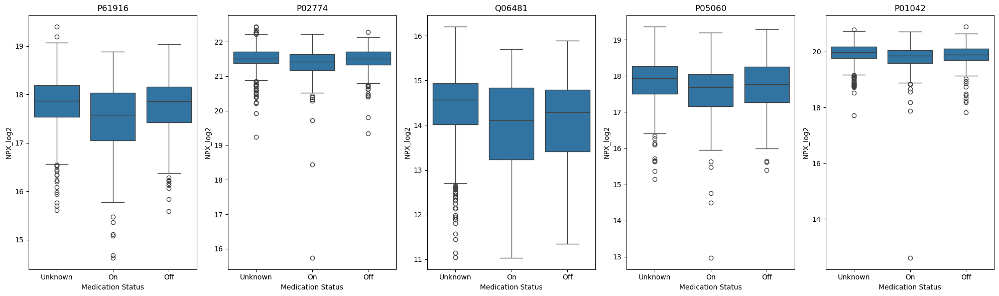

In [ ]:
# Examples

top_5_proteins = ['P61916', 'P02774', 'Q06481', 'P05060', 'P01042']


fig, axes = plt.subplots(nrows=1, ncols=5, figsize=(20, 6))

for i, protein in enumerate(top_5_proteins):
    # Filter data for the current protein
    protein_data = proteins_clinical_copy[proteins_clinical_copy['UniProt'] == protein]

    sns.boxplot(x='upd23b_clinical_state_on_medication', y='NPX_log2', data=protein_data, ax=axes[i])
    axes[i].set_title(protein)
    axes[i].set_xlabel('Medication Status')
    axes[i].set_ylabel('NPX_log2')

plt.tight_layout()
plt.show()


In [ ]:
medication_status_counts = proteins_clinical_copy['upd23b_clinical_state_on_medication'].value_counts()
medication_status_counts


upd23b_clinical_state_on_medication
Unknown    119498
On          43107
Off         42839
Name: count, dtype: int64

In [ ]:
significant_changes = []

for index, row in significant_df.iterrows():
    protein = row['Protein']
    status1 = row['Medication Status 1']
    status2 = row['Medication Status 2']

    data_status1 = proteins_clinical_copy[(proteins_clinical_copy['UniProt'] == protein) & (proteins_clinical_copy['upd23b_clinical_state_on_medication'] == status1)]['NPX_log2']
    data_status2 = proteins_clinical_copy[(proteins_clinical_copy['UniProt'] == protein) & (proteins_clinical_copy['upd23b_clinical_state_on_medication'] == status2)]['NPX_log2']

    median_status1 = data_status1.median()
    median_status2 = data_status2.median()

    direction = "increases" if median_status1 < median_status2 else "decreases"

    significant_changes.append({
        'Protein': protein,
        'Comparison': f"{status1} vs {status2}",
        'Direction': direction,
        'Median Status 1': median_status1,
        'Median Status 2': median_status2
    })

significant_changes_df = pd.DataFrame(significant_changes)
significant_changes_df


,Protein,Comparison,Direction,Median Status 1,Median Status 2
0,P61916,On vs Unknown,increases,17.576806,17.869889
1,P02774,On vs Unknown,increases,21.420392,21.514199
2,Q06481,On vs Unknown,increases,14.107614,14.565780
3,P05060,On vs Unknown,increases,17.688421,17.929903
4,P01042,On vs Unknown,increases,19.859805,19.976578
5,Q06481,Off vs Unknown,increases,14.280800,14.565780
6,Q13283,Off vs On,increases,19.049811,19.212957
7,O15240,Off vs Unknown,increases,16.680277,16.949673
8,P23142,On vs Unknown,increases,19.961594,20.146725
9,Q14508,On vs Unknown,increases,12.268387,12.518648


## Correlation between proteins

In [ ]:
proteins_clinical_pivot = proteins_clinical.pivot_table(values='NPX_log2', index='visit_month', columns='UniProt', aggfunc='median').fillna(0)

correlations = proteins_clinical_pivot.corr(method='spearman')

protein_protein_corr = {}

# Pairs with correlation >= 0.7
for pair in combinations(correlations.columns, 2):
    corr = correlations.loc[pair[0], pair[1]]
    if abs(corr) >= 0.7:
        protein_protein_corr[pair] = corr



In [ ]:
protein_protein_corr

{('O00533', 'P04216'): 0.775,
 ('O00533', 'P05452'): 0.8607142857142858,
 ('O00533', 'P07998'): 0.7321428571428571,
 ('O00533', 'P49588'): 0.85,
 ('O00533', 'Q02818'): 0.8392857142857143,
 ('O00533', 'Q8NE71'): 0.7214285714285714,
 ('O00533', 'Q96BZ4'): 0.7560324734729098,
 ('O00533', 'Q99674'): 0.8535714285714285,
 ('O00533', 'Q99829'): 0.7989279329607345,
 ('O00533', 'Q9UHG2'): 0.7214285714285714,
 ('O00584', 'P01594'): -0.7542451626609171,
 ('O00584', 'P17936'): 0.7071428571428572,
 ('O00584', 'P41222'): 0.9178571428571428,
 ('O00584', 'Q16270'): 0.8464285714285714,
 ('O00584', 'Q562R1'): -0.725,
 ('O00584', 'Q6UXB8'): 0.8785714285714286,
 ('O00584', 'Q8N2S1'): 0.8785714285714286,
 ('O00584', 'Q8NBJ4'): 0.7821428571428571,
 ('O14498', 'P01608'): 0.7428571428571429,
 ('O14498', 'P02787'): -0.7071428571428572,
 ('O14498', 'P20774'): 0.7964285714285714,
 ('O14498', 'Q16270'): 0.7571428571428571,
 ('O14498', 'Q6UXB8'): 0.7357142857142858,
 ('O14498', 'Q8NBJ4'): 0.7428571428571429,
 ('O1

### Examples of pos. and neg. correlated pairs

In [ ]:
protein_protein_corr = sorted(protein_protein_corr.items(), key=lambda item: item[1])

# Top 3 negatively correlated protein pairs
negatively_correlated = protein_protein_corr[:3]

# Top 3 positively correlated protein pairs
positively_correlated = protein_protein_corr[-3:]

print("Top 3 negatively correlated protein pairs:")
for pair, corr in negatively_correlated:
    print(f"{pair[0]} and {pair[1]}: {corr}")

print("\nTop 3 positively correlated protein pairs:")
for pair, corr in positively_correlated:
    print(f"{pair[0]} and {pair[1]}: {corr}")


Top 3 negatively correlated protein pairs:
P02749 and P17174: -0.9464285714285714
P01861 and P12109: -0.9
P12109 and P32754: -0.9

Top 3 positively correlated protein pairs:
Q02818 and Q99829: 0.9490620411681209
P02760 and P04156: 0.95
P04156 and P49908: 0.9607142857142857


### Which proteins are in these examples

In [ ]:
protein_pairs = {
    ('P02749', 'P17174'): -0.9464285714285714,
    ('P01861', 'P12109'): -0.9,
    ('P12109', 'P32754'): -0.9,
    ('Q02818', 'Q99829'): 0.9490620411681209,
    ('P02760', 'P04156'): 0.95,
    ('P04156', 'P49908'): 0.9607142857142857,
}

for pair, correlation in protein_pairs.items():
    print(f"Protein Pair: {pair}, Correlation: {correlation}")
    for uniprot_id in pair:
        protein_name, gene_name, function = fetch_uniprot_data(uniprot_id)
        print(f"UniProt ID: {uniprot_id}")
        print(f"Protein Name: {protein_name}")
        print(f"Gene Name: {gene_name}")
        print(f"Function: {function}\n")

Protein Pair: ('P02749', 'P17174'), Correlation: -0.9464285714285714
UniProt ID: P02749
Protein Name: Beta-2-glycoprotein 1;
Gene Name: APOH
Function: Binds to various kinds of negatively charged substances such as heparin, phospholipids, and dextran sulfate. May prevent activation of the intrinsic blood coagulation cascade by binding to phospholipids on the surface of damaged cells.

UniProt ID: P17174
Protein Name: Aspartate aminotransferase, cytoplasmic
Gene Name: GOT1
Function: Biosynthesis of L-glutamate from L-aspartate or L-cysteine (PubMed:21900944). Important regulator of levels of glutamate, the major excitatory neurotransmitter of the vertebrate central nervous system. Acts as a scavenger of glutamate in brain neuroprotection. The aspartate aminotransferase activity is involved in hepatic glucose synthesis during development and in adipocyte glyceroneogenesis. Using L-cysteine as substrate, regulates levels of mercaptopyruvate, an important source of hydrogen sulfide. Mercap

## Linear mixed-model

### Proteins that change their levels significantly as function of visit_month

In [ ]:
proteins_mm_results_bonferroni = {}

proteins_mm_all_results_bonferroni = []

for patient in proteins_clinical['patient_id'].unique():
    patient_data = proteins_clinical[proteins_clinical['patient_id'] == patient]

    patient_results_bonferroni = []

    for protein in patient_data['UniProt'].unique():
        # Subset data for this protein
        protein_data = patient_data[patient_data['UniProt'] == protein]

        # Only fit the model if there are at least 3 data points and more than one unique visit month
        if len(protein_data) >= 3 and protein_data['visit_month'].nunique() > 1:
            try:
                # Fit mixed-effects model with random intercept for each patient
                model = smf.mixedlm('NPX_log2 ~ visit_month', data=protein_data, groups=protein_data['patient_id'])
                result = model.fit()

                proteins_mm_all_results_bonferroni.append(result)

                # Append p-value and effect size for the effect of visit_month to patient-specific results
                patient_results_bonferroni.append((protein, result.pvalues['visit_month'], result.params['visit_month']))

            except Exception as e:
                print(f"Failed on patient={patient}, protein={protein}, p-value={result.pvalues['visit_month'] if 'result' in locals() else 'not calculated'}: {e}")
                continue

    protein_pvals_bonferroni = [x[1] for x in patient_results_bonferroni]

    if protein_pvals_bonferroni:
        reject_bonferroni, pvals_corrected_bonferroni, _, _ = multipletests(protein_pvals_bonferroni, method='bonferroni')

        proteins_mm_results_bonferroni[patient] = [(protein, pval_corr, effect) for (protein, _, effect), pval_corr, rej in zip(patient_results_bonferroni, pvals_corrected_bonferroni, reject_bonferroni) if rej]
    else:
        print(f"No valid p-values for patient {patient}, skipping Bonferroni correction.")
        proteins_mm_results_bonferroni[patient] = []

for patient, proteins in proteins_mm_results_bonferroni.items():
    print(f'Patient {patient}: {[(protein, effect) for protein, _, effect in proteins]}')


Failed on patient=55, protein=P00751, p-value=0.5655685814229668: Singular matrix
Failed on patient=55, protein=P01344, p-value=0.791602037805455: Singular matrix
Failed on patient=55, protein=P02748, p-value=0.3256303222142195: Singular matrix
Failed on patient=55, protein=P02774, p-value=0.04793171129763417: Singular matrix
Failed on patient=55, protein=P02790, p-value=0.4267541139958485: Singular matrix
Failed on patient=55, protein=P04216, p-value=0.9847467837259595: Singular matrix
Failed on patient=55, protein=P05155, p-value=0.5726050611797913: Singular matrix
Failed on patient=55, protein=P05452, p-value=0.749033638841204: Singular matrix
Failed on patient=55, protein=P14314, p-value=0.999032800924759: Singular matrix
Failed on patient=55, protein=P27169, p-value=0.9048114197519168: Singular matrix
Failed on patient=55, protein=P36222, p-value=0.14829059926649016: Singular matrix
Failed on patient=55, protein=P49908, p-value=0.2114059921501792: Singular matrix
Failed on patient

In [ ]:
proteins_mm_results_bonferroni

{55: [('O14791', 1.0937854809470117e-06, 0.009812897425852223),
  ('O15240', 2.481151251267624e-153, -0.023049320619066845),
  ('O60888', 1.3642380854093723e-07, -0.013299273454400098),
  ('P01033', 2.8737709531347966e-17, 0.013469780534230182),
  ('P01833', 0.020819684627845912, 0.0074774331191736956),
  ('P02452', 4.3330492325746406e-18, 0.009300704781290865),
  ('P02760', 1.7071354878332633e-07, 0.008298214860897784),
  ('P02765', 2.631512706062048e-26, -0.006748217177386862),
  ('P04433', 0.00017499325782835166, -0.015174965700137195),
  ('P06681', 0.004276794305043691, -0.0021268746137956766),
  ('P07333', 3.5158742976393923e-09, -0.038890739252766725),
  ('P61626', 9.966823067936101e-19, 0.009447827079434142),
  ('P80748', 1.5665905803539822e-15, 0.005872112852195223),
  ('Q13283', 0.004177883942186436, -0.007942977395611676),
  ('Q9BY67', 0.004008311928367408, -0.008087506471490686),
  ('Q99683', 6.394283038237112e-06, -0.0032311288825890927)],
 1517: [('O00533', 0.0433872922459

In [ ]:
flat_list = [(patient, protein, pval, effect) for patient, proteins in proteins_mm_results_bonferroni.items() for protein, pval, effect in proteins]

sorted_list = sorted(flat_list, key=lambda x: abs(x[3]), reverse=True)

top_10 = sorted_list[:10]

# Top 10
for patient, protein, pval, effect in top_10:
    print(f"Patient: {patient}, Protein: {protein}, p-value: {pval}, Effect size: {effect}")


Patient: 56538, Protein: P01833, p-value: 2.7732921775400393e-11, Effect size: 0.2834248745928705
Patient: 56538, Protein: Q99435, p-value: 0.0021328439667283846, Effect size: 0.19005959340884862
Patient: 41883, Protein: P30086, p-value: 0.0, Effect size: 0.1807951282297811
Patient: 28818, Protein: Q7Z5P9, p-value: 1.8047412331491884e-17, Effect size: 0.17279406787452056
Patient: 40798, Protein: P30086, p-value: 7.710040852955575e-13, Effect size: -0.1574850193616165
Patient: 44154, Protein: P16152, p-value: 5.20774863971698e-26, Effect size: 0.14493767887573852
Patient: 41883, Protein: P55290, p-value: 5.4868952621951006e-05, Effect size: 0.13851255662381667
Patient: 18183, Protein: Q99435, p-value: 0.038297488068557525, Effect size: -0.13769921734296017
Patient: 15245, Protein: P17936, p-value: 0.020488023629260645, Effect size: 0.13664216484199798
Patient: 10053, Protein: O94919, p-value: 3.531368490562457e-05, Effect size: 0.13659240189237126


In [ ]:
original_scale_change = 2 ** 0.28
original_scale_change

1.214194884395047

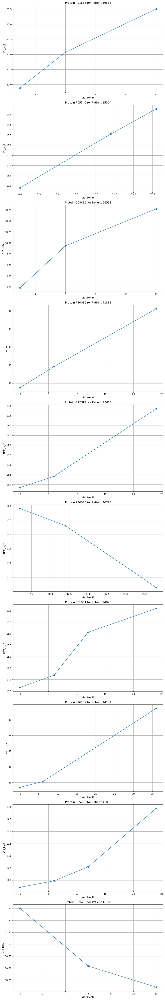

In [ ]:
top_10 = [
    (56538, 'P01833'), (15504, 'P05546'), (56538, 'Q99435'),
    (41883, 'P30086'), (28818, 'Q7Z5P9'), (40798, 'P30086'),
    (24820, 'P01861'), (44154, 'P16152'), (41883, 'P55290'),
    (18183, 'Q99435')
]

fig, axs = plt.subplots(len(top_10), figsize=(10, 6 * len(top_10)))

for i, (patient, protein) in enumerate(top_10):
    patient_protein_data = proteins_clinical[(proteins_clinical['patient_id'] == patient) &
                                             (proteins_clinical['UniProt'] == protein)]
    axs[i].plot(patient_protein_data['visit_month'], patient_protein_data['NPX_log2'], marker='o', linestyle='-')
    axs[i].set_title(f"Protein {protein} for Patient {patient}")
    axs[i].set_xlabel("Visit Month")
    axs[i].set_ylabel("NPX_log2")
    axs[i].grid(True)

plt.tight_layout()
plt.show()


# Exploring peptide information

In [ ]:
peptides

,visit_id,visit_month,patient_id,UniProt,Peptide,PeptideAbundance
0,55_0,0,55,O00391,NEQEQPLGQWHLS,11254.30
1,55_0,0,55,O00533,GNPEPTFSWTK,102060.00
2,55_0,0,55,O00533,IEIPSSVQQVPTIIK,174185.00
3,55_0,0,55,O00533,KPQSAVYSTGSNGILLC(UniMod_4)EAEGEPQPTIK,27278.90
4,55_0,0,55,O00533,SMEQNGPGLEYR,30838.70
...,...,...,...,...,...,...
981829,58648_108,108,58648,Q9UHG2,ILAGSADSEGVAAPR,202820.00
981830,58648_108,108,58648,Q9UKV8,SGNIPAGTTVDTK,105830.00
981831,58648_108,108,58648,Q9Y646,LALLVDTVGPR,21257.60
981832,58648_108,108,58648,Q9Y6R7,AGC(UniMod_4)VAESTAVC(UniMod_4)R,5127.26


In [ ]:
proteins = pd.read_csv("train_proteins.csv")

In [ ]:
peptides['is_modified'] = peptides['Peptide'].str.contains('UniMod_4|UniMod_30')

summed_abundances = peptides.groupby(['visit_id', 'UniProt', 'is_modified'])['PeptideAbundance'].sum().reset_index()

merged_test = pd.merge(summed_abundances, proteins, on=['visit_id', 'UniProt'])

merged_test['proportion'] = merged_test['PeptideAbundance'] / merged_test['NPX']

# Now, merged will have the proportion of expression for each peptide (modified/unmodified) with respect to the protein's NPX
merged_test


,visit_id,UniProt,is_modified,PeptideAbundance,visit_month,patient_id,NPX,proportion
0,10053_0,O00391,False,9104.27,0,10053,9104.27,1.000000
1,10053_0,O00533,False,378022.40,0,10053,402321.00,0.939604
2,10053_0,O00533,True,24299.00,0,10053,402321.00,0.060397
3,10053_0,O14773,False,7150.57,0,10053,7150.57,1.000000
4,10053_0,O14791,False,2497.84,0,10053,2497.84,1.000000
...,...,...,...,...,...,...,...,...
312326,942_6,Q9UKV8,False,82335.50,6,942,82335.50,1.000000
312327,942_6,Q9UNU6,False,24018.70,6,942,24018.70,1.000000
312328,942_6,Q9Y646,False,18939.50,6,942,18939.50,1.000000
312329,942_6,Q9Y6R7,False,10112.40,6,942,15251.20,0.663056


In [ ]:
peptides = pd.read_csv("train_peptides.csv")

In [ ]:
peptides

,visit_id,visit_month,patient_id,UniProt,Peptide,PeptideAbundance
0,55_0,0,55,O00391,NEQEQPLGQWHLS,11254.30
1,55_0,0,55,O00533,GNPEPTFSWTK,102060.00
2,55_0,0,55,O00533,IEIPSSVQQVPTIIK,174185.00
3,55_0,0,55,O00533,KPQSAVYSTGSNGILLC(UniMod_4)EAEGEPQPTIK,27278.90
4,55_0,0,55,O00533,SMEQNGPGLEYR,30838.70
...,...,...,...,...,...,...
981829,58648_108,108,58648,Q9UHG2,ILAGSADSEGVAAPR,202820.00
981830,58648_108,108,58648,Q9UKV8,SGNIPAGTTVDTK,105830.00
981831,58648_108,108,58648,Q9Y646,LALLVDTVGPR,21257.60
981832,58648_108,108,58648,Q9Y6R7,AGC(UniMod_4)VAESTAVC(UniMod_4)R,5127.26


In [ ]:
max_UniMod_4 = peptides['Peptide'].apply(lambda x: x.count('UniMod_4')).max()
max_UniMod_35 = peptides['Peptide'].apply(lambda x: x.count('UniMod_35')).max()
max_both = peptides['Peptide'].apply(lambda x: 1 if 'UniMod_4' in x and 'UniMod_35' in x else 0).max()


In [ ]:
print(max_UniMod_4, max_UniMod_35, max_both)

6 1 1


In [ ]:
peptides_clean = peptides.copy()
peptides_clean['Peptide'] = peptides_clean['Peptide'].str.replace('(UniMod_4)', '')


In [ ]:
peptides_clean

,visit_id,visit_month,patient_id,UniProt,Peptide,PeptideAbundance
0,55_0,0,55,O00391,NEQEQPLGQWHLS,11254.30
1,55_0,0,55,O00533,GNPEPTFSWTK,102060.00
2,55_0,0,55,O00533,IEIPSSVQQVPTIIK,174185.00
3,55_0,0,55,O00533,KPQSAVYSTGSNGILLCEAEGEPQPTIK,27278.90
4,55_0,0,55,O00533,SMEQNGPGLEYR,30838.70
...,...,...,...,...,...,...
981829,58648_108,108,58648,Q9UHG2,ILAGSADSEGVAAPR,202820.00
981830,58648_108,108,58648,Q9UKV8,SGNIPAGTTVDTK,105830.00
981831,58648_108,108,58648,Q9Y646,LALLVDTVGPR,21257.60
981832,58648_108,108,58648,Q9Y6R7,AGCVAESTAVCR,5127.26


In [ ]:
# Finding a way to represent proteins as function of modified/unmodified peptides

In [ ]:
summed_abundances_none = peptides_clean[~peptides_clean['Peptide'].str.contains('UniMod_35')].groupby(['visit_id', 'UniProt'])['PeptideAbundance'].sum().reset_index()
summed_abundances_35 = peptides_clean[peptides_clean['Peptide'].str.contains('UniMod_35')].groupby(['visit_id', 'UniProt'])['PeptideAbundance'].sum().reset_index()

summed_abundances_none = summed_abundances_none.rename(columns={'PeptideAbundance': 'Abundance_none'})
summed_abundances_35 = summed_abundances_35.rename(columns={'PeptideAbundance': 'Abundance_35'})

merged_proteins = proteins.merge(summed_abundances_none, on=['visit_id', 'UniProt'], how='left')
merged_proteins = merged_proteins.merge(summed_abundances_35, on=['visit_id', 'UniProt'], how='left')

# Handling NaN values - if a protein doesn't have any modified/unmodified peptides for a visit_id, the abundance is 0
merged_proteins['Abundance_none'].fillna(0, inplace=True)
merged_proteins['Abundance_35'].fillna(0, inplace=True)


In [ ]:
pivot_none = merged_proteins.pivot(index='visit_id', columns='UniProt', values='Abundance_none').fillna(0)
pivot_35 = merged_proteins.pivot(index='visit_id', columns='UniProt', values='Abundance_35').fillna(0)

pivot_none.columns = [str(col) + '_none' for col in pivot_none.columns]
pivot_35.columns = [str(col) + '_35' for col in pivot_35.columns]

# Merging the two pivoted dataframes
final_pivot = pd.concat([pivot_none, pivot_35], axis=1)


In [ ]:
final_pivot

,O00391_none,O00533_none,O00584_none,O14498_none,O14773_none,O14791_none,O15240_none,O15394_none,O43505_none,O60888_none,...,Q9HDC9_35,Q9NQ79_35,Q9NYU2_35,Q9UBR2_35,Q9UBX5_35,Q9UHG2_35,Q9UKV8_35,Q9UNU6_35,Q9Y646_35,Q9Y6R7_35
visit_id,,,,,,,,,,,,,,,,,,,,,
10053_0,9104.27,402321.40,0.00,0.0,7150.57,2497.84,83002.900,15113.6,167327.0,129048.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,15382.0,0.0,0.0
10053_12,10464.20,435585.70,0.00,0.0,0.00,0.00,197116.600,15099.1,164268.0,108114.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10053_18,13235.70,507385.80,7126.96,24525.7,0.00,2372.71,126505.600,16289.6,168107.0,163776.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10813.3,0.0,0.0
10138_12,12600.20,494580.50,9165.06,27193.5,22506.09,6015.90,156313.490,54546.4,204013.0,56725.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,26077.7,0.0,0.0
10138_24,12003.20,522137.30,4498.51,17189.8,29112.40,2665.15,151169.551,52338.1,240892.0,85767.1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12639.2,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8699_24,9983.00,400289.70,24240.11,0.0,16943.44,6303.17,77493.638,46435.3,254247.0,138910.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14413.9,0.0,0.0
942_12,6757.32,360858.60,18367.55,14760.7,18603.42,1722.77,86847.366,37741.3,212132.0,100519.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,19183.7,0.0,0.0
942_24,0.00,352722.80,22834.93,23393.1,16693.51,1487.91,114772.110,36095.7,185836.0,99183.5,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,19168.2,0.0,0.0


In [ ]:
final_pivot_log2 = final_pivot.applymap(lambda x: np.log2(x) if x > 0 else 0)


In [ ]:
proteins_clinical.visit_month.unique()

array([  0,   3,   6,  12,  18,  24,  30,  36,  48,  54,  60,  72,  84,
        96, 108])

In [ ]:
proteins_clinical.visit_id.nunique()

1068

In [ ]:
# Extract the unique 'visit_id' values from the 'proteins_clinical' DataFrame
unique_visit_ids_in_proteins_clinical = proteins_clinical['visit_id'].unique()

# Filter the 'final_pivot_log2' DataFrame to only include rows where the index ('visit_id') is in the unique values list
final_pivot_log2_filtered = final_pivot_log2[final_pivot_log2.index.isin(unique_visit_ids_in_proteins_clinical)]

# If you want to update 'final_pivot_log2' in place, you can do so as follows:
final_pivot_log2 = final_pivot_log2[final_pivot_log2.index.isin(unique_visit_ids_in_proteins_clinical)]


In [ ]:
final_pivot_log2.index.nunique()

1068

## Relation between proteins + peptide modifications

In [ ]:
correlation_matrix = final_pivot_log2.corr()

# Find the pairs of proteins with the highest correlation
# NOTE: We are only interested in off-diagonal values, so we replace diagonal values with 0
for i in range(correlation_matrix.shape[0]):
    correlation_matrix.iloc[i, i] = 0

high_corr_pairs = correlation_matrix.stack().sort_values(ascending=False).drop_duplicates()
print("Highly correlated protein pairs:")
high_corr_pairs.head(10)

Highly correlated protein pairs:


P00450_none  P00751_none    0.934863
Q92823_none  P10645_none    0.923168
O00533_none  Q92823_none    0.919374
P01008_none  P04217_none    0.911670
O00533_none  P10645_none    0.909343
P04217_none  P00450_none    0.908526
P13987_none  P05452_none    0.908415
P02671_none  P02679_none    0.906300
P04217_none  P00751_none    0.906256
P02671_none  P02675_none    0.904417
dtype: float64

## Mixed-model proteins + peptide modifications

In [ ]:
# Seems to be a good way of taking advantadge of the longitudinal nature of patient information

In [ ]:
protein_results_bonferroni = {}

all_results_bonferroni = []


final_pivot_log2['patient_id'] = final_pivot_log2.index.str.split('_').str[0]
final_pivot_log2['visit_month'] = final_pivot_log2.index.str.split('_').str[1].astype(int)


for patient in final_pivot_log2['patient_id'].unique():
    patient_data = final_pivot_log2[final_pivot_log2['patient_id'] == patient]
    patient_results = []

    for protein in final_pivot_log2.columns[:-2]:
        if len(patient_data) >= 3 and patient_data['visit_month'].nunique() > 1:
            try:
                # Fit mixed-effects model with random intercept for each patient
                model = smf.mixedlm(f"{protein} ~ visit_month", data=patient_data, groups=patient_data['patient_id'])
                result = model.fit()
                all_results_bonferroni.append(result)
                patient_results.append((protein, result.pvalues['visit_month'], result.params['visit_month']))
            except Exception as e:
                print(f"Failed on patient={patient}, protein={protein}: {e}")
                continue

    # Bonferroni correction
    protein_pvals = [x[1] for x in patient_results]
    if protein_pvals:
        reject, pvals_corrected, _, _ = multipletests(protein_pvals, method='bonferroni')
        protein_results_bonferroni[patient] = [(prot, pval_corr, effect) for (prot, _, effect), pval_corr, rej in zip(patient_results, pvals_corrected, reject) if rej]
    else:
        print(f"No valid p-values for patient {patient}, skipping Bonferroni correction.")
        protein_results_bonferroni[patient] = []

for patient, proteins in protein_results_bonferroni.items():
    print(f"Patient {patient}: {[(protein, effect) for protein, _, effect in proteins]}")


Failed on patient=10053, protein=O14773_none: Singular matrix
Failed on patient=10053, protein=O43505_none: Singular matrix
Failed on patient=10053, protein=P00734_none: Singular matrix
Failed on patient=10053, protein=P01033_none: Singular matrix
Failed on patient=10053, protein=P02656_none: Singular matrix
Failed on patient=10053, protein=P02750_none: Singular matrix
Failed on patient=10053, protein=P02774_none: Singular matrix
Failed on patient=10053, protein=P02787_none: Singular matrix
Failed on patient=10053, protein=P07602_none: Singular matrix
Failed on patient=10053, protein=P10451_none: Singular matrix
Failed on patient=10053, protein=P17174_none: Singular matrix
Failed on patient=10053, protein=P49588_none: Singular matrix
Failed on patient=10053, protein=P51884_none: Singular matrix
Failed on patient=10053, protein=P55290_none: Singular matrix
Failed on patient=10053, protein=P60174_none: Singular matrix
Failed on patient=10053, protein=P61626_none: Singular matrix
Failed o

In [ ]:
# Prepare a list to collect the data
protein_data = []

# Loop through each patient and their corresponding proteins
for patient_id, proteins_info in protein_results_bonferroni.items():
    for protein_name, p_val, effect_size in proteins_info:
        # Append the details as a new row in the list
        protein_data.append([patient_id, protein_name, p_val, effect_size])

# Convert the list to a DataFrame
bonferroni_results_df = pd.DataFrame(protein_data, columns=["PatientID", "ProteinName", "PValue", "EffectSize"])

# Display the DataFrame
bonferroni_results_df


,PatientID,ProteinName,PValue,EffectSize
0,10053,O94919_none,1.156456e-04,0.136592
1,10053,P00450_none,1.730783e-16,0.027590
2,10053,P01023_none,1.289481e-72,0.022916
3,10053,P01024_none,0.000000e+00,0.026908
4,10053,P02647_none,0.000000e+00,0.028004
...,...,...,...,...
4431,942,Q7Z3B1_none,5.412672e-40,-0.015437
4432,942,Q92520_none,5.037829e-06,-0.010147
4433,942,Q92823_none,9.822460e-03,-0.009368
4434,942,Q99435_none,2.296307e-02,-0.020794


In [ ]:
unique_proteins = set()

for patient, results in protein_results_bonferroni.items():
    for protein, _, _ in results:
        unique_proteins.add(protein)

print(f"Number of unique proteins: {len(unique_proteins)}")


Number of unique proteins: 244


In [ ]:
protein_columns = final_pivot_log2.columns[:-2]

num_unique_proteins = len(protein_columns)

print(f"Number of unique proteins: {num_unique_proteins}")

Number of unique proteins: 454


## Relation between proteins + peptides and medication status

In [ ]:
final_pivot_log2

,O00391_none,O00533_none,O00584_none,O14498_none,O14773_none,O14791_none,O15240_none,O15394_none,O43505_none,O60888_none,...,Q9NYU2_35,Q9UBR2_35,Q9UBX5_35,Q9UHG2_35,Q9UKV8_35,Q9UNU6_35,Q9Y646_35,Q9Y6R7_35,patient_id,visit_month
visit_id,,,,,,,,,,,,,,,,,,,,,
10053_0,13.152328,18.617989,0.000000,0.000000,12.803843,11.286465,16.340874,13.883560,17.352311,16.977548,...,0,0,0,0,0,13.908955,0,0,10053,0
10053_12,13.353174,18.732597,0.000000,0.000000,0.000000,0.000000,17.588690,13.882175,17.325692,16.722194,...,0,0,0,0,0,0.000000,0,0,10053,12
10053_18,13.692147,18.952724,12.799071,14.582007,0.000000,11.212320,16.948842,13.991664,17.359020,17.321364,...,0,0,0,0,0,13.400519,0,0,10053,18
10138_12,13.621159,18.915846,13.161929,14.730974,14.458028,12.554565,17.254083,15.735196,17.638302,15.791697,...,0,0,0,0,0,14.670529,0,0,10138,12
10138_24,13.551131,18.994070,12.135232,14.069265,14.829346,11.380001,17.205808,15.675574,17.878027,16.388137,...,0,0,0,0,0,13.625618,0,0,10138,24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8699_24,13.285258,18.610685,14.565109,0.000000,14.048439,12.621862,16.241790,15.502934,17.955871,17.083791,...,0,0,0,0,0,13.815173,0,0,8699,24
942_12,12.722235,18.461074,14.164872,13.849474,14.183280,10.750514,16.406194,15.203856,17.694603,16.617109,...,0,0,0,0,0,14.227593,0,0,942,12
942_24,0.000000,18.428175,14.478955,14.513795,14.027000,10.539072,16.808413,15.139539,17.503670,16.597813,...,0,0,0,0,0,14.226427,0,0,942,24


In [ ]:
final_pivot_log2_copy = final_pivot_log2.iloc[:, :-2].copy()

medication_status_map = proteins_clinical[['visit_id', 'upd23b_clinical_state_on_medication']].drop_duplicates()
medication_status_map.set_index('visit_id', inplace=True)
medication_status_map.fillna('Unknown', inplace=True)

final_pivot_log2_copy['medication_status'] = final_pivot_log2_copy.index.map(medication_status_map['upd23b_clinical_state_on_medication'])

grouped_by_medication = final_pivot_log2_copy.groupby('medication_status')

kruskal_results_final = {}
posthoc_results_final = {}

# Perform Kruskal-Wallis test on proteins with non-zero variance
for protein in final_pivot_log2_copy.columns[:-1]:  # Exclude 'medication status'
    protein_data = final_pivot_log2_copy[protein]
    if protein_data.var() > 0:  # Check variance
        kruskal_test_data_final = [protein_data[grouped_by_medication.groups[status]].dropna() for status in grouped_by_medication.groups]
        if len(kruskal_test_data_final) > 1:  # Ensure at least two non-empty groups
            kruskal_result_final = kruskal(*kruskal_test_data_final)
            kruskal_results_final[protein] = {'statistic': kruskal_result_final.statistic, 'pvalue': kruskal_result_final.pvalue}

            if kruskal_result_final.pvalue < 0.05:
                posthoc_final = sp.posthoc_dunn(final_pivot_log2_copy, val_col=protein, group_col='medication_status', p_adjust='bonferroni')
                posthoc_results_final[protein] = posthoc_final.unstack()

kruskal_results_df_final = pd.DataFrame.from_dict(kruskal_results_final, orient='index')
posthoc_results_df_final = pd.concat(posthoc_results_final, axis=1)

kruskal_results_df_final
posthoc_results_df_final


O00533_none  O00584_none  O14498_none  O14791_none  \
Off     Off         1.000000     1.000000     1.000000     1.000000   
        On          1.000000     0.030023     1.000000     0.023872   
        Unknown     0.000526     1.000000     0.007754     1.000000   
On      Off         1.000000     0.030023     1.000000     0.023872   
        On          1.000000     1.000000     1.000000     1.000000   
        Unknown     0.002882     0.007503     0.073708     0.026146   
Unknown Off         0.000526     1.000000     0.007754     1.000000   
        On          0.002882     0.007503     0.073708     0.026146   
        Unknown     1.000000     1.000000     1.000000     1.000000   

                 O15240_none  O15394_none  O43505_none  O60888_none  \
Off     Off         1.000000     1.000000     1.000000     1.000000   
        On          1.000000     0.920352     0.042656     0.655189   
        Unknown     0.000048     0.017004     0.044404     0.028781   
On      Off         1.000000     0.920352     0.042656     0.655189   
        On          1.000000     1.000000     1.000000     1.000000   
        Unknown     0.000167     0.362637     1.000000     0.789043   
Unknown Off         0.000048     0.017004     0.044404     0.028781   
        On          0.000167     0.362637     1.000000     0.789043   
        Unknown     1.000000     1.000000     1.000000     1.000000   

                 O75326_none  P00441_none  ...  Q99969_none  Q9BY67_none  \
Off     Off         1.000000     1.000000  ...     1.000000     1.000000   
        On          0.294439     1.000000  ...     0.035969     0.579369   
        Unknown     0.014394     0.315382  ...     0.737312     0.008954   
On      Off         0.294439     1.000000  ...     0.035969     0.579369   
        On          1.000000     1.000000  ...     1.000000     1.000000   
        Unknown     0.000004     0.035282  ...     0.000071     0.000014   
Unknown Off         0.014394     0.315382  ...     0.737312     0.008954   
        On          0.000004     0.035282  ...     0.000071     0.000014   
        Unknown     1.000000     1.000000  ...     1.000000     1.000000   

                 Q9HDC9_none  Q9NQ79_none  Q9UHG2_none  Q9UKV8_none  \
Off     Off         1.000000     1.000000     1.000000     1.000000   
        On          0.000087     0.938271     1.000000     0.029860   
        Unknown     0.343329     0.079381     0.009054     0.436830   
On      Off         0.000087     0.938271     1.000000     0.029860   
        On          1.000000     1.000000     1.000000     1.000000   
        Unknown     0.001453     0.001572     0.015298     0.288549   
Unknown Off         0.343329     0.079381     0.009054     0.436830   
        On          0.001453     0.001572     0.015298     0.288549   
        Unknown     1.000000     1.000000     1.000000     1.000000   

                 Q9Y646_none  P01009_35  P09871_35  Q92520_35  
Off     Off         1.000000   1.000000   1.000000   1.000000  
        On          0.905546   0.103521   0.014699   1.000000  
        Unknown     0.421258   1.000000   1.000000   0.008769  
On      Off         0.905546   0.103521   0.014699   1.000000  
        On          1.000000   1.000000   1.000000   1.000000  
        Unknown     0.018227   0.033224   0.001431   0.012033  
Unknown Off         0.421258   1.000000   1.000000   0.008769  
        On          0.018227   0.033224   0.001431   0.012033  
        Unknown     1.000000   1.000000   1.000000   1.000000  

[9 rows x 127 columns]

In [ ]:
significance_threshold_final = 0.01

significant_results_final = posthoc_results_df_final[posthoc_results_df_final < significance_threshold_final]
significant_sorted_final = significant_results_final.stack().sort_values()

significant_df_final = significant_sorted_final.reset_index()
significant_df_final.columns = ['Medication Status 1', 'Medication Status 2', 'Protein', 'P-Value']

significant_df_final

,Medication Status 1,Medication Status 2,Protein,P-Value
0,On,Unknown,P05408_none,3.510730e-11
1,Unknown,On,P05408_none,3.510730e-11
2,Unknown,On,P61916_none,3.115441e-09
3,On,Unknown,P61916_none,3.115441e-09
4,On,Unknown,P36980_none,4.925384e-09
...,...,...,...,...
223,Off,On,Q8NE71_none,9.315467e-03
224,Unknown,Off,Q08380_none,9.386569e-03
225,Off,Unknown,Q08380_none,9.386569e-03
226,On,Off,Q6UXD5_none,9.537089e-03


In [ ]:
# Sort the medication statuses for each row
significant_df_final[['Medication Status 1', 'Medication Status 2']] = np.sort(
    significant_df_final[['Medication Status 1', 'Medication Status 2']], axis=1
)

significant_df_final = significant_df_final.drop_duplicates(
    subset=['Medication Status 1', 'Medication Status 2', 'Protein']
)

# Count unique proteins
unique_proteins_count_final = significant_df_final['Protein'].nunique()

# Print the count of unique proteins
print(f"Number of unique proteins: {unique_proteins_count_final}")


Number of unique proteins: 84


In [ ]:
significant_df_final

,Medication Status 1,Medication Status 2,Protein,P-Value
0,On,Unknown,P05408_none,3.510730e-11
2,On,Unknown,P61916_none,3.115441e-09
4,On,Unknown,P36980_none,4.925384e-09
6,On,Unknown,P13611_none,1.834726e-08
8,On,Unknown,Q14508_none,4.083046e-08
...,...,...,...,...
218,Off,Unknown,Q9UHG2_none,9.053863e-03
220,Off,On,P01011_none,9.289855e-03
222,Off,On,Q8NE71_none,9.315467e-03
224,Off,Unknown,Q08380_none,9.386569e-03


In [ ]:
peptides_clinical = pd.merge(peptides, clinical, on=['visit_id', 'patient_id', 'visit_month'])

peptides_clinical_copy = peptides_clinical.copy()

peptides_clinical_copy['Peptide'] = peptides_clinical_copy['Peptide'].str.replace("\(UniMod_4\)", "", regex=True)
peptides_clinical_copy['upd23b_clinical_state_on_medication'].fillna('Unknown', inplace=True)

peptide_anova_results = {}

grouped_by_peptide = peptides_clinical_copy.groupby(['UniProt', 'Peptide'])

# Perform ANOVA for each group
for (protein, peptide), group_data in grouped_by_peptide:
    # Extract relevant data
    medication_status = group_data['upd23b_clinical_state_on_medication']
    peptide_abundance = group_data['PeptideAbundance']
    anova_data = [group_data['PeptideAbundance'][group_data['upd23b_clinical_state_on_medication'] == status] for status in medication_status.unique()]

    # Perform one-way ANOVA
    f_statistic, p_value = f_oneway(*anova_data)
    peptide_anova_results[(protein, peptide)] = {'F-statistic': f_statistic, 'pvalue': p_value}

peptide_anova_results_df = pd.DataFrame.from_dict(peptide_anova_results, orient='index')

# Sort the DataFrame by pvalue in ascending order
peptide_anova_results_df_sorted = peptide_anova_results_df.sort_values(by='pvalue')

print(peptide_anova_results_df_sorted.head(10))



                             F-statistic    pvalue
Q13283 FYVHNDIFR               11.208906  0.000015
O15240 AYQGVAAPFPK              9.872122  0.000056
Q14508 DQCQVDSQCPGQMK           9.482894  0.000083
Q9UHG2 ARAEAQEAEDQQAR           9.290937  0.000101
Q99674 HVEPGEPLAPSPQEPQAVGR     9.145607  0.000117
P02787 LKCDEWSVNSVGK            8.871752  0.000151
P02750 DLLLPQPDLR               8.716859  0.000176
P10643 GQSISVTSIRPCAAETQ        8.676409  0.000185
P02774 HLSLLTTLSNR              8.541836  0.000209
O00533 VNGSPVDNHPFAGDVVFPR      8.473623  0.000224


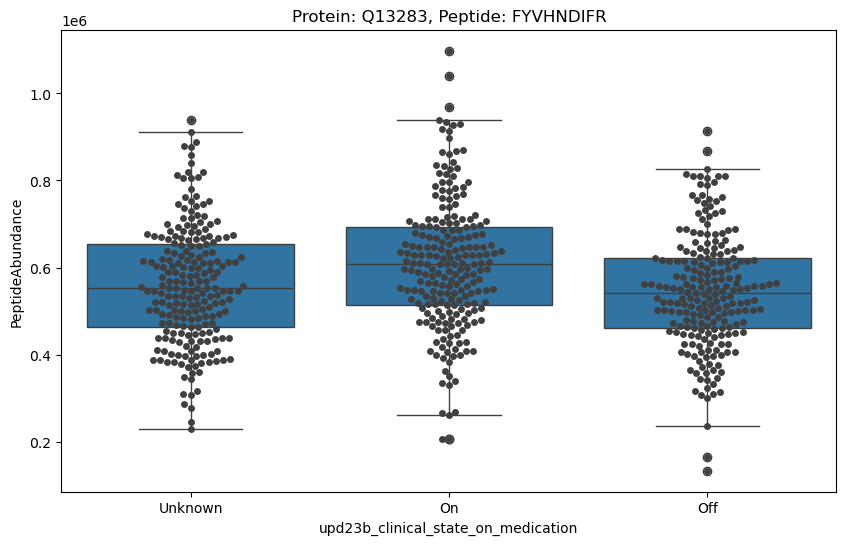

Unknown vs On: Mann-Whitney U test p-value = 0.0007579892592132522
Unknown vs Off: Mann-Whitney U test p-value = 0.3421851245347942
On vs Off: Mann-Whitney U test p-value = 8.487190232787563e-06
Interpretation for Protein: Q13283, Peptide: FYVHNDIFR


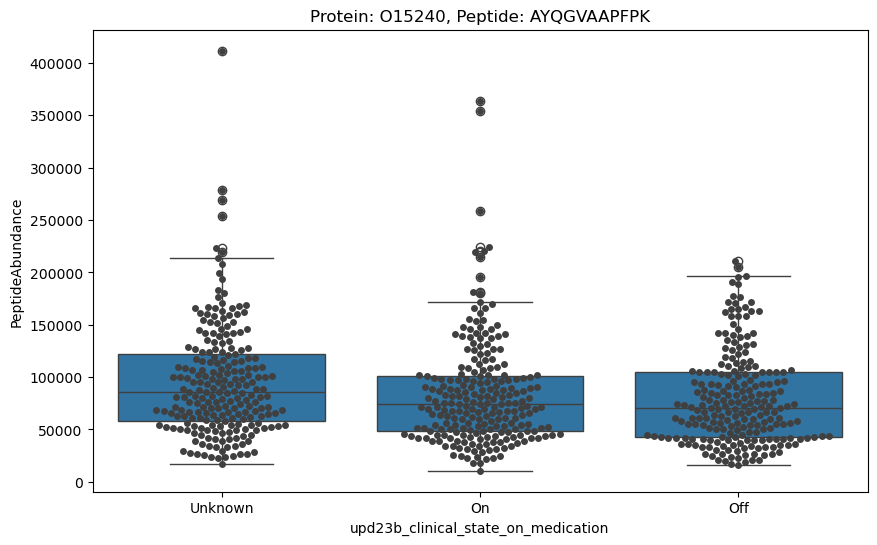

Unknown vs On: Mann-Whitney U test p-value = 0.00403823955517875
Unknown vs Off: Mann-Whitney U test p-value = 0.0004183835970677979
On vs Off: Mann-Whitney U test p-value = 0.37258322509044817
Interpretation for Protein: O15240, Peptide: AYQGVAAPFPK


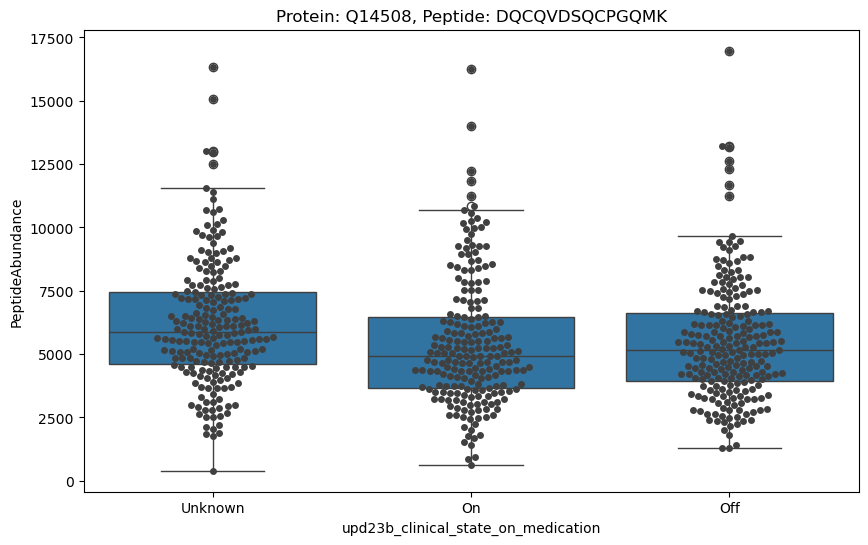

Unknown vs On: Mann-Whitney U test p-value = 0.0001253175901839554
Unknown vs Off: Mann-Whitney U test p-value = 0.00042351616017216023
On vs Off: Mann-Whitney U test p-value = 0.5675806376580428
Interpretation for Protein: Q14508, Peptide: DQCQVDSQCPGQMK


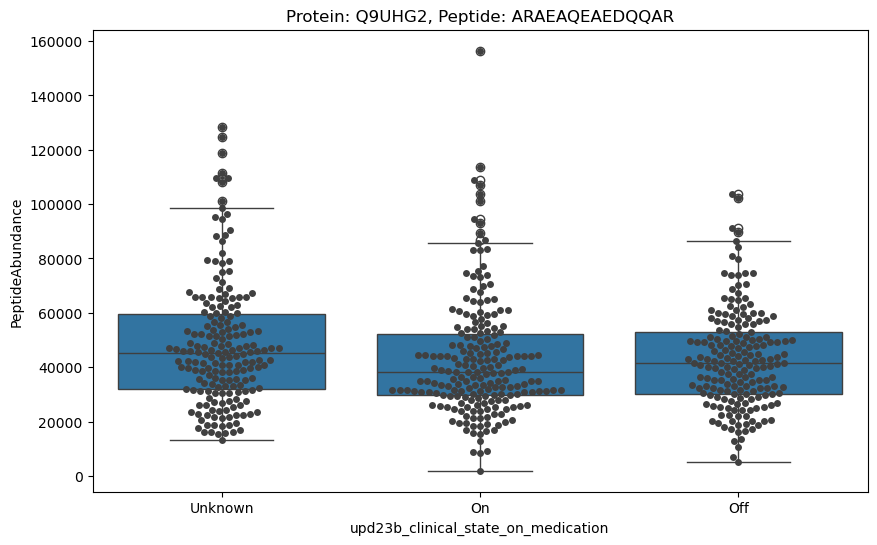

Unknown vs On: Mann-Whitney U test p-value = 0.006207763105353987
Unknown vs Off: Mann-Whitney U test p-value = 0.0727930617496084
On vs Off: Mann-Whitney U test p-value = 0.29732263733923203
Interpretation for Protein: Q9UHG2, Peptide: ARAEAQEAEDQQAR


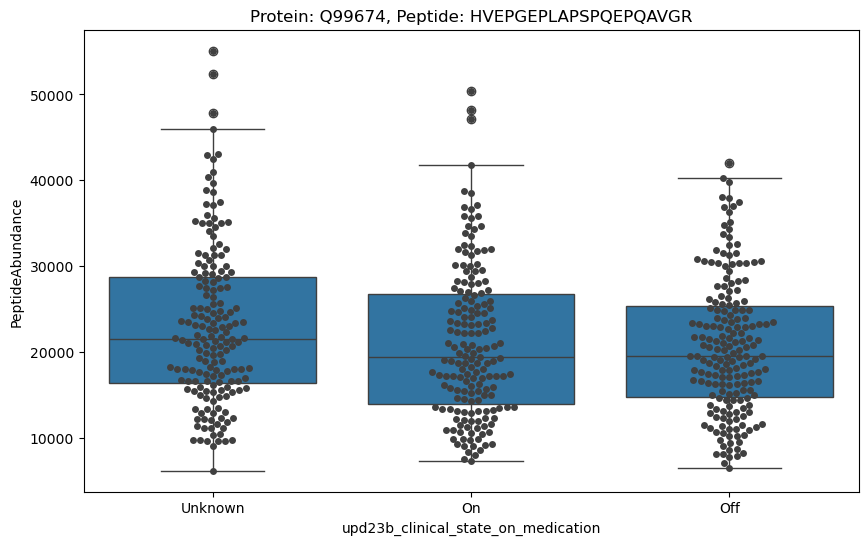

Unknown vs On: Mann-Whitney U test p-value = 0.05380393373871855
Unknown vs Off: Mann-Whitney U test p-value = 0.03162622755668572
On vs Off: Mann-Whitney U test p-value = 0.9315599569757947
Interpretation for Protein: Q99674, Peptide: HVEPGEPLAPSPQEPQAVGR


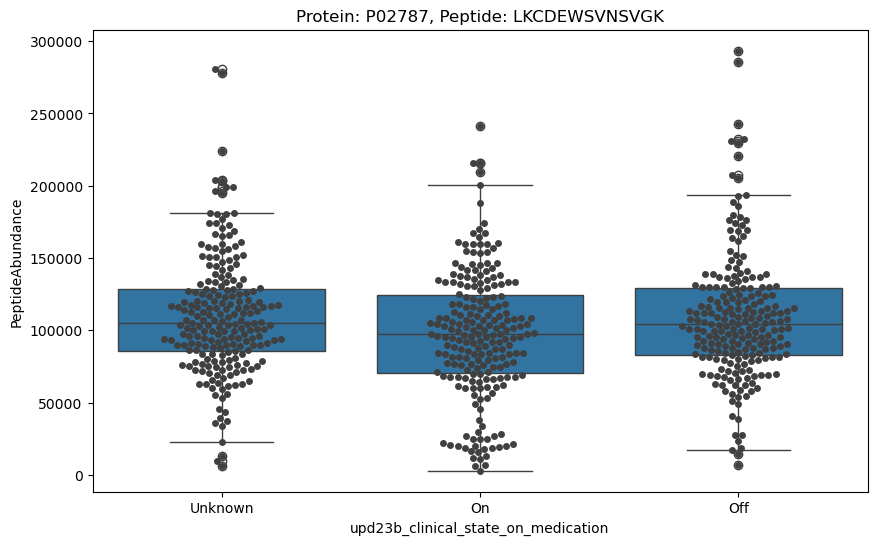

Unknown vs On: Mann-Whitney U test p-value = 0.005190096198291728
Unknown vs Off: Mann-Whitney U test p-value = 0.52243933154416
On vs Off: Mann-Whitney U test p-value = 0.025900886043722277
Interpretation for Protein: P02787, Peptide: LKCDEWSVNSVGK


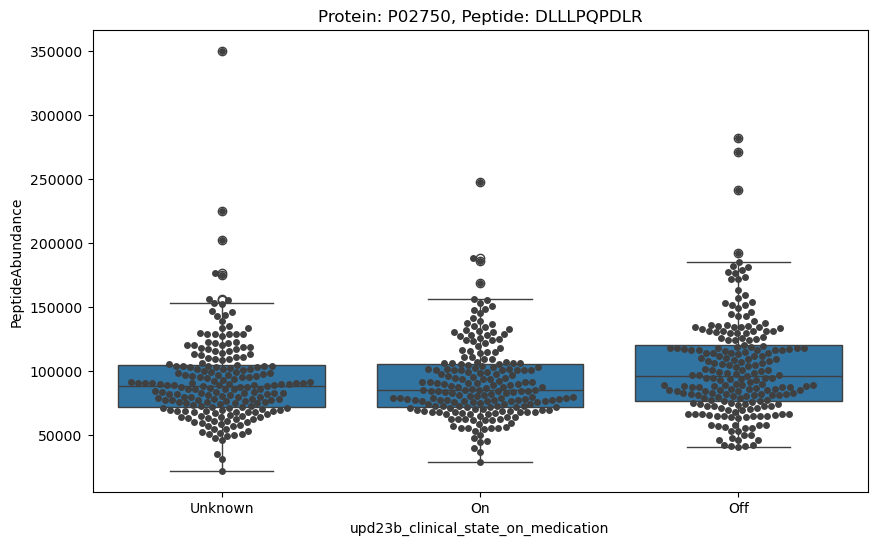

Unknown vs On: Mann-Whitney U test p-value = 0.7769702909278724
Unknown vs Off: Mann-Whitney U test p-value = 0.005322734289336822
On vs Off: Mann-Whitney U test p-value = 0.002184130503367235
Interpretation for Protein: P02750, Peptide: DLLLPQPDLR


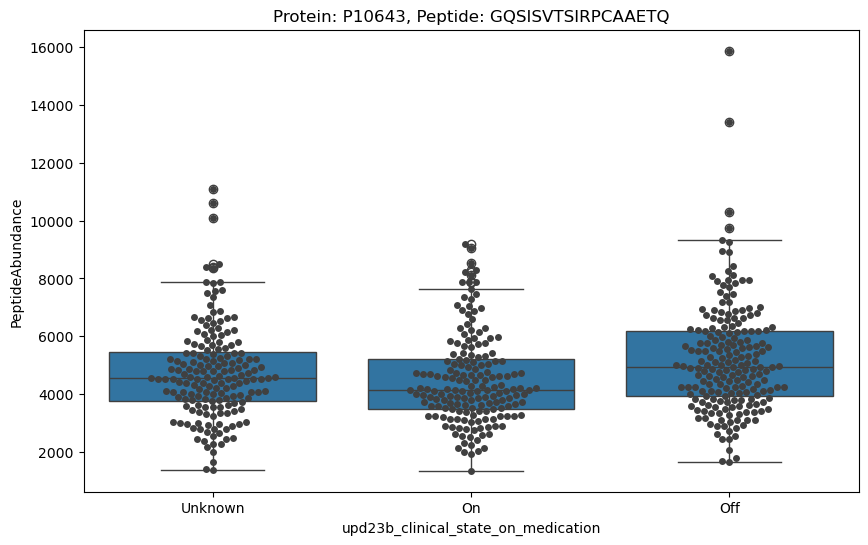

Unknown vs On: Mann-Whitney U test p-value = 0.07300849989548851
Unknown vs Off: Mann-Whitney U test p-value = 0.01590312956905803
On vs Off: Mann-Whitney U test p-value = 5.165101007505895e-05
Interpretation for Protein: P10643, Peptide: GQSISVTSIRPCAAETQ


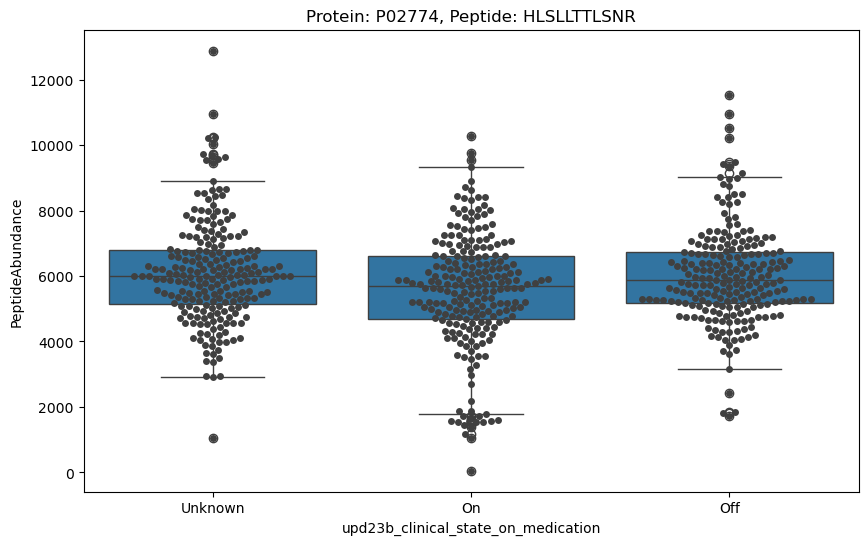

Unknown vs On: Mann-Whitney U test p-value = 0.003403243268644846
Unknown vs Off: Mann-Whitney U test p-value = 0.5093691470274118
On vs Off: Mann-Whitney U test p-value = 0.018281365663616222
Interpretation for Protein: P02774, Peptide: HLSLLTTLSNR


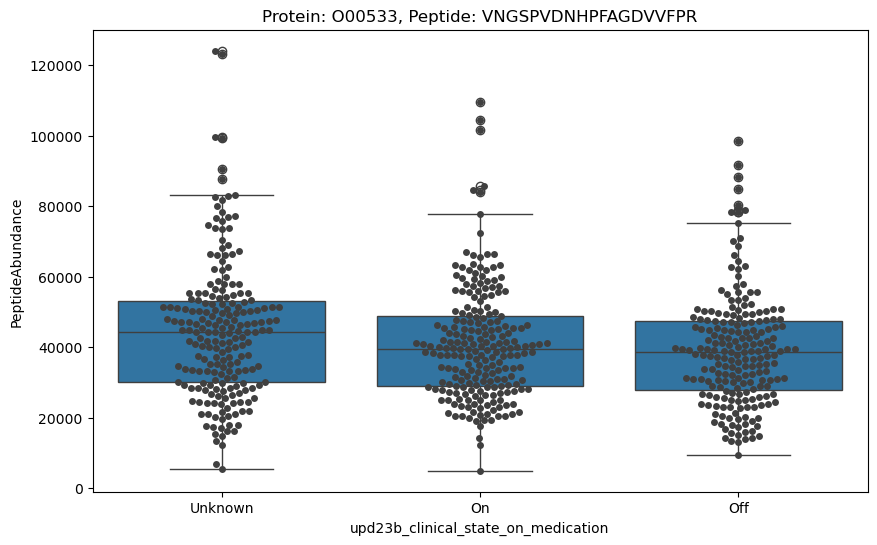

Unknown vs On: Mann-Whitney U test p-value = 0.031224674843065695
Unknown vs Off: Mann-Whitney U test p-value = 0.0013641854681445526
On vs Off: Mann-Whitney U test p-value = 0.24470211984106227
Interpretation for Protein: O00533, Peptide: VNGSPVDNHPFAGDVVFPR


In [ ]:
# Get the top peptides from the ANOVA results
top_peptides = peptide_anova_results_df_sorted.head(10).index

# Iterate through each top peptide for visualization and further analysis
for (protein, peptide) in top_peptides:
    # Filter the data for the specific protein and peptide
    specific_data = peptides_clinical_copy[(peptides_clinical_copy['UniProt'] == protein) &
                                           (peptides_clinical_copy['Peptide'] == peptide)]

    # Subsample 'Unknown' category
    subsampling_size = specific_data[specific_data['upd23b_clinical_state_on_medication'] != 'Unknown']['upd23b_clinical_state_on_medication'].value_counts().min()
    unknown_sampled = specific_data[specific_data['upd23b_clinical_state_on_medication'] == 'Unknown'].sample(subsampling_size, random_state=1)
    other_data = specific_data[specific_data['upd23b_clinical_state_on_medication'] != 'Unknown']
    balanced_data = pd.concat([unknown_sampled, other_data])

    # Visualization with boxplot and swarmplot
    plt.figure(figsize=(10, 6))
    boxplot = sns.boxplot(x='upd23b_clinical_state_on_medication', y='PeptideAbundance', data=balanced_data)
    sns.swarmplot(x='upd23b_clinical_state_on_medication', y='PeptideAbundance', data=balanced_data, color='.25')
    boxplot.set_title(f'Protein: {protein}, Peptide: {peptide}')
    plt.show()

    # Pairwise comparisons using Mann-Whitney U test
    unique_meds = balanced_data['upd23b_clinical_state_on_medication'].unique()
    for i, med1 in enumerate(unique_meds):
        for j, med2 in enumerate(unique_meds):
            if i >= j:
                continue
            data1 = balanced_data[balanced_data['upd23b_clinical_state_on_medication'] == med1]['PeptideAbundance']
            data2 = balanced_data[balanced_data['upd23b_clinical_state_on_medication'] == med2]['PeptideAbundance']
            stat, p = mannwhitneyu(data1, data2)
            print(f"{med1} vs {med2}: Mann-Whitney U test p-value = {p}")

    # Interpretation placeholder
    print(f"Interpretation for Protein: {protein}, Peptide: {peptide}")
    # Provide your interpretation here based on the results


In [ ]:
significant_df_final

,Medication Status 1,Medication Status 2,Protein,P-Value
0,On,Unknown,P05408_none,3.510730e-11
2,On,Unknown,P61916_none,3.115441e-09
4,On,Unknown,P36980_none,4.925384e-09
6,On,Unknown,P13611_none,1.834726e-08
8,On,Unknown,Q14508_none,4.083046e-08
...,...,...,...,...
218,Off,Unknown,Q9UHG2_none,9.053863e-03
220,Off,On,P01011_none,9.289855e-03
222,Off,On,Q8NE71_none,9.315467e-03
224,Off,Unknown,Q08380_none,9.386569e-03


## Mutated peptides

In [ ]:
# Some peptides are mutated, I will briefly explore that.

In [ ]:
clinical

,visit_id,patient_id,visit_month,updrs_1,updrs_2,updrs_3,updrs_4,upd23b_clinical_state_on_medication
0,55_0,55,0,10.0,6.0,15.0,NaN,NaN
1,55_3,55,3,10.0,7.0,25.0,NaN,NaN
2,55_6,55,6,8.0,10.0,34.0,NaN,NaN
3,55_9,55,9,8.0,9.0,30.0,0.0,On
4,55_12,55,12,10.0,10.0,41.0,0.0,On
...,...,...,...,...,...,...,...,...
2610,65043_48,65043,48,7.0,6.0,13.0,0.0,Off
2611,65043_54,65043,54,4.0,8.0,11.0,1.0,Off
2612,65043_60,65043,60,6.0,6.0,16.0,1.0,Off
2613,65043_72,65043,72,3.0,9.0,14.0,1.0,Off


In [ ]:
# This function will only remove '(UniMod_4)' from the peptide sequences.
def remove_modifications(peptide):
    return peptide.replace('(UniMod_4)', '')

# Calculate the Hamming distance between two sequences of equal length.
def hamming_distance(s1, s2):
    if len(s1) != len(s2):
        return float('inf')
    return sum(ch1 != ch2 for ch1, ch2 in zip(s1, s2))

# Check if two peptides are similar based on a defined criterion.
def peptides_similar(s1, s2):
    return hamming_distance(remove_modifications(s1), remove_modifications(s2)) <= 2

# Extract unique peptides from 'peptides_clinical_copy'
unique_peptides = peptides_clinical_copy['Peptide'].unique()

# Initialize an empty list to keep track of similar peptide pairs.
similar_peptides_unimod_mismatches = []

# Iterate over all combinations of unique peptides to find similar pairs.
for peptide1, peptide2 in combinations(unique_peptides, 2):
    if peptides_similar(peptide1, peptide2):
        similar_peptides_unimod_mismatches.append((peptide1, peptide2))

# Print out the number of similar peptide pairs and the pairs themselves.
print(f"Number of peptide pairs that only differ in (UniMod_4), plus a maximum of 2 other mismatches: {len(similar_peptides_unimod_mismatches)}")
for peptide_pair in similar_peptides_unimod_mismatches:
    print(peptide_pair)


Number of peptide pairs that only differ in (UniMod_4), plus a maximum of 2 other mismatches: 5
('TTPPVLDSDGSFFLYSK', 'TTPPVLDSDGSFFLYSR')
('NFPPSQDASGDLYTTSSQLTLPATQCLAGK', 'NFPPSQDASGDLYTTSSQLTLPATQCPDGK')
('SDVVYTDWK', 'SDVMYTDWK')
('SDVVYTDWKK', 'SDVMYTDWKK')
('EIVMTQSPATLSVSPGER', 'EIVLTQSPATLSLSPGER')


In [ ]:
# Eventually, will upload also some basic data explorating when it comes to aminoacid composition and properties of patients

def calculate_composition(peptide):
    analyzed_seq = ProteinAnalysis(peptide)
    amino_acid_percent = analyzed_seq.get_amino_acids_percent()

    # Define amino acid groups
    apolar = ['G', 'A', 'V', 'C', 'P', 'L', 'I', 'M', 'W', 'F']
    polar = ['S', 'T', 'Y', 'N', 'Q', 'H']
    charged = ['K', 'R', 'D', 'E']
    aromatic = ['W', 'Y', 'F', 'H']

    # Calculate the composition of each group
    comp = {
        'apolar': sum(amino_acid_percent[aa] for aa in apolar),
        'polar': sum(amino_acid_percent[aa] for aa in polar),
        'charged': sum(amino_acid_percent[aa] for aa in charged),
        'aromatic': sum(amino_acid_percent[aa] for aa in aromatic),
    }

    return comp

def calculate_charge(peptide):
    analyzed_seq = ProteinAnalysis(peptide)
    charge = analyzed_seq.charge_at_pH(7.4)  # pH can be manipulated

    return charge

def assign_hydrophobicity(peptide):
    analyzed_seq = ProteinAnalysis(peptide)
    hydrophobicity = analyzed_seq.gravy()

    return hydrophobicity


def calculate_weighted_properties(df):
    # Remove UniMod substrings
    df["Peptide"] = df["Peptide"].apply(lambda x: re.sub(r'\(.*?\)', '', x))

    # Calculate properties
    df["Hydrophobicity"] = df["Peptide"].apply(assign_hydrophobicity)
    df["Charge"] = df["Peptide"].apply(calculate_charge)
    df["Composition"] = df["Peptide"].apply(calculate_composition)

    # Calculate ratios
    df["HydrophobicityRatio"] = df["Composition"].apply(lambda x: x["apolar"] / (x["polar"] + x["apolar"]))
    df["ChargeRatio"] = df["Composition"].apply(lambda x: x["charged"] / (x["polar"] + x["apolar"]))
    df["AromaticityRatio"] = df["Composition"].apply(lambda x: x["aromatic"] / (x["polar"] + x["apolar"]))
    df["PolarityRatio"] = df["Composition"].apply(lambda x: x["polar"] / (x["polar"] + x["apolar"]))
    df["NetCharge"] = df["Charge"] / (df["Composition"].apply(lambda x: x["polar"] + x["apolar"]))

    properties = ["HydrophobicityRatio", "ChargeRatio", "AromaticityRatio", "PolarityRatio", "NetCharge"]

    # Calculate the weighted average for each property per visit_id
    weighted_properties = df.groupby("visit_id").apply(lambda g: pd.Series({
        prop: np.average(g[prop], weights=g["PeptideAbundance"])
        for prop in properties
    }))

    return weighted_properties

def categorize_amino_acid(aa):
    apolar = ['G', 'A', 'V', 'C', 'P', 'L', 'I', 'M', 'W', 'F']
    polar = ['S', 'T', 'Y', 'N', 'Q', 'H']
    charged = ['K', 'R', 'D', 'E']
    aromatic = ['W', 'Y', 'F', 'H']

    if aa in apolar:
        return "apolar"
    elif aa in polar:
        return "polar"
    elif aa in charged:
        return "charged"
    elif aa in aromatic:
        return "aromatic"
    else:
        return "unknown"


In [ ]:
for peptide_pair in similar_peptides_unimod_mismatches:
    peptide1, peptide2 = peptide_pair
    print(f"Analyzing pair: {peptide1}, {peptide2}")

    # Remove '(UniMod_4)' modifications for comparison
    clean_peptide1 = remove_modifications(peptide1)
    clean_peptide2 = remove_modifications(peptide2)

    if len(clean_peptide1) != len(clean_peptide2):
        print("Peptides have different lengths, skipping...")
        continue

    for i in range(len(clean_peptide1)):
        aa1 = clean_peptide1[i]
        aa2 = clean_peptide2[i]

        if aa1 != aa2:
            category1 = categorize_amino_acid(aa1)
            category2 = categorize_amino_acid(aa2)
            print(f"At position {i+1}, differing amino acids: {aa1} ({category1}) and {aa2} ({category2})")


Analyzing pair: TTPPVLDSDGSFFLYSK, TTPPVLDSDGSFFLYSR
At position 17, differing amino acids: K (charged) and R (charged)
Analyzing pair: NFPPSQDASGDLYTTSSQLTLPATQCLAGK, NFPPSQDASGDLYTTSSQLTLPATQCPDGK
At position 27, differing amino acids: L (apolar) and P (apolar)
At position 28, differing amino acids: A (apolar) and D (charged)
Analyzing pair: SDVVYTDWK, SDVMYTDWK
At position 4, differing amino acids: V (apolar) and M (apolar)
Analyzing pair: SDVVYTDWKK, SDVMYTDWKK
At position 4, differing amino acids: V (apolar) and M (apolar)
Analyzing pair: EIVMTQSPATLSVSPGER, EIVLTQSPATLSLSPGER
At position 4, differing amino acids: M (apolar) and L (apolar)
At position 13, differing amino acids: V (apolar) and L (apolar)


In [ ]:
# This function will only remove '(UniMod_4)' and '(UniMod_35)' from the peptide sequences for comparison.
def remove_modifications(peptide):
    return re.sub(r'\(UniMod_[34]5\)', '', peptide)

# Check if two peptides have '(UniMod_35)'
def has_unimod_35(peptide1, peptide2):
    return ('(UniMod_35)' in peptide1) != ('(UniMod_35)' in peptide2)

# Calculate the Hamming distance between two sequences of equal length.
def hamming_distance(s1, s2):
    if len(s1) != len(s2):
        return float('inf')
    return sum(ch1 != ch2 for ch1, ch2 in zip(s1, s2))

# Check if two peptides are similar based on a defined criterion.
def peptides_similar(s1, s2):
    modified_diff = has_unimod_35(s1, s2)
    return hamming_distance(remove_modifications(s1), remove_modifications(s2)) + modified_diff <= 2

# Extract unique peptides from 'peptides_clinical_copy'
unique_peptides = peptides_clinical_copy['Peptide'].unique()

# Initialize an empty list to keep track of similar peptide pairs.
similar_peptides_mismatches = []

# Iterate over all combinations of unique peptides to find similar pairs.
for peptide1, peptide2 in combinations(unique_peptides, 2):
    if peptides_similar(peptide1, peptide2):
        similar_peptides_mismatches.append((peptide1, peptide2))

# Print out the number of similar peptide pairs and the pairs themselves.
print(f"Number of peptide pairs that differ by a maximum of 2 mismatches: {len(similar_peptides_mismatches)}")
for peptide_pair in similar_peptides_mismatches:
    print(peptide_pair)


Number of peptide pairs that differ by a maximum of 2 mismatches: 29
('YVM(UniMod_35)LPVADQDQCIR', 'YVMLPVADQDQCIR')
('KLSSWVLLM(UniMod_35)K', 'KLSSWVLLMK')
('LSSWVLLM(UniMod_35)K', 'LSSWVLLMK')
('M(UniMod_35)CPQLQQYEMHGPEGLR', 'MCPQLQQYEMHGPEGLR')
('LVGGPM(UniMod_35)DASVEEEGVRR', 'LVGGPMDASVEEEGVRR')
('TTPPVLDSDGSFFLYSK', 'TTPPVLDSDGSFFLYSR')
('NFPPSQDASGDLYTTSSQLTLPATQCLAGK', 'NFPPSQDASGDLYTTSSQLTLPATQCPDGK')
('LGADM(UniMod_35)EDVCGR', 'LGADMEDVCGR')
('M(UniMod_35)ADEAGSEADHEGTHSTKR', 'MADEAGSEADHEGTHSTKR')
('M(UniMod_35)ELERPGGNEITR', 'MELERPGGNEITR')
('SDVVYTDWK', 'SDVMYTDWK')
('SDVVYTDWKK', 'SDVMYTDWKK')
('HTFM(UniMod_35)GVVSLGSPSGEVSHPR', 'HTFMGVVSLGSPSGEVSHPR')
('DSGFQM(UniMod_35)NQLR', 'DSGFQMNQLR')
('KDSGFQM(UniMod_35)NQLR', 'KDSGFQMNQLR')
('M(UniMod_35)YLGYEYVTAIR', 'MYLGYEYVTAIR')
('EIVMTQSPATLSVSPGER', 'EIVLTQSPATLSLSPGER')
('M(UniMod_35)TVTDQVNCPK', 'MTVTDQVNCPK')
('QHM(UniMod_35)DSDSSPSSSSTYCNQMMR', 'QHMDSDSSPSSSSTYCNQMMR')
('SNSSM(UniMod_35)HITDCR', 'SNSSMHITDCR')
('AQTT

In [ ]:
# Initialize a dictionary to hold peptide-to-protein mappings
peptide_to_protein_mapping = {}

# Loop through the list of similar peptides
for peptide1, peptide2 in similar_peptides_mismatches:

    # Query peptides_clinical_copy to find the proteins containing these peptides
    proteins1 = peptides_clinical_copy.loc[peptides_clinical_copy['Peptide'] == peptide1, 'UniProt'].unique().tolist()
    proteins2 = peptides_clinical_copy.loc[peptides_clinical_copy['Peptide'] == peptide2, 'UniProt'].unique().tolist()

    # Store in the dictionary
    peptide_to_protein_mapping[peptide1] = proteins1
    peptide_to_protein_mapping[peptide2] = proteins2

# Output the mappings
for peptide, proteins in peptide_to_protein_mapping.items():
    print(f"The peptide {peptide} is associated with the following proteins: {proteins}")



The peptide YVM(UniMod_35)LPVADQDQCIR is associated with the following proteins: ['P00738']
The peptide YVMLPVADQDQCIR is associated with the following proteins: ['P00738']
The peptide KLSSWVLLM(UniMod_35)K is associated with the following proteins: ['P01009']
The peptide KLSSWVLLMK is associated with the following proteins: ['P01009']
The peptide LSSWVLLM(UniMod_35)K is associated with the following proteins: ['P01009']
The peptide LSSWVLLMK is associated with the following proteins: ['P01009']
The peptide M(UniMod_35)CPQLQQYEMHGPEGLR is associated with the following proteins: ['P01023']
The peptide MCPQLQQYEMHGPEGLR is associated with the following proteins: ['P01023']
The peptide LVGGPM(UniMod_35)DASVEEEGVRR is associated with the following proteins: ['P01034']
The peptide LVGGPMDASVEEEGVRR is associated with the following proteins: ['P01034']
The peptide TTPPVLDSDGSFFLYSK is associated with the following proteins: ['P01857']
The peptide TTPPVLDSDGSFFLYSR is associated with the foll

In [ ]:
peptides_proteins_relation = pd.DataFrame(list(peptide_to_protein_mapping.items()), columns=['Peptide', 'Proteins'])

In [ ]:
peptides_proteins_relation

,Peptide,Proteins
0,YVM(UniMod_35)LPVADQDQCIR,[P00738]
1,YVMLPVADQDQCIR,[P00738]
2,KLSSWVLLM(UniMod_35)K,[P01009]
3,KLSSWVLLMK,[P01009]
4,LSSWVLLM(UniMod_35)K,[P01009]
5,LSSWVLLMK,[P01009]
6,M(UniMod_35)CPQLQQYEMHGPEGLR,[P01023]
7,MCPQLQQYEMHGPEGLR,[P01023]
8,LVGGPM(UniMod_35)DASVEEEGVRR,[P01034]
9,LVGGPMDASVEEEGVRR,[P01034]


In [ ]:
# Initialize an empty set to hold unique proteins
unique_proteins = set()

# Loop through the DataFrame to collect unique proteins
for protein_list in peptides_proteins_relation['Proteins']:
    for protein in protein_list:
        unique_proteins.add(protein)

# Count the number of unique proteins
num_unique_proteins = len(unique_proteins)

# Print the results
print(f"Number of unique proteins: {num_unique_proteins}")
print(f"Unique proteins: {unique_proteins}")


Number of unique proteins: 24
Unique proteins: {'P19652', 'P01034', 'P02649', 'P09871', 'P02671', 'P07998', 'P00738', 'P04207', 'P41222', 'P08603', 'P01861', 'P10909', 'P02787', 'P01857', 'P01023', 'P04433', 'P01877', 'P02765', 'P05090', 'P01009', 'P02763', 'P23142', 'Q92520', 'P01876'}


In [ ]:
results = []

for peptide1, peptide2 in similar_peptides_mismatches:
    filtered_df1 = peptides_clinical_copy[peptides_clinical_copy['Peptide'] == peptide1]
    filtered_df2 = peptides_clinical_copy[peptides_clinical_copy['Peptide'] == peptide2]

    cross_tab1 = pd.crosstab(index=filtered_df1['upd23b_clinical_state_on_medication'], columns='PeptideAbundance1')
    cross_tab2 = pd.crosstab(index=filtered_df2['upd23b_clinical_state_on_medication'], columns='PeptideAbundance2')

    # Combined cross-tabulation
    combined_cross_tab = pd.concat([cross_tab1, cross_tab2], axis=1).fillna(0)

    # Chi-square test
    chi2, p_value, _, _ = chi2_contingency(combined_cross_tab)

    results.append({
        'Peptide1': peptide1,
        'Peptide2': peptide2,
        'Chi2': chi2,
        'p_value': p_value
    })

results_df = pd.DataFrame(results)
print(results_df)


                                   Peptide1                        Peptide2  \
0                 YVM(UniMod_35)LPVADQDQCIR                  YVMLPVADQDQCIR   
1                     KLSSWVLLM(UniMod_35)K                      KLSSWVLLMK   
2                      LSSWVLLM(UniMod_35)K                       LSSWVLLMK   
3              M(UniMod_35)CPQLQQYEMHGPEGLR               MCPQLQQYEMHGPEGLR   
4              LVGGPM(UniMod_35)DASVEEEGVRR               LVGGPMDASVEEEGVRR   
5                         TTPPVLDSDGSFFLYSK               TTPPVLDSDGSFFLYSR   
6            NFPPSQDASGDLYTTSSQLTLPATQCLAGK  NFPPSQDASGDLYTTSSQLTLPATQCPDGK   
7                    LGADM(UniMod_35)EDVCGR                     LGADMEDVCGR   
8            M(UniMod_35)ADEAGSEADHEGTHSTKR             MADEAGSEADHEGTHSTKR   
9                  M(UniMod_35)ELERPGGNEITR                   MELERPGGNEITR   
10                                SDVVYTDWK                       SDVMYTDWK   
11                               SDVVYTDWKK         

In [ ]:
import pandas as pd
from scipy.stats import mannwhitneyu

# Replace this with your actual DataFrame
# peptides_clinical_copy = pd.read_csv('your_file.csv')

results = []

# Conditions to compare
conditions = ['On', 'Off', 'Unknown']

for peptide1, peptide2 in similar_peptides_mismatches:
    for cond in conditions:
        filtered_df1 = peptides_clinical_copy[(peptides_clinical_copy['Peptide'] == peptide1) & (peptides_clinical_copy['upd23b_clinical_state_on_medication'] == cond)]
        filtered_df2 = peptides_clinical_copy[(peptides_clinical_copy['Peptide'] == peptide2) & (peptides_clinical_copy['upd23b_clinical_state_on_medication'] == cond)]

        if len(filtered_df1) == 0 or len(filtered_df2) == 0:
            continue  # Skip if no data for a peptide in a given condition

        # Mann-Whitney U test
        _, p_value = mannwhitneyu(filtered_df1['PeptideAbundance'], filtered_df2['PeptideAbundance'])

        results.append({
            'Peptide1': peptide1,
            'Peptide2': peptide2,
            'Condition': cond,
            'p_value': p_value
        })

results_df = pd.DataFrame(results)
print(results_df)


                     Peptide1        Peptide2 Condition        p_value
0   YVM(UniMod_35)LPVADQDQCIR  YVMLPVADQDQCIR        On   2.655086e-61
1   YVM(UniMod_35)LPVADQDQCIR  YVMLPVADQDQCIR       Off   3.087173e-64
2   YVM(UniMod_35)LPVADQDQCIR  YVMLPVADQDQCIR   Unknown  7.198138e-174
3       KLSSWVLLM(UniMod_35)K      KLSSWVLLMK        On   1.053100e-65
4       KLSSWVLLM(UniMod_35)K      KLSSWVLLMK       Off   3.216958e-66
..                        ...             ...       ...            ...
82   ICLEDNVLM(UniMod_35)SGVK   ICLEDNVLMSGVK       Off   4.349624e-60
83   ICLEDNVLM(UniMod_35)SGVK   ICLEDNVLMSGVK   Unknown  1.478592e-170
84    M(UniMod_35)ASGAANVVGPK    MASGAANVVGPK        On   5.167352e-59
85    M(UniMod_35)ASGAANVVGPK    MASGAANVVGPK       Off   5.830465e-63
86    M(UniMod_35)ASGAANVVGPK    MASGAANVVGPK   Unknown  2.273885e-180

[87 rows x 4 columns]


In [ ]:
results_df

,Peptide1,Peptide2,Condition,p_value
0,YVM(UniMod_35)LPVADQDQCIR,YVMLPVADQDQCIR,On,2.655086e-61
1,YVM(UniMod_35)LPVADQDQCIR,YVMLPVADQDQCIR,Off,3.087173e-64
2,YVM(UniMod_35)LPVADQDQCIR,YVMLPVADQDQCIR,Unknown,7.198138e-174
3,KLSSWVLLM(UniMod_35)K,KLSSWVLLMK,On,1.053100e-65
4,KLSSWVLLM(UniMod_35)K,KLSSWVLLMK,Off,3.216958e-66
...,...,...,...,...
82,ICLEDNVLM(UniMod_35)SGVK,ICLEDNVLMSGVK,Off,4.349624e-60
83,ICLEDNVLM(UniMod_35)SGVK,ICLEDNVLMSGVK,Unknown,1.478592e-170
84,M(UniMod_35)ASGAANVVGPK,MASGAANVVGPK,On,5.167352e-59
85,M(UniMod_35)ASGAANVVGPK,MASGAANVVGPK,Off,5.830465e-63


In [ ]:
peptides_clinical_copy

,visit_id,visit_month,patient_id,UniProt,Peptide,PeptideAbundance,updrs_1,updrs_2,updrs_3,updrs_4,upd23b_clinical_state_on_medication
0,55_0,0,55,O00391,NEQEQPLGQWHLS,11254.30,10.0,6.0,15.0,NaN,Unknown
1,55_0,0,55,O00533,GNPEPTFSWTK,102060.00,10.0,6.0,15.0,NaN,Unknown
2,55_0,0,55,O00533,IEIPSSVQQVPTIIK,174185.00,10.0,6.0,15.0,NaN,Unknown
3,55_0,0,55,O00533,KPQSAVYSTGSNGILLCEAEGEPQPTIK,27278.90,10.0,6.0,15.0,NaN,Unknown
4,55_0,0,55,O00533,SMEQNGPGLEYR,30838.70,10.0,6.0,15.0,NaN,Unknown
...,...,...,...,...,...,...,...,...,...,...,...
941739,58648_108,108,58648,Q9UHG2,ILAGSADSEGVAAPR,202820.00,6.0,0.0,0.0,NaN,Unknown
941740,58648_108,108,58648,Q9UKV8,SGNIPAGTTVDTK,105830.00,6.0,0.0,0.0,NaN,Unknown
941741,58648_108,108,58648,Q9Y646,LALLVDTVGPR,21257.60,6.0,0.0,0.0,NaN,Unknown
941742,58648_108,108,58648,Q9Y6R7,AGCVAESTAVCR,5127.26,6.0,0.0,0.0,NaN,Unknown


In [ ]:
# Add a new column for log2-transformed Peptide Abundance
peptides_clinical_copy['NPX_log2'] = np.log2(peptides_clinical_copy['PeptideAbundance'])


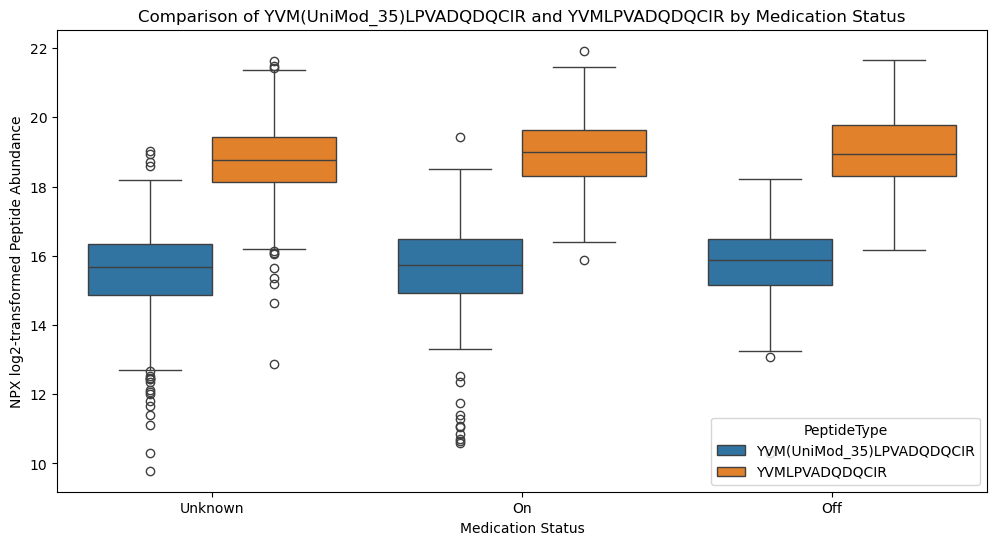

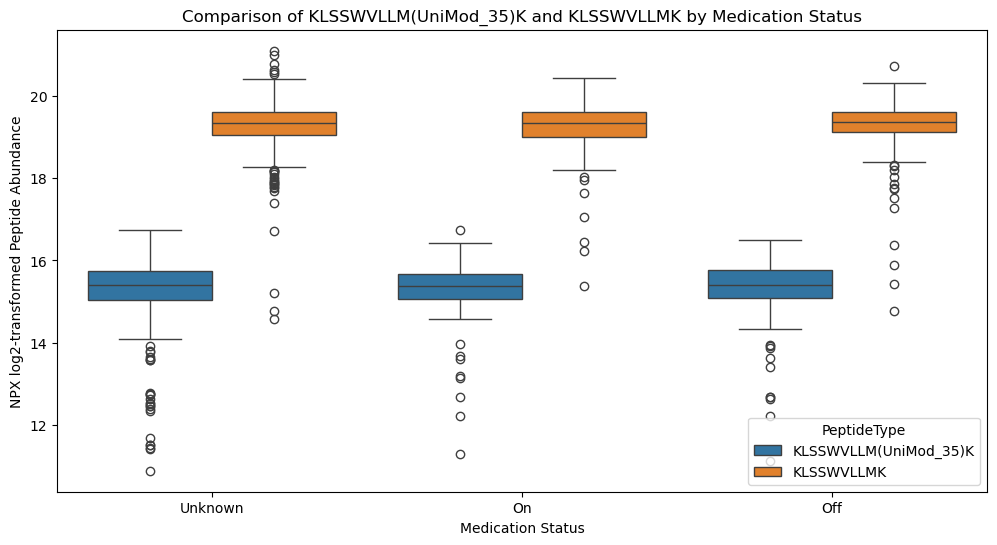

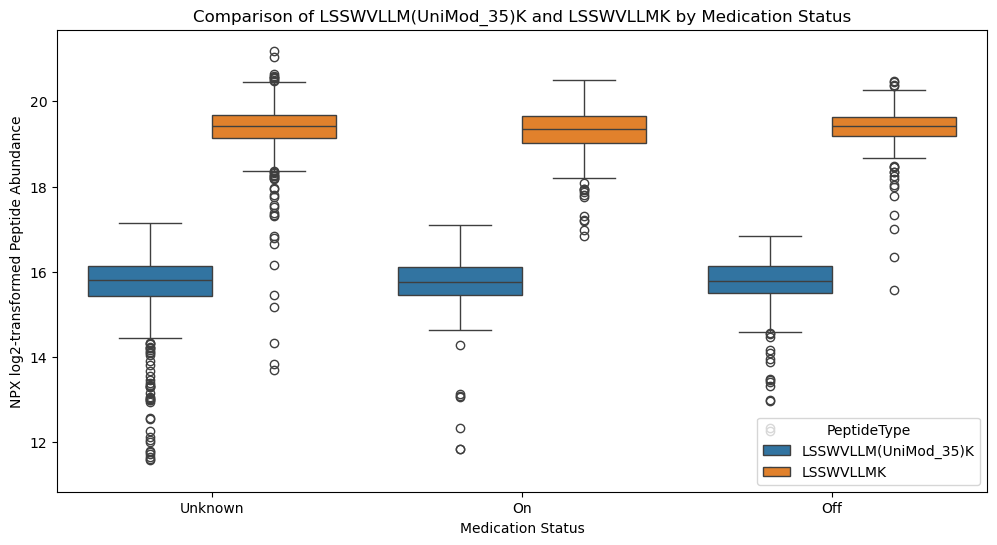

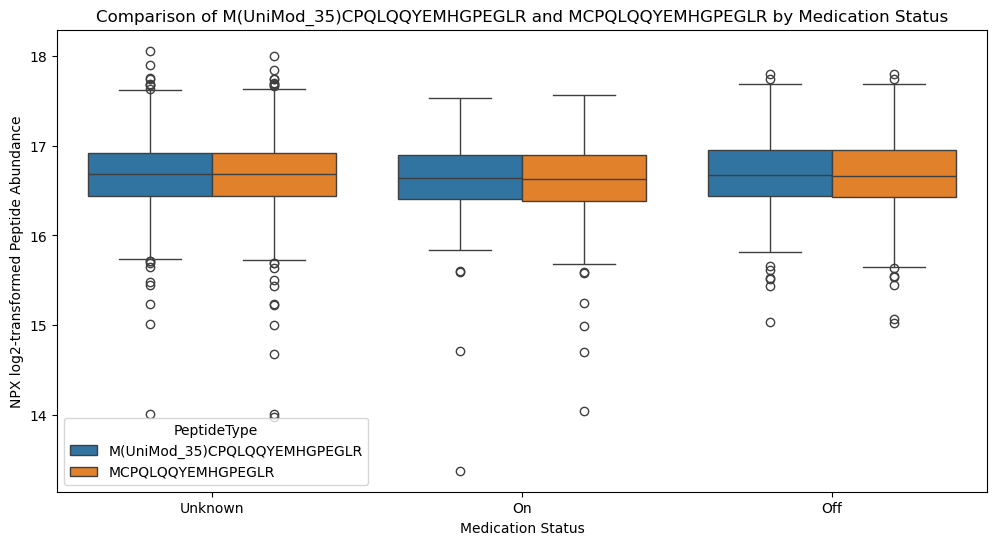

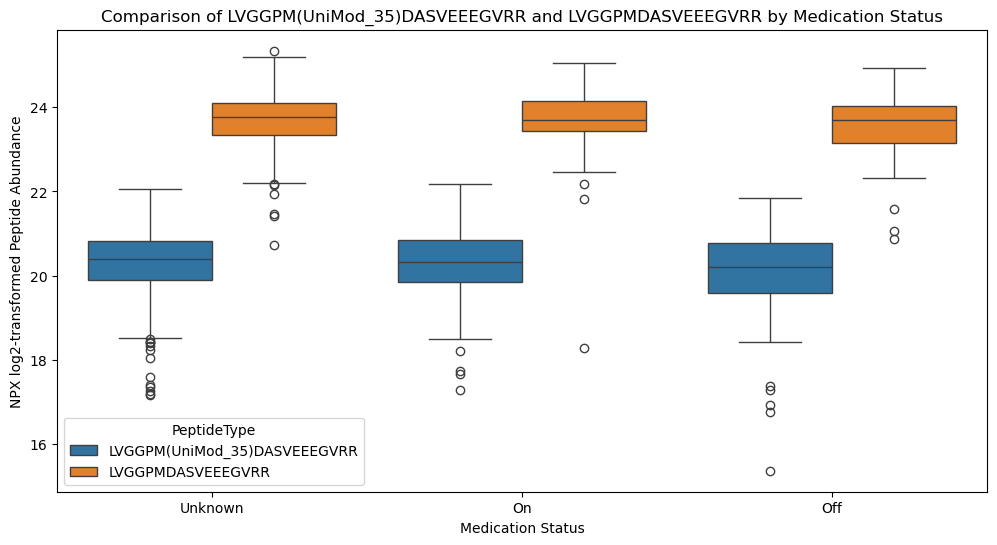

...

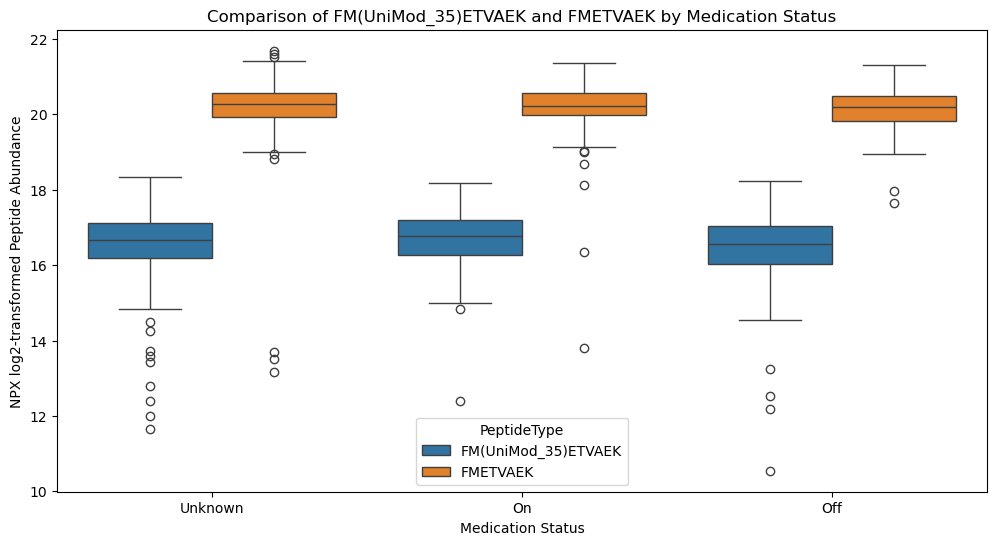

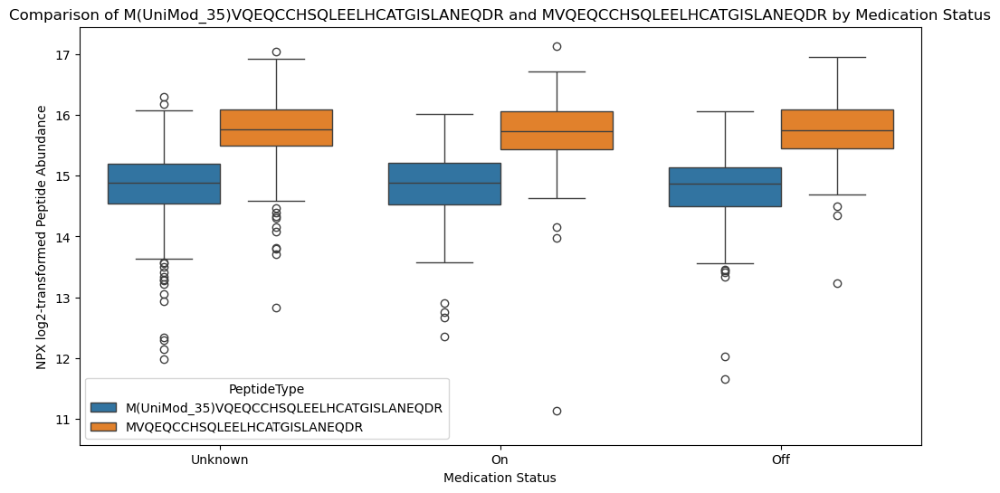

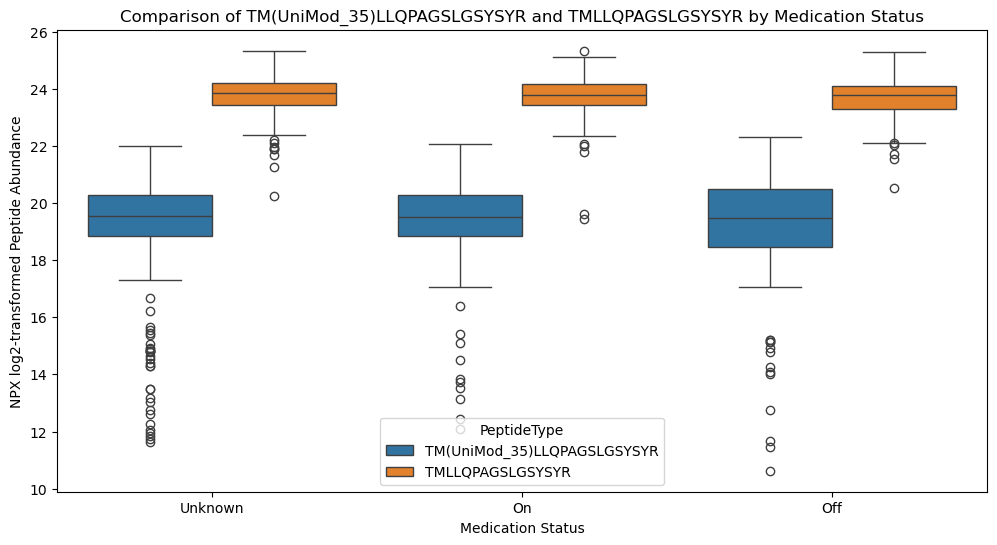

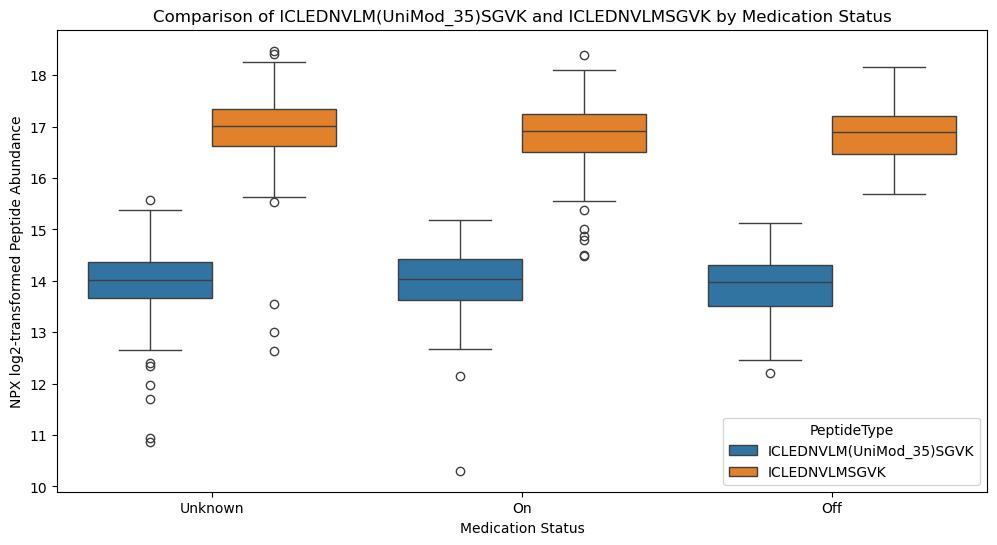

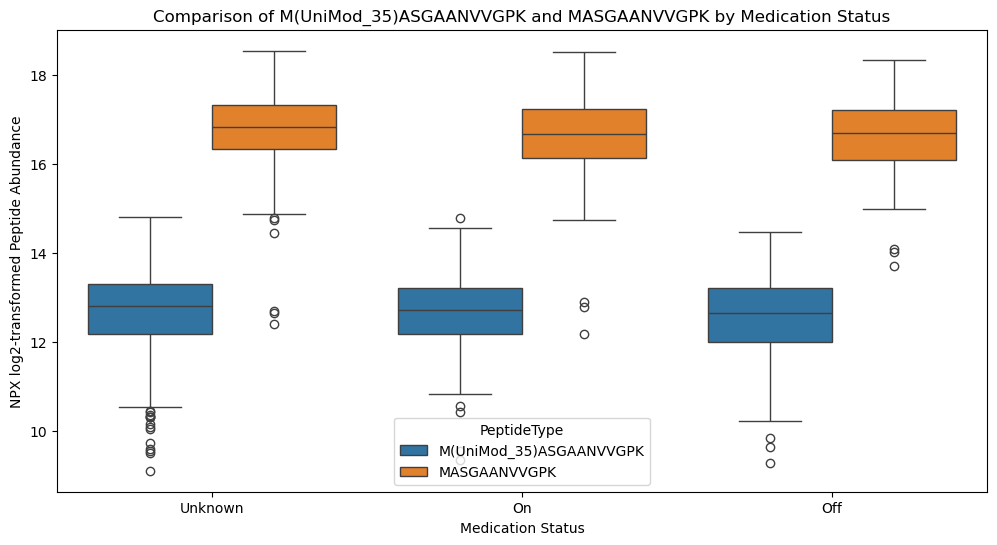

In [ ]:
for peptide1, peptide2 in similar_peptides_mismatches:
    plt.figure(figsize=(12, 6))

    # Filter the DataFrame for the peptide pairs
    filtered_df1 = peptides_clinical_copy[peptides_clinical_copy['Peptide'] == peptide1]
    filtered_df2 = peptides_clinical_copy[peptides_clinical_copy['Peptide'] == peptide2]

    # Add a column to identify the peptide type in the plot
    filtered_df1['PeptideType'] = peptide1
    filtered_df2['PeptideType'] = peptide2

    # Combine the two filtered DataFrames
    combined_df = pd.concat([filtered_df1, filtered_df2])

    # Create the boxplot using the new NPX_log2 column
    sns.boxplot(x='upd23b_clinical_state_on_medication', y='NPX_log2', hue='PeptideType', data=combined_df)

    # Add title and labels
    plt.title(f'Comparison of {peptide1} and {peptide2} by Medication Status')
    plt.xlabel('Medication Status')
    plt.ylabel('NPX log2-transformed Peptide Abundance')

    plt.show()


In [ ]:
peptides_clinical_copy

,visit_id,visit_month,patient_id,UniProt,Peptide,PeptideAbundance,updrs_1,updrs_2,updrs_3,updrs_4,upd23b_clinical_state_on_medication,NPX_log2
0,55_0,0,55,O00391,NEQEQPLGQWHLS,11254.30,10.0,6.0,15.0,NaN,Unknown,13.458189
1,55_0,0,55,O00533,GNPEPTFSWTK,102060.00,10.0,6.0,15.0,NaN,Unknown,16.639058
2,55_0,0,55,O00533,IEIPSSVQQVPTIIK,174185.00,10.0,6.0,15.0,NaN,Unknown,17.410261
3,55_0,0,55,O00533,KPQSAVYSTGSNGILLCEAEGEPQPTIK,27278.90,10.0,6.0,15.0,NaN,Unknown,14.735498
4,55_0,0,55,O00533,SMEQNGPGLEYR,30838.70,10.0,6.0,15.0,NaN,Unknown,14.912454
...,...,...,...,...,...,...,...,...,...,...,...,...
941739,58648_108,108,58648,Q9UHG2,ILAGSADSEGVAAPR,202820.00,6.0,0.0,0.0,NaN,Unknown,17.629840
941740,58648_108,108,58648,Q9UKV8,SGNIPAGTTVDTK,105830.00,6.0,0.0,0.0,NaN,Unknown,16.691389
941741,58648_108,108,58648,Q9Y646,LALLVDTVGPR,21257.60,6.0,0.0,0.0,NaN,Unknown,14.375691
941742,58648_108,108,58648,Q9Y6R7,AGCVAESTAVCR,5127.26,6.0,0.0,0.0,NaN,Unknown,12.323972


In [ ]:
similar_peptides_mismatches

[('YVM(UniMod_35)LPVADQDQCIR', 'YVMLPVADQDQCIR'),
 ('KLSSWVLLM(UniMod_35)K', 'KLSSWVLLMK'),
 ('LSSWVLLM(UniMod_35)K', 'LSSWVLLMK'),
 ('M(UniMod_35)CPQLQQYEMHGPEGLR', 'MCPQLQQYEMHGPEGLR'),
 ('LVGGPM(UniMod_35)DASVEEEGVRR', 'LVGGPMDASVEEEGVRR'),
 ('TTPPVLDSDGSFFLYSK', 'TTPPVLDSDGSFFLYSR'),
 ('NFPPSQDASGDLYTTSSQLTLPATQCLAGK', 'NFPPSQDASGDLYTTSSQLTLPATQCPDGK'),
 ('LGADM(UniMod_35)EDVCGR', 'LGADMEDVCGR'),
 ('M(UniMod_35)ADEAGSEADHEGTHSTKR', 'MADEAGSEADHEGTHSTKR'),
 ('M(UniMod_35)ELERPGGNEITR', 'MELERPGGNEITR'),
 ('SDVVYTDWK', 'SDVMYTDWK'),
 ('SDVVYTDWKK', 'SDVMYTDWKK'),
 ('HTFM(UniMod_35)GVVSLGSPSGEVSHPR', 'HTFMGVVSLGSPSGEVSHPR'),
 ('DSGFQM(UniMod_35)NQLR', 'DSGFQMNQLR'),
 ('KDSGFQM(UniMod_35)NQLR', 'KDSGFQMNQLR'),
 ('M(UniMod_35)YLGYEYVTAIR', 'MYLGYEYVTAIR'),
 ('EIVMTQSPATLSVSPGER', 'EIVLTQSPATLSLSPGER'),
 ('M(UniMod_35)TVTDQVNCPK', 'MTVTDQVNCPK'),
 ('QHM(UniMod_35)DSDSSPSSSSTYCNQMMR', 'QHMDSDSSPSSSSTYCNQMMR'),
 ('SNSSM(UniMod_35)HITDCR', 'SNSSMHITDCR'),
 ('AQTTVTCM(UniMod_35)ENGWSPTPR', '

In [ ]:
# Initialize an empty DataFrame to hold the peptide ratios
peptide_ratio_df = pd.DataFrame()
peptide_ratio_df['visit_id'] = peptides_clinical_copy['visit_id'].drop_duplicates().reset_index(drop=True)

# Include medication status from the original DataFrame
# Assuming the medication status is stored in a column named 'upd23b_clinical_state_on_medication'
medication_status = peptides_clinical_copy[['visit_id', 'upd23b_clinical_state_on_medication']].drop_duplicates().reset_index(drop=True)
peptide_ratio_df = pd.merge(peptide_ratio_df, medication_status, on='visit_id', how='left')

# Small number to avoid division by zero
small_number = 1e-9

# Loop through the list of similar peptide pairs
for modified, unmodified in similar_peptides_mismatches:
    # Pivot the DataFrame to get the peptide abundances for each visit_id
    pivot_df = peptides_clinical_copy.pivot(index='visit_id', columns='Peptide', values='PeptideAbundance')

    # Calculate the ratio for each visit_id
    ratio_series = (pivot_df[modified] + small_number) / (pivot_df[unmodified] + small_number)

    # Name the new column as 'ratio_modified_unmodified'
    ratio_column_name = f'ratio_{modified}_{unmodified}'

    # Merge the ratio back into the peptide_ratio_df DataFrame
    peptide_ratio_df = pd.merge(peptide_ratio_df, ratio_series.rename(ratio_column_name),
                                left_on='visit_id', right_index=True, how='left')

# Replace inf and -inf with np.nan
peptide_ratio_df.replace([np.inf, -np.inf], np.nan, inplace=True)

# Show the resulting DataFrame
peptide_ratio_df


,visit_id,upd23b_clinical_state_on_medication,ratio_YVM(UniMod_35)LPVADQDQCIR_YVMLPVADQDQCIR,ratio_KLSSWVLLM(UniMod_35)K_KLSSWVLLMK,ratio_LSSWVLLM(UniMod_35)K_LSSWVLLMK,ratio_M(UniMod_35)CPQLQQYEMHGPEGLR_MCPQLQQYEMHGPEGLR,ratio_LVGGPM(UniMod_35)DASVEEEGVRR_LVGGPMDASVEEEGVRR,ratio_TTPPVLDSDGSFFLYSK_TTPPVLDSDGSFFLYSR,ratio_NFPPSQDASGDLYTTSSQLTLPATQCLAGK_NFPPSQDASGDLYTTSSQLTLPATQCPDGK,ratio_LGADM(UniMod_35)EDVCGR_LGADMEDVCGR,...,ratio_SNSSM(UniMod_35)HITDCR_SNSSMHITDCR,ratio_AQTTVTCM(UniMod_35)ENGWSPTPR_AQTTVTCMENGWSPTPR,ratio_IVSSAMEPDREYHFGQAVR_IVSSAM(UniMod_35)EPDREYHFGQAVR,ratio_TM(UniMod_35)QENSTPRED_TMQENSTPRED,ratio_DQTVSDNELQEM(UniMod_35)SNQGSK_DQTVSDNELQEMSNQGSK,ratio_FM(UniMod_35)ETVAEK_FMETVAEK,ratio_M(UniMod_35)VQEQCCHSQLEELHCATGISLANEQDR_MVQEQCCHSQLEELHCATGISLANEQDR,ratio_TM(UniMod_35)LLQPAGSLGSYSYR_TMLLQPAGSLGSYSYR,ratio_ICLEDNVLM(UniMod_35)SGVK_ICLEDNVLMSGVK,ratio_M(UniMod_35)ASGAANVVGPK_MASGAANVVGPK
0,55_0,Unknown,0.184088,NaN,0.087479,1.001089,0.103821,4.374246,NaN,0.060564,...,0.059102,0.669908,NaN,0.876806,0.037972,0.100451,0.661522,0.072558,0.129848,0.070864
1,1517_0,On,0.131693,0.058153,0.065974,1.006859,0.119872,3.578951,7.547246,0.078945,...,NaN,0.659452,1.165711,1.003589,0.059984,0.131726,0.524397,0.089129,NaN,0.085192
2,1923_0,Unknown,0.139392,0.069794,0.095993,0.997252,0.086965,NaN,NaN,0.043752,...,0.034794,0.619584,1.087276,1.000212,0.022739,0.068385,0.539104,0.051766,0.093754,0.040741
3,2660_0,Unknown,0.126942,0.068662,0.083673,1.010194,0.090138,3.244995,4.203160,0.004650,...,0.024107,0.725499,1.175424,1.000870,0.032635,0.076615,0.557658,0.059041,0.118760,0.040014
4,3636_0,Unknown,NaN,NaN,NaN,1.005805,NaN,NaN,0.741983,NaN,...,NaN,0.655244,1.164700,1.006163,0.016144,0.007096,0.557794,0.034443,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1063,5645_96,Unknown,0.124672,0.066099,0.087283,1.003255,0.075721,1.540246,7.087362,0.032506,...,NaN,0.716084,1.125655,1.012907,0.024464,0.057698,0.465147,0.058934,0.112344,0.033375
1064,58648_96,Unknown,0.092906,0.085846,0.096496,0.961170,0.125257,0.090979,2.757732,0.082031,...,0.052569,0.469634,1.162136,1.005316,0.041487,0.087924,0.525162,0.130983,0.088107,0.067653
1065,5645_108,Unknown,0.160490,0.084616,0.112470,1.003168,0.093195,1.596976,5.832580,0.085269,...,0.026074,0.583622,1.128434,1.007728,0.029080,0.063659,0.523893,0.074585,0.114530,0.036568
1066,55096_108,Off,0.097716,0.056612,0.097666,1.002521,0.087263,2.498099,3.436824,0.071119,...,NaN,0.736435,1.059933,1.007694,0.054628,0.123934,NaN,0.074609,0.063485,0.080373


In [ ]:
peptide_ratio_df = pd.DataFrame()
peptide_ratio_df['visit_id'] = peptides_clinical_copy['visit_id'].drop_duplicates().reset_index(drop=True)

# Include medication status from the original DataFrame
# Assuming the medication status is stored in a column named 'upd23b_clinical_state_on_medication'
medication_status = peptides_clinical_copy[['visit_id', 'upd23b_clinical_state_on_medication']].drop_duplicates().reset_index(drop=True)
peptide_ratio_df = pd.merge(peptide_ratio_df, medication_status, on='visit_id', how='left')

# Small number to avoid division by zero
small_number = 1e-9

# Loop through the list of similar peptide pairs
for modified, unmodified in similar_peptides_mismatches:
    # Pivot the DataFrame to get the peptide abundances for each visit_id
    pivot_df = peptides_clinical_copy.pivot(index='visit_id', columns='Peptide', values='PeptideAbundance')

    # Calculate the ratio for each visit_id
    ratio_series = (pivot_df[modified] + small_number) / (pivot_df[unmodified] + small_number)

    # Name the new column as 'ratio_modified_unmodified'
    ratio_column_name = f'ratio_{modified}_{unmodified}'

    # Merge the ratio back into the peptide_ratio_df DataFrame
    peptide_ratio_df = pd.merge(peptide_ratio_df, ratio_series.rename(ratio_column_name),
                                left_on='visit_id', right_index=True, how='left')

# Replace inf and -inf with np.nan
peptide_ratio_df.replace([np.inf, -np.inf], np.nan, inplace=True)

# Show the resulting DataFrame
peptide_ratio_df.head()

,visit_id,upd23b_clinical_state_on_medication,ratio_YVM(UniMod_35)LPVADQDQCIR_YVMLPVADQDQCIR,ratio_KLSSWVLLM(UniMod_35)K_KLSSWVLLMK,ratio_LSSWVLLM(UniMod_35)K_LSSWVLLMK,ratio_M(UniMod_35)CPQLQQYEMHGPEGLR_MCPQLQQYEMHGPEGLR,ratio_LVGGPM(UniMod_35)DASVEEEGVRR_LVGGPMDASVEEEGVRR,ratio_TTPPVLDSDGSFFLYSK_TTPPVLDSDGSFFLYSR,ratio_NFPPSQDASGDLYTTSSQLTLPATQCLAGK_NFPPSQDASGDLYTTSSQLTLPATQCPDGK,ratio_LGADM(UniMod_35)EDVCGR_LGADMEDVCGR,...,ratio_SNSSM(UniMod_35)HITDCR_SNSSMHITDCR,ratio_AQTTVTCM(UniMod_35)ENGWSPTPR_AQTTVTCMENGWSPTPR,ratio_IVSSAMEPDREYHFGQAVR_IVSSAM(UniMod_35)EPDREYHFGQAVR,ratio_TM(UniMod_35)QENSTPRED_TMQENSTPRED,ratio_DQTVSDNELQEM(UniMod_35)SNQGSK_DQTVSDNELQEMSNQGSK,ratio_FM(UniMod_35)ETVAEK_FMETVAEK,ratio_M(UniMod_35)VQEQCCHSQLEELHCATGISLANEQDR_MVQEQCCHSQLEELHCATGISLANEQDR,ratio_TM(UniMod_35)LLQPAGSLGSYSYR_TMLLQPAGSLGSYSYR,ratio_ICLEDNVLM(UniMod_35)SGVK_ICLEDNVLMSGVK,ratio_M(UniMod_35)ASGAANVVGPK_MASGAANVVGPK
0,55_0,Unknown,0.184088,NaN,0.087479,1.001089,0.103821,4.374246,NaN,0.060564,...,0.059102,0.669908,NaN,0.876806,0.037972,0.100451,0.661522,0.072558,0.129848,0.070864
1,1517_0,On,0.131693,0.058153,0.065974,1.006859,0.119872,3.578951,7.547246,0.078945,...,NaN,0.659452,1.165711,1.003589,0.059984,0.131726,0.524397,0.089129,NaN,0.085192
2,1923_0,Unknown,0.139392,0.069794,0.095993,0.997252,0.086965,NaN,NaN,0.043752,...,0.034794,0.619584,1.087276,1.000212,0.022739,0.068385,0.539104,0.051766,0.093754,0.040741
3,2660_0,Unknown,0.126942,0.068662,0.083673,1.010194,0.090138,3.244995,4.203160,0.004650,...,0.024107,0.725499,1.175424,1.000870,0.032635,0.076615,0.557658,0.059041,0.118760,0.040014
4,3636_0,Unknown,NaN,NaN,NaN,1.005805,NaN,NaN,0.741983,NaN,...,NaN,0.655244,1.164700,1.006163,0.016144,0.007096,0.557794,0.034443,NaN,NaN


In [ ]:
peptide_ratio_df = pd.DataFrame()
peptide_ratio_df['visit_id'] = peptides_clinical_copy['visit_id'].drop_duplicates().reset_index(drop=True)

# Include medication status from the original DataFrame
# Assuming the medication status is stored in a column named 'upd23b_clinical_state_on_medication'
medication_status = peptides_clinical_copy[['visit_id', 'upd23b_clinical_state_on_medication']].drop_duplicates().reset_index(drop=True)
peptide_ratio_df = pd.merge(peptide_ratio_df, medication_status, on='visit_id', how='left')

# Small number to avoid division by zero
small_number = 1e-9

# Loop through the list of similar peptide pairs
for modified, unmodified in similar_peptides_mismatches:
    # Pivot the DataFrame to get the peptide abundances for each visit_id
    pivot_df = peptides_clinical_copy.pivot(index='visit_id', columns='Peptide', values='PeptideAbundance')

    # Calculate the ratio for each visit_id
    ratio_series = (pivot_df[modified] + small_number) / (pivot_df[unmodified] + small_number)

    # Name the new column as 'ratio_modified_unmodified'
    ratio_column_name = f'ratio_{modified}_{unmodified}'

    # Merge the ratio back into the peptide_ratio_df DataFrame
    peptide_ratio_df = pd.merge(peptide_ratio_df, ratio_series.rename(ratio_column_name),
                                left_on='visit_id', right_index=True, how='left')

# Replace inf and -inf with np.nan
peptide_ratio_df.replace([np.inf, -np.inf], np.nan, inplace=True)

# Fill NaN values with zeros
peptide_ratio_df.fillna(0, inplace=True)

# Show the resulting DataFrame
peptide_ratio_df


,visit_id,upd23b_clinical_state_on_medication,ratio_YVM(UniMod_35)LPVADQDQCIR_YVMLPVADQDQCIR,ratio_KLSSWVLLM(UniMod_35)K_KLSSWVLLMK,ratio_LSSWVLLM(UniMod_35)K_LSSWVLLMK,ratio_M(UniMod_35)CPQLQQYEMHGPEGLR_MCPQLQQYEMHGPEGLR,ratio_LVGGPM(UniMod_35)DASVEEEGVRR_LVGGPMDASVEEEGVRR,ratio_TTPPVLDSDGSFFLYSK_TTPPVLDSDGSFFLYSR,ratio_NFPPSQDASGDLYTTSSQLTLPATQCLAGK_NFPPSQDASGDLYTTSSQLTLPATQCPDGK,ratio_LGADM(UniMod_35)EDVCGR_LGADMEDVCGR,...,ratio_SNSSM(UniMod_35)HITDCR_SNSSMHITDCR,ratio_AQTTVTCM(UniMod_35)ENGWSPTPR_AQTTVTCMENGWSPTPR,ratio_IVSSAMEPDREYHFGQAVR_IVSSAM(UniMod_35)EPDREYHFGQAVR,ratio_TM(UniMod_35)QENSTPRED_TMQENSTPRED,ratio_DQTVSDNELQEM(UniMod_35)SNQGSK_DQTVSDNELQEMSNQGSK,ratio_FM(UniMod_35)ETVAEK_FMETVAEK,ratio_M(UniMod_35)VQEQCCHSQLEELHCATGISLANEQDR_MVQEQCCHSQLEELHCATGISLANEQDR,ratio_TM(UniMod_35)LLQPAGSLGSYSYR_TMLLQPAGSLGSYSYR,ratio_ICLEDNVLM(UniMod_35)SGVK_ICLEDNVLMSGVK,ratio_M(UniMod_35)ASGAANVVGPK_MASGAANVVGPK
0,55_0,Unknown,0.184088,0.000000,0.087479,1.001089,0.103821,4.374246,0.000000,0.060564,...,0.059102,0.669908,0.000000,0.876806,0.037972,0.100451,0.661522,0.072558,0.129848,0.070864
1,1517_0,On,0.131693,0.058153,0.065974,1.006859,0.119872,3.578951,7.547246,0.078945,...,0.000000,0.659452,1.165711,1.003589,0.059984,0.131726,0.524397,0.089129,0.000000,0.085192
2,1923_0,Unknown,0.139392,0.069794,0.095993,0.997252,0.086965,0.000000,0.000000,0.043752,...,0.034794,0.619584,1.087276,1.000212,0.022739,0.068385,0.539104,0.051766,0.093754,0.040741
3,2660_0,Unknown,0.126942,0.068662,0.083673,1.010194,0.090138,3.244995,4.203160,0.004650,...,0.024107,0.725499,1.175424,1.000870,0.032635,0.076615,0.557658,0.059041,0.118760,0.040014
4,3636_0,Unknown,0.000000,0.000000,0.000000,1.005805,0.000000,0.000000,0.741983,0.000000,...,0.000000,0.655244,1.164700,1.006163,0.016144,0.007096,0.557794,0.034443,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1063,5645_96,Unknown,0.124672,0.066099,0.087283,1.003255,0.075721,1.540246,7.087362,0.032506,...,0.000000,0.716084,1.125655,1.012907,0.024464,0.057698,0.465147,0.058934,0.112344,0.033375
1064,58648_96,Unknown,0.092906,0.085846,0.096496,0.961170,0.125257,0.090979,2.757732,0.082031,...,0.052569,0.469634,1.162136,1.005316,0.041487,0.087924,0.525162,0.130983,0.088107,0.067653
1065,5645_108,Unknown,0.160490,0.084616,0.112470,1.003168,0.093195,1.596976,5.832580,0.085269,...,0.026074,0.583622,1.128434,1.007728,0.029080,0.063659,0.523893,0.074585,0.114530,0.036568
1066,55096_108,Off,0.097716,0.056612,0.097666,1.002521,0.087263,2.498099,3.436824,0.071119,...,0.000000,0.736435,1.059933,1.007694,0.054628,0.123934,0.000000,0.074609,0.063485,0.080373


In [ ]:
peptides_clinical_copy

,visit_id,visit_month,patient_id,UniProt,Peptide,PeptideAbundance,updrs_1,updrs_2,updrs_3,updrs_4,upd23b_clinical_state_on_medication,NPX_log2
0,55_0,0,55,O00391,NEQEQPLGQWHLS,11254.30,10.0,6.0,15.0,NaN,Unknown,13.458189
1,55_0,0,55,O00533,GNPEPTFSWTK,102060.00,10.0,6.0,15.0,NaN,Unknown,16.639058
2,55_0,0,55,O00533,IEIPSSVQQVPTIIK,174185.00,10.0,6.0,15.0,NaN,Unknown,17.410261
3,55_0,0,55,O00533,KPQSAVYSTGSNGILLCEAEGEPQPTIK,27278.90,10.0,6.0,15.0,NaN,Unknown,14.735498
4,55_0,0,55,O00533,SMEQNGPGLEYR,30838.70,10.0,6.0,15.0,NaN,Unknown,14.912454
...,...,...,...,...,...,...,...,...,...,...,...,...
941739,58648_108,108,58648,Q9UHG2,ILAGSADSEGVAAPR,202820.00,6.0,0.0,0.0,NaN,Unknown,17.629840
941740,58648_108,108,58648,Q9UKV8,SGNIPAGTTVDTK,105830.00,6.0,0.0,0.0,NaN,Unknown,16.691389
941741,58648_108,108,58648,Q9Y646,LALLVDTVGPR,21257.60,6.0,0.0,0.0,NaN,Unknown,14.375691
941742,58648_108,108,58648,Q9Y6R7,AGCVAESTAVCR,5127.26,6.0,0.0,0.0,NaN,Unknown,12.323972


In [ ]:
peptide_ratio_df['upd23b_clinical_state_on_medication'].value_counts()

upd23b_clinical_state_on_medication
Unknown    616
On         229
Off        223
Name: count, dtype: int64

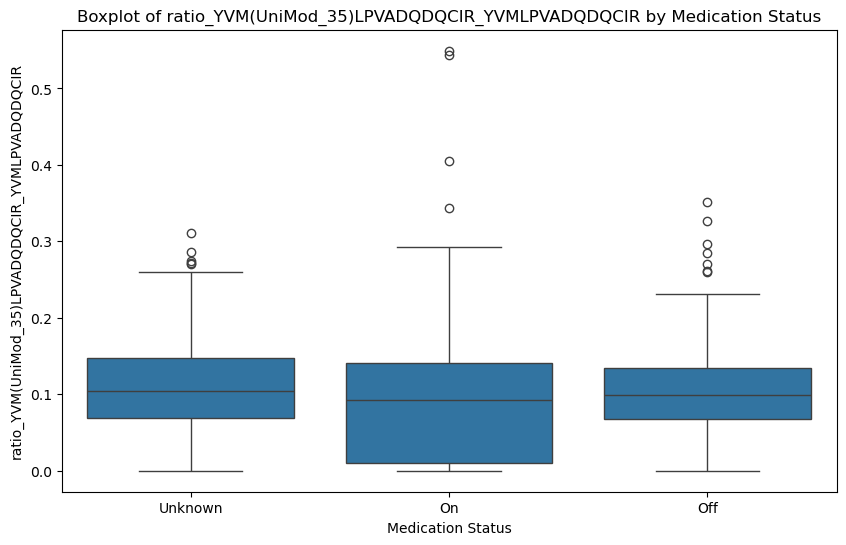

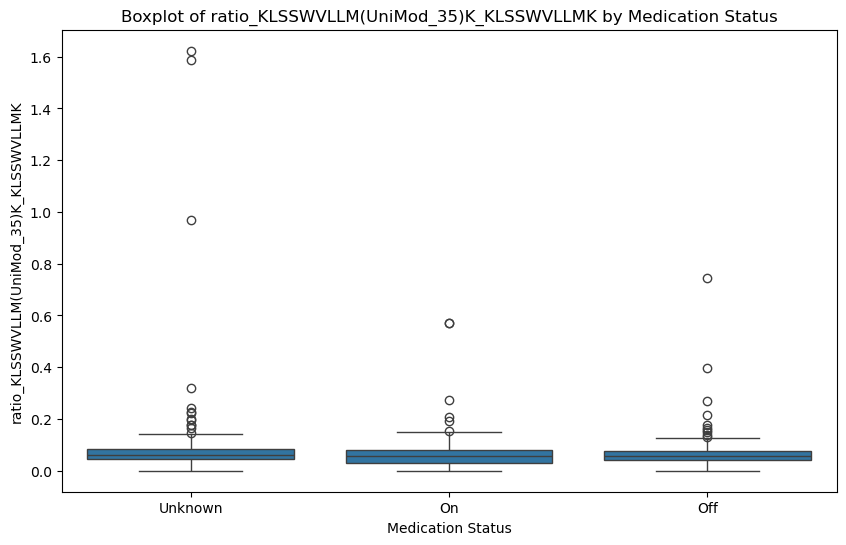

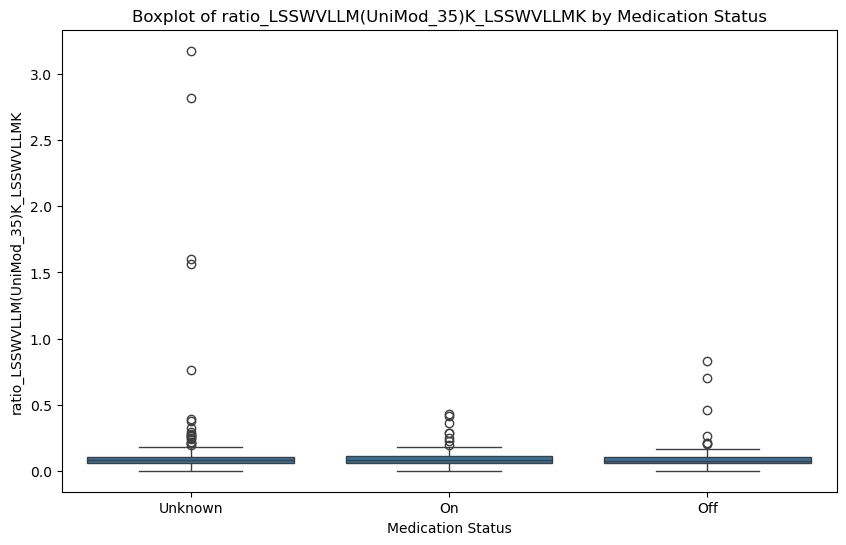

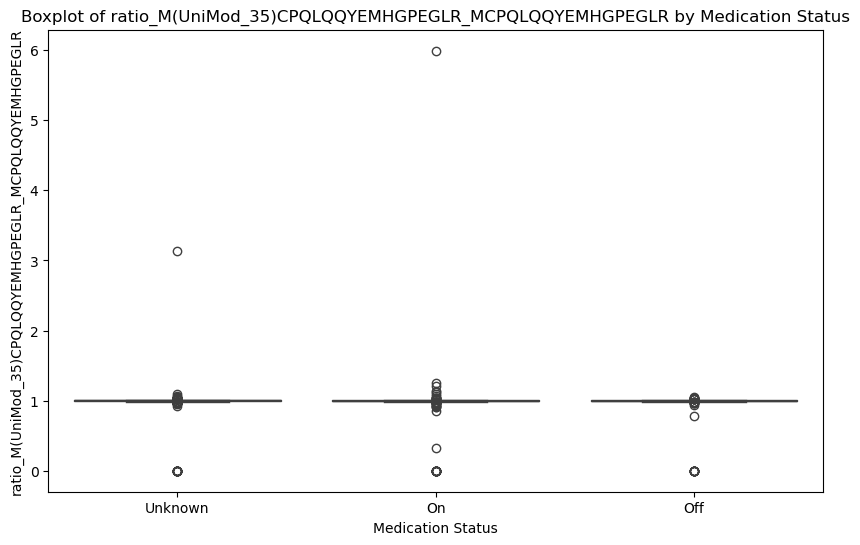

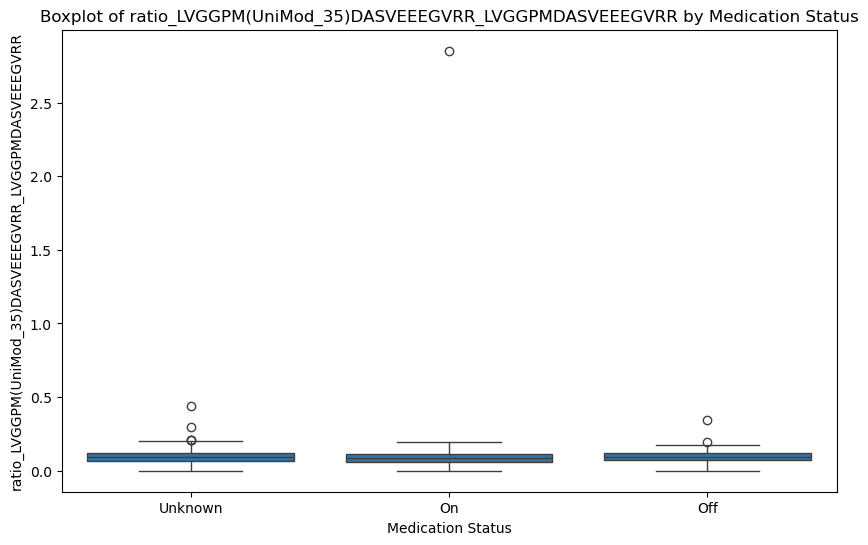

...

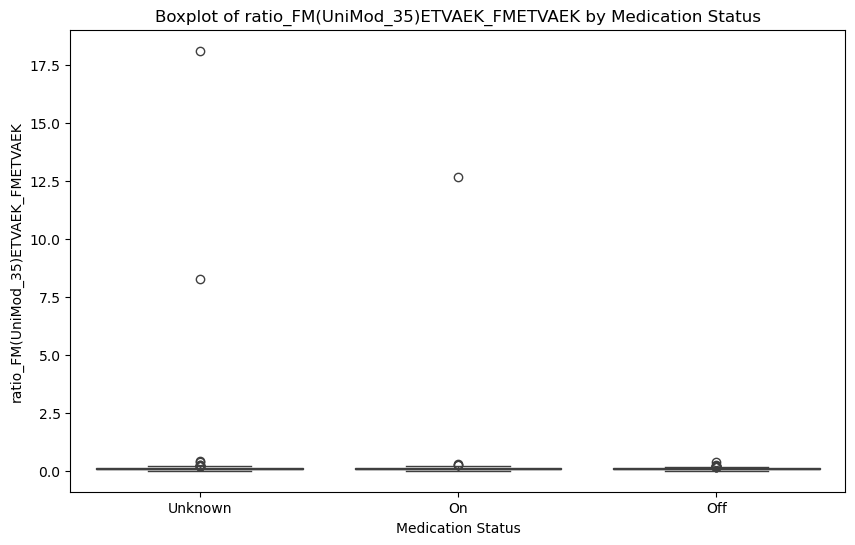

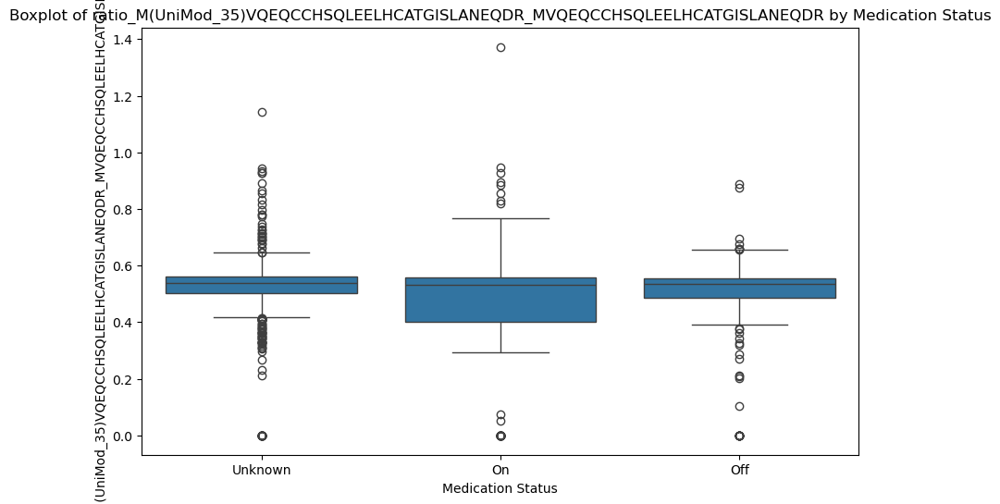

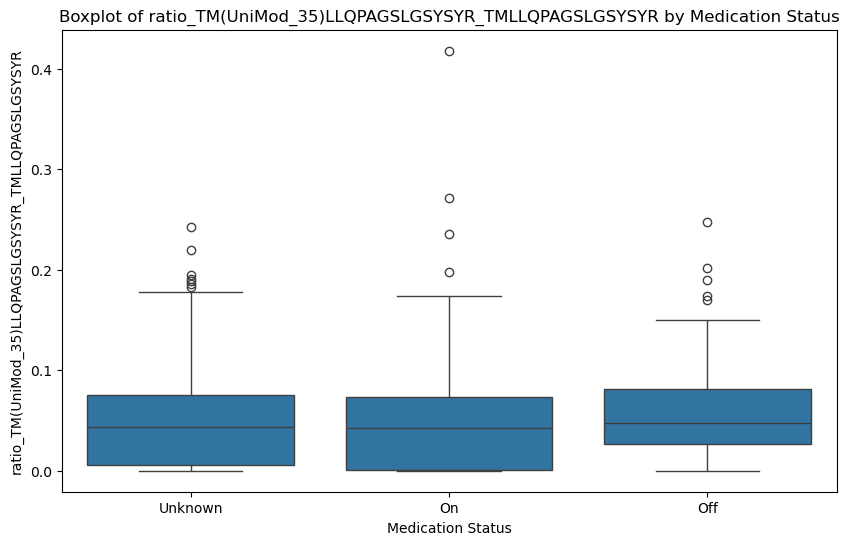

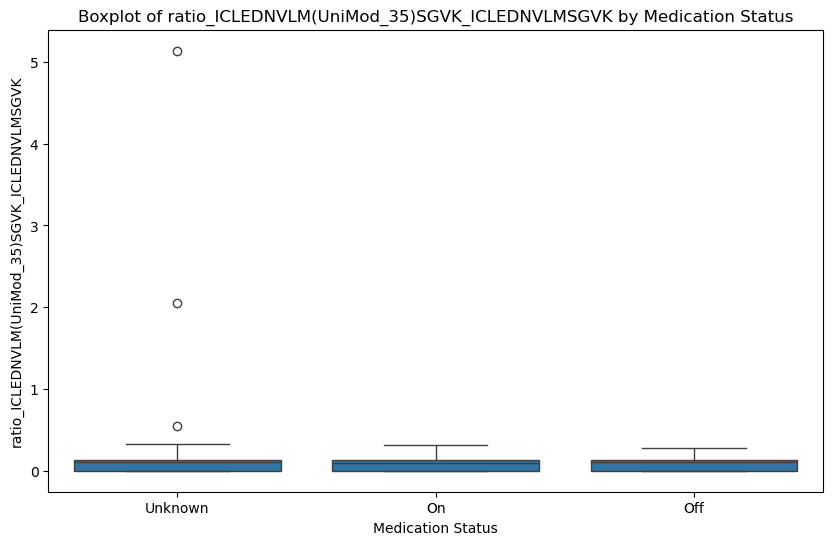

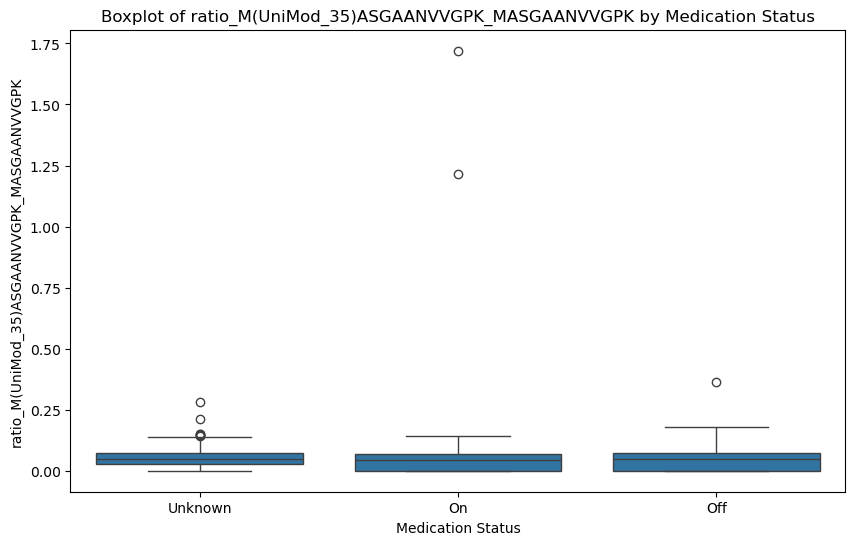

In [ ]:
# Get a list of ratio columns (all columns except 'visit_id' and 'upd23b_clinical_state_on_medication')
ratio_columns = [col for col in peptide_ratio_df.columns if col not in ['visit_id', 'upd23b_clinical_state_on_medication']]

# Loop through each ratio column and create a boxplot
for ratio in ratio_columns:
    plt.figure(figsize=(10, 6))  # Set the figure size

    # Create the boxplot using Seaborn
    sns.boxplot(x='upd23b_clinical_state_on_medication', y=ratio, data=peptide_ratio_df)

    # Add title and labels
    plt.title(f'Boxplot of {ratio} by Medication Status')
    plt.xlabel('Medication Status')
    plt.ylabel(ratio)

    # Show the plot
    plt.show()

In [ ]:
# Create an empty list to store the outliers
outliers_list = []

# Loop through each ratio column to identify outliers
for ratio in ratio_columns:
    for med_status in peptide_ratio_df['upd23b_clinical_state_on_medication'].unique():
        subset = peptide_ratio_df[peptide_ratio_df['upd23b_clinical_state_on_medication'] == med_status]

        Q1 = subset[ratio].quantile(0.25)
        Q3 = subset[ratio].quantile(0.75)
        IQR = Q3 - Q1

        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        # Identify outliers
        outliers = subset[(subset[ratio] < lower_bound) | (subset[ratio] > upper_bound)]

        # Add information to the outliers list
        for index, row in outliers.iterrows():
            outliers_list.append({
                'visit_id': row['visit_id'],
                'upd23b_clinical_state_on_medication': row['upd23b_clinical_state_on_medication'],
                'ratio': ratio,
                'value': row[ratio]
            })

# Convert the list to a DataFrame
outliers_df = pd.DataFrame(outliers_list)

# Display or save the outliers DataFrame
outliers_df



,visit_id,upd23b_clinical_state_on_medication,ratio,value
0,62329_0,Unknown,ratio_YVM(UniMod_35)LPVADQDQCIR_YVMLPVADQDQCIR,0.272185
1,16778_6,Unknown,ratio_YVM(UniMod_35)LPVADQDQCIR_YVMLPVADQDQCIR,0.285823
2,25739_24,Unknown,ratio_YVM(UniMod_35)LPVADQDQCIR_YVMLPVADQDQCIR,0.274038
3,4161_36,Unknown,ratio_YVM(UniMod_35)LPVADQDQCIR_YVMLPVADQDQCIR,0.310944
4,49683_48,Unknown,ratio_YVM(UniMod_35)LPVADQDQCIR_YVMLPVADQDQCIR,0.270779
...,...,...,...,...
1827,31121_24,Unknown,ratio_M(UniMod_35)ASGAANVVGPK_MASGAANVVGPK,0.144270
1828,61974_36,Unknown,ratio_M(UniMod_35)ASGAANVVGPK_MASGAANVVGPK,0.282335
1829,13804_12,On,ratio_M(UniMod_35)ASGAANVVGPK_MASGAANVVGPK,1.217133
1830,14811_36,On,ratio_M(UniMod_35)ASGAANVVGPK_MASGAANVVGPK,1.720205


In [ ]:
# Count the number of unique visit_ids
unique_visit_ids = outliers_df['visit_id'].nunique()
print(f"Number of unique visit_ids: {unique_visit_ids}")

# Count the frequency of each visit_id
visit_id_counts = outliers_df['visit_id'].value_counts()
print("Count per visit_id:")
visit_id_counts


Number of unique visit_ids: 821
Count per visit_id:


visit_id
19088_48    11
42003_36    10
11928_0      8
13804_12     8
11686_24     8
            ..
20404_12     1
39144_60     1
63875_48     1
57009_48     1
31121_24     1
Name: count, Length: 821, dtype: int64

In [ ]:
# Extract patient_id by splitting visit_id and taking the first part
outliers_df['patient_id'] = outliers_df['visit_id'].apply(lambda x: x.split('_')[0])

# Count the number of unique patient_ids
unique_patient_ids = outliers_df['patient_id'].nunique()
print(f"Number of unique patient_ids: {unique_patient_ids}")


Number of unique patient_ids: 237


In [ ]:
# Create a copy of outliers_df
outliers_df_copy = outliers_df.copy()

# Extract patient_id from visit_id
outliers_df_copy['patient_id'] = outliers_df_copy['visit_id'].apply(lambda x: x.split('_')[0])

# Filter out cases where a patient_id appears only once
filtered_outliers_df = outliers_df_copy.groupby('patient_id').filter(lambda x: len(x) > 1)


In [ ]:
filtered_outliers_df

,visit_id,upd23b_clinical_state_on_medication,ratio,value,patient_id
0,62329_0,Unknown,ratio_YVM(UniMod_35)LPVADQDQCIR_YVMLPVADQDQCIR,0.272185,62329
1,16778_6,Unknown,ratio_YVM(UniMod_35)LPVADQDQCIR_YVMLPVADQDQCIR,0.285823,16778
2,25739_24,Unknown,ratio_YVM(UniMod_35)LPVADQDQCIR_YVMLPVADQDQCIR,0.274038,25739
3,4161_36,Unknown,ratio_YVM(UniMod_35)LPVADQDQCIR_YVMLPVADQDQCIR,0.310944,4161
4,49683_48,Unknown,ratio_YVM(UniMod_35)LPVADQDQCIR_YVMLPVADQDQCIR,0.270779,49683
...,...,...,...,...,...
1827,31121_24,Unknown,ratio_M(UniMod_35)ASGAANVVGPK_MASGAANVVGPK,0.144270,31121
1828,61974_36,Unknown,ratio_M(UniMod_35)ASGAANVVGPK_MASGAANVVGPK,0.282335,61974
1829,13804_12,On,ratio_M(UniMod_35)ASGAANVVGPK_MASGAANVVGPK,1.217133,13804
1830,14811_36,On,ratio_M(UniMod_35)ASGAANVVGPK_MASGAANVVGPK,1.720205,14811


In [ ]:
proteins_clinical.visit_id.nunique()

1068

In [ ]:
filtered_outliers_df.groupby('ratio').count()['visit_id']

ratio
ratio_AQTTVTCM(UniMod_35)ENGWSPTPR_AQTTVTCMENGWSPTPR                          190
ratio_DQTVSDNELQEM(UniMod_35)SNQGSK_DQTVSDNELQEMSNQGSK                         25
ratio_DSGFQM(UniMod_35)NQLR_DSGFQMNQLR                                         22
ratio_EIVMTQSPATLSVSPGER_EIVLTQSPATLSLSPGER                                    56
ratio_FM(UniMod_35)ETVAEK_FMETVAEK                                             25
ratio_HTFM(UniMod_35)GVVSLGSPSGEVSHPR_HTFMGVVSLGSPSGEVSHPR                     11
ratio_ICLEDNVLM(UniMod_35)SGVK_ICLEDNVLMSGVK                                    3
ratio_IVSSAMEPDREYHFGQAVR_IVSSAM(UniMod_35)EPDREYHFGQAVR                      164
ratio_KDSGFQM(UniMod_35)NQLR_KDSGFQMNQLR                                        2
ratio_KLSSWVLLM(UniMod_35)K_KLSSWVLLMK                                         29
ratio_LGADM(UniMod_35)EDVCGR_LGADMEDVCGR                                       56
ratio_LSSWVLLM(UniMod_35)K_LSSWVLLMK                                           33
ratio_LVGG

In [ ]:
filtered_outliers_df.groupby('patient_id').count()['ratio']

patient_id
10053    14
10174    13
10715     6
10718     3
11459    13
         ..
7568     14
7832     14
7886     10
8344      4
942       3
Name: ratio, Length: 224, dtype: int64

In [ ]:
proteins_clinical.visit_id.nunique()

1068

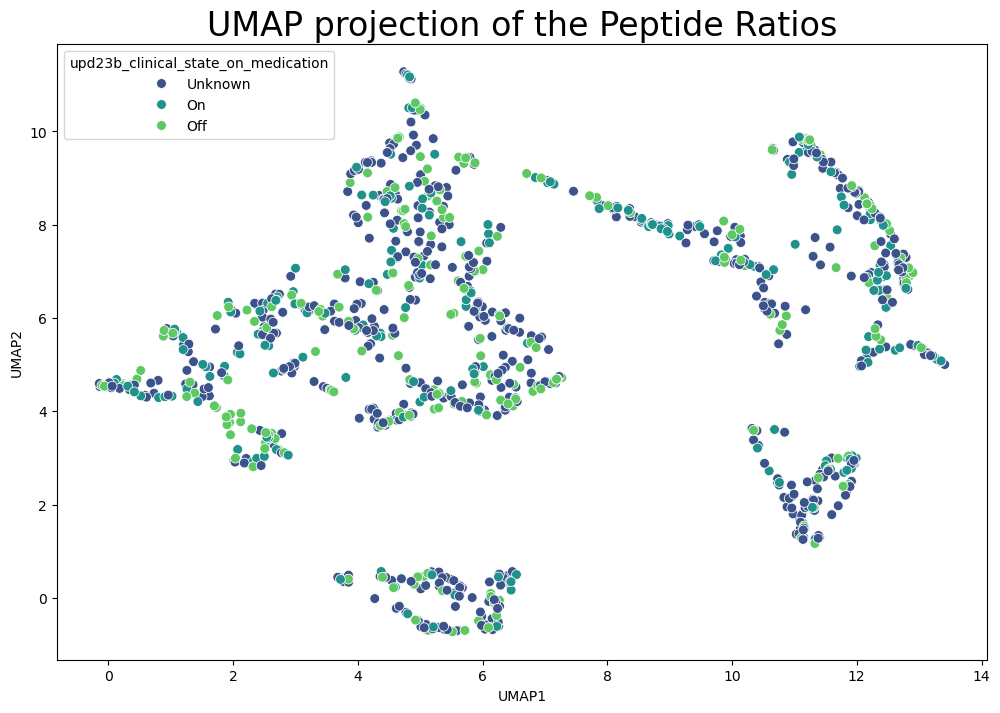

In [ ]:
ratio_columns = [col for col in peptide_ratio_df.columns if 'ratio' in col]
data = peptide_ratio_df[ratio_columns].fillna(0).values

umap_results = umap.UMAP(n_neighbors=15, min_dist=0.1, metric='euclidean').fit_transform(data)
umap_df = pd.DataFrame(data=umap_results, columns=['UMAP1', 'UMAP2'])

# Add 'visit_id' and 'upd23b_clinical_state_on_medication' for identification and coloring
umap_df['visit_id'] = peptide_ratio_df['visit_id'].values
umap_df['upd23b_clinical_state_on_medication'] = peptide_ratio_df['upd23b_clinical_state_on_medication'].values

plt.figure(figsize=(12, 8))
sns.scatterplot(x='UMAP1', y='UMAP2', hue='upd23b_clinical_state_on_medication', data=umap_df, palette='viridis', s=50)
plt.title('UMAP projection of the Peptide Ratios', fontsize=24)
plt.xlabel('UMAP1')
plt.ylabel('UMAP2')
plt.show()


In [ ]:
similar_peptides_mismatches

[('YVM(UniMod_35)LPVADQDQCIR', 'YVMLPVADQDQCIR'),
 ('KLSSWVLLM(UniMod_35)K', 'KLSSWVLLMK'),
 ('LSSWVLLM(UniMod_35)K', 'LSSWVLLMK'),
 ('M(UniMod_35)CPQLQQYEMHGPEGLR', 'MCPQLQQYEMHGPEGLR'),
 ('LVGGPM(UniMod_35)DASVEEEGVRR', 'LVGGPMDASVEEEGVRR'),
 ('TTPPVLDSDGSFFLYSK', 'TTPPVLDSDGSFFLYSR'),
 ('NFPPSQDASGDLYTTSSQLTLPATQCLAGK', 'NFPPSQDASGDLYTTSSQLTLPATQCPDGK'),
 ('LGADM(UniMod_35)EDVCGR', 'LGADMEDVCGR'),
 ('M(UniMod_35)ADEAGSEADHEGTHSTKR', 'MADEAGSEADHEGTHSTKR'),
 ('M(UniMod_35)ELERPGGNEITR', 'MELERPGGNEITR'),
 ('SDVVYTDWK', 'SDVMYTDWK'),
 ('SDVVYTDWKK', 'SDVMYTDWKK'),
 ('HTFM(UniMod_35)GVVSLGSPSGEVSHPR', 'HTFMGVVSLGSPSGEVSHPR'),
 ('DSGFQM(UniMod_35)NQLR', 'DSGFQMNQLR'),
 ('KDSGFQM(UniMod_35)NQLR', 'KDSGFQMNQLR'),
 ('M(UniMod_35)YLGYEYVTAIR', 'MYLGYEYVTAIR'),
 ('EIVMTQSPATLSVSPGER', 'EIVLTQSPATLSLSPGER'),
 ('M(UniMod_35)TVTDQVNCPK', 'MTVTDQVNCPK'),
 ('QHM(UniMod_35)DSDSSPSSSSTYCNQMMR', 'QHMDSDSSPSSSSTYCNQMMR'),
 ('SNSSM(UniMod_35)HITDCR', 'SNSSMHITDCR'),
 ('AQTTVTCM(UniMod_35)ENGWSPTPR', '

In [ ]:

peptide_to_protein_mapping = {}

# Loop through the list of similar peptides
for peptide1, peptide2 in similar_peptides_mismatches:
    peptide1_clean = peptide1.split("(UniMod_35)")[0]
    peptide2_clean = peptide2.split("(UniMod_35)")[0]
    proteins1 = peptides_clinical_copy.loc[peptides_clinical_copy['Peptide'] == peptide1_clean, 'UniProt'].unique().tolist()
    proteins2 = peptides_clinical_copy.loc[peptides_clinical_copy['Peptide'] == peptide2_clean, 'UniProt'].unique().tolist()

    peptide_to_protein_mapping[peptide1] = proteins1
    peptide_to_protein_mapping[peptide2] = proteins2

In [ ]:
peptide_to_protein_mapping

{'YVM(UniMod_35)LPVADQDQCIR': [],
 'YVMLPVADQDQCIR': ['P00738'],
 'KLSSWVLLM(UniMod_35)K': [],
 'KLSSWVLLMK': ['P01009'],
 'LSSWVLLM(UniMod_35)K': [],
 'LSSWVLLMK': ['P01009'],
 'M(UniMod_35)CPQLQQYEMHGPEGLR': [],
 'MCPQLQQYEMHGPEGLR': ['P01023'],
 'LVGGPM(UniMod_35)DASVEEEGVRR': [],
 'LVGGPMDASVEEEGVRR': ['P01034'],
 'TTPPVLDSDGSFFLYSK': ['P01857'],
 'TTPPVLDSDGSFFLYSR': ['P01861'],
 'NFPPSQDASGDLYTTSSQLTLPATQCLAGK': ['P01876'],
 'NFPPSQDASGDLYTTSSQLTLPATQCPDGK': ['P01877'],
 'LGADM(UniMod_35)EDVCGR': [],
 'LGADMEDVCGR': ['P02649'],
 'M(UniMod_35)ADEAGSEADHEGTHSTKR': [],
 'MADEAGSEADHEGTHSTKR': ['P02671'],
 'M(UniMod_35)ELERPGGNEITR': [],
 'MELERPGGNEITR': ['P02671'],
 'SDVVYTDWK': ['P02763'],
 'SDVMYTDWK': ['P19652'],
 'SDVVYTDWKK': ['P02763'],
 'SDVMYTDWKK': ['P19652'],
 'HTFM(UniMod_35)GVVSLGSPSGEVSHPR': [],
 'HTFMGVVSLGSPSGEVSHPR': ['P02765'],
 'DSGFQM(UniMod_35)NQLR': [],
 'DSGFQMNQLR': ['P02787'],
 'KDSGFQM(UniMod_35)NQLR': [],
 'KDSGFQMNQLR': ['P02787'],
 'M(UniMod_35)YLGYEYVTA

In [ ]:
peptides_clinical_copy[peptides_clinical_copy['Peptide'].str.contains('(UniMod_35)', regex=False)]


,visit_id,visit_month,patient_id,UniProt,Peptide,PeptideAbundance,updrs_1,updrs_2,updrs_3,updrs_4,upd23b_clinical_state_on_medication,NPX_log2
35,55_0,0,55,P00450,MYYSAVDPTKDIFTGLIGPM(UniMod_35)K,18890.3,10.0,6.0,15.0,NaN,Unknown,14.205358
59,55_0,0,55,P00738,YVM(UniMod_35)LPVADQDQCIR,106894.0,10.0,6.0,15.0,NaN,Unknown,16.705821
96,55_0,0,55,P01009,FNKPFVFLM(UniMod_35)IEQNTK,90349.0,10.0,6.0,15.0,NaN,Unknown,16.463221
98,55_0,0,55,P01009,KLSSWVLLM(UniMod_35)K,68210.7,10.0,6.0,15.0,NaN,Unknown,16.057710
103,55_0,0,55,P01009,LSSWVLLM(UniMod_35)K,80227.9,10.0,6.0,15.0,NaN,Unknown,16.291816
...,...,...,...,...,...,...,...,...,...,...,...,...
941568,58648_108,108,58648,P23142,M(UniMod_35)VQEQCCHSQLEELHCATGISLANEQDR,31092.3,6.0,0.0,0.0,NaN,Unknown,14.924270
941610,58648_108,108,58648,P41222,TM(UniMod_35)LLQPAGSLGSYSYR,1246010.0,6.0,0.0,0.0,NaN,Unknown,20.248884
941695,58648_108,108,58648,Q8IWV7,ILTCM(UniMod_35)QGMEEIR,78172.3,6.0,0.0,0.0,NaN,Unknown,16.254370
941701,58648_108,108,58648,Q92520,ICLEDNVLM(UniMod_35)SGVK,18531.0,6.0,0.0,0.0,NaN,Unknown,14.177653


In [ ]:
similar_peptides_mismatches

[('YVM(UniMod_35)LPVADQDQCIR', 'YVMLPVADQDQCIR'),
 ('KLSSWVLLM(UniMod_35)K', 'KLSSWVLLMK'),
 ('LSSWVLLM(UniMod_35)K', 'LSSWVLLMK'),
 ('M(UniMod_35)CPQLQQYEMHGPEGLR', 'MCPQLQQYEMHGPEGLR'),
 ('LVGGPM(UniMod_35)DASVEEEGVRR', 'LVGGPMDASVEEEGVRR'),
 ('TTPPVLDSDGSFFLYSK', 'TTPPVLDSDGSFFLYSR'),
 ('NFPPSQDASGDLYTTSSQLTLPATQCLAGK', 'NFPPSQDASGDLYTTSSQLTLPATQCPDGK'),
 ('LGADM(UniMod_35)EDVCGR', 'LGADMEDVCGR'),
 ('M(UniMod_35)ADEAGSEADHEGTHSTKR', 'MADEAGSEADHEGTHSTKR'),
 ('M(UniMod_35)ELERPGGNEITR', 'MELERPGGNEITR'),
 ('SDVVYTDWK', 'SDVMYTDWK'),
 ('SDVVYTDWKK', 'SDVMYTDWKK'),
 ('HTFM(UniMod_35)GVVSLGSPSGEVSHPR', 'HTFMGVVSLGSPSGEVSHPR'),
 ('DSGFQM(UniMod_35)NQLR', 'DSGFQMNQLR'),
 ('KDSGFQM(UniMod_35)NQLR', 'KDSGFQMNQLR'),
 ('M(UniMod_35)YLGYEYVTAIR', 'MYLGYEYVTAIR'),
 ('EIVMTQSPATLSVSPGER', 'EIVLTQSPATLSLSPGER'),
 ('M(UniMod_35)TVTDQVNCPK', 'MTVTDQVNCPK'),
 ('QHM(UniMod_35)DSDSSPSSSSTYCNQMMR', 'QHMDSDSSPSSSSTYCNQMMR'),
 ('SNSSM(UniMod_35)HITDCR', 'SNSSMHITDCR'),
 ('AQTTVTCM(UniMod_35)ENGWSPTPR', '

In [ ]:
for peptide1, peptide2 in similar_peptides_mismatches:
    # Query peptides_clinical_copy to find the proteins containing these peptides
    proteins1 = peptides_clinical_copy.loc[peptides_clinical_copy['Peptide'] == peptide1, 'UniProt'].unique().tolist()
    proteins2 = peptides_clinical_copy.loc[peptides_clinical_copy['Peptide'] == peptide2, 'UniProt'].unique().tolist()

    peptide_to_protein_mapping[peptide1] = proteins1
    peptide_to_protein_mapping[peptide2] = proteins2

for peptide, proteins in peptide_to_protein_mapping.items():
    print(f"The peptide {peptide} is associated with the following proteins: {proteins}")

The peptide YVM(UniMod_35)LPVADQDQCIR is associated with the following proteins: ['P00738']
The peptide YVMLPVADQDQCIR is associated with the following proteins: ['P00738']
The peptide KLSSWVLLM(UniMod_35)K is associated with the following proteins: ['P01009']
The peptide KLSSWVLLMK is associated with the following proteins: ['P01009']
The peptide LSSWVLLM(UniMod_35)K is associated with the following proteins: ['P01009']
The peptide LSSWVLLMK is associated with the following proteins: ['P01009']
The peptide M(UniMod_35)CPQLQQYEMHGPEGLR is associated with the following proteins: ['P01023']
The peptide MCPQLQQYEMHGPEGLR is associated with the following proteins: ['P01023']
The peptide LVGGPM(UniMod_35)DASVEEEGVRR is associated with the following proteins: ['P01034']
The peptide LVGGPMDASVEEEGVRR is associated with the following proteins: ['P01034']
The peptide TTPPVLDSDGSFFLYSK is associated with the following proteins: ['P01857']
The peptide TTPPVLDSDGSFFLYSR is associated with the foll

# Clustering

## Testing different types of scaling

In [ ]:
protein_data = final_pivot_log2.copy()

data_for_normalization = protein_data.iloc[:, :-2]

# StandardScaler
scaler_z = StandardScaler()
normalized_z = pd.DataFrame(scaler_z.fit_transform(data_for_normalization), columns=data_for_normalization.columns, index=protein_data.index)
normalized_z = normalized_z.loc[:, (normalized_z != 0).any(axis=0)]

# MinMaxScaler
scaler_minmax = MinMaxScaler()
normalized_minmax = pd.DataFrame(scaler_minmax.fit_transform(data_for_normalization), columns=data_for_normalization.columns, index=protein_data.index)
normalized_minmax = normalized_minmax.loc[:, (normalized_minmax != 0).any(axis=0)]

# RobustScaler
scaler_robust = RobustScaler()
normalized_robust = pd.DataFrame(scaler_robust.fit_transform(data_for_normalization), columns=data_for_normalization.columns, index=protein_data.index)
normalized_robust = normalized_robust.loc[:, (normalized_robust != 0).any(axis=0)]

# PowerTransformer
scaler_power = PowerTransformer(method='yeo-johnson')
normalized_power = pd.DataFrame(scaler_power.fit_transform(data_for_normalization), columns=data_for_normalization.columns, index=protein_data.index)
normalized_power = normalized_power.loc[:, (normalized_power != 0).any(axis=0)]


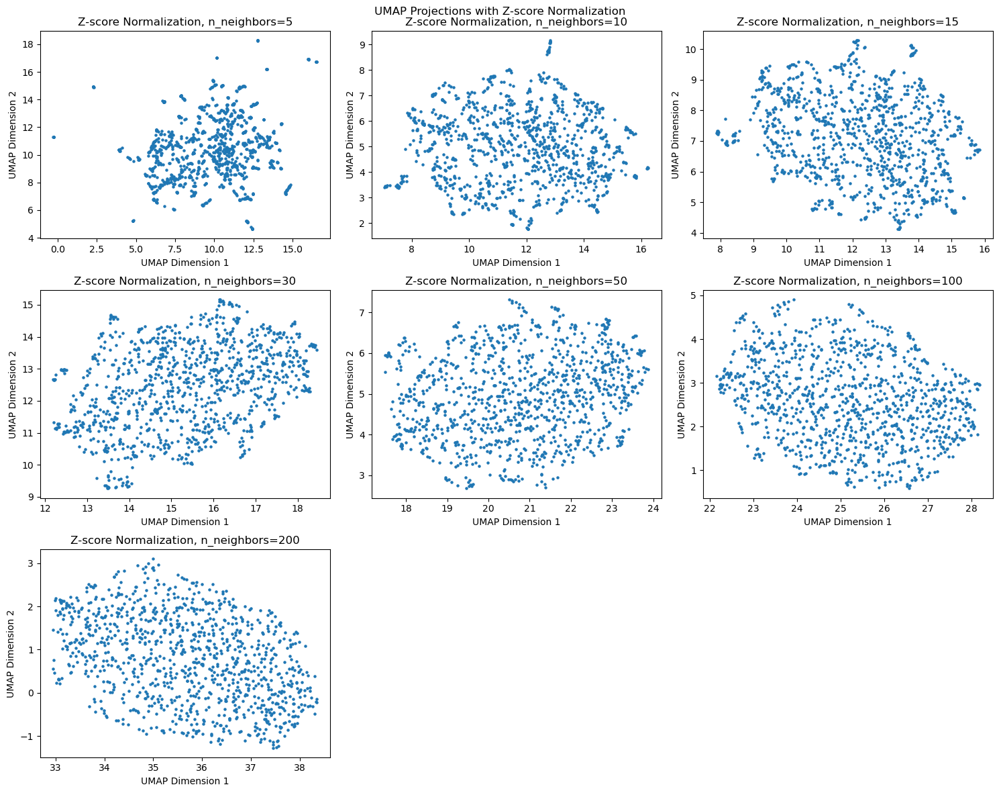

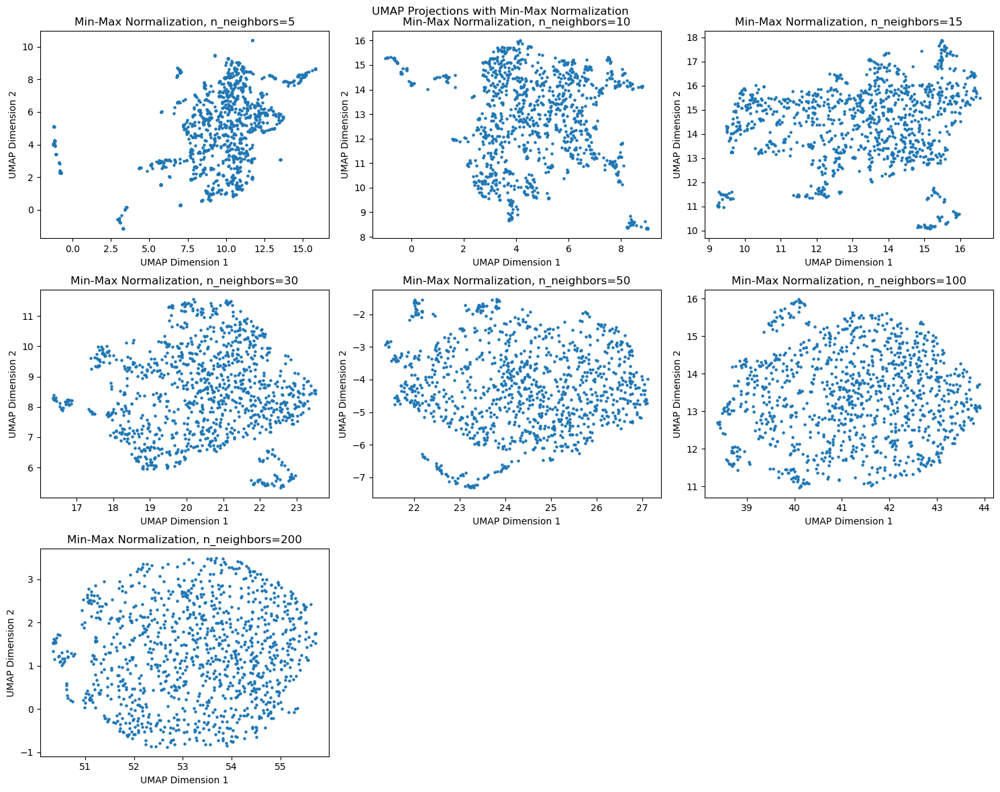

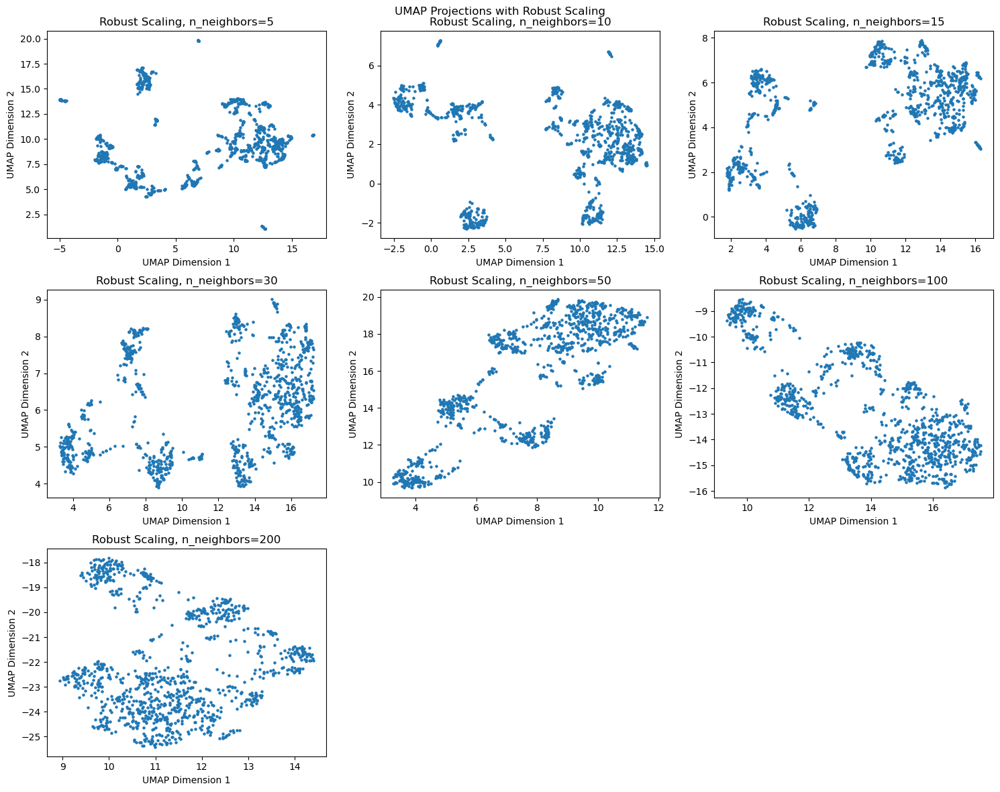

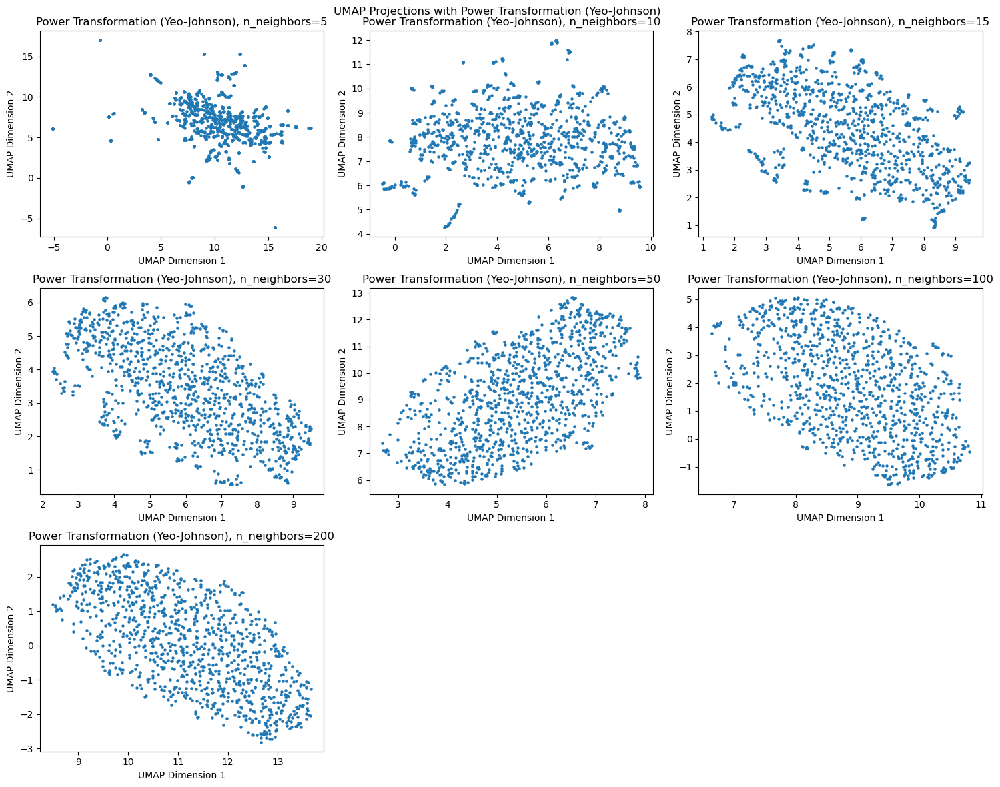

In [ ]:
neighbors_settings = [5, 10, 15, 30, 50, 100, 200]

def plot_umap(normalized_data, title):
    plt.figure(figsize=(15, 12))
    for i, n_neighbors in enumerate(neighbors_settings):
        umap_reducer = umap.UMAP(n_components=2, n_neighbors=n_neighbors, min_dist=0.1, random_state=42)
        umap_embedding = umap_reducer.fit_transform(normalized_data)
        plt.subplot(3, 3, i+1)
        plt.scatter(umap_embedding[:, 0], umap_embedding[:, 1], s=5)
        plt.title(f'{title}, n_neighbors={n_neighbors}')
        plt.xlabel('UMAP Dimension 1')
        plt.ylabel('UMAP Dimension 2')
    plt.tight_layout()
    plt.suptitle(f'UMAP Projections with {title}')
    plt.subplots_adjust(top=0.95)
    plt.show()

# Plotting UMAP for each normalization method
plot_umap(normalized_z, 'Z-score Normalization')
plot_umap(normalized_minmax, 'Min-Max Normalization')
plot_umap(normalized_robust, 'Robust Scaling')
plot_umap(normalized_power, 'Power Transformation (Yeo-Johnson)')


## UMAP only

In [ ]:
# I'll test with Robust Scaling

In [ ]:
data_for_normalization

,O00391_none,O00533_none,O00584_none,O14498_none,O14773_none,O14791_none,O15240_none,O15394_none,O43505_none,O60888_none,...,Q9HDC9_35,Q9NQ79_35,Q9NYU2_35,Q9UBR2_35,Q9UBX5_35,Q9UHG2_35,Q9UKV8_35,Q9UNU6_35,Q9Y646_35,Q9Y6R7_35
visit_id,,,,,,,,,,,,,,,,,,,,,
10053_0,13.152328,18.617989,0.000000,0.000000,12.803843,11.286465,16.340874,13.883560,17.352311,16.977548,...,0,0,0,0,0,0,0,13.908955,0,0
10053_12,13.353174,18.732597,0.000000,0.000000,0.000000,0.000000,17.588690,13.882175,17.325692,16.722194,...,0,0,0,0,0,0,0,0.000000,0,0
10053_18,13.692147,18.952724,12.799071,14.582007,0.000000,11.212320,16.948842,13.991664,17.359020,17.321364,...,0,0,0,0,0,0,0,13.400519,0,0
10138_12,13.621159,18.915846,13.161929,14.730974,14.458028,12.554565,17.254083,15.735196,17.638302,15.791697,...,0,0,0,0,0,0,0,14.670529,0,0
10138_24,13.551131,18.994070,12.135232,14.069265,14.829346,11.380001,17.205808,15.675574,17.878027,16.388137,...,0,0,0,0,0,0,0,13.625618,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8699_24,13.285258,18.610685,14.565109,0.000000,14.048439,12.621862,16.241790,15.502934,17.955871,17.083791,...,0,0,0,0,0,0,0,13.815173,0,0
942_12,12.722235,18.461074,14.164872,13.849474,14.183280,10.750514,16.406194,15.203856,17.694603,16.617109,...,0,0,0,0,0,0,0,14.227593,0,0
942_24,0.000000,18.428175,14.478955,14.513795,14.027000,10.539072,16.808413,15.139539,17.503670,16.597813,...,0,0,0,0,0,0,0,14.226427,0,0


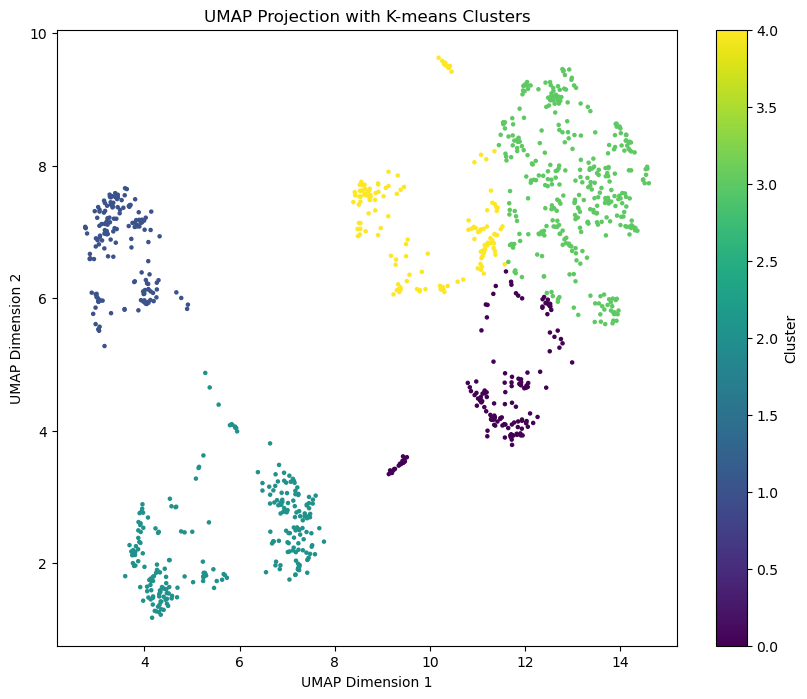

In [ ]:
scaler_robust = RobustScaler()
protein_data_robust = scaler_robust.fit_transform(data_for_normalization)

# Apply UMAP with n_neighbors=15
umap_reducer = umap.UMAP(n_neighbors=20, random_state=42)
umap_embedding = umap_reducer.fit_transform(protein_data_robust)

k = 5
kmeans = KMeans(n_clusters=k, random_state=42)
clusters = kmeans.fit_predict(umap_embedding)

plt.figure(figsize=(10, 8))
plt.scatter(umap_embedding[:, 0], umap_embedding[:, 1], c=clusters, cmap='viridis', s=5)
plt.title('UMAP Projection with K-means Clusters')
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.colorbar(label='Cluster')
plt.show()


In [ ]:
# Converting the scaled data back to a DataFrame
protein_data_robust_df = pd.DataFrame(protein_data_robust, columns=data_for_normalization.columns, index=data_for_normalization.index)
protein_data_robust_df


,O00391_none,O00533_none,O00584_none,O14498_none,O14773_none,O14791_none,O15240_none,O15394_none,O43505_none,O60888_none,...,Q9HDC9_35,Q9NQ79_35,Q9NYU2_35,Q9UBR2_35,Q9UBX5_35,Q9UHG2_35,Q9UKV8_35,Q9UNU6_35,Q9Y646_35,Q9Y6R7_35
visit_id,,,,,,,,,,,,,,,,,,,,,
10053_0,-0.009137,-0.287218,-19.350490,-20.652736,-1.456830,-0.064765,-0.391369,-1.903170,-0.200629,-0.061439,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.000164,0.0,0.0
10053_12,0.005629,-0.160216,-19.350490,-20.652736,-16.534778,-11.767363,0.621343,-1.904734,-0.235693,-0.380407,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.967904,0.0,0.0
10053_18,0.030549,0.083714,-2.488820,-0.088411,-16.534778,-0.141644,0.102050,-1.781109,-0.191790,0.368029,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.035539,0.0,0.0
10138_12,0.025330,0.042849,-2.010787,0.121671,0.491157,1.250089,0.349780,0.187527,0.176099,-1.542709,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.052824,0.0,0.0
10138_24,0.020182,0.129531,-3.363372,-0.811506,0.928425,0.032219,0.310601,0.120207,0.491882,-0.797684,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.019877,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8699_24,0.000636,-0.295311,-0.162219,-20.652736,0.008821,1.319868,-0.471784,-0.074722,0.594424,0.071271,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.006689,0.0,0.0
942_12,-0.040756,-0.461101,-0.689496,-1.121468,0.167611,-0.620476,-0.338355,-0.412413,0.250263,-0.511671,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.022006,0.0,0.0
942_24,-0.976064,-0.497557,-0.275719,-0.184606,-0.016427,-0.839715,-0.011920,-0.485034,-0.001247,-0.535774,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.021925,0.0,0.0


In [ ]:
zero_columns = [col for col in protein_data_robust_df.columns if (protein_data_robust_df[col] == 0).all()]

protein_data_robust_df.drop(columns=zero_columns, inplace=True)

In [ ]:
protein_data_robust_df

,O00391_none,O00533_none,O00584_none,O14498_none,O14773_none,O14791_none,O15240_none,O15394_none,O43505_none,O60888_none,...,P05090_35,P07998_35,P08603_35,P09871_35,P10909_35,P23142_35,P41222_35,Q8IWV7_35,Q92520_35,Q9UNU6_35
visit_id,,,,,,,,,,,,,,,,,,,,,
10053_0,-0.009137,-0.287218,-19.350490,-20.652736,-1.456830,-0.064765,-0.391369,-1.903170,-0.200629,-0.061439,...,-2.628122,-8.922436,-0.030229,-19.273622,-1.498528,-0.075597,-0.275197,0.436601,-0.110442,-0.000164
10053_12,0.005629,-0.160216,-19.350490,-20.652736,-16.534778,-11.767363,0.621343,-1.904734,-0.235693,-0.380407,...,-4.758037,-8.922436,0.142276,-19.273622,-3.452453,-20.403268,-2.120874,-0.154894,-0.151738,-0.967904
10053_18,0.030549,0.083714,-2.488820,-0.088411,-16.534778,-0.141644,0.102050,-1.781109,-0.191790,0.368029,...,-2.029822,0.704360,0.137383,-0.012415,-1.751193,0.107505,-1.701813,0.256228,0.282288,-0.035539
10138_12,0.025330,0.042849,-2.010787,0.121671,0.491157,1.250089,0.349780,0.187527,0.176099,-1.542709,...,0.272737,0.553082,0.680135,0.389249,0.258783,0.056189,0.003093,0.675028,0.026249,0.052824
10138_24,0.020182,0.129531,-3.363372,-0.811506,0.928425,0.032219,0.310601,0.120207,0.491882,-0.797684,...,-0.704011,0.282118,0.861828,0.092953,-0.156029,0.428154,0.455290,0.667453,0.108527,-0.019877
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8699_24,0.000636,-0.295311,-0.162219,-20.652736,0.008821,1.319868,-0.471784,-0.074722,0.594424,0.071271,...,-3.965430,-0.470063,0.823213,-0.485327,-1.512779,0.782408,-1.922770,-0.379162,-2.203889,-0.006689
942_12,-0.040756,-0.461101,-0.689496,-1.121468,0.167611,-0.620476,-0.338355,-0.412413,0.250263,-0.511671,...,0.516292,0.371730,-0.572037,-0.866981,0.607567,-0.016720,-8.834694,-0.963375,0.203244,0.022006
942_24,-0.976064,-0.497557,-0.275719,-0.184606,-0.016427,-0.839715,-0.011920,-0.485034,-0.001247,-0.535774,...,0.586253,0.352042,-4.467324,-0.804391,0.366276,0.083550,-8.834694,0.462808,-0.044705,0.021925


## Hierarchical Clustering

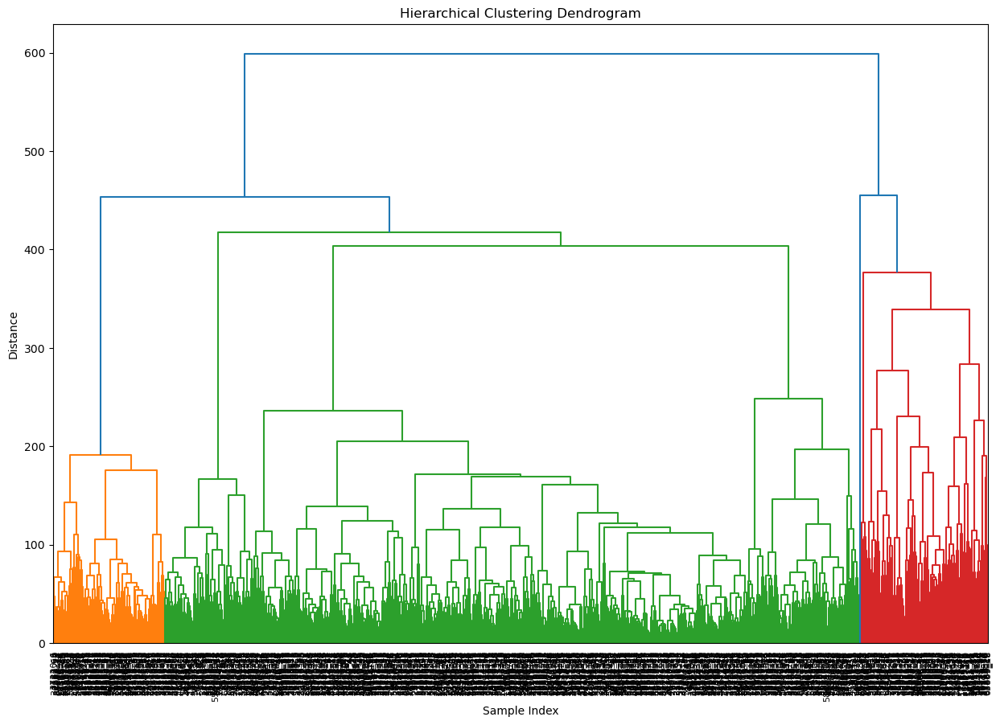

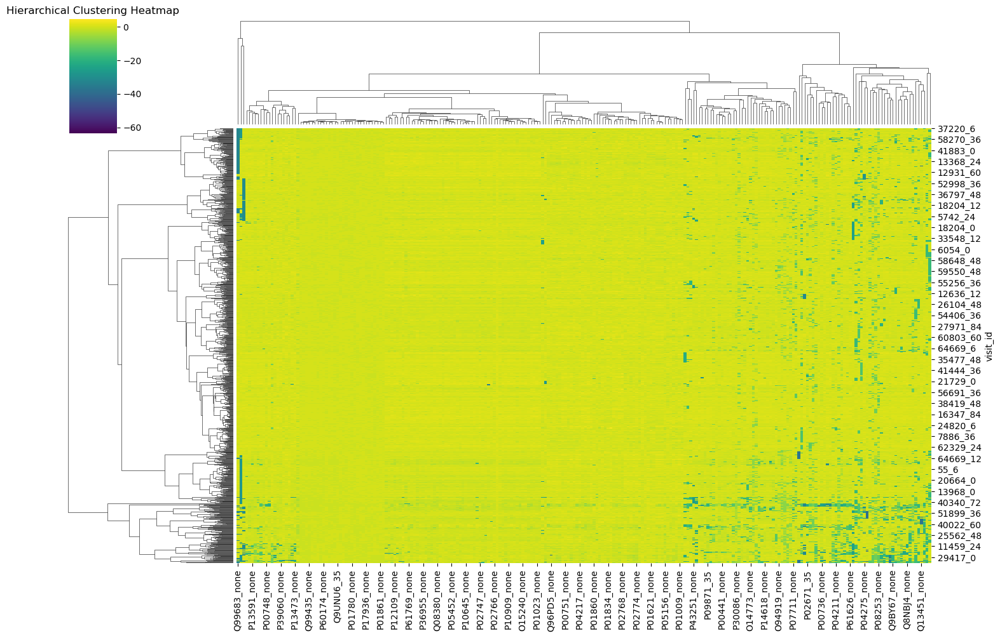

In [ ]:
# Perform Hierarchical Clustering
linked = linkage(protein_data_robust_df, method='ward')

# Plot the Dendrogram
plt.figure(figsize=(15, 10))
dendrogram(linked, labels=normalized_robust.index.tolist(), orientation='top', leaf_rotation=90, leaf_font_size=8)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel('Distance')
plt.show()

# Heatmap with Clustermap
sns.clustermap(normalized_robust, method='ward', cmap='viridis', figsize=(15, 10))
plt.title('Hierarchical Clustering Heatmap')
plt.show()


## PCA + UMAP

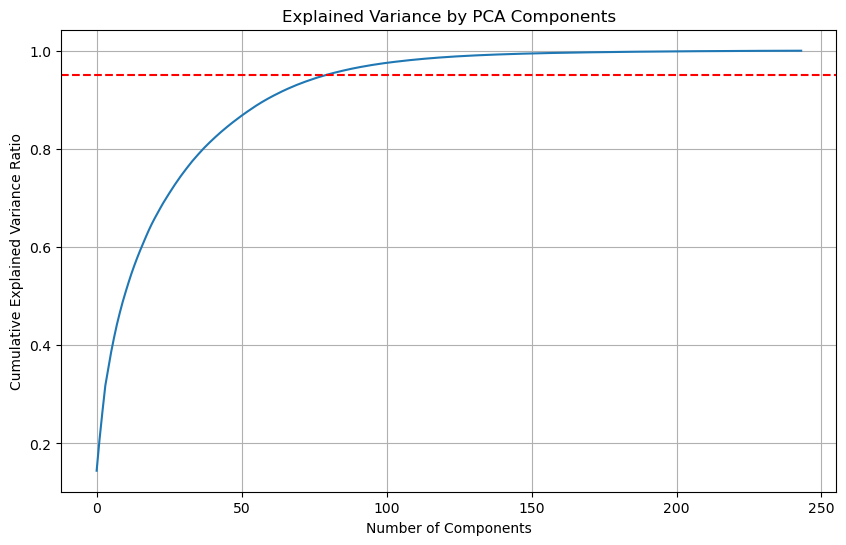

In [ ]:
pca_full = PCA()
pca_full.fit(protein_data_robust_df)
cumulative_variance_ratio = pca_full.explained_variance_ratio_.cumsum()

plt.figure(figsize=(10, 6))
plt.plot(cumulative_variance_ratio)
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Explained Variance by PCA Components')
plt.grid(True)
plt.axhline(y=0.95, color='r', linestyle='--')
plt.show()


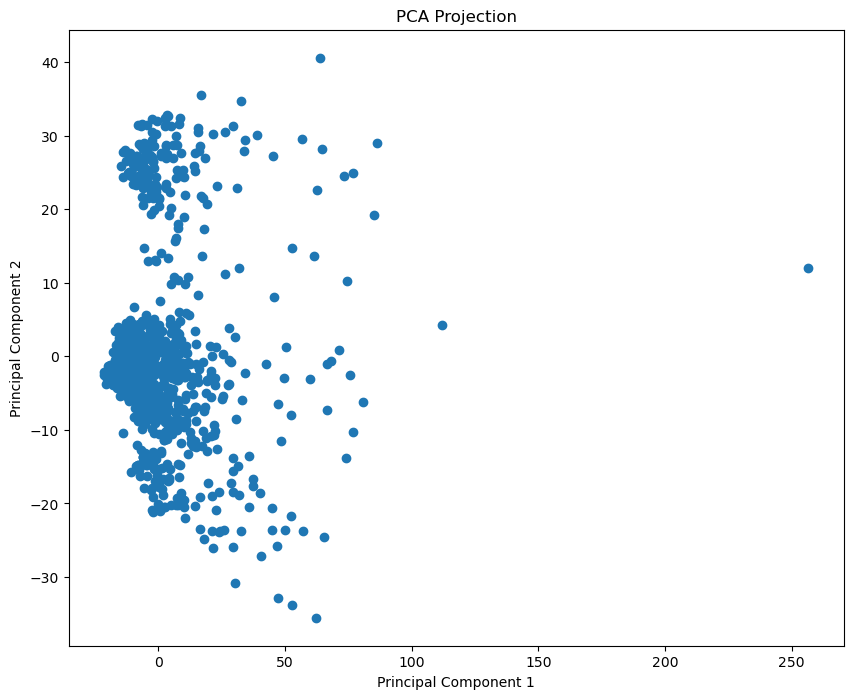

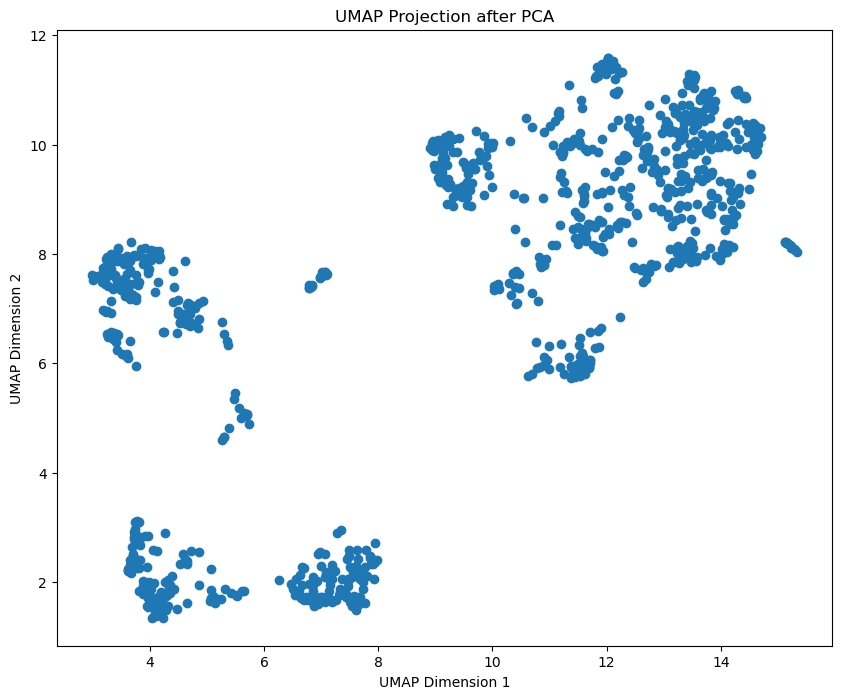

In [ ]:
# Applying PCA
pca = PCA(n_components=2)
pca_result = pca.fit_transform(protein_data_robust_df)

plt.figure(figsize=(10, 8))
plt.scatter(pca_result[:, 0], pca_result[:, 1])
plt.title('PCA Projection')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.show()

# PCA before UMAP
pca_100 = PCA(n_components=80)
pca_result_100 = pca_100.fit_transform(protein_data_robust_df)

# UMAP on PCA
umap_reducer_after_pca = umap.UMAP(n_neighbors=20, random_state=42)
umap_embedding_after_pca = umap_reducer_after_pca.fit_transform(pca_result_100)

plt.figure(figsize=(10, 8))
plt.scatter(umap_embedding_after_pca[:, 0], umap_embedding_after_pca[:, 1])
plt.title('UMAP Projection after PCA')
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.show()


## PCA + Hierarchical

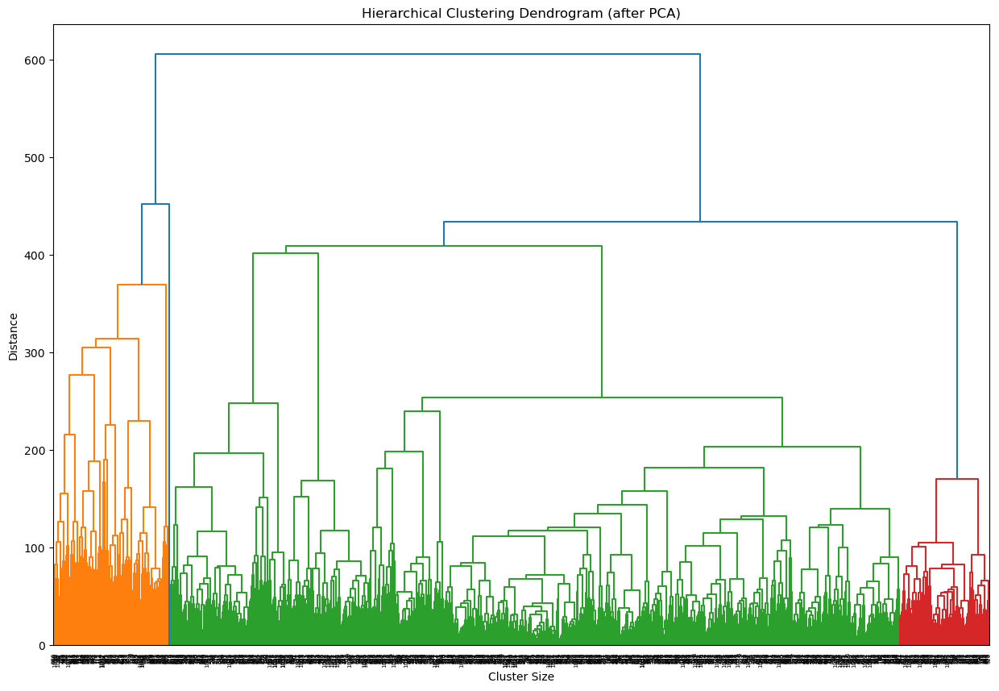

In [ ]:
pca = PCA(n_components=100)
pca_result = pca.fit_transform(protein_data_robust_df)

linked = linkage(pca_result, method='ward')

plt.figure(figsize=(15, 10))
dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=True)
plt.title('Hierarchical Clustering Dendrogram (after PCA)')
plt.xlabel('Cluster Size')
plt.ylabel('Distance')
plt.show()


In [ ]:
normalized_robust

,O00391_none,O00533_none,O00584_none,O14498_none,O14773_none,O14791_none,O15240_none,O15394_none,O43505_none,O60888_none,...,P05090_35,P07998_35,P08603_35,P09871_35,P10909_35,P23142_35,P41222_35,Q8IWV7_35,Q92520_35,Q9UNU6_35
visit_id,,,,,,,,,,,,,,,,,,,,,
10053_0,-0.009137,-0.287218,-19.350490,-20.652736,-1.456830,-0.064765,-0.391369,-1.903170,-0.200629,-0.061439,...,-2.628122,-8.922436,-0.030229,-19.273622,-1.498528,-0.075597,-0.275197,0.436601,-0.110442,-0.000164
10053_12,0.005629,-0.160216,-19.350490,-20.652736,-16.534778,-11.767363,0.621343,-1.904734,-0.235693,-0.380407,...,-4.758037,-8.922436,0.142276,-19.273622,-3.452453,-20.403268,-2.120874,-0.154894,-0.151738,-0.967904
10053_18,0.030549,0.083714,-2.488820,-0.088411,-16.534778,-0.141644,0.102050,-1.781109,-0.191790,0.368029,...,-2.029822,0.704360,0.137383,-0.012415,-1.751193,0.107505,-1.701813,0.256228,0.282288,-0.035539
10138_12,0.025330,0.042849,-2.010787,0.121671,0.491157,1.250089,0.349780,0.187527,0.176099,-1.542709,...,0.272737,0.553082,0.680135,0.389249,0.258783,0.056189,0.003093,0.675028,0.026249,0.052824
10138_24,0.020182,0.129531,-3.363372,-0.811506,0.928425,0.032219,0.310601,0.120207,0.491882,-0.797684,...,-0.704011,0.282118,0.861828,0.092953,-0.156029,0.428154,0.455290,0.667453,0.108527,-0.019877
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8699_24,0.000636,-0.295311,-0.162219,-20.652736,0.008821,1.319868,-0.471784,-0.074722,0.594424,0.071271,...,-3.965430,-0.470063,0.823213,-0.485327,-1.512779,0.782408,-1.922770,-0.379162,-2.203889,-0.006689
942_12,-0.040756,-0.461101,-0.689496,-1.121468,0.167611,-0.620476,-0.338355,-0.412413,0.250263,-0.511671,...,0.516292,0.371730,-0.572037,-0.866981,0.607567,-0.016720,-8.834694,-0.963375,0.203244,0.022006
942_24,-0.976064,-0.497557,-0.275719,-0.184606,-0.016427,-0.839715,-0.011920,-0.485034,-0.001247,-0.535774,...,0.586253,0.352042,-4.467324,-0.804391,0.366276,0.083550,-8.834694,0.462808,-0.044705,0.021925


### Exploring clusters after PCA + Hierarchical clustering

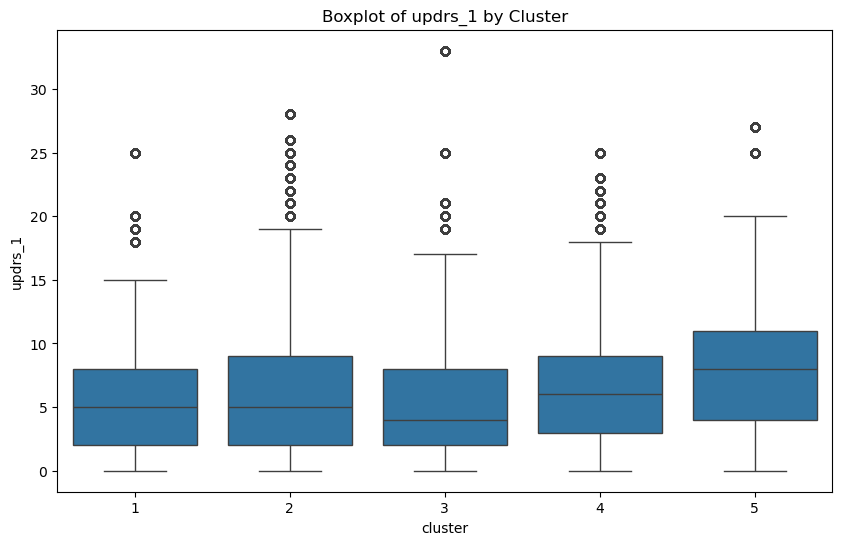

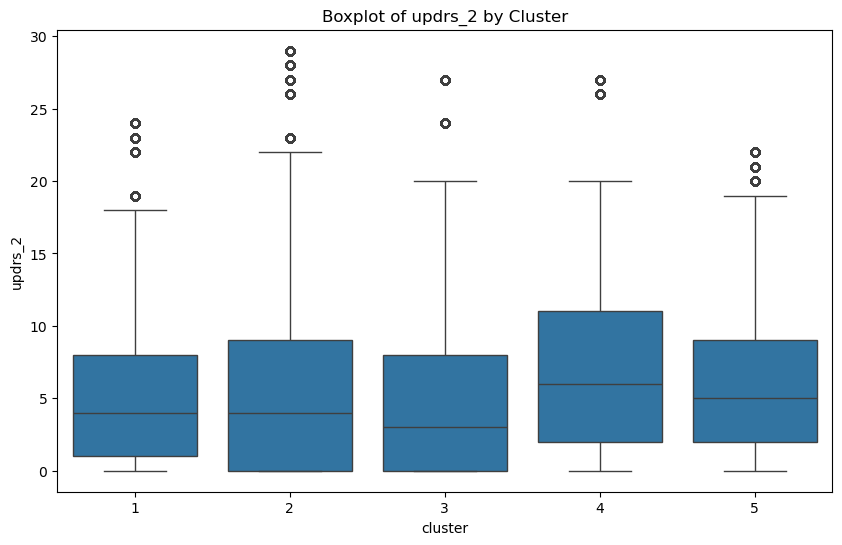

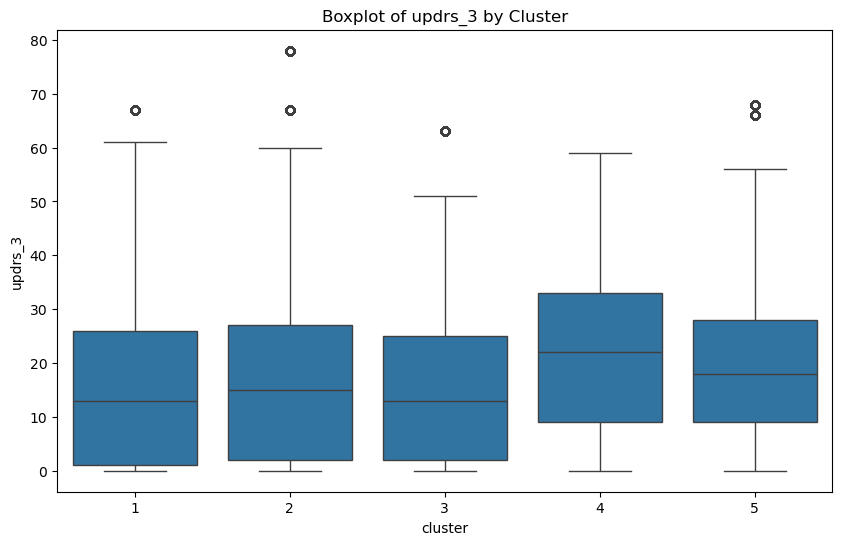

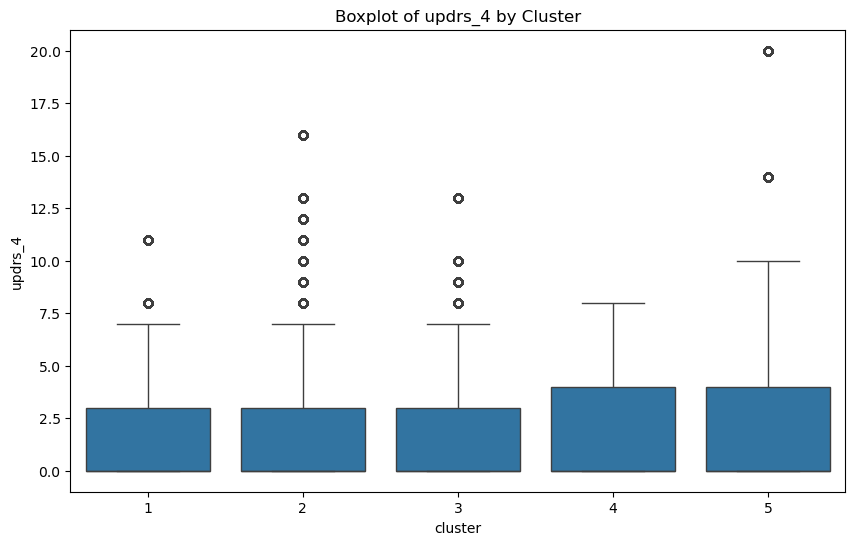

In [ ]:
# Cutting dendrogram at height 430 to get cluster labels -  5 clusters
cluster_labels = fcluster(linked, t=390, criterion='distance')

# Assign cluster labels to visit_ids
clusters_df = pd.DataFrame({'visit_id': protein_data_robust_df.index, 'cluster': cluster_labels})

# Filter out the cluster with only one data point
cluster_counts = clusters_df['cluster'].value_counts()
clusters_df = clusters_df[clusters_df['cluster'].isin(cluster_counts[cluster_counts > 1].index)]

# Merge with proteins_clinical to get UPDRS scores
merged_data = clusters_df.merge(proteins_clinical, on='visit_id')

# Creating boxplots for UPDRS scores for each cluster
for updrs_score in ['updrs_1', 'updrs_2', 'updrs_3', 'updrs_4']:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='cluster', y=updrs_score, data=merged_data)
    plt.title(f'Boxplot of {updrs_score} by Cluster')
    plt.show()


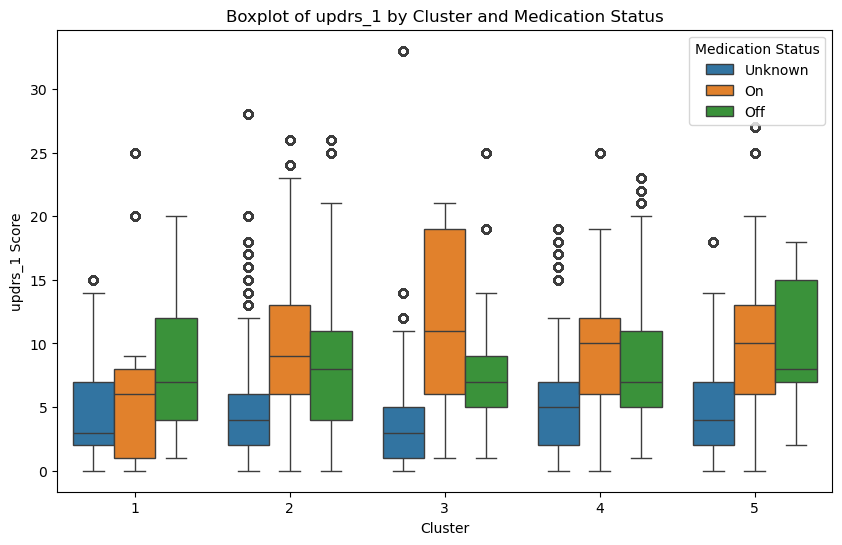

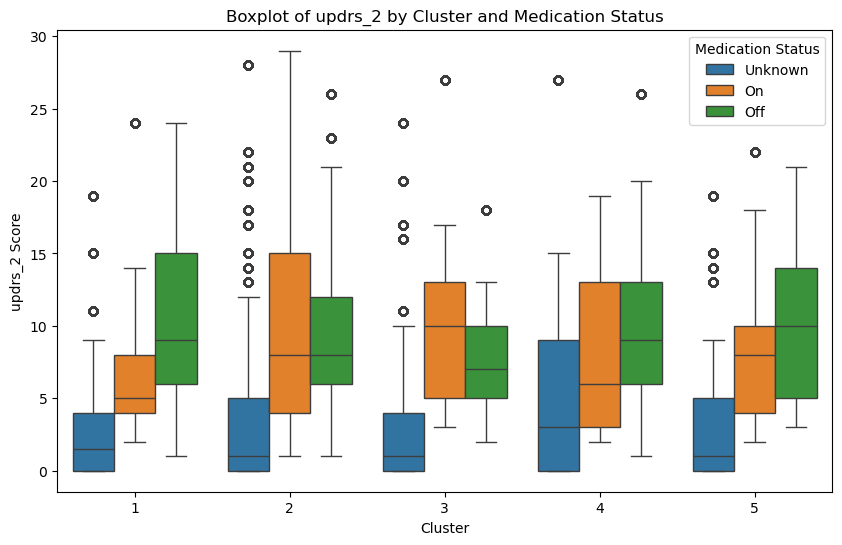

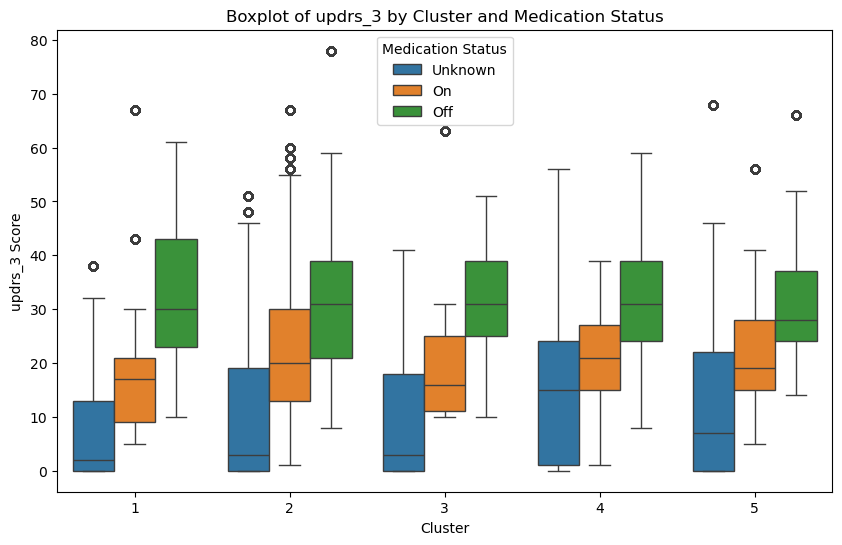

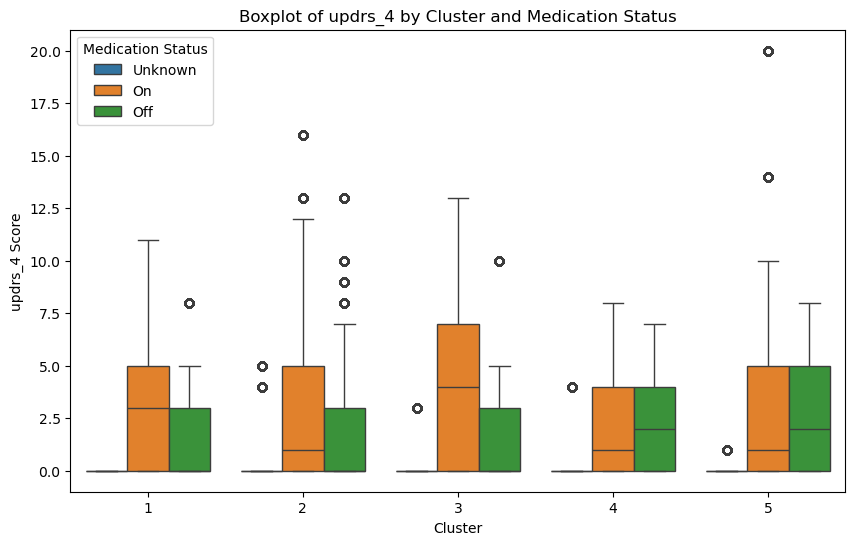

In [ ]:
proteins_clinical_copy = proteins_clinical.copy()
proteins_clinical_copy['upd23b_clinical_state_on_medication'].fillna('Unknown', inplace=True)

# Merge with the cluster information
merged_data_with_medication = clusters_df.merge(proteins_clinical_copy, on='visit_id')

for updrs_score in ['updrs_1', 'updrs_2', 'updrs_3', 'updrs_4']:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='cluster', y=updrs_score, hue='upd23b_clinical_state_on_medication', data=merged_data_with_medication)
    plt.title(f'Boxplot of {updrs_score} by Cluster and Medication Status')
    plt.ylabel(f'{updrs_score} Score')
    plt.xlabel('Cluster')
    plt.legend(title='Medication Status')
    plt.show()



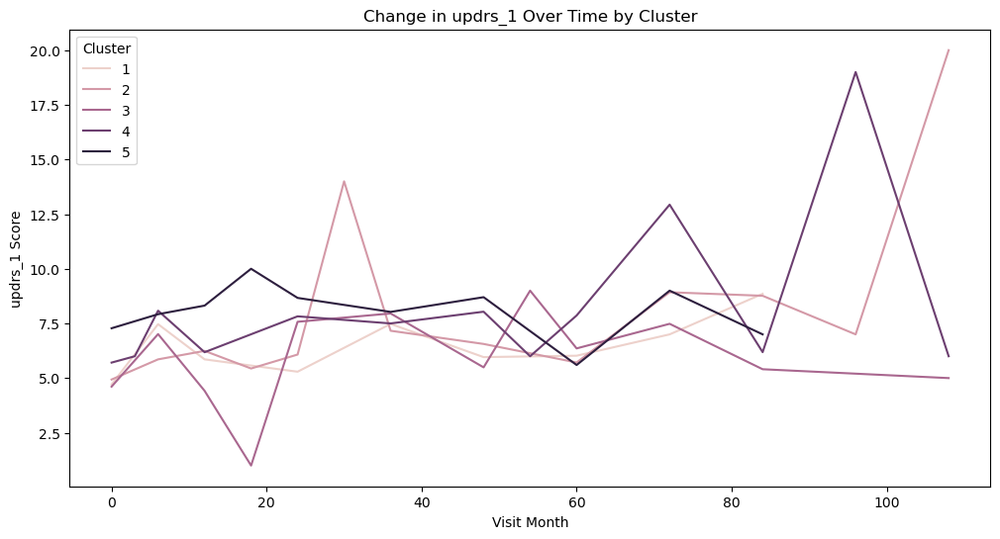

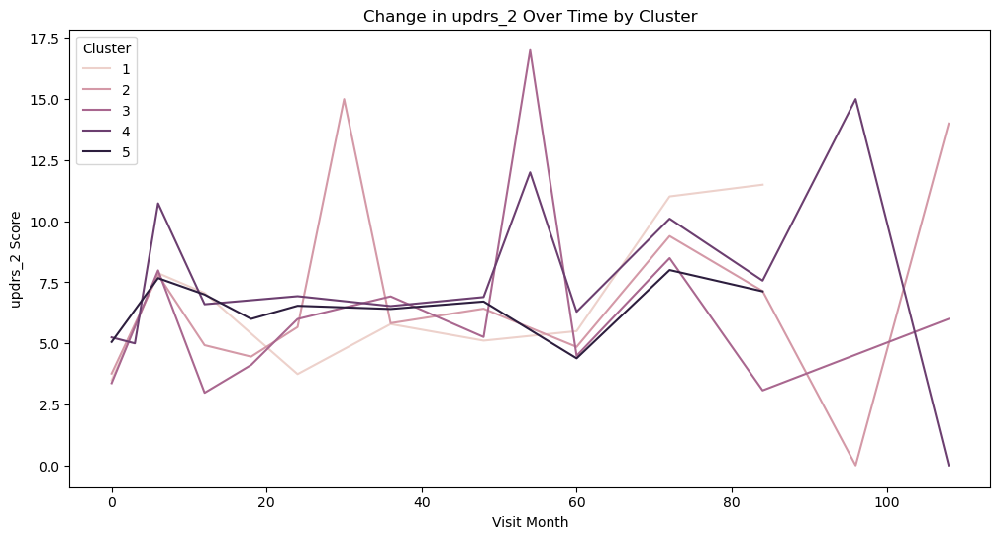

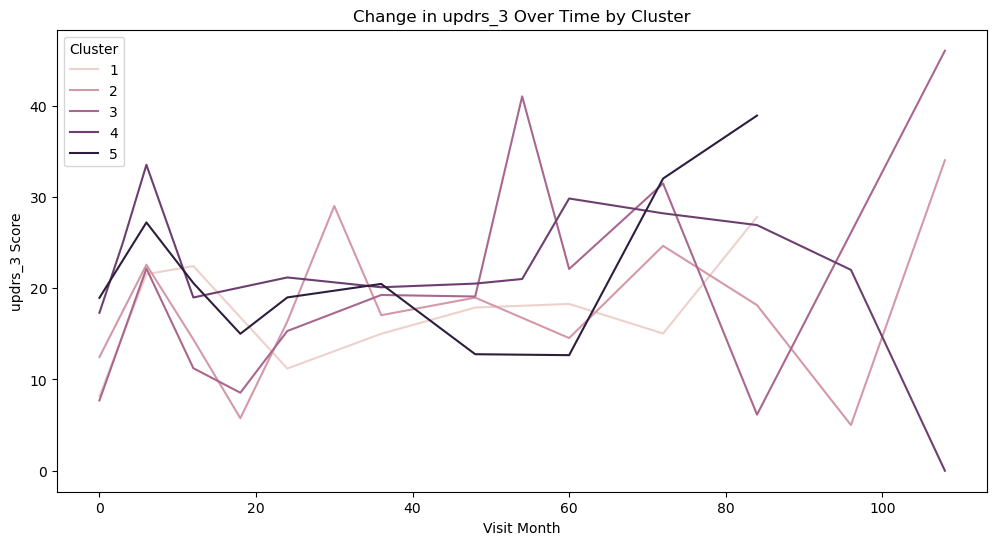

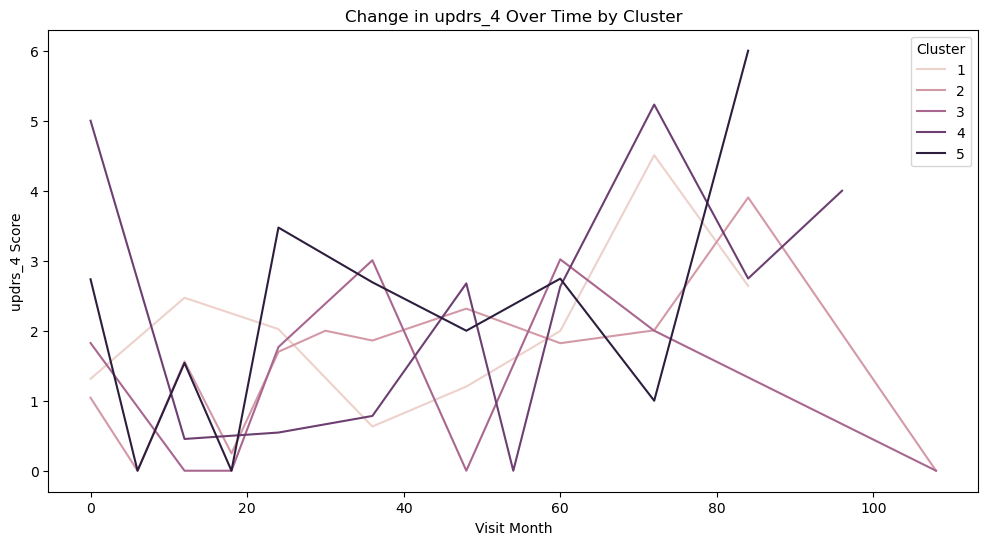

In [ ]:
# Loop through each UPDRS score
for updrs_score in ['updrs_1', 'updrs_2', 'updrs_3', 'updrs_4']:
    plt.figure(figsize=(12, 6))
    sns.lineplot(x='visit_month', y=updrs_score, hue='cluster',
                 data=merged_data_with_medication, estimator='mean', ci=None, markers=True)
    plt.title(f'Change in {updrs_score} Over Time by Cluster')
    plt.ylabel(f'{updrs_score} Score')
    plt.xlabel('Visit Month')
    plt.legend(title='Cluster')
    plt.show()


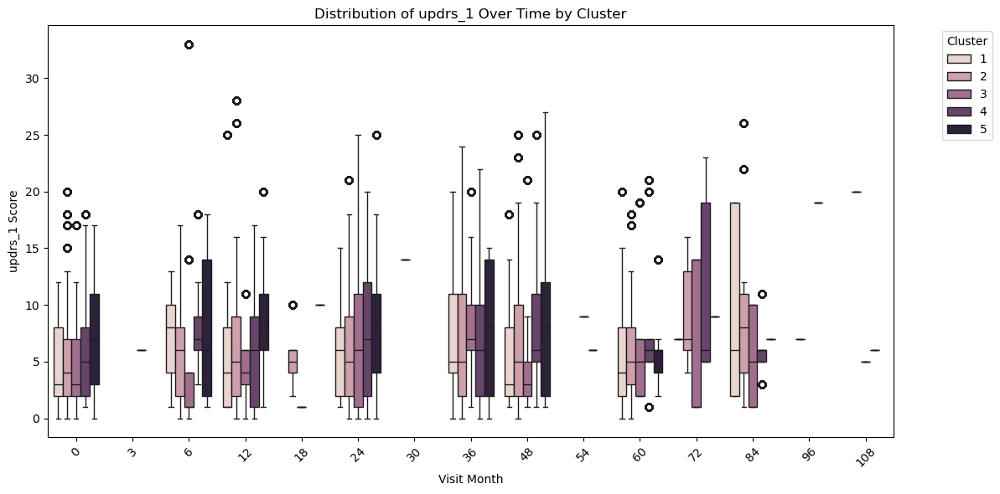

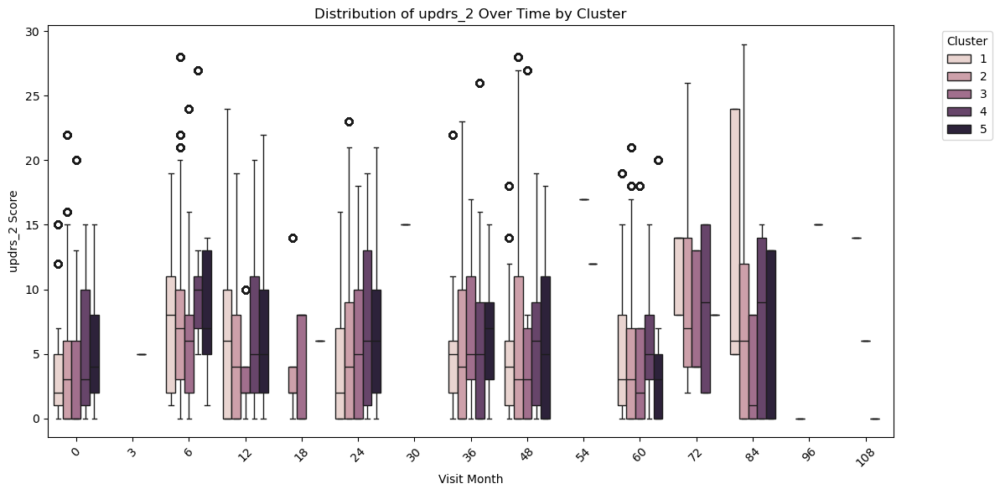

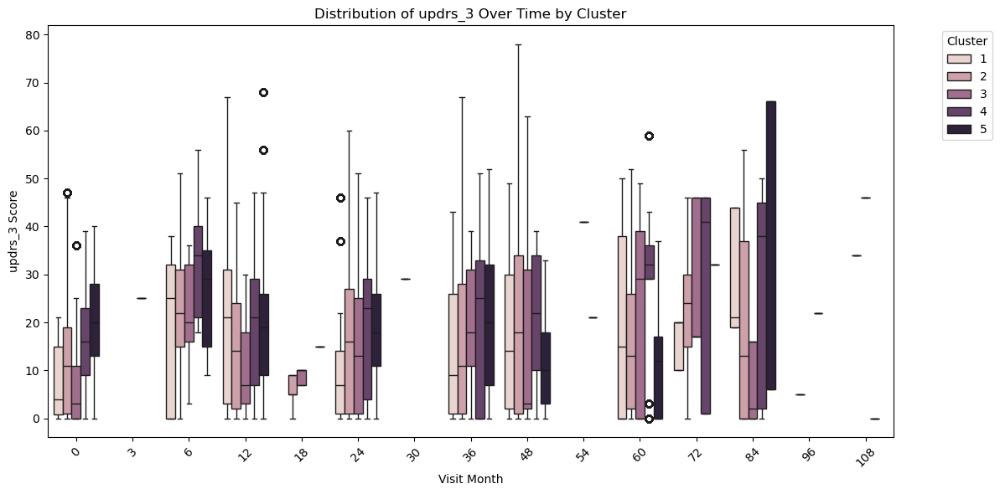

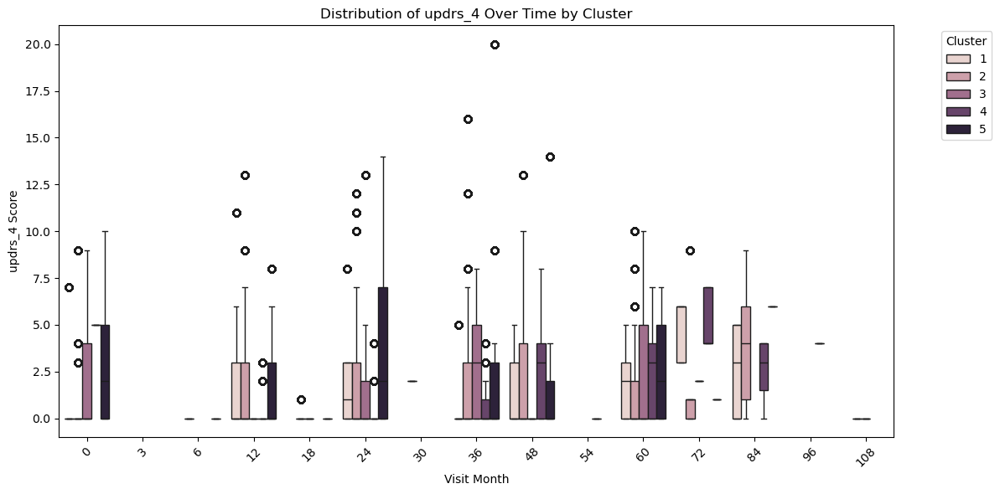

In [ ]:
# Loop through each UPDRS score
for updrs_score in ['updrs_1', 'updrs_2', 'updrs_3', 'updrs_4']:
    plt.figure(figsize=(12, 6))
    sns.boxplot(x='visit_month', y=updrs_score, hue='cluster',
                data=merged_data_with_medication)
    plt.title(f'Distribution of {updrs_score} Over Time by Cluster')
    plt.ylabel(f'{updrs_score} Score')
    plt.xlabel('Visit Month')
    plt.xticks(rotation=45)
    plt.legend(title='Cluster', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()


### Visit_month representation in each cluster

In [ ]:
unique_visit_ids_per_cluster = merged_data.groupby('cluster')['visit_id'].nunique()

total_unique_visit_ids = merged_data['visit_id'].nunique()

normalized_visit_ids_per_cluster = unique_visit_ids_per_cluster / total_unique_visit_ids
print(normalized_visit_ids_per_cluster)


cluster
1    0.096532
2    0.566073
3    0.089972
4    0.123711
5    0.123711
Name: visit_id, dtype: float64


In [ ]:
# Checking if some clusters might have some visit_month over/underpresentation

In [ ]:
visit_month_count = merged_data.groupby(['cluster', 'visit_month']).size()

cluster_totals = merged_data['cluster'].value_counts()

# Normalized count of each visit_month per cluster
normalized_visit_month_count_per_cluster = visit_month_count.div(cluster_totals, level='cluster')
print(normalized_visit_month_count_per_cluster)


cluster  visit_month
1        0              0.194475
         6              0.066271
         12             0.156178
         24             0.145756
         36             0.127755
         48             0.136481
         60             0.124813
         72             0.019348
         84             0.028922
2        0              0.154106
         6              0.088921
         12             0.175396
         18             0.008204
         24             0.171248
         30             0.001669
         36             0.139182
         48             0.135691
         60             0.074292
         72             0.019890
         84             0.028128
         96             0.001627
         108            0.001644
3        0              0.263121
         6              0.083859
         12             0.093373
         18             0.020577
         24             0.154677
         36             0.145804
         48             0.092998
         54           

In [ ]:
# For visit_month 0 only:
visit_month_0_data = merged_data[merged_data['visit_month'] == 0]

visit_month_0_data_with_medication = merged_data_with_medication[merged_data_with_medication['visit_month'] == 0]


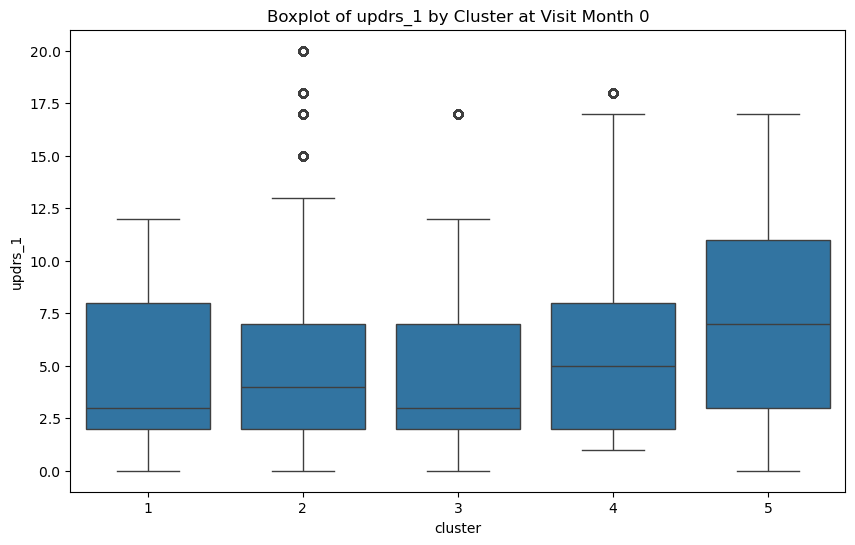

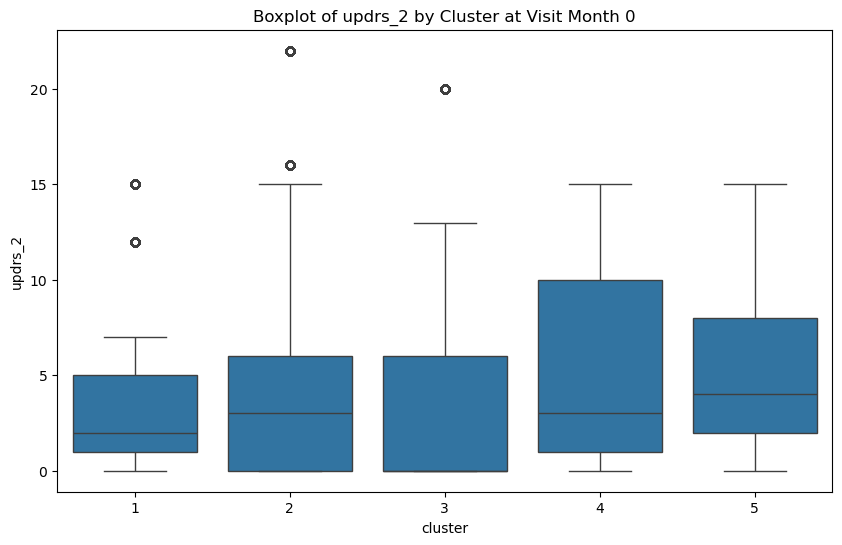

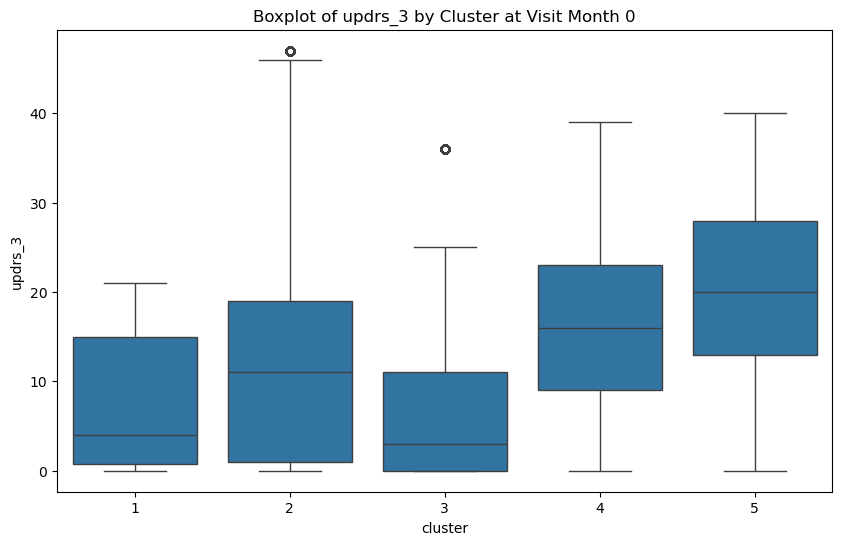

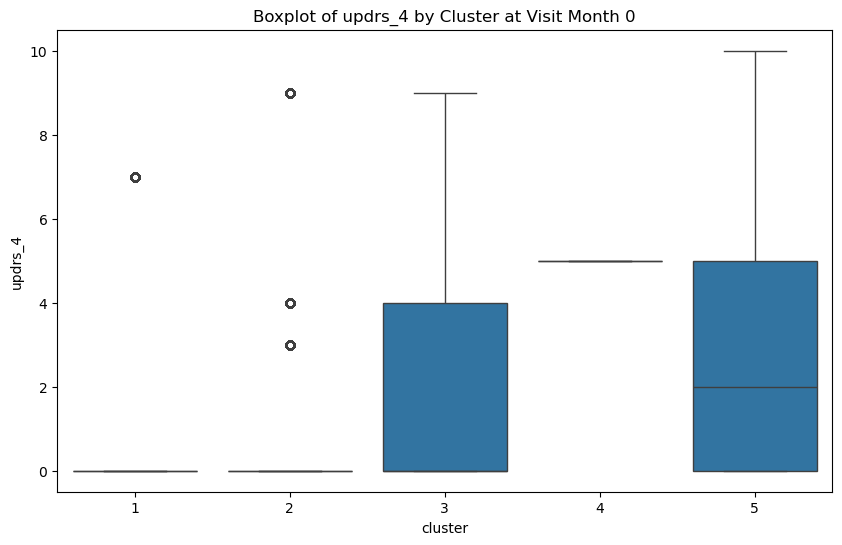

In [ ]:
for updrs_score in ['updrs_1', 'updrs_2', 'updrs_3', 'updrs_4']:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='cluster', y=updrs_score, data=visit_month_0_data)
    plt.title(f'Boxplot of {updrs_score} by Cluster at Visit Month 0')
    plt.show()

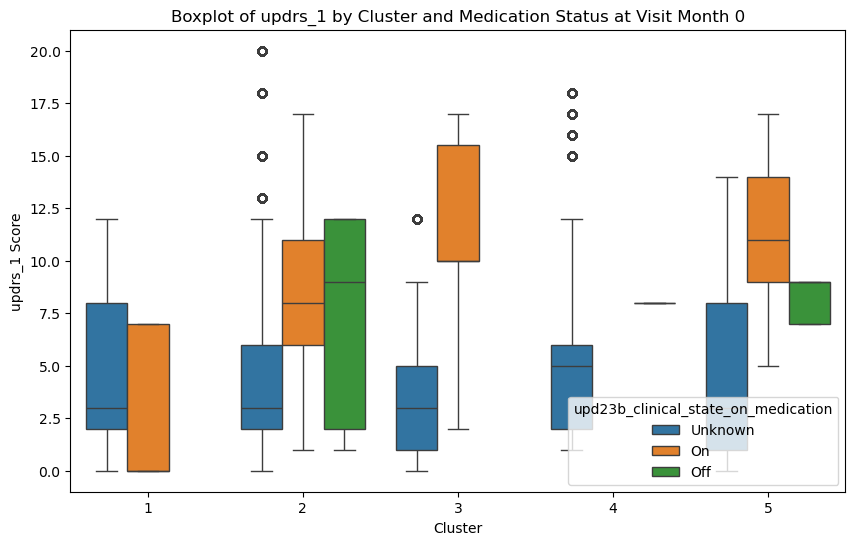

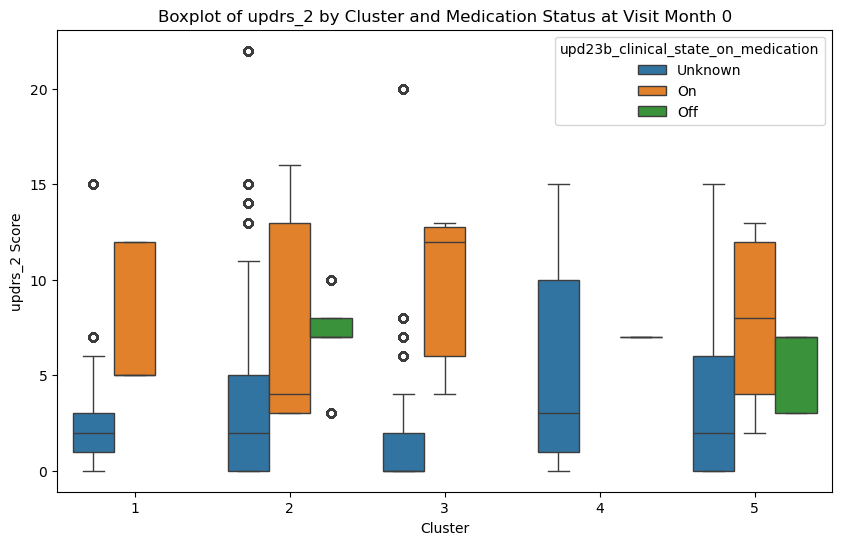

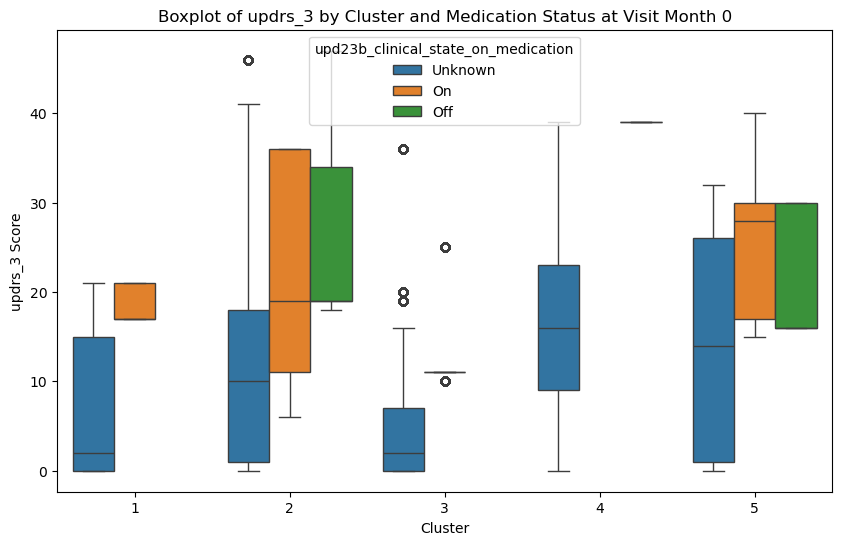

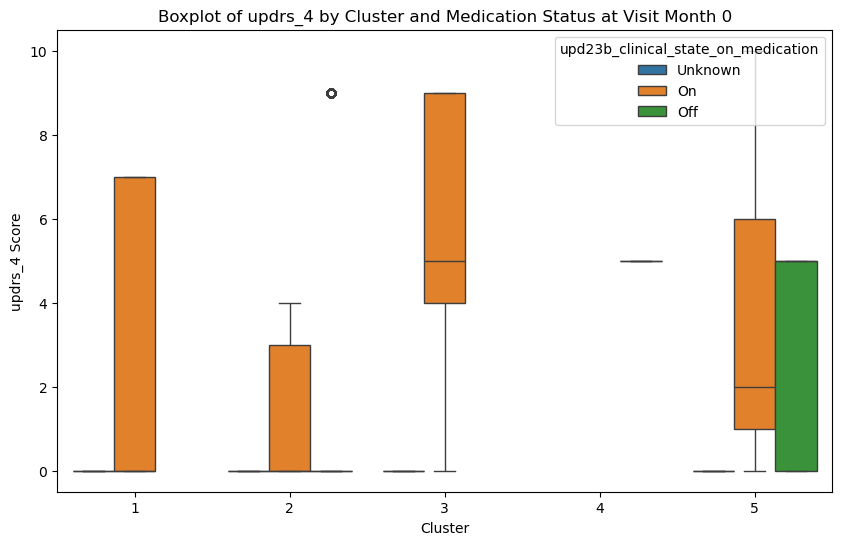

In [ ]:
for updrs_score in ['updrs_1', 'updrs_2', 'updrs_3', 'updrs_4']:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='cluster', y=updrs_score, hue='upd23b_clinical_state_on_medication', data=visit_month_0_data_with_medication)
    plt.title(f'Boxplot of {updrs_score} by Cluster and Medication Status at Visit Month 0')
    plt.ylabel(f'{updrs_score} Score')
    plt.xlabel('Cluster')

In [ ]:
protein_expression = merged_data.pivot_table(index='cluster', columns='UniProt', values='NPX_log2', aggfunc='mean')
variance_per_protein = protein_expression.var(axis=0)
sorted_proteins = variance_per_protein.sort_values(ascending=False)
print(sorted_proteins.head(10))

UniProt
P55290    0.202055
Q06481    0.180182
O15394    0.177309
P54289    0.172438
P13611    0.168196
P36222    0.162557
P61916    0.160190
P30086    0.152776
O00533    0.148387
P61769    0.146285
dtype: float64


In [ ]:
merged_with_cluster_info = clusters_df.merge(data_for_normalization, left_on='visit_id', right_index=True)


In [ ]:
merged_with_cluster_info

,visit_id,cluster,O00391_none,O00533_none,O00584_none,O14498_none,O14773_none,O14791_none,O15240_none,O15394_none,...,Q9HDC9_35,Q9NQ79_35,Q9NYU2_35,Q9UBR2_35,Q9UBX5_35,Q9UHG2_35,Q9UKV8_35,Q9UNU6_35,Q9Y646_35,Q9Y6R7_35
0,10053_0,5,13.152328,18.617989,0.000000,0.000000,12.803843,11.286465,16.340874,13.883560,...,0,0,0,0,0,0,0,13.908955,0,0
1,10053_12,5,13.353174,18.732597,0.000000,0.000000,0.000000,0.000000,17.588690,13.882175,...,0,0,0,0,0,0,0,0.000000,0,0
2,10053_18,2,13.692147,18.952724,12.799071,14.582007,0.000000,11.212320,16.948842,13.991664,...,0,0,0,0,0,0,0,13.400519,0,0
3,10138_12,2,13.621159,18.915846,13.161929,14.730974,14.458028,12.554565,17.254083,15.735196,...,0,0,0,0,0,0,0,14.670529,0,0
4,10138_24,2,13.551131,18.994070,12.135232,14.069265,14.829346,11.380001,17.205808,15.675574,...,0,0,0,0,0,0,0,13.625618,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1063,8699_24,3,13.285258,18.610685,14.565109,0.000000,14.048439,12.621862,16.241790,15.502934,...,0,0,0,0,0,0,0,13.815173,0,0
1064,942_12,2,12.722235,18.461074,14.164872,13.849474,14.183280,10.750514,16.406194,15.203856,...,0,0,0,0,0,0,0,14.227593,0,0
1065,942_24,2,0.000000,18.428175,14.478955,14.513795,14.027000,10.539072,16.808413,15.139539,...,0,0,0,0,0,0,0,14.226427,0,0
1066,942_48,2,13.505291,17.942032,14.428263,14.686090,14.453797,11.048099,16.327586,14.879708,...,0,0,0,0,0,0,0,14.366384,0,0


In [ ]:
# I'll look at protein variance across clusters, then check highest mean expression for each top varying protein

In [ ]:
# Pivot the data to have proteins as columns and clusters as rows
protein_expression_pivot = merged_with_cluster_info.pivot_table(
    index='cluster',
    values=[col for col in merged_with_cluster_info.columns if col.endswith('none')],
    aggfunc='mean')

# Calculate the variance of each protein's expression across clusters
protein_variance_across_clusters = protein_expression_pivot.var()

# Sort the proteins by variance to find the most representative ones
representative_proteins = protein_variance_across_clusters.sort_values(ascending=False)

# Display the top representative proteins
print(representative_proteins.head(10))


Q9NYU2_none    51.657445
Q99683_none    45.625415
P11142_none    28.265157
Q99435_none    10.661428
Q9HDC9_none     9.081275
Q8N2S1_none     9.070533
P05408_none     8.461299
Q96BZ4_none     8.195336
P04211_none     7.481268
P60174_none     7.323740
dtype: float64


In [ ]:
# List of top varying proteins
top_varying_proteins = representative_proteins.head(10).index.tolist()

# Extracting the mean expression of these top proteins in each cluster
mean_expression_top_proteins = protein_expression_pivot[top_varying_proteins]

# Finding the cluster with the highest mean expression for each protein
representative_cluster_per_protein = mean_expression_top_proteins.idxmax()

representative_cluster_per_protein


Q9NYU2_none    1
Q99683_none    2
P11142_none    2
Q99435_none    3
Q9HDC9_none    4
Q8N2S1_none    3
P05408_none    1
Q96BZ4_none    2
P04211_none    4
P60174_none    1
dtype: int32

In [ ]:
# Count unique visit_ids per cluster
unique_visit_ids_per_cluster = merged_data.groupby('cluster')['visit_id'].nunique()

unique_visit_ids_per_cluster


cluster
1    103
2    604
3     96
4    132
5    132
Name: visit_id, dtype: int64

In [ ]:
# Count unique visit_ids per cluster
unique_patient_ids_per_cluster = merged_data.groupby('cluster')['patient_id'].nunique()

unique_patient_ids_per_cluster


cluster
1     76
2    205
3     66
4     72
5     57
Name: patient_id, dtype: int64

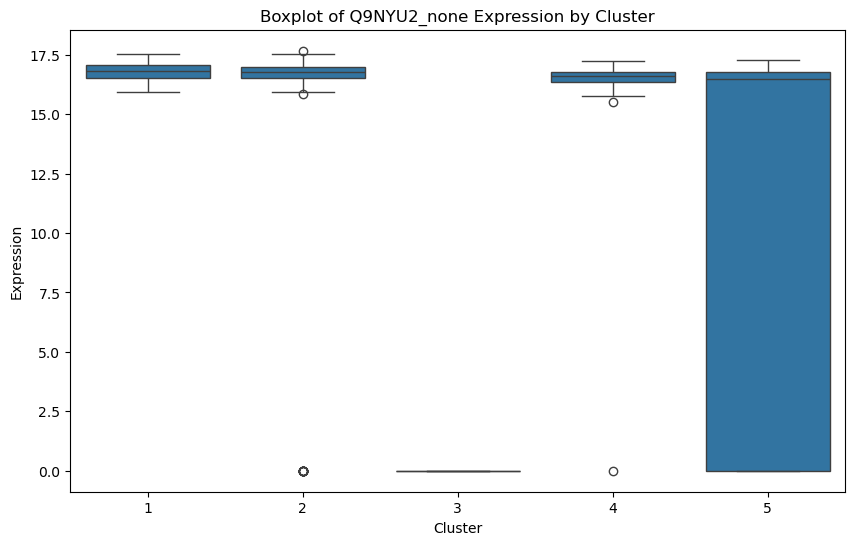

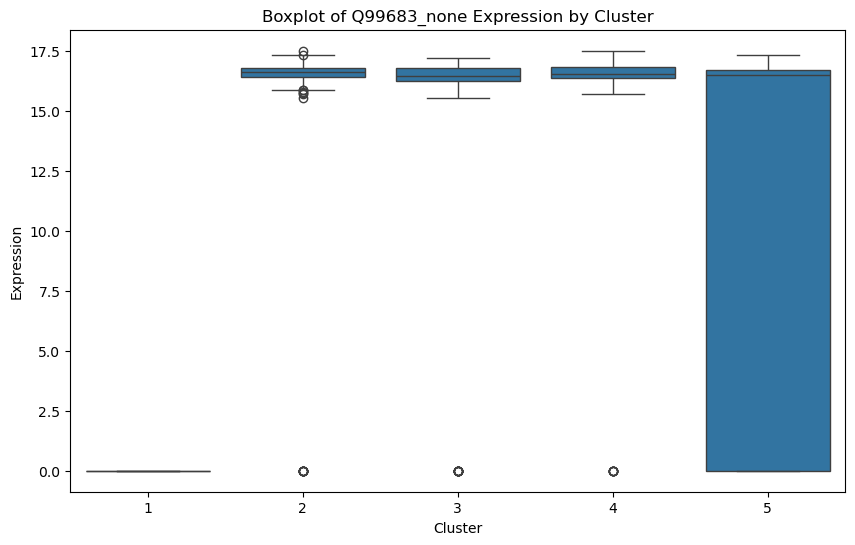

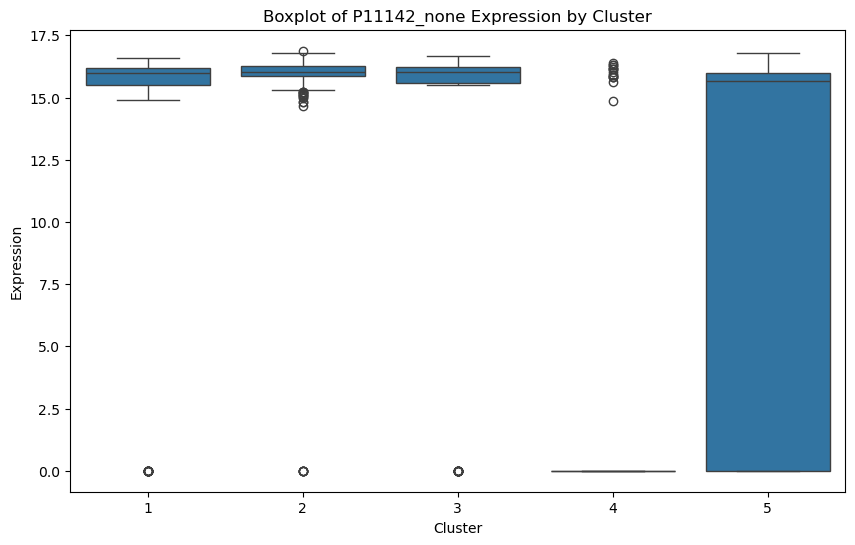

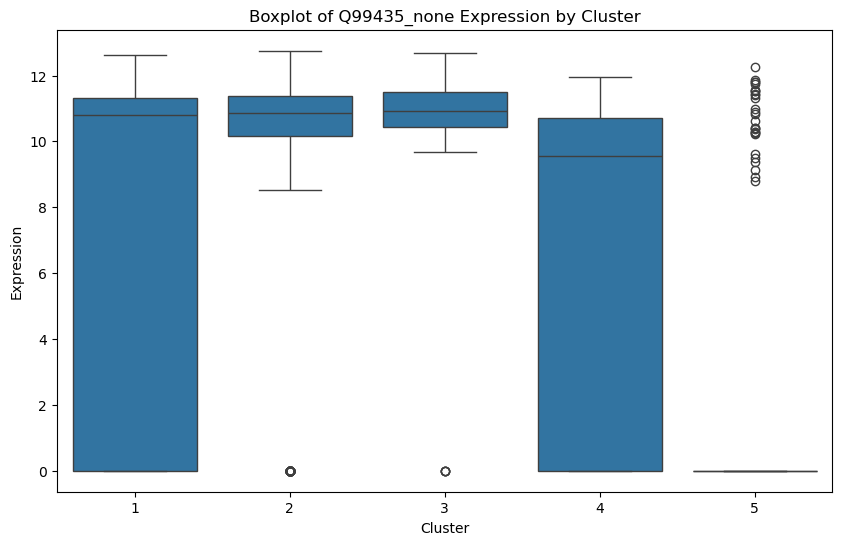

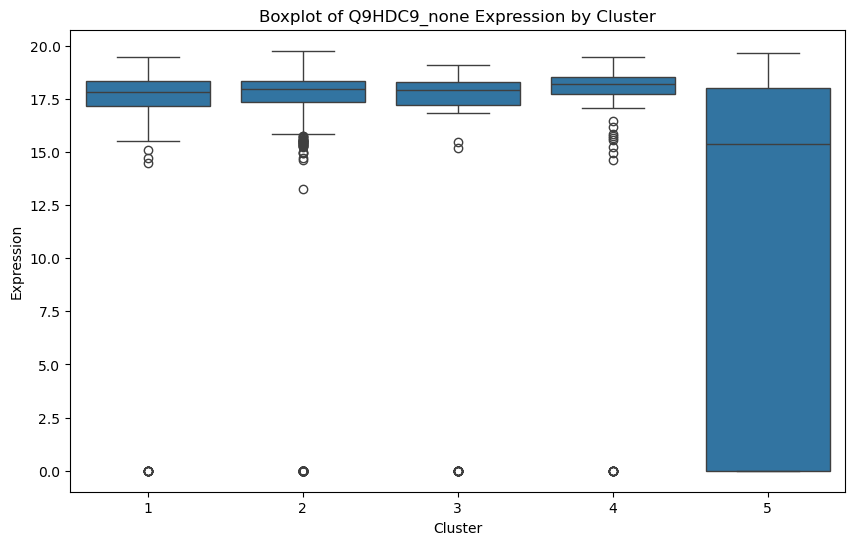

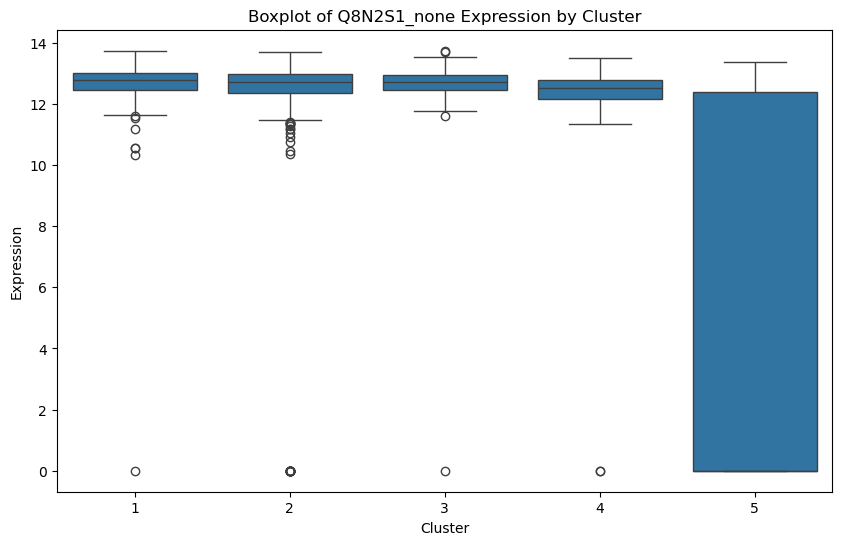

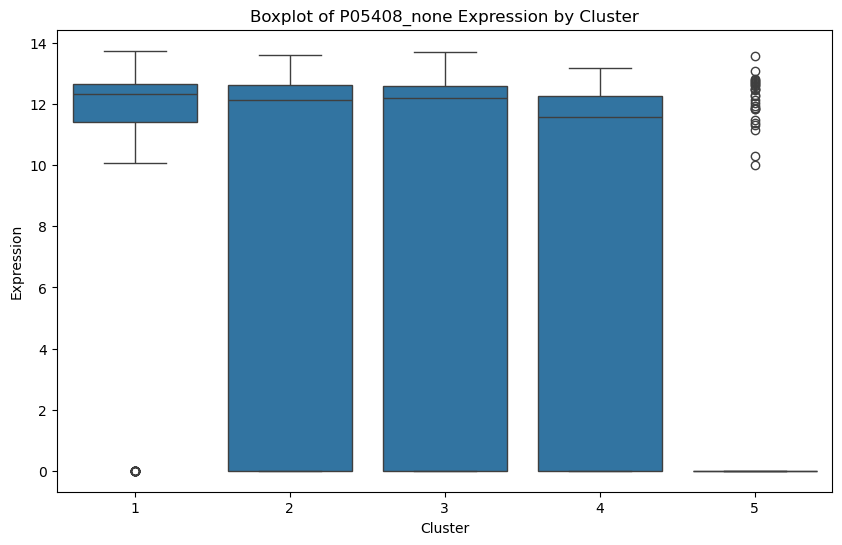

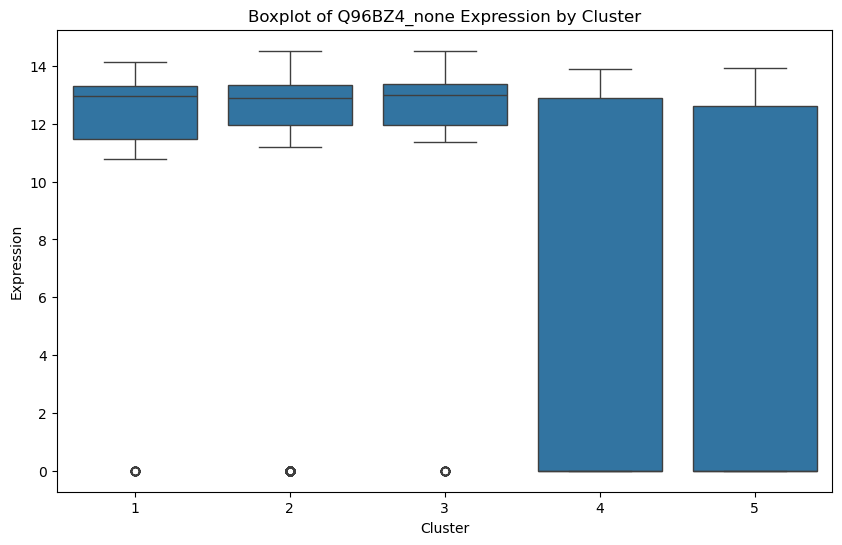

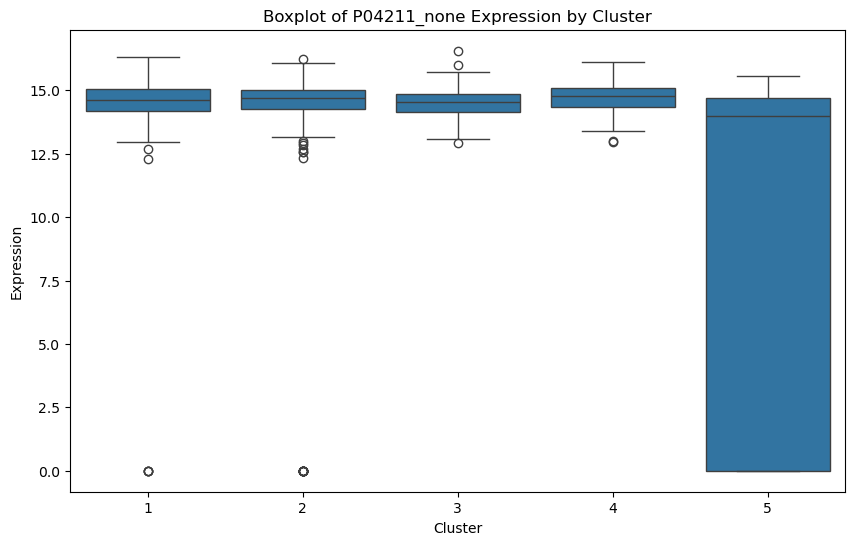

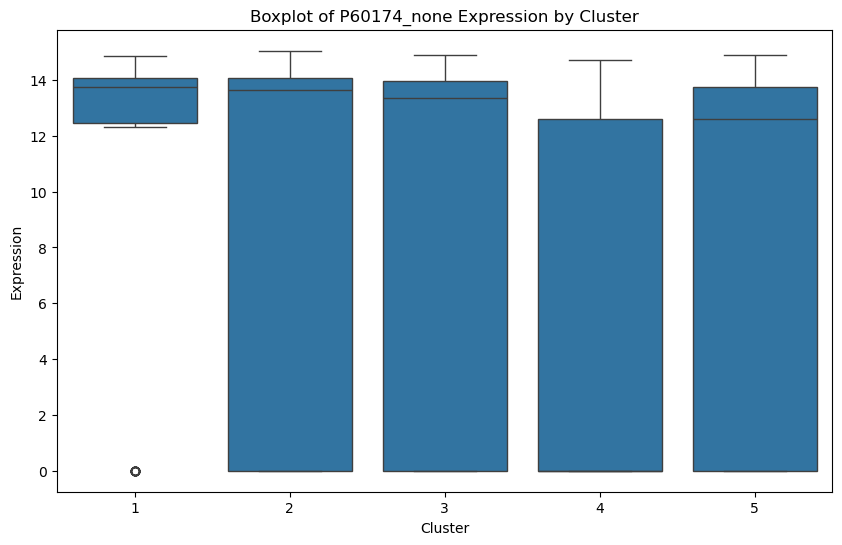

In [ ]:
for protein in ['Q9NYU2_none', 'Q99683_none', 'P11142_none', 'Q99435_none',
                'Q9HDC9_none', 'Q8N2S1_none', 'P05408_none', 'Q96BZ4_none',
                'P04211_none', 'P60174_none']:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='cluster', y=protein, data=merged_with_cluster_info)
    plt.title(f'Boxplot of {protein} Expression by Cluster')
    plt.xlabel('Cluster')
    plt.ylabel('Expression')
    plt.show()


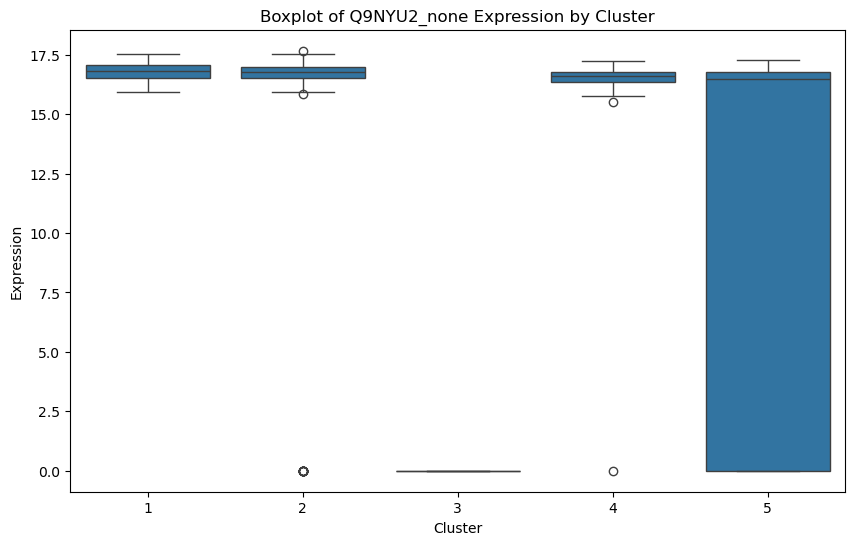

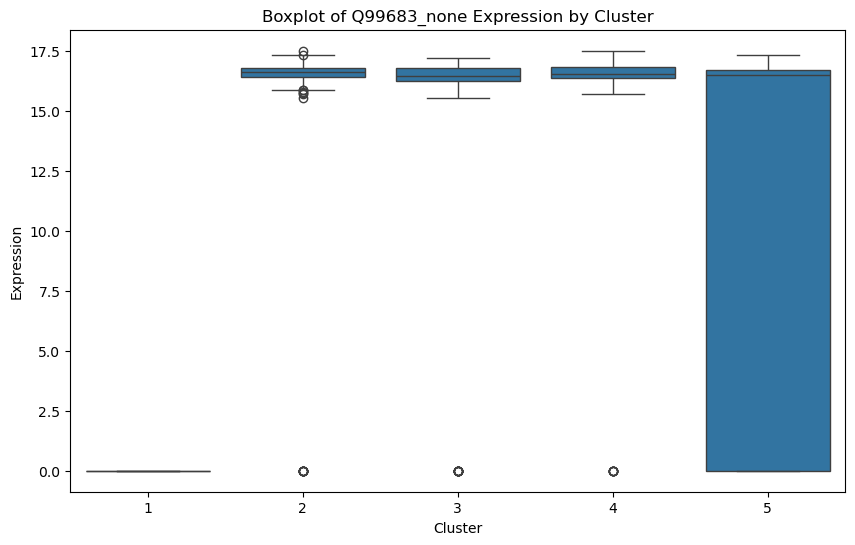

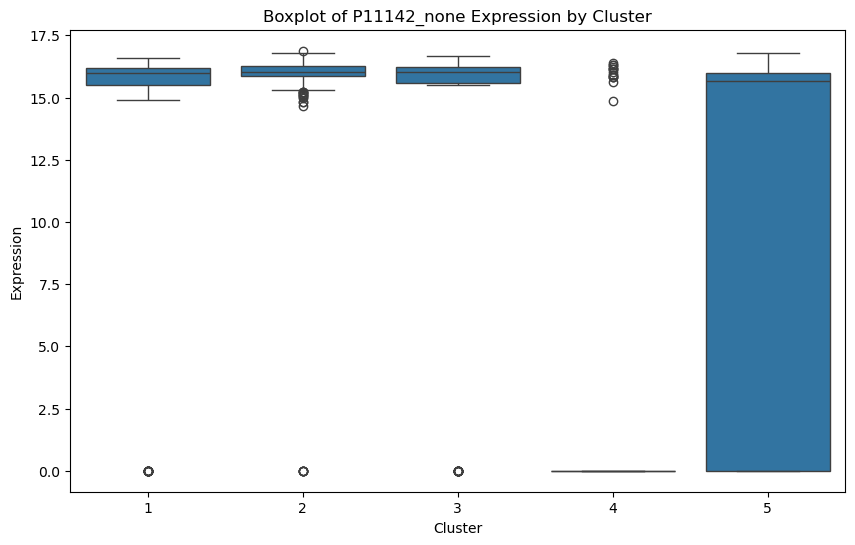

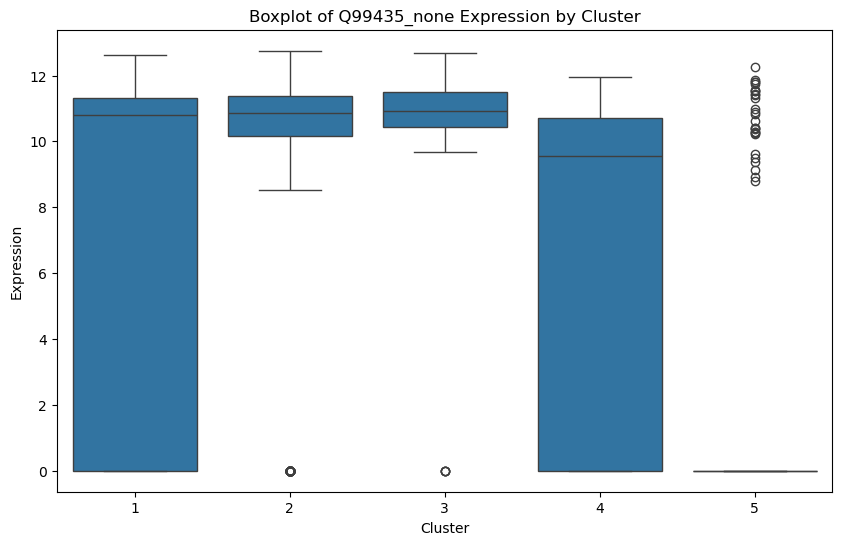

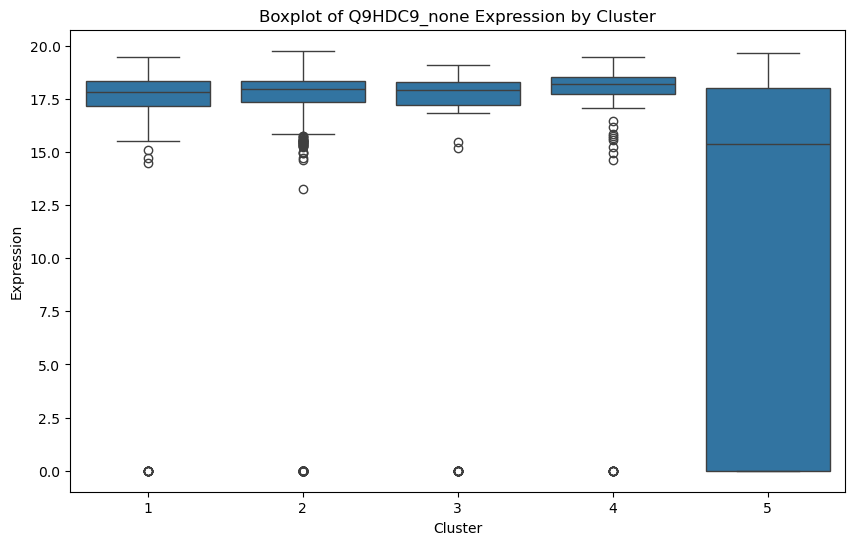

...

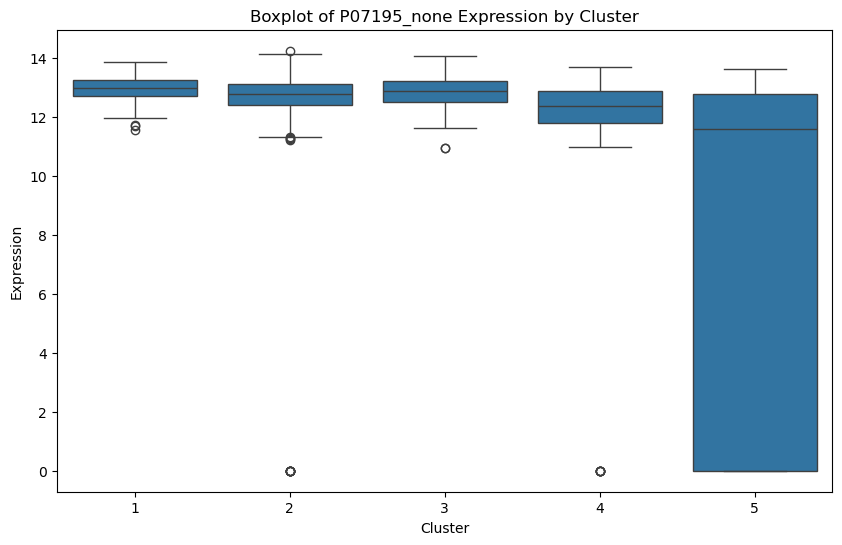

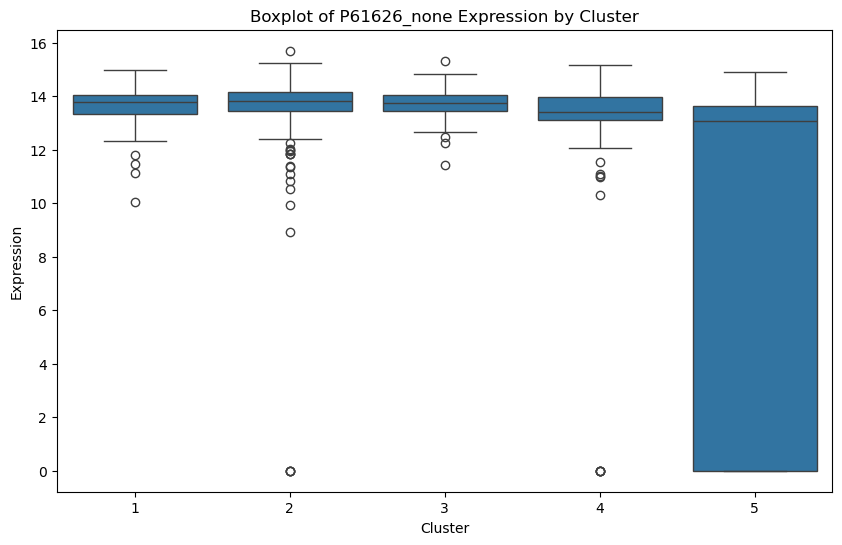

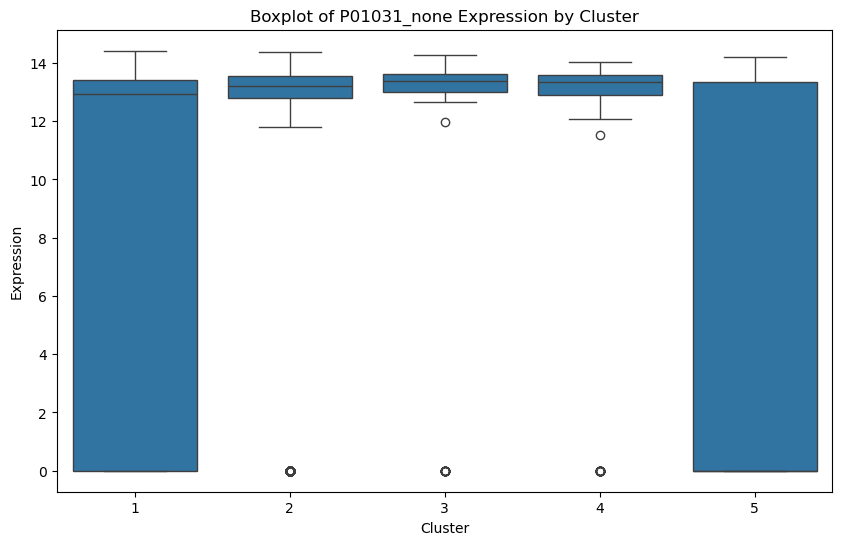

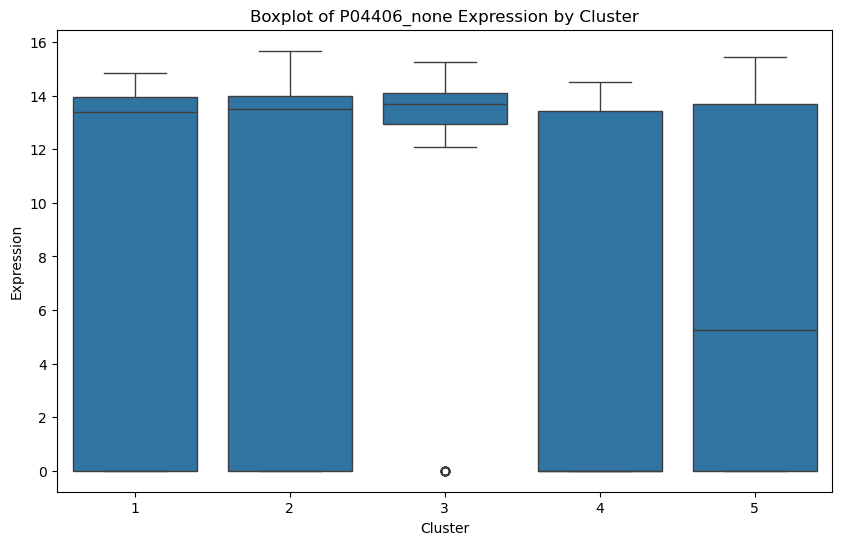

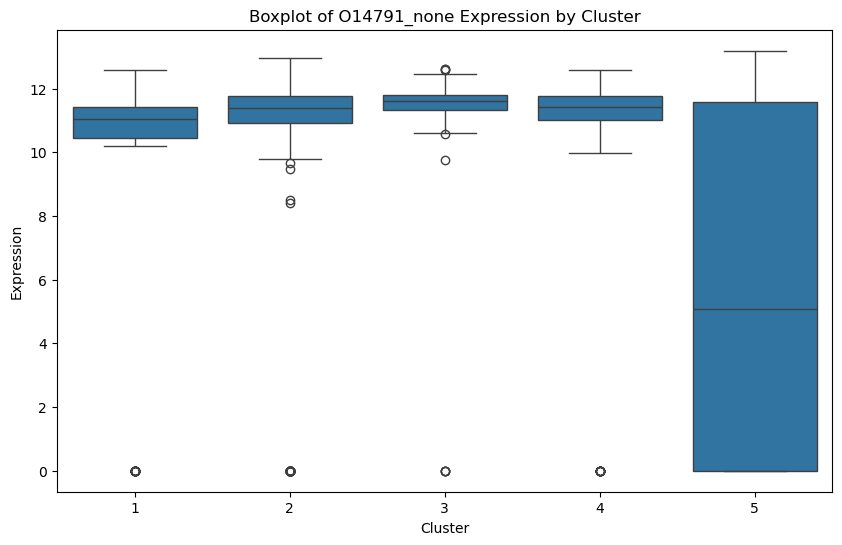

In [ ]:
top_30_proteins = representative_proteins.head(30).index.tolist()

for protein in top_30_proteins:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='cluster', y=protein, data=merged_with_cluster_info)
    plt.title(f'Boxplot of {protein} Expression by Cluster')
    plt.xlabel('Cluster')
    plt.ylabel('Expression')
    plt.show()


In [ ]:
# That's interesting. A bunch of outliers, but expression of some proteins seems to be reduced in some clusters.

In [ ]:
top_10_proteins = ['Q9NYU2', 'Q99683', 'P11142', 'Q99435', 'Q9HDC9', 'Q8N2S1', 'P05408', 'Q96BZ4', 'P04211', 'P60174']

for uniprot_id in top_10_proteins:
    protein_name, gene_name, function = fetch_uniprot_data(uniprot_id)
    print(f"UniProt ID: {uniprot_id}")
    print(f"Protein Name: {protein_name}")
    print(f"Gene Name: {gene_name}")
    print(f"Function: {function}\n")


UniProt ID: Q9NYU2
Protein Name: UDP-glucose:glycoprotein glucosyltransferase 1;
Gene Name: UGGT1
Function: Recognizes glycoproteins with minor folding defects. Reglucosylates single N-glycans near the misfolded part of the protein, thus providing quality control for protein folding in the endoplasmic reticulum. Reglucosylated proteins are recognized by calreticulin for recycling to the endoplasmic reticulum and refolding or degradation. {ECO:0000269|PubMed:10694380}.

UniProt ID: Q99683
Protein Name: Mitogen-activated protein kinase kinase kinase 5;
Gene Name: MAP3K5
Function: Serine/threonine kinase which acts as an essential component of the MAP kinase signal transduction pathway. Plays an important role in the cascades of cellular responses evoked by changes in the environment. Mediates signaling for determination of cell fate such as differentiation and survival. Plays a crucial role in the apoptosis signal transduction pathway through mitochondria-dependent caspase activation. MA

In [ ]:
final_pivot_log2

,O00391_none,O00533_none,O00584_none,O14498_none,O14773_none,O14791_none,O15240_none,O15394_none,O43505_none,O60888_none,...,Q9NYU2_35,Q9UBR2_35,Q9UBX5_35,Q9UHG2_35,Q9UKV8_35,Q9UNU6_35,Q9Y646_35,Q9Y6R7_35,patient_id,visit_month
visit_id,,,,,,,,,,,,,,,,,,,,,
10053_0,13.152328,18.617989,0.000000,0.000000,12.803843,11.286465,16.340874,13.883560,17.352311,16.977548,...,0,0,0,0,0,13.908955,0,0,10053,0
10053_12,13.353174,18.732597,0.000000,0.000000,0.000000,0.000000,17.588690,13.882175,17.325692,16.722194,...,0,0,0,0,0,0.000000,0,0,10053,12
10053_18,13.692147,18.952724,12.799071,14.582007,0.000000,11.212320,16.948842,13.991664,17.359020,17.321364,...,0,0,0,0,0,13.400519,0,0,10053,18
10138_12,13.621159,18.915846,13.161929,14.730974,14.458028,12.554565,17.254083,15.735196,17.638302,15.791697,...,0,0,0,0,0,14.670529,0,0,10138,12
10138_24,13.551131,18.994070,12.135232,14.069265,14.829346,11.380001,17.205808,15.675574,17.878027,16.388137,...,0,0,0,0,0,13.625618,0,0,10138,24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8699_24,13.285258,18.610685,14.565109,0.000000,14.048439,12.621862,16.241790,15.502934,17.955871,17.083791,...,0,0,0,0,0,13.815173,0,0,8699,24
942_12,12.722235,18.461074,14.164872,13.849474,14.183280,10.750514,16.406194,15.203856,17.694603,16.617109,...,0,0,0,0,0,14.227593,0,0,942,12
942_24,0.000000,18.428175,14.478955,14.513795,14.027000,10.539072,16.808413,15.139539,17.503670,16.597813,...,0,0,0,0,0,14.226427,0,0,942,24


## Joining mutated peptide information, and then clustering

In [ ]:
# Resetting the index of final_pivot_log2
final_pivot_log2_reset = final_pivot_log2.reset_index()

# Dropping the 'upd23b_clinical_state_on_medication' column from peptide_ratio_df
peptide_ratio_df_modified = peptide_ratio_df.drop(columns=['upd23b_clinical_state_on_medication'])

# Merging the dataframes on 'visit_id'
combined_df = pd.merge(final_pivot_log2_reset, peptide_ratio_df_modified, on='visit_id', how='inner')

# Filling NaN values with 0s
combined_df_filled = combined_df.fillna(0)

# Dropping columns with all zeros
combined_df_no_zeros = combined_df_filled.loc[:, (combined_df_filled != 0).any(axis=0)]

# Extracting visit_id to set as index later
visit_ids = combined_df_no_zeros['visit_id']

# Removing visit_id before scaling
combined_df_scaled = combined_df_no_zeros.drop(columns=['visit_id'])

# Applying RobustScaler
scaler = RobustScaler()
pivot_log2_peptide_ratio_scaled = pd.DataFrame(scaler.fit_transform(combined_df_scaled), columns=combined_df_scaled.columns)

# Setting visit_id as the index
pivot_log2_peptide_ratio = pivot_log2_peptide_ratio_scaled.set_index(visit_ids)

# Displaying the first few rows of the scaled dataframe
pivot_log2_peptide_ratio



,O00391_none,O00533_none,O00584_none,O14498_none,O14773_none,O14791_none,O15240_none,O15394_none,O43505_none,O60888_none,...,ratio_SNSSM(UniMod_35)HITDCR_SNSSMHITDCR,ratio_AQTTVTCM(UniMod_35)ENGWSPTPR_AQTTVTCMENGWSPTPR,ratio_IVSSAMEPDREYHFGQAVR_IVSSAM(UniMod_35)EPDREYHFGQAVR,ratio_TM(UniMod_35)QENSTPRED_TMQENSTPRED,ratio_DQTVSDNELQEM(UniMod_35)SNQGSK_DQTVSDNELQEMSNQGSK,ratio_FM(UniMod_35)ETVAEK_FMETVAEK,ratio_M(UniMod_35)VQEQCCHSQLEELHCATGISLANEQDR_MVQEQCCHSQLEELHCATGISLANEQDR,ratio_TM(UniMod_35)LLQPAGSLGSYSYR_TMLLQPAGSLGSYSYR,ratio_ICLEDNVLM(UniMod_35)SGVK_ICLEDNVLMSGVK,ratio_M(UniMod_35)ASGAANVVGPK_MASGAANVVGPK
visit_id,,,,,,,,,,,,,,,,,,,,,
10053_0,-0.009137,-0.287218,-19.350490,-20.652736,-1.456830,-0.064765,-0.391369,-1.903170,-0.200629,-0.061439,...,-0.535057,-5.208185,-0.544630,-88.450730,-1.859801,-1.113277,-7.636679,-0.202599,0.388892,-0.784808
10053_12,0.005629,-0.160216,-19.350490,-20.652736,-16.534778,-11.767363,0.621343,-1.904734,-0.235693,-0.380407,...,-0.535057,-1.495800,0.338775,-88.450730,-1.859801,-1.514905,-7.636679,-0.669972,0.323402,-0.784808
10053_18,0.030549,0.083714,-2.488820,-0.088411,-16.534778,-0.141644,0.102050,-1.781109,-0.191790,0.368029,...,0.978668,-1.335390,0.126222,0.024930,1.957700,-1.514905,-7.636679,-0.648888,0.180459,1.508247
10138_12,0.025330,0.042849,-2.010787,0.121671,0.491157,1.250089,0.349780,0.187527,0.176099,-1.542709,...,0.640181,-0.108438,0.345858,0.039099,-0.032651,0.191774,0.250971,0.297779,0.168254,0.126789
10138_24,0.020182,0.129531,-3.363372,-0.811506,0.928425,0.032219,0.310601,0.120207,0.491882,-0.797684,...,0.580856,0.210136,-0.181921,0.261716,-0.535288,0.687583,-0.364271,0.235347,0.295929,0.288470
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8699_24,0.000636,-0.295311,-0.162219,-20.652736,0.008821,1.319868,-0.471784,-0.074722,0.594424,0.071271,...,0.082600,-0.052011,0.430838,-88.450730,-0.808150,-1.100078,0.191871,-0.678512,-0.765607,-0.711035
942_12,-0.040756,-0.461101,-0.689496,-1.121468,0.167611,-0.620476,-0.338355,-0.412413,0.250263,-0.511671,...,0.878272,-0.050643,-0.229798,0.244423,-0.320101,1.228353,-0.090471,-0.703405,0.407705,0.644610
942_24,-0.976064,-0.497557,-0.275719,-0.184606,-0.016427,-0.839715,-0.011920,-0.485034,-0.001247,-0.535774,...,1.031644,-0.544351,-6.748180,0.303048,0.083231,1.399841,0.401950,-0.703405,0.021991,0.445540


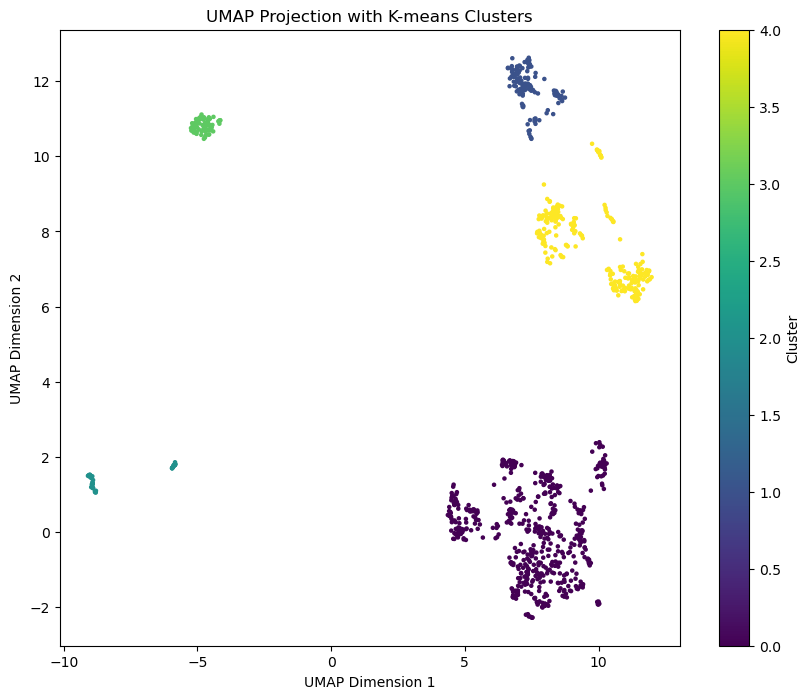

In [ ]:
umap_reducer = umap.UMAP(n_neighbors=15, random_state=42)
umap_embedding = umap_reducer.fit_transform(pivot_log2_peptide_ratio)

k = 5  # looks ok for now
kmeans = KMeans(n_clusters=k, random_state=42)
clusters = kmeans.fit_predict(umap_embedding)

# Plot UMAP with K-means clustering results
plt.figure(figsize=(10, 8))
plt.scatter(umap_embedding[:, 0], umap_embedding[:, 1], c=clusters, cmap='viridis', s=5)
plt.title('UMAP Projection with K-means Clusters')
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.colorbar(label='Cluster')
plt.show()


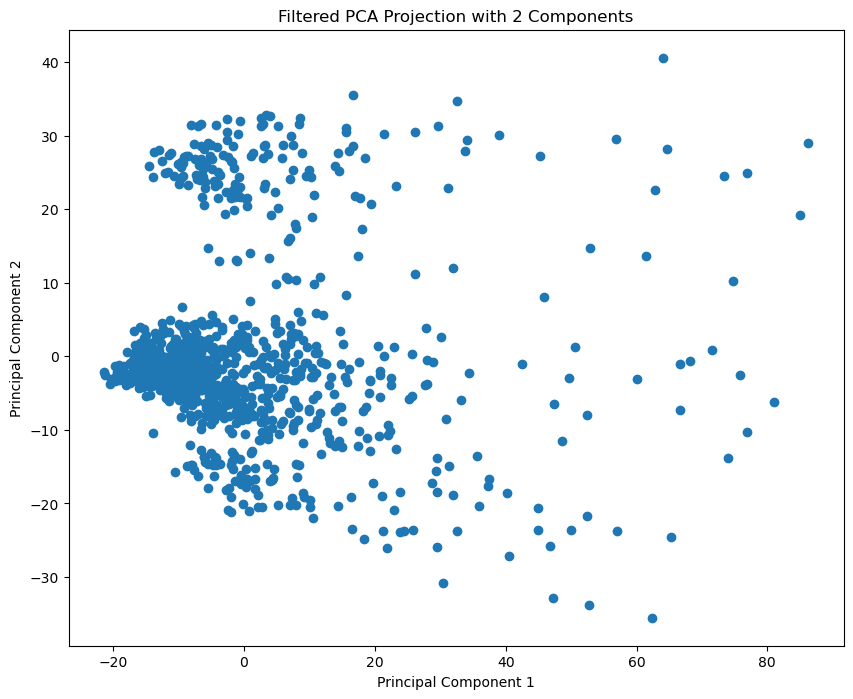

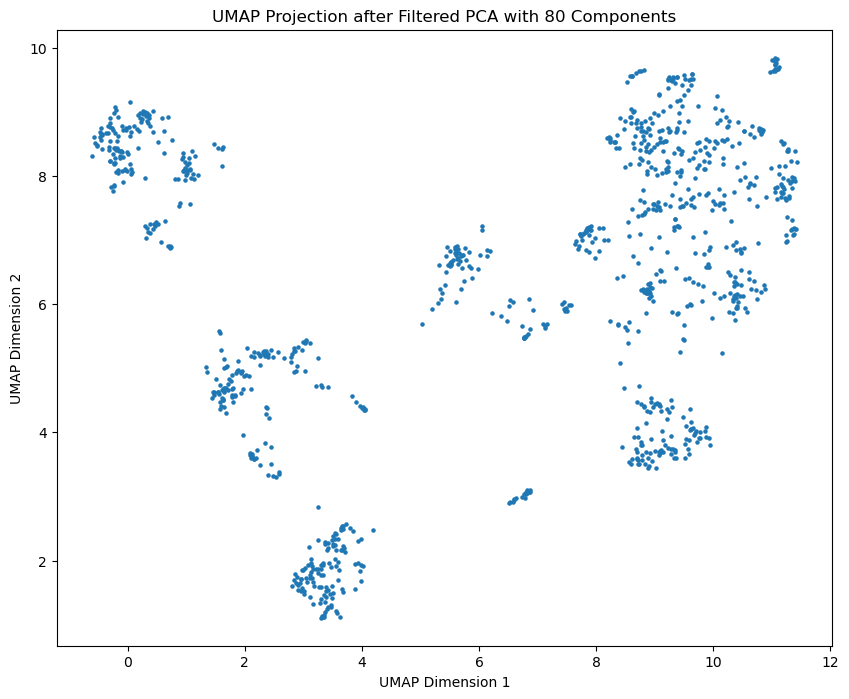

In [ ]:
# Filter out points with PC1 > 100 and PC2 > 200
pca_result_2 = pca_result.copy()
filtered_pca_result_2 = pca_result_2[(pca_result_2[:, 0] <= 100) & (pca_result_2[:, 1] <= 200)]


plt.figure(figsize=(10, 8))
plt.scatter(filtered_pca_result_2[:, 0], filtered_pca_result_2[:, 1])
plt.title('Filtered PCA Projection with 2 Components')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.show()


umap_embedding_after_pca = umap_reducer_after_pca.fit_transform(filtered_pca_result_2)
plt.figure(figsize=(10, 8))
plt.scatter(umap_embedding_after_pca[:, 0], umap_embedding_after_pca[:, 1], s=5)
plt.title('UMAP Projection after Filtered PCA with 80 Components')
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.show()



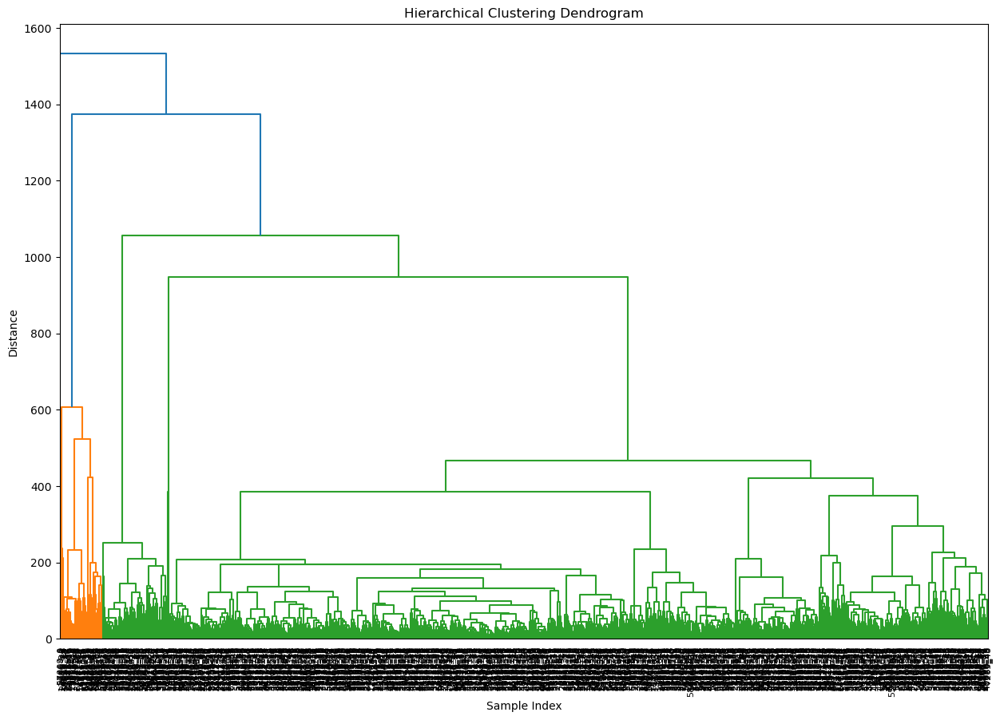

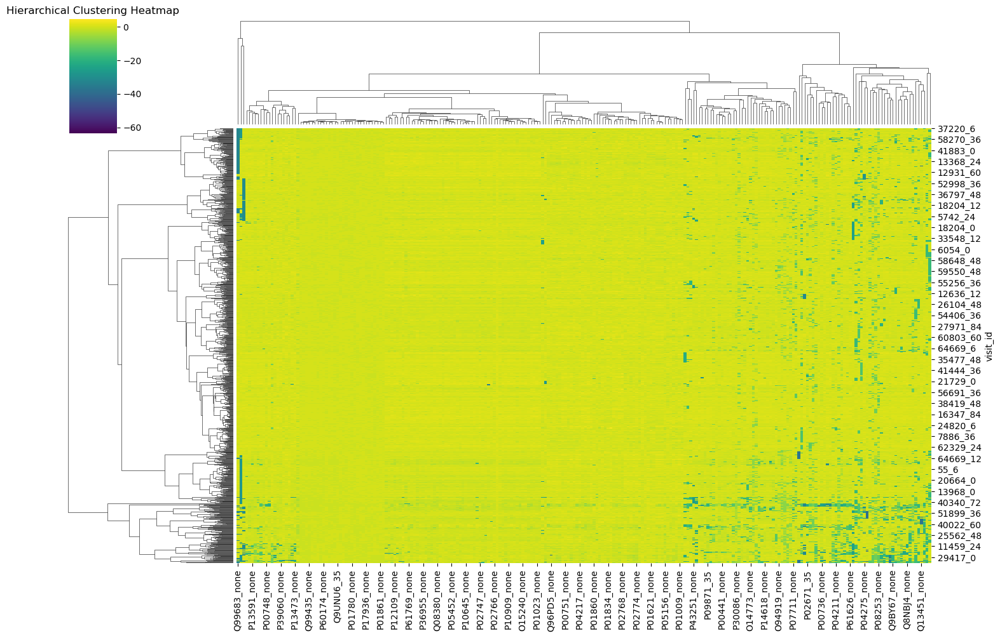

In [ ]:
linked = linkage(pivot_log2_peptide_ratio, method='ward')

# Plot the Dendrogram
plt.figure(figsize=(15, 10))
dendrogram(linked, labels=protein_data_robust_df.index.tolist(), orientation='top', leaf_rotation=90, leaf_font_size=8)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel('Distance')
plt.show()

# Heatmap with Clustermap
sns.clustermap(protein_data_robust_df, method='ward', cmap='viridis', figsize=(15, 10))
plt.title('Hierarchical Clustering Heatmap')
plt.show()


# Estimating protein/peptide expression for missing visit_ids - skip for now

In [ ]:
## I will have to get back to his, as this holds the key to the best possible model. If imputation is done correctly, I'll have a much more detailed picture of updrs dynamics as the number of visits increase.

In [ ]:
visit_months = [0, 6, 12, 24, 30]

unique_patient_counts = {}

for month in visit_months:
    unique_patients = proteins_clinical[proteins_clinical['visit_month'] == month]['patient_id'].nunique()
    unique_patient_counts[month] = unique_patients

unique_patient_counts


{0: 194, 6: 85, 12: 180, 24: 173, 30: 1}

# Trying some modelling

In [ ]:
model_testing_df = combined_df_scaled.set_index(visit_ids)

In [ ]:
model_testing_df

,O00391_none,O00533_none,O00584_none,O14498_none,O14773_none,O14791_none,O15240_none,O15394_none,O43505_none,O60888_none,...,ratio_SNSSM(UniMod_35)HITDCR_SNSSMHITDCR,ratio_AQTTVTCM(UniMod_35)ENGWSPTPR_AQTTVTCMENGWSPTPR,ratio_IVSSAMEPDREYHFGQAVR_IVSSAM(UniMod_35)EPDREYHFGQAVR,ratio_TM(UniMod_35)QENSTPRED_TMQENSTPRED,ratio_DQTVSDNELQEM(UniMod_35)SNQGSK_DQTVSDNELQEMSNQGSK,ratio_FM(UniMod_35)ETVAEK_FMETVAEK,ratio_M(UniMod_35)VQEQCCHSQLEELHCATGISLANEQDR_MVQEQCCHSQLEELHCATGISLANEQDR,ratio_TM(UniMod_35)LLQPAGSLGSYSYR_TMLLQPAGSLGSYSYR,ratio_ICLEDNVLM(UniMod_35)SGVK_ICLEDNVLMSGVK,ratio_M(UniMod_35)ASGAANVVGPK_MASGAANVVGPK
visit_id,,,,,,,,,,,,,,,,,,,,,
10053_0,13.152328,18.617989,0.000000,0.000000,12.803843,11.286465,16.340874,13.883560,17.352311,16.977548,...,0.000000,0.000000,1.063189,0.000000,0.000000,0.021223,0.000000,0.031260,0.156923,0.000000
10053_12,13.353174,18.732597,0.000000,0.000000,0.000000,0.000000,17.588690,13.882175,17.325692,16.722194,...,0.000000,0.465247,1.214590,0.000000,0.000000,0.000000,0.000000,0.002087,0.148022,0.000000
10053_18,13.692147,18.952724,12.799071,14.582007,0.000000,11.212320,16.948842,13.991664,17.359020,17.321364,...,0.078954,0.485350,1.178162,1.003549,0.066290,0.000000,0.000000,0.003403,0.128592,0.141695
10138_12,13.621159,18.915846,13.161929,14.730974,14.458028,12.554565,17.254083,15.735196,17.638302,15.791697,...,0.061299,0.639116,1.215804,1.003710,0.031728,0.090186,0.552934,0.062494,0.126933,0.056331
10138_24,13.551131,18.994070,12.135232,14.069265,14.829346,11.380001,17.205808,15.675574,17.878027,16.388137,...,0.058205,0.679040,1.125351,1.006235,0.023000,0.116386,0.509805,0.058597,0.144288,0.066321
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8699_24,13.285258,18.610685,14.565109,0.000000,14.048439,12.621862,16.241790,15.502934,17.955871,17.083791,...,0.032216,0.646187,1.230369,0.000000,0.018262,0.021921,0.548791,0.001554,0.000000,0.004559
942_12,12.722235,18.461074,14.164872,13.849474,14.183280,10.750514,16.406194,15.203856,17.694603,16.617109,...,0.073717,0.646359,1.117146,1.006039,0.026736,0.144962,0.528999,0.000000,0.159480,0.088328
942_24,0.000000,18.428175,14.478955,14.513795,14.027000,10.539072,16.808413,15.139539,17.503670,16.597813,...,0.081717,0.584486,0.000000,1.006704,0.033740,0.154023,0.563518,0.000000,0.107053,0.076027


## Cluster classifier

In [ ]:
scaler = RobustScaler()

model_testing_scaled = pd.DataFrame(scaler.fit_transform(model_testing_df),
                                    index=model_testing_df.index,
                                    columns=model_testing_df.columns)


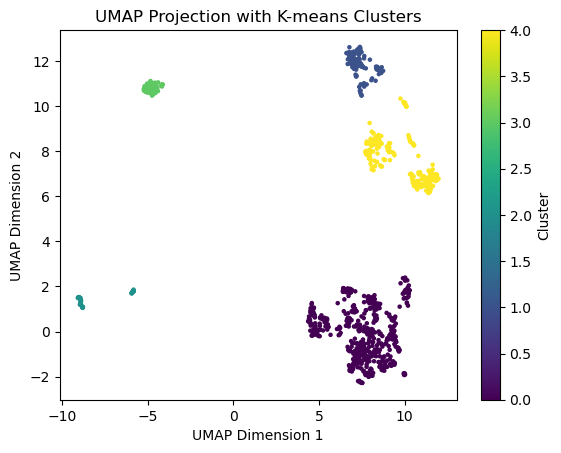

In [ ]:
umap_reducer = umap.UMAP(n_neighbors=15, random_state=42)
umap_embedding = umap_reducer.fit_transform(model_testing_scaled)

kmeans = KMeans(n_clusters=5, random_state=42)
clusters = kmeans.fit_predict(umap_embedding)

plt.scatter(umap_embedding[:, 0], umap_embedding[:, 1], c=clusters, cmap='viridis', s=5)
plt.title('UMAP Projection with K-means Clusters')
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.colorbar(label='Cluster')
plt.show()

model_testing_scaled['Cluster'] = clusters


In [ ]:
model_testing_scaled

,O00391_none,O00533_none,O00584_none,O14498_none,O14773_none,O14791_none,O15240_none,O15394_none,O43505_none,O60888_none,...,ratio_AQTTVTCM(UniMod_35)ENGWSPTPR_AQTTVTCMENGWSPTPR,ratio_IVSSAMEPDREYHFGQAVR_IVSSAM(UniMod_35)EPDREYHFGQAVR,ratio_TM(UniMod_35)QENSTPRED_TMQENSTPRED,ratio_DQTVSDNELQEM(UniMod_35)SNQGSK_DQTVSDNELQEMSNQGSK,ratio_FM(UniMod_35)ETVAEK_FMETVAEK,ratio_M(UniMod_35)VQEQCCHSQLEELHCATGISLANEQDR_MVQEQCCHSQLEELHCATGISLANEQDR,ratio_TM(UniMod_35)LLQPAGSLGSYSYR_TMLLQPAGSLGSYSYR,ratio_ICLEDNVLM(UniMod_35)SGVK_ICLEDNVLMSGVK,ratio_M(UniMod_35)ASGAANVVGPK_MASGAANVVGPK,Cluster
visit_id,,,,,,,,,,,,,,,,,,,,,
10053_0,-0.009137,-0.287218,-19.350490,-20.652736,-1.456830,-0.064765,-0.391369,-1.903170,-0.200629,-0.061439,...,-5.208185,-0.544630,-88.450730,-1.859801,-1.113277,-7.636679,-0.202599,0.388892,-0.784808,2
10053_12,0.005629,-0.160216,-19.350490,-20.652736,-16.534778,-11.767363,0.621343,-1.904734,-0.235693,-0.380407,...,-1.495800,0.338775,-88.450730,-1.859801,-1.514905,-7.636679,-0.669972,0.323402,-0.784808,2
10053_18,0.030549,0.083714,-2.488820,-0.088411,-16.534778,-0.141644,0.102050,-1.781109,-0.191790,0.368029,...,-1.335390,0.126222,0.024930,1.957700,-1.514905,-7.636679,-0.648888,0.180459,1.508247,2
10138_12,0.025330,0.042849,-2.010787,0.121671,0.491157,1.250089,0.349780,0.187527,0.176099,-1.542709,...,-0.108438,0.345858,0.039099,-0.032651,0.191774,0.250971,0.297779,0.168254,0.126789,0
10138_24,0.020182,0.129531,-3.363372,-0.811506,0.928425,0.032219,0.310601,0.120207,0.491882,-0.797684,...,0.210136,-0.181921,0.261716,-0.535288,0.687583,-0.364271,0.235347,0.295929,0.288470,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8699_24,0.000636,-0.295311,-0.162219,-20.652736,0.008821,1.319868,-0.471784,-0.074722,0.594424,0.071271,...,-0.052011,0.430838,-88.450730,-0.808150,-1.100078,0.191871,-0.678512,-0.765607,-0.711035,3
942_12,-0.040756,-0.461101,-0.689496,-1.121468,0.167611,-0.620476,-0.338355,-0.412413,0.250263,-0.511671,...,-0.050643,-0.229798,0.244423,-0.320101,1.228353,-0.090471,-0.703405,0.407705,0.644610,0
942_24,-0.976064,-0.497557,-0.275719,-0.184606,-0.016427,-0.839715,-0.011920,-0.485034,-0.001247,-0.535774,...,-0.544351,-6.748180,0.303048,0.083231,1.399841,0.401950,-0.703405,0.021991,0.445540,0


### Basic data imputation for updrs scores

In [ ]:
proteins_clinical_df = proteins_clinical.copy()

# Extracting visit_id, visit_month, patient_id, and UPDRS scores
updrs_df = proteins_clinical_df[['visit_id', 'visit_month', 'patient_id', 'updrs_1', 'updrs_2', 'updrs_3', 'updrs_4']].copy()

# Removing duplicates since UPDRS scores are repeated for each protein per visit
updrs_df.drop_duplicates(subset=['visit_id'], inplace=True)

# Now updrs_df contains visit_id, visit_month, patient_id, and UPDRS scores without duplicates


In [ ]:
# Function to perform interpolation and fill with patient-specific averages
def process_updrs_scores(group):
    # Columns to process
    updrs_columns = ['updrs_1', 'updrs_2', 'updrs_3', 'updrs_4']

    for column in updrs_columns:
        # Apply linear interpolation
        group[column] = group[column].interpolate(method='linear')

        # Calculate the patient-specific average for this column
        patient_avg = group[column].mean()

        # Fill remaining NaNs with the patient-specific average
        group[column] = group[column].fillna(patient_avg)

    return group

# Group by 'patient_id' and apply the processing function
updrs_df = updrs_df.groupby('patient_id').apply(process_updrs_scores)

updrs_df = updrs_df.reset_index(drop=True)

# Checking for NaN values after processing
nan_counts = updrs_df.isna().sum()
nan_counts


visit_id         0
visit_month      0
patient_id       0
updrs_1          0
updrs_2          0
updrs_3          0
updrs_4        274
dtype: int64

In [ ]:
# Calculate the global average for updrs_4
global_avg_updrs_4 = updrs_df['updrs_4'].mean()

# Fill remaining NaNs in updrs_4 with the global average
updrs_df['updrs_4'] = updrs_df['updrs_4'].fillna(global_avg_updrs_4)

# Verify that there are no NaNs left
updrs_df.isna().sum()


visit_id       0
visit_month    0
patient_id     0
updrs_1        0
updrs_2        0
updrs_3        0
updrs_4        0
dtype: int64

### Xgboost classifier

In [ ]:
model_testing_scaled

,O00391_none,O00533_none,O00584_none,O14498_none,O14773_none,O14791_none,O15240_none,O15394_none,O43505_none,O60888_none,...,ratio_AQTTVTCM(UniMod_35)ENGWSPTPR_AQTTVTCMENGWSPTPR,ratio_IVSSAMEPDREYHFGQAVR_IVSSAM(UniMod_35)EPDREYHFGQAVR,ratio_TM(UniMod_35)QENSTPRED_TMQENSTPRED,ratio_DQTVSDNELQEM(UniMod_35)SNQGSK_DQTVSDNELQEMSNQGSK,ratio_FM(UniMod_35)ETVAEK_FMETVAEK,ratio_M(UniMod_35)VQEQCCHSQLEELHCATGISLANEQDR_MVQEQCCHSQLEELHCATGISLANEQDR,ratio_TM(UniMod_35)LLQPAGSLGSYSYR_TMLLQPAGSLGSYSYR,ratio_ICLEDNVLM(UniMod_35)SGVK_ICLEDNVLMSGVK,ratio_M(UniMod_35)ASGAANVVGPK_MASGAANVVGPK,Cluster
visit_id,,,,,,,,,,,,,,,,,,,,,
10053_0,-0.009137,-0.287218,-19.350490,-20.652736,-1.456830,-0.064765,-0.391369,-1.903170,-0.200629,-0.061439,...,-5.208185,-0.544630,-88.450730,-1.859801,-1.113277,-7.636679,-0.202599,0.388892,-0.784808,2
10053_12,0.005629,-0.160216,-19.350490,-20.652736,-16.534778,-11.767363,0.621343,-1.904734,-0.235693,-0.380407,...,-1.495800,0.338775,-88.450730,-1.859801,-1.514905,-7.636679,-0.669972,0.323402,-0.784808,2
10053_18,0.030549,0.083714,-2.488820,-0.088411,-16.534778,-0.141644,0.102050,-1.781109,-0.191790,0.368029,...,-1.335390,0.126222,0.024930,1.957700,-1.514905,-7.636679,-0.648888,0.180459,1.508247,2
10138_12,0.025330,0.042849,-2.010787,0.121671,0.491157,1.250089,0.349780,0.187527,0.176099,-1.542709,...,-0.108438,0.345858,0.039099,-0.032651,0.191774,0.250971,0.297779,0.168254,0.126789,0
10138_24,0.020182,0.129531,-3.363372,-0.811506,0.928425,0.032219,0.310601,0.120207,0.491882,-0.797684,...,0.210136,-0.181921,0.261716,-0.535288,0.687583,-0.364271,0.235347,0.295929,0.288470,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8699_24,0.000636,-0.295311,-0.162219,-20.652736,0.008821,1.319868,-0.471784,-0.074722,0.594424,0.071271,...,-0.052011,0.430838,-88.450730,-0.808150,-1.100078,0.191871,-0.678512,-0.765607,-0.711035,3
942_12,-0.040756,-0.461101,-0.689496,-1.121468,0.167611,-0.620476,-0.338355,-0.412413,0.250263,-0.511671,...,-0.050643,-0.229798,0.244423,-0.320101,1.228353,-0.090471,-0.703405,0.407705,0.644610,0
942_24,-0.976064,-0.497557,-0.275719,-0.184606,-0.016427,-0.839715,-0.011920,-0.485034,-0.001247,-0.535774,...,-0.544351,-6.748180,0.303048,0.083231,1.399841,0.401950,-0.703405,0.021991,0.445540,0


In [ ]:
# Revist this. Imbalanced

In [ ]:
# Step 1: Train-Test Split
X_train, X_test = train_test_split(model_testing_df, test_size=0.2, random_state=42)

# Step 2: Apply Robust Scaling
scaler = RobustScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Step 3: Retrieve Cluster Labels
y_train = model_testing_scaled.loc[X_train.index, 'Cluster']
y_test = model_testing_scaled.loc[X_test.index, 'Cluster']

# Step 4: Classifier Training
xgb_classifier = xgb.XGBClassifier(random_state=42)
param_grid = {
    'max_depth': [3, 5],
    'learning_rate': [0.1, 0.3],
    'n_estimators': [50, 100],
    'subsample': [0.5, 0.7, 1]
}
grid_search = GridSearchCV(xgb_classifier, param_grid, cv=5, scoring='accuracy', verbose=1, n_jobs=-1)
grid_search.fit(X_train_scaled, y_train)

# Step 5: Validation
best_classifier = grid_search.best_estimator_
predicted_clusters = best_classifier.predict(X_test_scaled)
print(classification_report(y_test, predicted_clusters))

# Bess classifier & scaler
joblib.dump(best_classifier, 'best_xgb_classifier.pkl')
joblib.dump(scaler, 'robust_scaler.pkl')


Fitting 5 folds for each of 24 candidates, totalling 120 fits
              precision    recall  f1-score   support

           0       1.00      0.99      1.00       110
           1       0.94      0.97      0.95        31
           2       1.00      1.00      1.00        14
           3       1.00      1.00      1.00        12
           4       0.96      0.96      0.96        47

    accuracy                           0.98       214
   macro avg       0.98      0.98      0.98       214
weighted avg       0.98      0.98      0.98       214



['robust_scaler.pkl']

### Feature importances

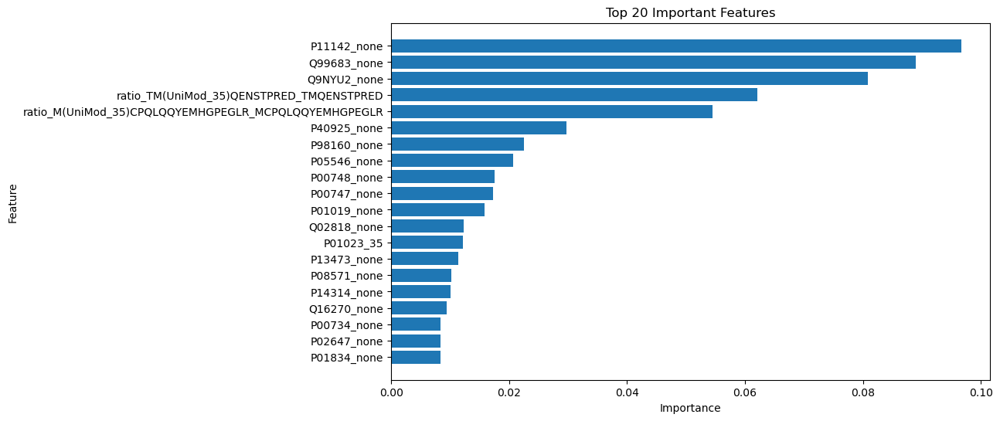

In [ ]:
# Step 5: Feature Importance Analysis
feature_importance = best_classifier.feature_importances_
feature_importances_df = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': feature_importance
}).sort_values(by='Importance', ascending=False)

# Plotting Feature Importances
plt.figure(figsize=(10, 6))
plt.barh(feature_importances_df['Feature'][:20], feature_importances_df['Importance'][:20])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Top 20 Important Features')
plt.gca().invert_yaxis()
plt.show()

In [ ]:
if 'random_state' in best_params:
    del best_params['random_state']  # Remove random_state from best_params if exists

xgb_classifier = xgb.XGBClassifier(random_state=42, **best_params)

# Assuming best_params is already defined
best_params = grid_search.best_params_
# Ensure 'random_state' is not duplicated
best_params.pop('random_state', None)  # Removes 'random_state' key if exists, does nothing otherwise

feature_importances_per_cluster = {}

# Get unique cluster labels
cluster_labels = y_train.unique()

for cluster_label in cluster_labels:
    y_train_binary = (y_train == cluster_label).astype(int)
    y_test_binary = (y_test == cluster_label).astype(int)

    # Train the classifier using the best parameters, excluding 'random_state'
    xgb_classifier = xgb.XGBClassifier(random_state=42, **best_params)
    xgb_classifier.fit(X_train_scaled, y_train_binary)

    # Get feature importances
    feature_importance = xgb_classifier.feature_importances_
    feature_importances_per_cluster[cluster_label] = pd.DataFrame({
        'Feature': X_train.columns,
        'Importance': feature_importance
    }).sort_values(by='Importance', ascending=False)



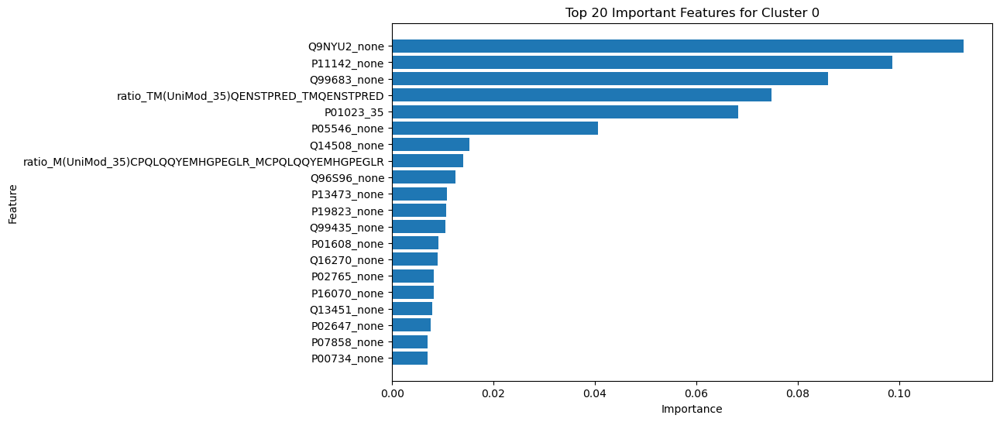

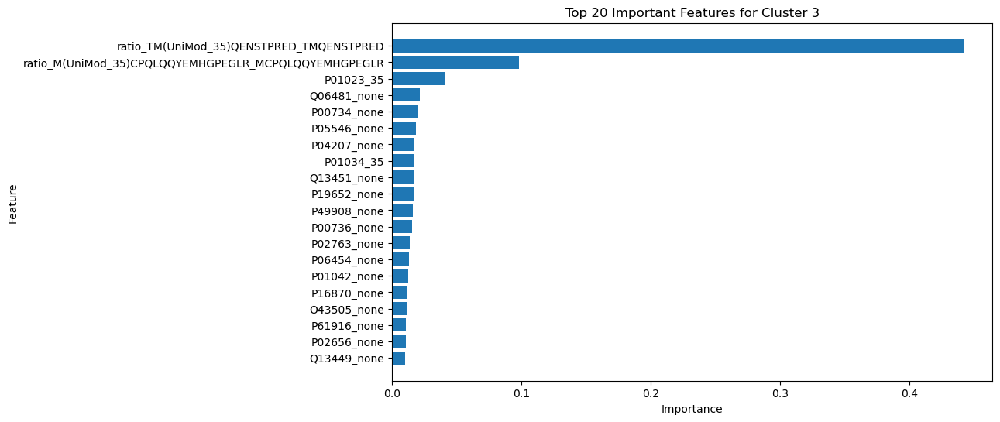

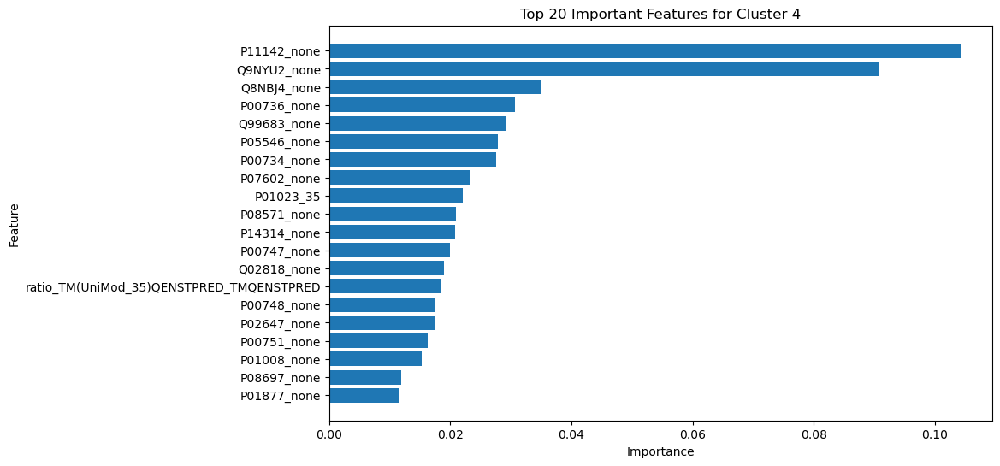

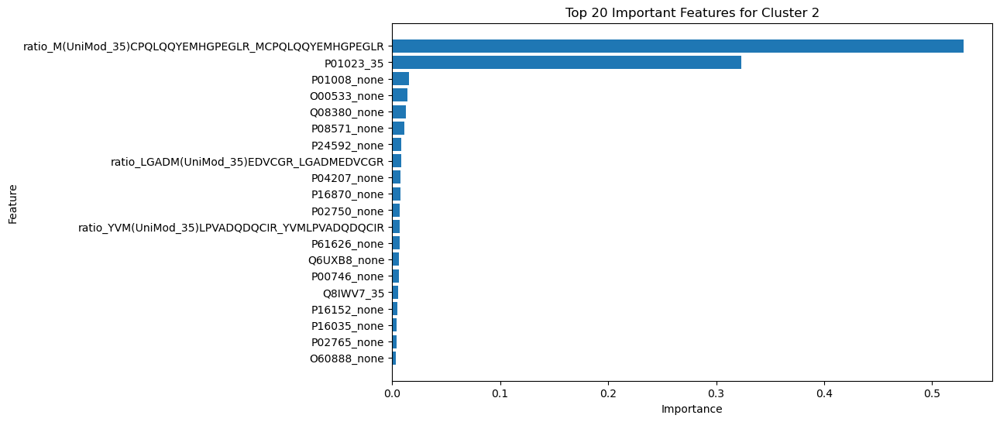

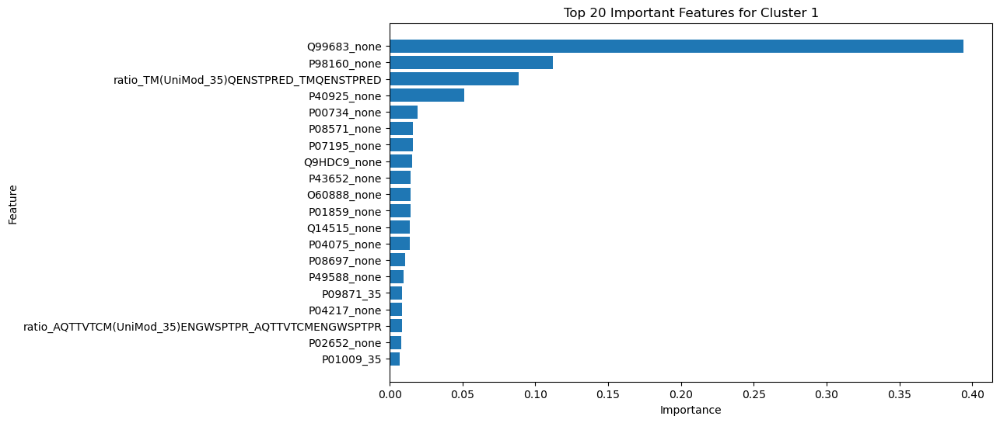

In [ ]:
# Plot Feature Importances for Each Cluster
for cluster_label, importances_df in feature_importances_per_cluster.items():
    plt.figure(figsize=(10, 6))
    plt.barh(importances_df['Feature'][:20], importances_df['Importance'][:20])
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.title(f'Top 20 Important Features for Cluster {cluster_label}')
    plt.gca().invert_yaxis()
    plt.show()


In [ ]:
specific_peptide_df = peptides[peptides['Peptide'] == 'TMQENSTPRED']

uniprot_ids = specific_peptide_df['UniProt'].unique()
print("UniProt IDs for the peptide 'TMQENSTPRED':")
print(uniprot_ids)


UniProt IDs for the peptide 'TMQENSTPRED':
['P09871']
